In [64]:
%matplotlib inline
%config InlineBackend.figure_format = "retina"

from astropy.table import Table
import astropy.units as u
import astropy.constants as c

import matplotlib.pyplot as plt
from matplotlib import rcParams
rcParams["font.size"] = 20
rcParams['figure.dpi'] = 100
rcParams["savefig.dpi"] = 300
rcParams["savefig.bbox"] = 'tight'

import numpy as np
import pandas as pd
import pickle

import os
import requests
from io import BytesIO
from io import StringIO

from astropy.table import Table
from astropy.table import join
from astropy.io import ascii
import astropy.constants as c


from scipy import interpolate
from scipy import stats
#from sklearn import svm

# Function to get NASA Exoplanet Archive catalogs 
# from Dan Foreman-Mackey (https://github.com/dfm/exopop)
def get_catalog(name, basepath="../data"):
    fn = os.path.join(basepath, "{0}.h5".format(name))
    if os.path.exists(fn):
        return pd.read_hdf(fn, name)
    if not os.path.exists(basepath):
        os.makedirs(basepath)
    print("Downloading {0}...".format(name))
    url = ("http://exoplanetarchive.ipac.caltech.edu/cgi-bin/nstedAPI/"
           "nph-nstedAPI?table={0}&select=*").format(name)
    r = requests.get(url)
    if r.status_code != requests.codes.ok:
        r.raise_for_status()
        
    fh = BytesIO(r.content)
    df = pd.read_csv(fh)
    df.to_hdf(fn, name, format="t")
    return df

#To track the provenance of different columns, we want a function to prepend an informative string to each column name.
#We will do this before merging tables to make tracking the information easier.
def prepend_dataframe_columns(df, prefix):
    df.columns = [prefix+col for col in df.columns]
    #df.columns = df.columns.str.lower()
    return 

#Suppressing astropy units warnings
import warnings
from astropy.utils.exceptions import AstropyWarning

warnings.filterwarnings('ignore', category=UserWarning, append=True)
warnings.simplefilter('ignore', category=AstropyWarning)
warnings.simplefilter(action='ignore', category=FutureWarning)

#Suppressing Pandas chained assignment warnings
pd.options.mode.chained_assignment = None  # default='warn'

# Set the plot styles

In [65]:
import seaborn as sns
#berry = ['#6797aa', '#7d3f79', '#201e5b', '#dda3d1', '#805da4', '#0c0c0d']
#sns.set_palette(sns.color_palette(berry))
#sns.palplot(sns.color_palette(berry))
#sns.palplot(sns.color_palette("cubehelix", 10))

sns.set(style="ticks", 
        context="paper",
        font_scale=1,
        palette=sns.color_palette("coolwarm"))

sc_kws = {"cmap": "viridis", 
          "s": 10, 
          "rasterized":True, 
          "lw": 0.25, 
          "alpha": 1}

#ebar_kws = {}
#hist_kws = {}

# Look at average YMg/YAl ratio for SE vs SN

### Cumulative KOI table from NASA Exoplanet Archive

In [66]:
koi = get_catalog('cumulative')
#koi = get_catalog('q1_q17_dr25_sup_koi')
koi['kepoi_int'] = [int(float(x.strip("K"))) for x in koi['kepoi_name']]

print(len(np.unique(koi['kepid'])))
print(len(np.unique(koi['kepoi_name'])))

koi.head()

8214
9564


,kepid,kepoi_name,kepler_name,ra,ra_err,ra_str,dec,dec_err,dec_str,koi_gmag,...,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2,koi_fittype,koi_score,kepoi_int
0,10797460,K00752.01,Kepler-227 b,291.93423,0.0,19h27m44.22s,48.141651,0.0,+48d08m29.9s,15.890,...,0,93.59,29.45,-16.65,3.20796,0.33173,-1.09986,LS+MCMC,1.000,752
1,10797460,K00752.02,Kepler-227 c,291.93423,0.0,19h27m44.22s,48.141651,0.0,+48d08m29.9s,15.890,...,0,9.11,2.87,-1.62,3.02368,2.20489,-2.49638,LS+MCMC,0.969,752
2,10811496,K00753.01,NaN,297.00482,0.0,19h48m01.16s,48.134129,0.0,+48d08m02.9s,15.943,...,0,39.30,31.04,-10.49,7.29555,35.03293,-2.75453,LS+MCMC,0.000,753
3,10848459,K00754.01,NaN,285.53461,0.0,19h02m08.31s,48.285210,0.0,+48d17m06.8s,16.100,...,0,891.96,668.95,-230.35,0.22080,0.00917,-0.01837,LS+MCMC,0.000,754
4,10854555,K00755.01,Kepler-664 b,288.75488,0.0,19h15m01.17s,48.226200,0.0,+48d13m34.3s,16.015,...,0,926.16,874.33,-314.24,1.98635,2.71141,-1.74541,LS+MCMC,1.000,755


### Gaia-Kepler Stellar Properties Catalog I (Berger et al. 2020a)
Stellar properties

In [67]:
ber_st = pd.read_parquet('GKSPCPapTable2.parquet')
#print(len(ber_st), 'stars')
#ber_st.columns = ber_st.columns.str.lower()
ber_st.head() 

,b20_KIC,b20_iso_mass,b20_iso_mass_err1,b20_iso_mass_err2,b20_iso_teff,b20_iso_teff_err1,b20_iso_teff_err2,b20_iso_logg,b20_iso_logg_err1,b20_iso_logg_err2,...,b20_iso_age_err2,b20_iso_dis,b20_iso_dis_err1,b20_iso_dis_err2,b20_iso_avs,b20_iso_gof,b20_TAMS,b20_log10_iso_age,b20_E_log10_iso_age,b20_e_log10_iso_age
0,757076,1.396,0.179,-0.218,5052.2,103.9,-86.6,3.373,0.067,-0.081,...,-0.73,651.5,22.6,-21.6,0.371,1.0,2.69,9.392697,0.239760,0.152148
1,757099,0.873,0.054,-0.039,5364.9,102.7,-84.9,4.318,0.037,-0.029,...,-3.98,367.8,7.1,-6.9,0.340,1.0,17.18,10.181844,0.078228,0.131851
2,757137,1.669,0.309,-0.300,4628.7,84.8,-76.2,2.388,0.083,-0.086,...,-0.58,568.4,12.2,-11.6,0.344,1.0,1.66,9.178977,0.230956,0.210494
3,757280,1.715,0.086,-0.089,6856.8,144.4,-139.9,3.834,0.033,-0.032,...,-0.16,822.0,19.4,-21.0,0.496,1.0,1.62,9.093422,0.064941,0.059998
4,757450,0.914,0.062,-0.057,5301.2,111.0,-103.1,4.432,0.045,-0.044,...,-5.15,829.6,24.0,-23.4,0.465,1.0,16.10,9.975891,0.194957,0.341414


### GKSPC II (Berger et al. 2020b)
Planet properties

In [68]:
ber_pl = Table.read("http://cdsarc.unistra.fr/ftp/J/AJ/160/108/table1.dat",
              readme="http://cdsarc.unistra.fr/ftp/J/AJ/160/108/ReadMe",
              format="ascii.cds")

ber_pl = ber_pl.to_pandas()
ber_pl['kepoi_name'] = ['K'+str(koi).zfill(8) for koi in ber_pl['KOI']]
prepend_dataframe_columns(ber_pl, 'b20b_')
#print(len(ber_pl), 'planets')
ber_pl.head()

,b20b_KIC,b20b_KOI,b20b_PD,b20b_Radius,b20b_E_Radius,b20b_e_Radius,b20b_a,b20b_E_a,b20b_e_a,b20b_Flux,b20b_E_Flux,b20b_e_Flux,b20b_ZAMSFlux,b20b_Flag,b20b_kepoi_name
0,11446443,1.01,CONFIRMED,14.21,0.29,0.29,0.0355,0.0008,0.0008,854.78,69.34,64.81,524.75,AO,K00001.01
1,10666592,2.01,CONFIRMED,16.45,0.35,0.34,0.0381,0.0005,0.0006,4285.95,331.23,336.99,2394.68,AO,K00002.01
2,10748390,3.01,CONFIRMED,4.88,0.08,0.07,0.0516,0.0006,0.0004,86.58,5.24,4.73,58.22,NaN,K00003.01
3,3861595,4.01,CONFIRMED,13.18,0.42,0.82,0.0583,0.0007,0.0015,5244.42,478.90,520.46,3647.63,AO,K00004.01
4,11853905,7.01,CONFIRMED,4.01,0.10,0.10,0.0455,0.0007,0.0010,1247.17,99.09,99.02,719.80,NaN,K00007.01


### Lithium abundances for the CKS sample ([Berger et al. 2018](https://ui.adsabs.harvard.edu/abs/2018ApJ...855..115B/abstract))

In [69]:
b18 = Table.read("https://cdsarc.unistra.fr/ftp/J/ApJ/855/115/table1.dat",
             readme="https://cdsarc.unistra.fr/ftp/J/ApJ/855/115/ReadMe",
             format="ascii.cds")

b18 = b18.to_pandas()
prepend_dataframe_columns(b18, "b18_")

b18_tb2 = Table.read("https://cdsarc.unistra.fr/ftp/J/ApJ/855/115/table2.dat",
                 readme="https://cdsarc.unistra.fr/ftp/J/ApJ/855/115/ReadMe",
                 format="ascii.cds")

b18_tb2 = b18_tb2.to_pandas()
prepend_dataframe_columns(b18_tb2, "b18_tb2_")

b18 = b18.merge(b18_tb2, how='left', left_on='b18_KOI', right_on='b18_tb2_KOI')
#print(len(b18))
b18.head()

,b18_Obs,b18_Date,b18_KOI,b18_Kpmag,b18_S/N,b18_Teff,b18_logg,b18_[Fe/H],b18_Vt,b18_EW(Li),...,b18_tb2_S/N,b18_tb2_Teff,b18_tb2_logg,b18_tb2_[Fe/H],b18_tb2_Vt,b18_tb2_EW(Li),b18_tb2_e_EW(Li),b18_tb2_A(Li),b18_tb2_e_A(Li),b18_tb2_dA(Li)Hy
0,j122.742,2011-06-16,1,11.34,39,5819,4.40,0.01,1.04,85.5,...,39.0,5819.0,4.40,0.01,1.04,85.5,7.9,2.62,0.08,0.08
1,j122.92,2011-06-13,2,10.46,39,6449,4.13,0.20,1.77,82.9,...,39.0,6449.0,4.13,0.20,1.77,82.9,7.3,3.11,0.07,0.59
2,j122.81,2011-06-13,3,9.17,41,4864,4.50,0.33,0.54,4.2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,j70.1247,2009-06-05,6,12.16,119,6348,4.36,0.04,1.58,15.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,j74.509,2009-07-31,7,12.21,126,5827,4.09,0.18,1.17,54.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### CKS I (Petigura et al. 2017)
For consistency with CKS VII, we will use the false positive designations adopted in Table 4 of CKS I, which themselves are based on a compilation of planet candidate dispositions from Morton et al. (2016), Mullaly et al. (2015), and the NASA Exoplanet Archive (as it was on Feb. 1, 2017).

In [70]:
p17 = Table.read('ftp://cdsarc.unistra.fr/ftp/J/AJ/154/107/table4.dat',
             readme='ftp://cdsarc.unistra.fr/ftp/J/AJ/154/107/ReadMe',
             format='ascii.cds')

p17 = p17.to_pandas()
#Munging
p17['Name'] = [x.replace('OI-', '') for x in p17['Name']]
p17 = p17.rename(columns={'Name':'KOI'})
prepend_dataframe_columns(p17, 'p17_')
#print(len(p17), 'planets')
p17.head()

,p17_KOI,p17_Disp,p17_M16,p17_M15,p17_NEA
0,K00001.01,CP,CP,CP,CP
1,K00002.01,CP,CP,CP,CP
2,K00003.01,CP,CP,CP,CP
3,K00006.01,FP,FP,FP,FP
4,K00007.01,CP,CP,CP,CP


### CKS VII (Fulton & Petigura 2018)

In [71]:
cks2 = Table.read("http://cdsarc.unistra.fr/ftp/J/AJ/156/264/table2.dat",
            readme="http://cdsarc.unistra.fr/ftp/J/AJ/156/264/ReadMe",
            format="ascii.cds")
cks2 = cks2.to_pandas()
cks2 = cks2.rename(columns={"KOI": "KOI_star"})
prepend_dataframe_columns(cks2, 'cks_')

cks3 = Table.read("http://cdsarc.unistra.fr/ftp/J/AJ/156/264/table3.dat",
                readme="http://cdsarc.unistra.fr/ftp/J/AJ/156/264/ReadMe",
                format="ascii.cds")
cks3 = cks3.to_pandas()
cks3["KOI_star"] = [x.split(".")[0] for x in cks3["KOI"]]
prepend_dataframe_columns(cks3, 'cks_')

cks = cks3.merge(cks2, how='left', left_on='cks_KOI_star', right_on='cks_KOI_star')
#print(len(cks2), 'stars')
#print(len(cks), 'planets')
cks.head()

,cks_KOI,cks_Per,cks_E_Per,cks_e_Per,cks_Rp/R*,cks_E_Rp/R*,cks_e_Rp/R*,cks_Rp,cks_E_Rp,cks_e_Rp,...,cks_E_rhoiso,cks_e_rhoiso,cks_logAiso,cks_E_logAiso,cks_e_logAiso,cks_plxspec,cks_E_plxspec,cks_e_plxspec,cks_r8,cks_RCF
0,K00001.01,2.470613,1.900000e-08,1.900000e-08,0.123851,0.000025,0.000076,14.141,0.331,0.331,...,0.04,0.04,9.74,0.13,0.15,4.756,0.320,0.474,1.000,1.0102
1,K00002.01,2.204735,3.800000e-08,3.800000e-08,0.075408,0.000008,0.000007,16.250,0.349,0.349,...,0.01,0.00,9.25,0.04,0.05,3.661,0.411,0.586,1.001,1.0034
2,K00006.01,1.334104,7.070000e-07,7.070000e-07,0.294016,0.103683,0.209459,41.936,22.239,22.239,...,0.03,0.03,9.32,0.09,0.24,2.201,0.127,0.212,1.007,1.0006
3,K00007.01,3.213669,1.122000e-06,1.122000e-06,0.024735,0.000141,0.000076,4.076,0.107,0.107,...,0.02,0.02,9.78,0.09,0.08,2.112,0.228,0.274,1.000,NaN
4,K00008.01,1.160153,4.270000e-07,4.270000e-07,0.018559,0.000246,0.001678,1.896,0.110,0.110,...,0.03,0.05,9.18,0.26,0.52,2.895,0.127,0.192,1.001,NaN


### Martinez et al. 2019 independent analysis of CKS spectra

In [72]:
m19_t1 = Table.read("./martinez2019/table1.dat", 
                 readme="./martinez2019/ReadMe",
                format="ascii.cds")

m19_t1 = m19_t1.to_pandas()
m19_t1 = m19_t1.rename(columns={'Name':'KOI_star'})
#m19_t1.head()

m19_t2 = Table.read("./martinez2019/table2.dat", 
                 readme="./martinez2019/ReadMe",
                format="ascii.cds")

m19_t2 = m19_t2.to_pandas()
m19_t2['KOI_star'] = [x.split(".")[0] for x in m19_t2['KOI']]
m19_t2.head()


m19 = m19_t2.merge(m19_t1, how='left', left_on='KOI_star', right_on='KOI_star')
print(len(m19_t1), len(m19_t2), len(m19))

prepend_dataframe_columns(m19, 'm19_')
m19.head()

1285 1633 1633


,m19_Seq_x,m19_KOI,m19_Rp,m19_e_Rp,m19_KOI_star,m19_Seq_y,m19_Teff,m19_e_Teff,m19_log(g),m19_e_log(g),m19_Vturb,m19_e_Vturb,m19_R*,m19_e_R*
0,1,K00001.01,13.62,0.30,K00001,35,5856,33,4.44,0.09,1.15,0.06,1.05,0.02
1,2,K00002.01,17.93,1.07,K00002,154,6384,77,3.90,0.13,1.98,0.10,2.01,0.12
2,3,K00007.01,4.49,0.13,K00007,337,5852,20,4.19,0.06,1.20,0.03,1.52,0.04
3,4,K00010.01,16.62,1.14,K00010,947,6118,120,4.09,0.14,1.89,0.20,1.59,0.11
4,5,K00017.01,14.31,0.35,K00017,467,5699,22,4.34,0.07,1.02,0.04,1.28,0.03


### Petigura 2020

In [73]:
url = "https://raw.githubusercontent.com/petigura/keprat/master/data/cksgaia-planets.csv"
s = requests.get(url).content
p20 = pd.read_csv(StringIO(s.decode('utf-8')))
p20['Rtau'] = p20.tau/p20.tau0
prepend_dataframe_columns(p20, 'p20_')
print(len(p20), 'planets')
p20.head()

1870 planets


,p20_id_kic,p20_id_starname,p20_id_kic.1,p20_id_koi,p20_id_koicand,p20_id_kepler_name,p20_koi_disposition,p20_koi_period,p20_koi_period_err1,p20_koi_period_err2,...,p20_fgraz,p20_tau0,p20_tau,p20_dr25_ror_v18_srad,p20_dr25_ror_v18_srad_err1,p20_dr25_ror_gdir_srad,p20_dr25_ror_gdir_srad_err1,p20_v18_ror_gdir_srad,p20_v18_ror_gdir_srad_err1,p20_Rtau
0,757450,K00889,757450,889.0,K00889.01,Kepler-75 b,CONFIRMED,8.884923,0.000001,-0.000001,...,0.0,4.019727,1.856715,NaN,NaN,11.802615,0.412225,NaN,NaN,0.461901
1,1026957,K00958,1026957,958.0,K00958.01,NaN,NOT DISPOSITIONED,21.761294,0.000011,-0.000011,...,0.0,4.427408,1.204967,NaN,NaN,2.478217,0.114768,NaN,NaN,0.272161
2,1718189,K00993,1718189,993.0,K00993.01,Kepler-262 c,CONFIRMED,21.853679,0.000097,-0.000097,...,0.0,4.914936,3.306574,NaN,NaN,1.551245,0.081248,NaN,NaN,0.672760
3,1718189,K00993,1718189,993.0,K00993.02,Kepler-262 b,CONFIRMED,13.060767,0.000092,-0.000092,...,0.0,4.139989,3.093553,NaN,NaN,1.267332,0.068661,NaN,NaN,0.747237
4,1718189,K00993,1718189,993.0,K00993.03,NaN,CANDIDATE,86.723152,0.001814,-0.001814,...,0.0,7.781345,4.761139,NaN,NaN,1.257706,0.094337,NaN,NaN,0.611866


### Lu et al. 2021 gyrokinematic ages

In [74]:
l20 = pd.read_parquet('KinageAllKepler.parquet')
#l20.columns = l20.columns.str.lower()
print(len(l20), 'stars')
l20.head()

155263 stars


,l20_KID,l20_Rvar,l20_v_t,l20_v_b,l20_ebv,l20_Av,l20_Av_errp,l20_Av_errm,l20_Av_std,l20_bp_dered,l20_rp_dered,l20_bprp_dered,l20_G_dered,l20_teff_calc,l20_abs_G,l20_Prot_predict,l20_Prot_log,l20_Ro,l20_vel_dis,l20_kin_age
0,757076,876.277685,46.183244,-5.383212,0.105000,0.287910,0.009323,0.009323,0.009323,11.777006,10.774865,1.002141,11.345285,5258.348073,2.216916,20.483619,1.311407,2.282666,11.194525,2.732534
1,757099,57346.507907,6.947554,-6.672655,0.059046,0.161903,0.022417,0.022417,0.022417,13.361525,12.369631,0.991894,12.947337,5285.025302,5.086547,4.249750,0.628363,0.328795,1.902900,0.167638
2,757280,707.322359,11.457449,-2.608310,0.150000,0.411300,0.000000,0.000000,0.000000,11.553965,11.067600,0.486364,11.367806,6917.117893,1.733926,2.866350,0.457329,0.255402,7.812125,1.550512
3,757450,21632.027626,33.889670,-33.411547,0.140000,0.383880,0.018646,0.018646,0.018646,15.240799,14.264825,0.975974,14.829724,5327.028622,5.168635,15.227621,1.182632,0.792438,13.113275,3.505780
4,891901,1109.898090,74.201645,6.434752,0.095812,0.262716,0.007809,0.007809,0.007809,13.201027,12.588211,0.612816,12.975954,6456.866533,2.564473,7.617800,0.881830,0.643230,17.558927,5.552499


In [75]:
l21 = Table.read("./lu2021/table1.dat", 
                 readme="./lu2021/ReadMe", format="ascii.cds")
l21 = l21.to_pandas()
prepend_dataframe_columns(l21, "l21_")
l21.head()

,l21_KIC,l21_Prot,l21_e_Prot,l21_Gaia,l21_RAdeg,l21_e_RAdeg,l21_DEdeg,l21_e_DEdeg,l21_Wvel,l21_e_Wvel,l21_sigma,l21_GyroAge,l21_e_GyroAge,l21_Ro,l21_Teff,l21_GMAG,l21_e_sigma
0,757099,0.367,0.006,2050233601176543232,291.043,0.020,36.594,0.028,-1.967,3.403,13.291,3.581,1.771,0.028,5285.025,5.110,0.006
1,892713,5.753,0.777,2050232256840088832,291.140,0.017,36.623,0.022,-12.292,0.790,14.556,4.132,1.776,0.522,6308.396,1.487,0.006
2,892834,13.765,0.023,2050232089348169728,291.163,0.019,36.628,0.024,2.592,3.274,6.762,1.235,1.738,0.673,4881.242,6.251,0.011
3,893033,26.999,0.214,2050232639104044032,291.208,0.020,36.668,0.024,-41.087,3.357,18.404,5.979,1.790,1.388,4689.995,6.653,0.004
4,893165,54.874,3.786,2050231505232662528,291.237,0.011,36.615,0.015,5.218,3.285,13.730,3.769,1.772,2.517,5933.169,3.695,0.001


### Angus et al. 2018 rotation periods

In [76]:
a18 = pd.read_csv("Angus2018_koi_periods_nohead.csv")
prepend_dataframe_columns(a18, "a18_")
a18.head()

,a18_Index,a18_KOI,a18_feh,a18_feh_errm,a18_feh_errp,a18_logg,a18_logg_errm,a18_logg_errp,a18_period,a18_period_errm,a18_period_errp,a18_teff,a18_teff_errm,a18_teff_errp
0,0,1,-0.12,-0.280,0.330,4.609,-0.106,0.027,24.848729,5.996906,23.240003,5126.0,-138.0,160.0
1,1,2,-0.15,-0.100,0.100,4.455,-0.025,0.025,19.595792,3.779434,3.951450,5850.0,-50.0,50.0
2,2,3,0.26,-0.080,0.080,4.021,-0.011,0.011,28.159582,0.193655,2.656332,6350.0,-80.0,80.0
3,3,6,-0.04,-0.160,0.120,4.169,-0.048,0.055,22.765454,15.400891,3.123556,6225.0,-158.0,114.0
4,4,7,0.44,-0.101,0.101,4.081,-0.014,0.014,25.310087,1.685785,1.968450,5543.0,-79.0,79.0


### Mazeh et al. 2015 rotation periods

In [77]:
m15 = Table.read("http://cdsarc.unistra.fr/ftp/J/ApJ/801/3/table1.dat",
             readme="http://cdsarc.unistra.fr/ftp/J/ApJ/801/3/ReadMe",
             format="ascii.cds")

m15 = m15.to_pandas()
prepend_dataframe_columns(m15, "m15_")
m15.head()

,m15_KOI,m15_KIC,m15_Teff,m15_log(g),m15_Prot,m15_e_Prot,m15_Rvar,m15_LPH,m15_w,m15_D,m15_N,m15_C,m15_G,m15_T,m15_F,m15_R,m15_M1,m15_M2
0,1,11446443,5713,4.143,70.55,16.47,445,0.362359,0.000000,0,0,0,0,0,0,0,1,0
1,2,10666592,6264,3.790,70.69,6.80,919,0.542156,0.000000,0,1,0,0,0,0,0,1,0
2,3,10748390,4766,4.590,29.31,0.49,12246,0.607229,0.431926,0,1,0,0,0,0,0,0,0
3,5,8554498,5861,4.170,37.23,4.18,237,0.082306,0.000000,0,0,0,0,0,0,0,1,0
4,10,6922244,6213,4.170,82.12,16.05,1245,0.350827,0.000000,0,0,0,0,0,0,0,1,0


### McQuillan et al. 2013 rotation periods

In [78]:
m13 = Table.read("http://cdsarc.unistra.fr/ftp/J/ApJ/775/L11/table1.dat",
             readme="http://cdsarc.unistra.fr/ftp/J/ApJ/775/L11/ReadMe",
             format="ascii.cds")

m13 = m13.to_pandas()
prepend_dataframe_columns(m13, "m13_")
print(len(m13), 'stars')
m13.head()

2010 stars


,m13_KOI,m13_KIC,m13_Teff,m13_log(g),m13_Rp,m13_---,m13_Porb,m13_Prot,m13_e_Prot,m13_Rvar,m13_Flag
0,3,10748390,4766,4.59,4.68,NaN,4.888,29.472,0.134,11.75,N
1,12,5812701,6419,4.26,13.40,NaN,17.855,1.245,0.124,0.78,NaN
2,41,6521045,5909,4.28,1.24,NaN,6.887,24.988,2.192,0.39,NaN
3,42,8866102,6170,4.10,2.71,NaN,17.834,20.850,0.007,1.12,NaN
4,44,8845026,6250,3.50,9.61,NaN,66.468,3.792,0.907,1.16,NaN


In [79]:
#Reinhold et al. 2013 rotation periods
# r13 = Table.read("http://cdsarc.unistra.fr/ftp/J/A+A/560/A4/table.dat",
#                  readme="http://cdsarc.unistra.fr/ftp/J/A+A/560/A4/ReadMe",
#                  format="ascii.cds", masked=True)

# r13.info()

#astropy throws following error:
#ValueError: Column Rvar failed to convert: could not convert string to float: '---'

In [80]:
# apo = Table.read("http://cdsarc.unistra.fr/ftp/J/AJ/155/68/table3.dat",
#                 readme="http://cdsarc.unistra.fr/ftp/J/AJ/155/68/ReadMe",
#                 format="ascii.cds")

# apo.info()

### Silva-Aguirre et al. 2015  asteroseismic sample

In [81]:
s15 = Table.read("ftp://cdsarc.unistra.fr/ftp/J/MNRAS/452/2127/table3.dat",
                 readme="ftp://cdsarc.unistra.fr/ftp/J/MNRAS/452/2127/ReadMe",
                 format="ascii.cds")

s15 = s15.to_pandas()
prepend_dataframe_columns(s15, 's15_')
s15.head()

,s15_KOI,s15_KIC,s15_Teff,s15_e_Teff,s15_[Fe/H],s15_e_[Fe/H],s15_Mass,s15_E_Mass,s15_e_Mass,s15_Radius,...,s15_e_L,s15_Age,s15_E_Age,s15_e_Age,s15_Dist,s15_E_Dist,s15_e_Dist,s15_Notes,s15_n_Notes,s15_Ref
0,2,10666592,6350,80,0.26,0.08,1.497,0.042,0.040,1.986,...,0.322,2.11,0.29,0.24,386.44,12.11,11.95,HAT-P7,NaN,Pal et al. (2008ApJ...680.1450P)
1,5,8554498,5945,60,0.17,0.05,1.197,0.021,0.029,1.794,...,0.182,5.60,0.45,0.42,439.34,13.68,13.68,NaN,NaN,NaN
2,7,11853905,5781,76,0.09,0.10,1.117,0.021,0.029,1.555,...,0.124,6.71,0.77,0.67,499.10,15.46,15.46,Kepler-4,NaN,Borucki et al. (2010Sci...327..977B)
3,41,6521045,5825,75,0.02,0.10,1.108,0.021,0.019,1.513,...,0.112,6.50,0.46,0.56,310.34,9.49,9.63,Kepler-100,NaN,Marcy et al. (2014ApJS..210...20M)
4,42,8866102,6325,75,0.01,0.10,1.228,0.042,0.040,1.357,...,0.130,2.60,0.56,0.53,140.83,4.40,4.50,Kepler-410 A,NaN,Van Eylen et al. (2015ApJ...808..126V)


### Brewer & Fischer 2018 CKS abundances

In [82]:
# Brewer & Fischer abundances
bf3 = Table.read("http://cdsarc.unistra.fr/ftp/J/ApJS/237/38/table3.dat",
           readme="http://cdsarc.unistra.fr/ftp/J/ApJS/237/38/ReadMe", format="ascii.cds")

bf4 = Table.read("http://cdsarc.unistra.fr/ftp/J/ApJS/237/38/table4.dat",
               readme="http://cdsarc.unistra.fr/ftp/J/ApJS/237/38/ReadMe", format="ascii.cds")

bf5 = Table.read("http://cdsarc.unistra.fr/ftp/J/ApJS/237/38/table5.dat",
               readme="http://cdsarc.unistra.fr/ftp/J/ApJS/237/38/ReadMe", format="ascii.cds")

bf6 = Table.read("http://cdsarc.unistra.fr/ftp/J/ApJS/237/38/table6.dat",
               readme="http://cdsarc.unistra.fr/ftp/J/ApJS/237/38/ReadMe", format="ascii.cds")

bf = join(bf3, bf4)
bf = join(bf, bf5)
bf = join(bf, bf6)

bf['KOI_int'] = np.zeros(len(bf), dtype=int)

for i in range(len(bf)):
    if ("KOI" in bf['Name'][i]) and ("E" not in bf['Name'][i]) and ("W" not in bf['Name'][i]) and ("B" not in bf['Name'][i]):
        bf['KOI_int'][i] = bf['Name'][i].strip("KOI-")
    else:
        bf['KOI_int'][i] = 0

bf = bf.to_pandas()
prepend_dataframe_columns(bf, "bf18_")
bf.head()

,bf18_SPOCS,bf18_Name,bf18_RAh,bf18_RAm,bf18_RAs,bf18_DE-,bf18_DEd,bf18_DEm,bf18_DEs,bf18_Teff,...,bf18_e_[Si/H],bf18_e_[Ca/H],bf18_e_[Ti/H],bf18_e_[V/H],bf18_e_[Cr/H],bf18_e_[Mn/H],bf18_e_[Fe/H],bf18_e_[Ni/H],bf18_e_[Y/H],bf18_KOI_int
0,2281,KOI-3248,19,21,51.6,+,48,19,56,5742,...,0.02,0.02,0.02,0.04,0.02,0.03,0.02,0.02,0.04,3248
1,2361,KOI-4273,19,36,50.4,+,46,28,48,6123,...,0.02,0.03,0.02,0.04,0.02,0.03,0.02,0.02,0.04,4273
2,2393,KOI-3605,19,43,21.2,+,41,25,38,5252,...,0.02,0.02,0.02,0.04,0.02,0.03,0.02,0.02,0.04,3605
3,2405,KOI-3197,19,45,9.7,+,44,25,24,6218,...,0.02,0.03,0.02,0.04,0.02,0.03,0.02,0.02,0.04,3197
4,2430,KOI-1353,19,49,51.7,+,42,52,58,5951,...,0.02,0.03,0.02,0.04,0.02,0.03,0.02,0.02,0.04,1353


### Frasca et al. 2016 LAMOST activity parameters

In [83]:
f16 = Table.read("https://cdsarc.unistra.fr/ftp/J/A+A/594/A39/tablea4.dat",
             readme="https://cdsarc.unistra.fr/ftp/J/A+A/594/A39/ReadMe",
             format="ascii.cds")
f16 = f16.to_pandas()
prepend_dataframe_columns(f16, 'f16_')
f16.head()

,f16_SpName,f16_HJD,f16_KIC,f16_RAdeg,f16_DEdeg,f16_EWHa,f16_e_EWHa,f16_EW8498,f16_e_EW8498,f16_EW8542,f16_e_EW8542,f16_EW8662,f16_e_EW8662,f16_n_EWHa,f16_Prot,f16_r_Prot
0,spec-55712-IF10M_sp02-195.fits,55712.29462,3725427,283.916107,38.864498,1.76,0.59,NaN,NaN,0.30,0.30,0.83,0.30,E,NaN,NaN
1,spec-55712-IF10M_sp03-059.fits,55712.29449,5079590,284.472107,40.213600,2.54,0.50,NaN,NaN,1.20,0.59,0.57,0.59,E,2.016,R13
2,spec-55712-IF10M_sp03-123.fits,55712.29447,5342618,284.399689,40.573399,3.26,0.38,0.87,0.35,1.77,0.36,1.09,0.36,E,NaN,NaN
3,spec-56094-kepler05F56094_sp14-049.fits,56094.30678,4353364,288.165924,39.431591,1.82,1.16,0.39,0.70,1.63,0.73,1.36,0.73,E,NaN,NaN
4,spec-56432-KP192102N424113V01_sp11-140.fits,56432.26110,8749284,290.197968,44.924999,13.04,0.37,1.15,0.30,2.50,0.31,2.22,0.31,E,3.218,D11


### Gaia DR2-Kepler 1-arcsecond positional cross-match (M. Bedell) and RUWE from Gaia source ID crossmatch (David et al. 2021) 

In [84]:
gaia = pd.read_parquet('kepler_dr2_1arcsec.parquet')
ruwe = pd.read_parquet('kepler_dr2_1arcsec_ruwe.parquet')
gaia = gaia.merge(ruwe, how='left', left_on='source_id', right_on='d20_source_id')

prepend_dataframe_columns(gaia, "gaia_")
print(len(gaia), 'stars')
gaia.head()

201350 stars


,gaia_solution_id,gaia_designation,gaia_source_id,gaia_random_index,gaia_gaia_ref_epoch,gaia_ra,gaia_ra_error,gaia_dec,gaia_dec_error,gaia_parallax,...,gaia_ntce,gaia_jmag,gaia_hmag,gaia_kmag,gaia_planet?,gaia_kepler_gaia_ang_dist,gaia_d20_kepid,gaia_d20_source_id,gaia_d20_ruwe,gaia_d20_koi
0,1635721458409799680,b'Gaia DR2 2050233807328471424',2050233807328471424,689405501,2015.5,291.038681,0.035878,36.598031,0.047832,1.493916,...,0,10.126,9.667,9.559,b'none',0.156160,757076,2050233807328471424,0.946665,NaN
1,1635721458409799680,b'Gaia DR2 2050233601176543104',2050233601176543104,447382505,2015.5,291.043057,0.019919,36.593767,0.027553,2.678194,...,1,11.656,11.193,11.094,b'none',0.128262,757099,2050233601176543104,2.172801,NaN
2,1635721458409799680,b'Gaia DR2 2050230543159814656',2050230543159814656,1004823384,2015.5,291.055892,0.019394,36.559886,0.026621,1.723413,...,0,7.467,6.853,6.722,b'none',0.146787,757137,2050230543159814656,0.912556,NaN
3,1635721458409799680,b'Gaia DR2 2050230611879323904',2050230611879323904,1253666653,2015.5,291.095373,0.016886,36.564903,0.022993,1.183652,...,0,10.852,10.662,10.627,b'none',0.116420,757280,2050230611879323904,0.870375,NaN
4,1635721458409799680,b'Gaia DR2 2050231848829944320',2050231848829944320,298032508,2015.5,291.137620,0.019560,36.577344,0.025196,1.168913,...,1,13.665,13.262,13.118,b'conf',0.114502,757450,2050231848829944320,1.030048,889.0


### Kepler Stellar Data
We will also want the [Kepler Stellar data table](https://exoplanetarchive.ipac.caltech.edu/docs/Kepler_completeness_reliability.html) for the noise properties of each planet host. Since this is a large table, we have extracted the only columns we want ahead of time and stored this in the data directory.

In [85]:
stlr = pd.read_csv('Kepler-Q1-Q17-DR25-CDPP3.csv')
prepend_dataframe_columns(stlr, 'stlr_')
stlr.head()

,stlr_kepid,stlr_rrmscdpp03p0
0,10000785,445.410
1,10000797,80.767
2,10000800,226.348
3,10000823,181.468
4,10000827,124.834


### C. Hedges amplitudes

In [86]:
ch = pd.read_csv('df_w_cdpp_candidates.csv')

for q in range(1,18):
    ch['q'+str(q)+'_rvar'] = 1e6*((ch['q'+str(q)+'_perc90']-ch['q'+str(q)+'_perc10'])/ch['q'+str(q)+'_perc50'])


ch['rvar'] = np.zeros(len(ch))    

for i in range(len(ch)):
    ch['rvar'].iloc[i] = np.nanmedian([ch["q1_rvar"].iloc[i],
                                       ch["q2_rvar"].iloc[i],
                                       ch["q3_rvar"].iloc[i],
                                       ch["q4_rvar"].iloc[i],
                                       ch["q5_rvar"].iloc[i],
                                       ch["q6_rvar"].iloc[i],
                                       ch["q7_rvar"].iloc[i],
                                       ch["q8_rvar"].iloc[i],
                                       ch["q9_rvar"].iloc[i],
                                       ch["q10_rvar"].iloc[i],
                                       ch["q11_rvar"].iloc[i],
                                       ch["q12_rvar"].iloc[i],
                                       ch["q13_rvar"].iloc[i],
                                       ch["q14_rvar"].iloc[i],
                                       ch["q15_rvar"].iloc[i],
                                       ch["q16_rvar"].iloc[i],
                                       ch["q17_rvar"].iloc[i]
                                       ])

prepend_dataframe_columns(ch, 'ch_')        
ch.head() 

,ch_kepid,ch_kepoi_name,ch_kepler_name,ch_ra,ch_ra_err,ch_ra_str,ch_dec,ch_dec_err,ch_dec_str,ch_koi_gmag,...,ch_q9_rvar,ch_q10_rvar,ch_q11_rvar,ch_q12_rvar,ch_q13_rvar,ch_q14_rvar,ch_q15_rvar,ch_q16_rvar,ch_q17_rvar,ch_rvar
0,10811496,K00753.01,NaN,297.00482,0.0,19h48m01.16s,48.134129,0.0,+48d08m02.9s,15.943,...,9658.583689,20917.404831,NaN,10706.954274,15466.036520,26506.930011,NaN,8247.953395,12525.836854,13076.233378
1,11138155,K00760.01,NaN,292.16705,0.0,19h28m40.09s,48.727589,0.0,+48d43m39.3s,15.715,...,947.866965,929.594987,961.746416,926.027160,944.915174,955.794202,955.798705,987.866182,1038.416014,955.794202
2,11818800,K00777.01,NaN,294.31686,0.0,19h37m16.05s,50.080231,0.0,+50d04m48.8s,16.100,...,56355.724813,26138.543446,27495.668946,44824.070610,30788.777817,33638.311218,50327.251520,27070.947143,45649.783409,38450.436047
3,11918099,K00780.02,NaN,293.83331,0.0,19h35m19.99s,50.230350,0.0,+50d13m49.3s,16.110,...,1204.903465,1358.803539,1287.971033,1453.058955,1461.610244,1324.312893,1244.791681,1433.994033,1589.536179,1364.742964
4,9579641,K00115.03,NaN,287.88733,0.0,19h11m32.96s,46.276241,0.0,+46d16m34.5s,13.111,...,537.856795,498.740592,415.166335,484.984661,1350.397802,530.915544,1738.465122,635.256795,1526.028138,498.740592


### David et al. 2021 rotation period vetting results

In [87]:
d21 = pd.read_csv('table1.csv')
d21 = d21[['kepid', 'prot', 'prot_ref', 'prot_numflag']]
prepend_dataframe_columns(d21, "d21_")
d21.head()    

,d21_kepid,d21_prot,d21_prot_ref,d21_prot_numflag
0,11446443.0,NaN,NaN,1.0
1,10666592.0,NaN,NaN,1.0
2,3248033.0,NaN,NaN,0.0
3,11853905.0,NaN,NaN,1.0
4,5903312.0,NaN,NaN,0.0


### Merging the dataframes
For stellar tables we want to merge on kepid (KIC) or koi_int

For planetary tables we want to merge on kepoi_name

In [88]:
df = koi.merge(stlr, how='left', left_on='kepid', right_on='stlr_kepid')
df = df.merge(ber_st, how='left', left_on='kepid', right_on='b20_KIC')
df = df.merge(ber_pl, how='left', left_on='kepoi_name', right_on='b20b_kepoi_name')
df = df.merge(b18, how='left', left_on='kepoi_int', right_on='b18_KOI')
df = df.merge(cks, how='left', left_on='kepoi_name', right_on='cks_KOI')
df = df.merge(p17, how='left', left_on='kepoi_name', right_on='p17_KOI')
df = df.merge(p20, how='left', left_on='kepoi_name', right_on='p20_id_koicand')
df = df.merge(bf, how='left', left_on='kepoi_int', right_on='bf18_KOI_int')
df = df.merge(l20, how='left', left_on='kepid', right_on='l20_KID')
df = df.merge(l21, how='left', left_on='kepid', right_on='l21_KIC')
df = df.merge(a18, how='left', left_on='kepoi_int', right_on='a18_KOI')
df = df.merge(m13, how='left', left_on='kepid', right_on='m13_KIC')
df = df.merge(m15, how='left', left_on='kepid', right_on='m15_KIC')
df = df.merge(s15, how='left', left_on='kepid', right_on='s15_KIC')
df = df.merge(f16, how='left', left_on='kepid', right_on='f16_KIC')
df = df.merge(gaia, how='left', left_on='kepid', right_on='gaia_kepid')
df = df.merge(d21, how='left', left_on='kepid', right_on='d21_kepid')
df = df.merge(ch, how='left', left_on='kepoi_name', right_on='ch_kepoi_name')
df = df.merge(m19, how='left', left_on='kepoi_name', right_on='m19_KOI')

### Computing additional columns

In [89]:
#Computing additional rows
df['single_transit_snr'] = ((c.R_earth.cgs.value)/(df['b20_iso_rad']*c.R_sun.cgs.value))**2. / (df['stlr_rrmscdpp03p0']*1e-6)
#Bring McQuillan Rvar into ppm units (like the others)
df['m13_Rvar'] *= 1e3

df["cks_age"] = (10.**df["cks_logAiso"])/1.0e9
df["cks_e_age"] = df["cks_age"] - (10.**(df["cks_logAiso"]-df["cks_e_logAiso"]))/1.0e9
df["cks_E_age"] = (10.**(df["cks_logAiso"]+df["cks_E_logAiso"]))/1.0e9 - df["cks_age"]
df["cks_age_maxerr"] = np.max([df["cks_e_age"], df["cks_E_age"]], axis=0)

df["bf18_e_Age"] = df["bf18_Age"] - df["bf18_b_Age"]
df["bf18_E_Age"] = df["bf18_B_Age"] - df["bf18_Age"]

<ipython-input-89-b9ff3e546db7>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df['single_transit_snr'] = ((c.R_earth.cgs.value)/(df['b20_iso_rad']*c.R_sun.cgs.value))**2. / (df['stlr_rrmscdpp03p0']*1e-6)
<ipython-input-89-b9ff3e546db7>:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df["cks_age"] = (10.**df["cks_logAiso"])/1.0e9
<ipython-input-89-b9ff3e546db7>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

In [90]:
#Abundances normalized to Fe
bf18_elements = ['C', 'N', 'O', 'Na', 'Mg', 'Al', 'Si', 'Ca', 'Ti', 'V', 'Cr', 'Mn', 'Ni', 'Y']
for el in bf18_elements:
    el_str = "bf18_["+el+"/H]"
    el_err_str = "bf18_e_["+el+"/H]"
    
    df["bf18_["+el+"/Fe]"] = df[el_str] - df["bf18_[Fe/H]"]
    df["bf18_e_["+el+"/Fe]"] = np.sqrt(df[el_err_str]**2 + df["bf18_e_[Fe/H]"]**2)

<ipython-input-90-7f42dc6f3044>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df["bf18_["+el+"/Fe]"] = df[el_str] - df["bf18_[Fe/H]"]
<ipython-input-90-7f42dc6f3044>:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df["bf18_e_["+el+"/Fe]"] = np.sqrt(df[el_err_str]**2 + df["bf18_e_[Fe/H]"]**2)


In [91]:
from itertools import combinations

elems = ["Fe","C","N","O","Na","Mg","Al","Si","Ca","Ti","V","Cr","Mn","Ni","Y"]
elems = elems[::-1]
print(elems)

#combos = ["/".join(map(str, comb)) for comb in combinations(elems, 2)]

for comb in combinations(elems,2):
    
    el1 = comb[0]
    el2 = comb[1]
    
    #print(comb[0], comb[1])
    
    x1, e_x1 = df["bf18_["+el1+"/H]"], df["bf18_e_["+el1+"/H]"]
    x2, e_x2 = df["bf18_["+el2+"/H]"], df["bf18_e_["+el2+"/H]"]
    
    df["bf18_["+el1+"/"+el2+"]"] = x1-x2
    df["bf18_e_["+el1+"/"+el2+"]"] = np.sqrt(e_x2**2+e_x2**2)
    

['Y', 'Ni', 'Mn', 'Cr', 'V', 'Ti', 'Ca', 'Si', 'Al', 'Mg', 'Na', 'O', 'N', 'C', 'Fe']


<ipython-input-91-e63c775f231f>:19: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df["bf18_["+el1+"/"+el2+"]"] = x1-x2
<ipython-input-91-e63c775f231f>:20: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df["bf18_e_["+el1+"/"+el2+"]"] = np.sqrt(e_x2**2+e_x2**2)


In [92]:
#Alpha-element abundance (average of Mg/Fe, Si/Fe, and Ti/Fe)
df["bf18_[alpha/Fe]"] = np.average([df['bf18_[Mg/Fe]'], df['bf18_[Si/Fe]'], df['bf18_[Ti/Fe]']], axis=0,
                                   weights=[1/df['bf18_e_[Mg/Fe]']**2, 1/df['bf18_e_[Si/Fe]']**2, 1/df['bf18_e_[Ti/Fe]']**2])

<ipython-input-92-8da1f33e0863>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df["bf18_[alpha/Fe]"] = np.average([df['bf18_[Mg/Fe]'], df['bf18_[Si/Fe]'], df['bf18_[Ti/Fe]']], axis=0,


In [93]:
# def thin_thick_line(feh):
    
#     afe = np.zeros(len(feh))
    
#     arg1 = feh<-0.5
#     arg2 = (feh>=-0.5) & (feh<=0)
#     arg3 = feh>0
    
#     afe[arg1] = 0.17
#     afe[arg2] = 0.17 - 0.1*feh[arg2]
#     afe[arg3] = 0.07
    
#     return afe

In [94]:
len(np.unique(df['kepid'][np.isfinite(df['bf18_[Y/Mg]'])]))

1059

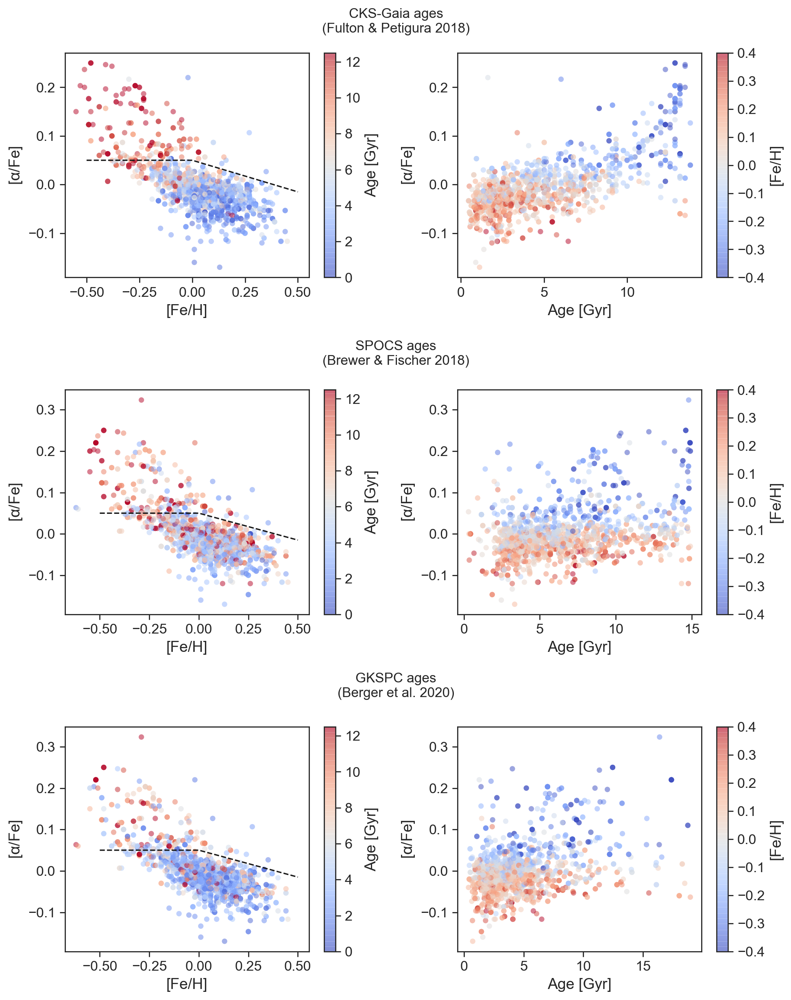

In [95]:
sns.set(font_scale=1.4, style='ticks', context='paper')

ages = [df["cks_age"],
        df["bf18_Age"],
        df["b20_iso_age"]]

age_labels = ['CKS-Gaia ages\n(Fulton & Petigura 2018)',
              'SPOCS ages\n(Brewer & Fischer 2018)',
              'GKSPC ages\n(Berger et al. 2020)']


fig,ax = plt.subplots(nrows=len(ages), ncols=2, figsize=(10,4*len(ages)))

for i,age in enumerate(ages):
    sc1 = ax[i][0].scatter(df["bf18_[Fe/H]"], 
                       df["bf18_[alpha/Fe]"], lw=0, alpha=0.5,
                       c=age, cmap='coolwarm', vmin=0, vmax=12.5, rasterized=True)
    
    sc2 = ax[i][1].scatter(age, 
                       df["bf18_[alpha/Fe]"], lw=0, alpha=0.5,
                       c=df["bf18_[Fe/H]"], cmap='coolwarm', vmin=-0.4, vmax=0.4, rasterized=True)    
    
    cb1 = fig.colorbar(sc1, ax=ax[i][0])
    cb2 = fig.colorbar(sc2, ax=ax[i][1])
    
    cb1.set_label("Age [Gyr]")
    cb2.set_label("[Fe/H]")
    
    ax[i][0].set_xlabel('[Fe/H]')
    ax[i][1].set_xlabel('Age [Gyr]')
    
    ax[i][0].set_ylabel(r'[$\mathregular{\alpha}$/Fe]')
    ax[i][1].set_ylabel(r'[$\mathregular{\alpha}$/Fe]')
    #ax[i][0].set_title(age_labels[i])
    #ax[i][0].plot([-0.5,0.5],[0.08,-0.015], 'k--')
    ax[i][0].plot([-0.5,0,0.5],[0.05,0.05,-0.015], 'k--')
    
    
    #ax[i][0].plot(np.linspace(-0.5,0.5,100),thin_thick_line(np.linspace(-0.5,0.5,100)), 'k--')
    #ax[i][0].axhline(0.05, ls='--')
    
    plt.figtext(0.5, 1.01-0.34*i, age_labels[i], va="center", ha="center", size=12)
    

plt.tight_layout()
plt.subplots_adjust(hspace=0.5)
#plt.savefig('./figures/alpha.pdf')
plt.show()

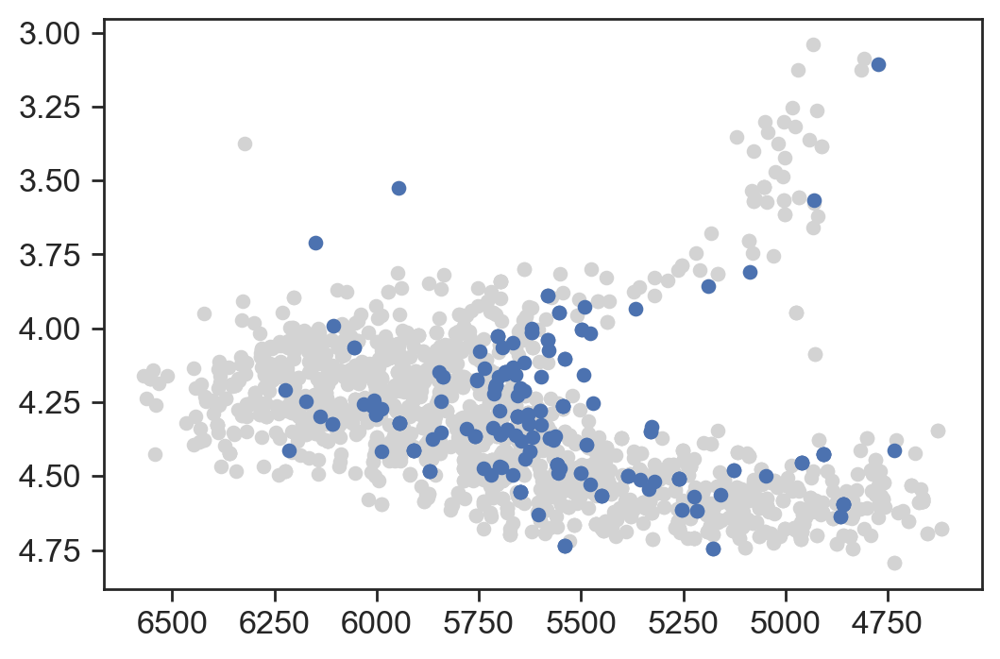

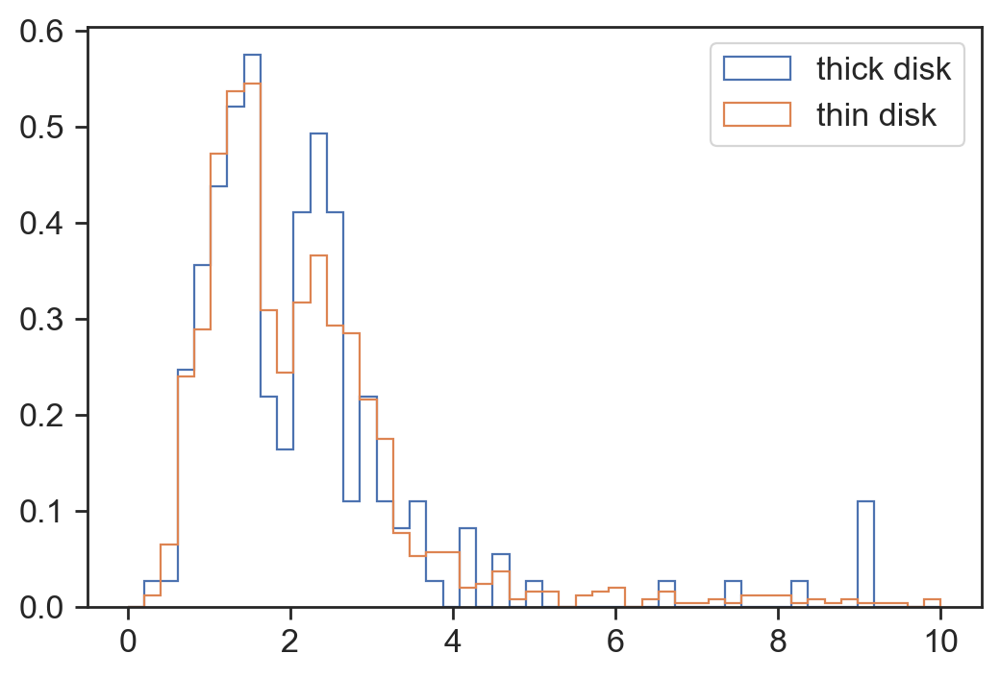

KeyError: 'yal_ratio'

In [96]:
thick = df['bf18_[alpha/Fe]'] > 0.05
thin  = df['bf18_[alpha/Fe]'] < 0.05

plt.scatter(df['p20_cks_steff'], df['p20_cks_slogg'], color='lightgrey')
plt.scatter(df['p20_cks_steff'][thick], df['p20_cks_slogg'][thick])
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.show()

plt.hist(df['cks_Rp'][thick], bins=np.linspace(0,10,50), label='thick disk', histtype='step', density=True)
plt.hist(df['cks_Rp'][thin], bins=np.linspace(0,10,50), label='thin disk', histtype='step', density=True)
plt.legend()
plt.show()


plt.scatter(df['cks_age'][thick], df['yal_ratio'][thick], zorder=99)
plt.scatter(df['cks_age'][thin], df['yal_ratio'][thin])
plt.show()

### [Y/Mg] ages from Brewer & Fischer 2016 catalog

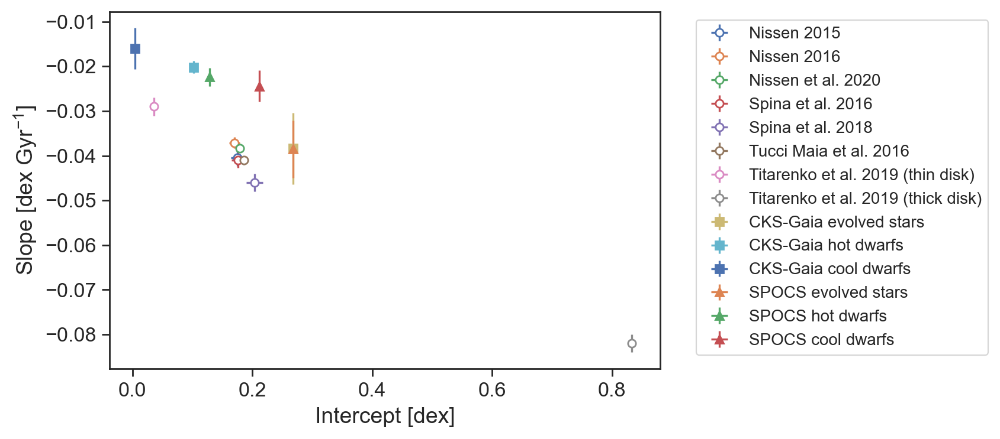

In [97]:
ymg_slopes = {'Nissen 2015': (0.175, 0.011, -0.0404, 0.0019),
              'Nissen 2016': (0.170, 0.009, -0.0371, 0.0013),
              'Nissen et al. 2020': (0.179, 0.007, -0.03831, 0.001),
              'Spina et al. 2016': (0.176, 0.011, -0.0410, 0.0017),
              'Spina et al. 2018': (0.204, 0.014, -0.046, 0.002),
              'Tucci Maia et al. 2016': (0.186, 0.008, -0.041, 0.001),
              'Titarenko et al. 2019 (thin disk)': (0.036,0.005, -0.029,0.002),
              'Titarenko et al. 2019 (thick disk)': (0.833,0.006, -0.082,0.002)}

cks_slopes = {'CKS-Gaia evolved stars': (0.2675, 0, -0.03838, 0.008),
              'CKS-Gaia hot dwarfs': (0.1021, 0, -0.0202, 0.0014),
              'CKS-Gaia cool dwarfs': (0.0040, 0, -0.0160, 0.0046)}



spocs_slopes = {'SPOCS evolved stars': (0.2681, 0, -0.0385, 0.0064),
              'SPOCS hot dwarfs': (0.1289, 0, -0.0224, 0.0021),
              'SPOCS cool dwarfs': (0.2115, 0, -0.0244, 0.0035)}

for i,key in enumerate(ymg_slopes):
    plt.errorbar(ymg_slopes[key][0], ymg_slopes[key][2], 
                 xerr=ymg_slopes[key][1], 
                 yerr=ymg_slopes[key][3], fmt='o', label=key, mfc="white")
    
    
for i,key in enumerate(cks_slopes):
    plt.errorbar(cks_slopes[key][0], cks_slopes[key][2], 
                 xerr=cks_slopes[key][1], 
                 yerr=cks_slopes[key][3], fmt='s', label=key)
    
    
for i,key in enumerate(spocs_slopes):
    plt.errorbar(spocs_slopes[key][0], spocs_slopes[key][2], 
                 xerr=spocs_slopes[key][1], 
                 yerr=spocs_slopes[key][3], fmt='^', label=key)    
    
    
    
plt.xlabel('Intercept [dex]')
plt.ylabel(r'Slope [dex Gyr$^\mathregular{-1}$]')
plt.legend(bbox_to_anchor=(1.05, 1), prop={'size':10})

In [98]:
df["ymg_ratio"] = np.nan*np.ones(len(df))
df["ymg_ratio_err"] = np.nan*np.ones(len(df))

df["yfe_ratio"] = np.nan*np.ones(len(df))
df["yfe_ratio_err"] = np.nan*np.ones(len(df))

df["mgfe_ratio"] = np.nan*np.ones(len(df))
df["mgfe_ratio_err"] = np.nan*np.ones(len(df))

df["yal_ratio"] = np.nan*np.ones(len(df))
df["yal_ratio_err"] = np.nan*np.ones(len(df))

df["ymg_age_n20"] = np.nan*np.ones(len(df))
df["ymg_age_err_n20"] = np.nan*np.ones(len(df))

df["yal_age_s18"] = np.nan*np.ones(len(df))
df["yal_age_err_s18"] = np.nan*np.ones(len(df))

def abundance_age(ratio,
                  kind='ymg',
                  author='nissen2020'):
    
    if (kind=='ymg') & (author=='nissen2020'):
        c0,ec0 = 0.179, 0.007
        c1,ec1 = -0.0383, 0.001
        
    elif (kind=='srmg') & (author=='nissen2020'):
        c0,ec0 = 0.169, 0.007 
        c1,ec1 = -0.0346, 0.0010
        
    elif (kind=='ymg') & (author=='nissen2016'):
        c0,ec0 = 0.170, 0.009
        c1,ec1 = -0.0371, 0.0013
        
    elif (kind=='yal') & (author=='nissen2016'):
        c0,ec0 = 0.196, 0.009
        c1,ec1 = -0.0427, 0.0014
        
    elif (kind=='almg') & (author=='nissen2016'):
        c0,ec0 = -0.027, 0.005
        c1,ec1 = 0.0057, 0.0008

    elif (kind=='ymg') & (author=='spina2016'):
        c0,ec0 = 0.176, 0.011
        c1,ec1 = -0.0410, 0.0017
        #scatter 0.029 dex

    elif (kind=='yal') & (author=='spina2016'):
        c0,ec0 = 0.194, 0.011
        c1,ec1 = -0.0459, 0.0018
        #scatter 0.029 dex
        
    elif (kind=='ymg') & (author=='spina2018'):
        c0,ec0 = 0.204, 0.014
        c1,ec1 = -0.046, 0.002

    elif (kind=='yal') & (author=='spina2018'):
        c0,ec0 = 0.231, 0.014
        c1,ec1 = -0.051, 0.002    
        
    elif (kind=='ymg') & (author=='nissen2015'):
        c0, ec0 = 0.175, 0.011
        c1, ec1 = -0.0404, 0.0019
        
    elif (kind=='ymg') & (author=='tuccimaia2016'):
        #c0,ec0 = 4.5, 0.09
        #c1,ec1 = -24.18, 0.66
        #age = c0+c1*ratio
        #0.8 Gyr precision for data with quality similar to that employed in their work
        c0,ec0 = 0.186, 0.008
        c1,ec1 = -0.041, 0.001
        
    elif (kind=='ymg') & (author=='titarenko2019_thindisk'):
        c0,ec0 = 0.036,0.005
        c1,ec1 = -0.029,0.002
        
    elif (kind=='ymg') & (author=='titarenko2019_thickdisk'):
        c0,ec0 = 0.833,0.006
        c1,ec1 = -0.082,0.002        
        
        
    #Incorporate delgado mena    
    
        
    age = (ratio-c0)/c1
        
    return age


#ymg = c0 * c1*age
#age = x0 * x1*ymg
#(age - x0)/x1 = c0 * c1*age



nsim = int(1e4)

for i in range(len(df)):
    if np.isfinite(df["bf18_[Y/H]"].iloc[i]):
        
        yt, e_yt = df["bf18_[Y/H]"].iloc[i], df["bf18_e_[Y/H]"].iloc[i]
        mg, e_mg = df["bf18_[Mg/H]"].iloc[i], df["bf18_e_[Mg/H]"].iloc[i]        
        al, e_al = df["bf18_[Al/H]"].iloc[i], df["bf18_e_[Al/H]"].iloc[i]
        fe, e_fe = df["bf18_[Fe/H]"].iloc[i], df["bf18_e_[Fe/H]"].iloc[i]
        
        yt_mc = np.random.normal(yt, e_yt, nsim)
        mg_mc = np.random.normal(mg, e_mg, nsim)
        al_mc = np.random.normal(al, e_al, nsim)
        fe_mc = np.random.normal(fe, e_fe, nsim)
        
        ymg_ratio = yt_mc-mg_mc
        ymg_ratio_med, ymg_ratio_err = np.median(ymg_ratio), np.std(ymg_ratio)
        
        yal_ratio = yt_mc-al_mc
        yal_ratio_med, yal_ratio_err = np.median(yal_ratio), np.std(yal_ratio)        
        
        yfe_ratio = yt_mc-fe_mc
        yfe_ratio_med, yfe_ratio_err = np.median(yfe_ratio), np.std(yfe_ratio)
        
        mgfe_ratio = mg_mc-fe_mc
        mgfe_ratio_med, mgfe_ratio_err = np.median(mgfe_ratio), np.std(mgfe_ratio)        
        
        df["ymg_ratio"].iloc[i] = ymg_ratio_med
        df["ymg_ratio_err"].iloc[i] = ymg_ratio_err
        
        df["yal_ratio"].iloc[i] = yal_ratio_med
        df["yal_ratio_err"].iloc[i] = yal_ratio_err        
        
        df["yfe_ratio"].iloc[i] = yfe_ratio_med
        df["yfe_ratio_err"].iloc[i] = yfe_ratio_err
        
        df["mgfe_ratio"].iloc[i] = mgfe_ratio_med
        df["mgfe_ratio_err"].iloc[i] = mgfe_ratio_err        

        ymg_age = abundance_age(ymg_ratio, kind="ymg", author="nissen2020")
        
        df["ymg_age_n20"].iloc[i] = np.median(ymg_age)
        df["ymg_age_err_n20"].iloc[i] = np.std(ymg_age)
        
        yal_age = abundance_age(yal_ratio, kind="yal", author="spina2018")
        
        df["yal_age_s18"].iloc[i] = np.median(yal_age)
        df["yal_age_err_s18"].iloc[i] = np.std(yal_age)        

<ipython-input-98-2b9f96dcf46a>:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df["ymg_ratio"] = np.nan*np.ones(len(df))
<ipython-input-98-2b9f96dcf46a>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df["ymg_ratio_err"] = np.nan*np.ones(len(df))
<ipython-input-98-2b9f96dcf46a>:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame,

### Nissen et al. 2020 tables
Define "Sun-like" stars here

In [99]:
nis_t1 = Table.read("http://cdsarc.unistra.fr/ftp/J/A+A/640/A81/table1.dat",
                readme="http://cdsarc.unistra.fr/ftp/J/A+A/640/A81/ReadMe",
                format="ascii.cds")

nis_t2 = Table.read("http://cdsarc.unistra.fr/ftp/J/A+A/640/A81/table2.dat",
                readme="http://cdsarc.unistra.fr/ftp/J/A+A/640/A81/ReadMe",
                format="ascii.cds")

nis = join(nis_t1,nis_t2)

nis['ymg_ratio'] = nis['[Y/Fe]'] - nis['[Mg/Fe]']
nis['yal_ratio'] = nis['[Y/Fe]'] - nis['[Al/Fe]']

# n20_sun_like = (df.cks_Teff>5600)&(df.cks_Teff<5950)&\
#                (df.p20_cks_slogg>4.2)&(df.p20_cks_slogg<4.53)&\
#                (df['cks_[Fe/H]']>-0.3)&(df['cks_[Fe/H]']<0.3) & (df['bf18_S/N']>30)


n20_sun_like = (df['bf18_Teff']>5600)&(df['bf18_Teff']<5950)&\
               (df['bf18_log(g)']>4.2)&(df['bf18_log(g)']<4.53)&\
               (df['bf18_[Fe/H]']>-0.3)&(df['bf18_[Fe/H]']<0.3) #& (df['bf18_S/N']>30)


nis = nis.to_pandas()
nis = nis.replace(9.999, np.nan)

nis.head()

,HD,Teff,logg-sp,Vturb,[Fe/H],[alpha/Fe],Zs,logL,Age,e_Age,...,[Al/Fe],[Si/Fe],[Ca/Fe],[Ti/Fe],[Cr/Fe],[Ni/Fe],[Sr/Fe],[Y/Fe],ymg_ratio,yal_ratio
0,361,5892,4.524,1.05,-0.130,-0.003,0.0135,-0.021,1.5,0.9,...,-0.042,-0.013,0.027,0.019,0.002,-0.056,0.106,0.079,0.093,0.121
1,1461,5760,4.372,1.03,0.190,0.009,0.0275,0.077,5.5,0.5,...,0.044,0.014,-0.016,0.007,0.005,0.045,-0.052,-0.039,-0.046,-0.083
2,2071,5724,4.486,0.96,-0.087,0.013,0.0152,-0.076,4.1,0.9,...,-0.001,0.002,0.024,0.029,0.005,-0.029,0.032,0.039,0.038,0.040
3,4915,5662,4.513,0.93,-0.212,0.042,0.0121,-0.154,3.8,1.3,...,0.020,0.014,0.045,0.064,0.006,-0.037,0.036,0.032,-0.016,0.012
4,6204,5857,4.517,1.05,0.046,-0.038,0.0188,-0.034,-0.4,1.0,...,-0.078,-0.044,0.019,-0.009,0.005,-0.064,0.129,0.122,0.184,0.200


## Which are the most age-sensitive abundance ratios?

In [100]:
def age_sensitivity_search(age_col='cks', plot=False):

    abcols = []
    taus = []
    pvals = []
    scatter = []
    
    if age_col=='cks':
        x = df['cks_age']
        xerr=[df['cks_e_age'],df['cks_E_age']]
    elif age_col=='spocs':
        x = df['bf18_Age']
        xerr = [df['bf18_e_Age'], df['bf18_E_Age']]
    elif age_col=='berger':
        x = df['b20_iso_age']
        xerr = [-df['b20_iso_age_err2'], df['b20_iso_age_err1']]
    elif age_col=='lu':
        x = df['l20_kin_age']
        xerr = 1.8*np.ones(len(x))
        
    
    z = df['bf18_[Fe/H]']    

    for col in df.columns:
        if 'bf18_[' in col:

            y = df[col]

            _ = (np.isfinite(x)) & (np.isfinite(y))
            #tau,pval = stats.kendalltau(x[_], y[_])
            #tau,pval = stats.spearmanr(x[_], y[_])
            #tau,pval = stats.pearsonr(x[_], y[_])
            
            if plot==True:
                fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(4,3.5))            

                ax.errorbar(x, y, 
                            xerr=xerr, 
                            fmt='.', ecolor='lightgrey', lw=0.5)

                sc = ax.scatter(x, y, c=z, cmap='viridis', zorder=999, s=6)
                cb = fig.colorbar(sc, ax=ax)

                if pval>0.001:
                    ax.set_title(r'$\rho$ ='+str(np.round(rho,3))+'\n'+"{:.4f}".format(pval))    
                elif pval<0.001:
                    ax.set_title(r'$\rho$ ='+str(np.round(rho,3))+'\n p-value < 0.001')


                ax.set_xlabel('Age [Gyr]')
                ax.set_ylabel(col.split("bf18_")[1])

                ax.set_ylim(-1.5,1.5)
                cb.set_label('[Fe/H]')
                plt.tight_layout()
                plt.savefig('./figures/age-abundance-trends/'+col.split("bf18_[")[1].replace("/","").rstrip("]")+'.pdf')
                plt.close()

            abcols.append(col)
            taus.append(tau)
            pvals.append(pval)
            
    abcols = np.array(abcols)
    taus   = np.array(taus)
    pvals  = np.array(pvals)            
            
    return abcols, taus, pvals

abcols, taus_cks, pvals_cks = age_sensitivity_search(age_col='cks')
abcols, taus_spocs, pvals_spocs = age_sensitivity_search(age_col='spocs')
abcols, taus_berg, pvals_berg = age_sensitivity_search(age_col='berger')
abcols, taus_lu, pvals_lu = age_sensitivity_search(age_col='lu')

In [101]:
order      = np.argsort(abs(taus_cks))[::-1]        
abcols     = abcols[order]
taus_cks   = taus_cks[order]; pvals_cks = pvals_cks[order]
taus_spocs = taus_spocs[order]; pvals_spocs = pvals_spocs[order]
taus_berg  = taus_berg[order]; pvals_berg = pvals_berg[order]
taus_lu    = taus_lu[order]; pvals_lu = pvals_lu[order]

pvals_cks[pvals_cks<0.001] = 0.001
pvals_spocs[pvals_spocs<0.001] = 0.001
pvals_berg[pvals_berg<0.001] = 0.001
pvals_lu[pvals_lu<0.001] = 0.001

for i in range(len(abcols)):
    print(abcols[i].split("bf18_")[1], '&', np.round(taus_cks[i],3), '&', np.round(pvals_cks[i],3), 
          '&', np.round(taus_spocs[i],3), '&', np.round(pvals_spocs[i],3), 
          '&', np.round(taus_berg[i],3), '&', np.round(pvals_berg[i],3),
          '&', np.round(taus_lu[i],3), '&', np.round(pvals_lu[i],3))

[alpha/Fe] & 0.678 & 0.001 & 0.328 & 0.001 & 0.377 & 0.001 & 0.232 & 0.001
[Mg/Fe] & 0.643 & 0.001 & 0.431 & 0.001 & 0.384 & 0.001 & 0.324 & 0.001
[Cr/Mg] & -0.62 & 0.001 & -0.398 & 0.001 & -0.348 & 0.001 & -0.313 & 0.001
[Ti/Fe] & 0.608 & 0.001 & 0.083 & 0.001 & 0.266 & 0.001 & 0.157 & 0.001
[Cr/Ti] & -0.599 & 0.001 & -0.106 & 0.001 & -0.269 & 0.001 & -0.169 & 0.001
[Cr/H] & -0.597 & 0.001 & -0.223 & 0.001 & -0.283 & 0.001 & -0.143 & 0.001
[Fe/H] & -0.592 & 0.001 & -0.218 & 0.001 & -0.283 & 0.001 & -0.134 & 0.001
[Y/H] & -0.585 & 0.001 & -0.417 & 0.001 & -0.396 & 0.001 & -0.203 & 0.001
[Ca/H] & -0.549 & 0.001 & -0.215 & 0.001 & -0.233 & 0.001 & -0.151 & 0.001
[Mn/H] & -0.53 & 0.001 & -0.044 & 0.07 & -0.179 & 0.001 & -0.063 & 0.014
[M/H] & -0.526 & 0.001 & -0.169 & 0.001 & -0.244 & 0.001 & -0.079 & 0.002
[Mn/Al] & -0.523 & 0.001 & -0.259 & 0.001 & -0.308 & 0.001 & -0.184 & 0.001
[Mn/Mg] & -0.51 & 0.001 & 0.006 & 0.812 & -0.14 & 0.001 & -0.092 & 0.001
[Mn/C] & -0.502 & 0.001 & -0.1 & 0.

[Al/O] & -0.012 & 0.633 & 0.306 & 0.001 & 0.191 & 0.001 & 0.108 & 0.001
[Y/N] & -0.01 & 0.711 & -0.063 & 0.009 & -0.012 & 0.633 & -0.055 & 0.031
[N/Fe] & -0.009 & 0.719 & 0.017 & 0.478 & -0.021 & 0.395 & 0.038 & 0.134
[Ni/Ca] & -0.009 & 0.735 & 0.23 & 0.001 & 0.051 & 0.042 & 0.225 & 0.001
[Ni/Na] & 0.007 & 0.788 & -0.141 & 0.001 & -0.044 & 0.074 & 0.001 & 0.963
[Cr/N] & 0.007 & 0.793 & -0.019 & 0.428 & 0.02 & 0.433 & -0.04 & 0.117
[V/Ti] & 0.002 & 0.953 & 0.244 & 0.001 & 0.126 & 0.001 & 0.031 & 0.226


/Users/tdavid/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:306: RuntimeWarning: invalid value encountered in sqrt
  sigma = np.sqrt(sigsq)


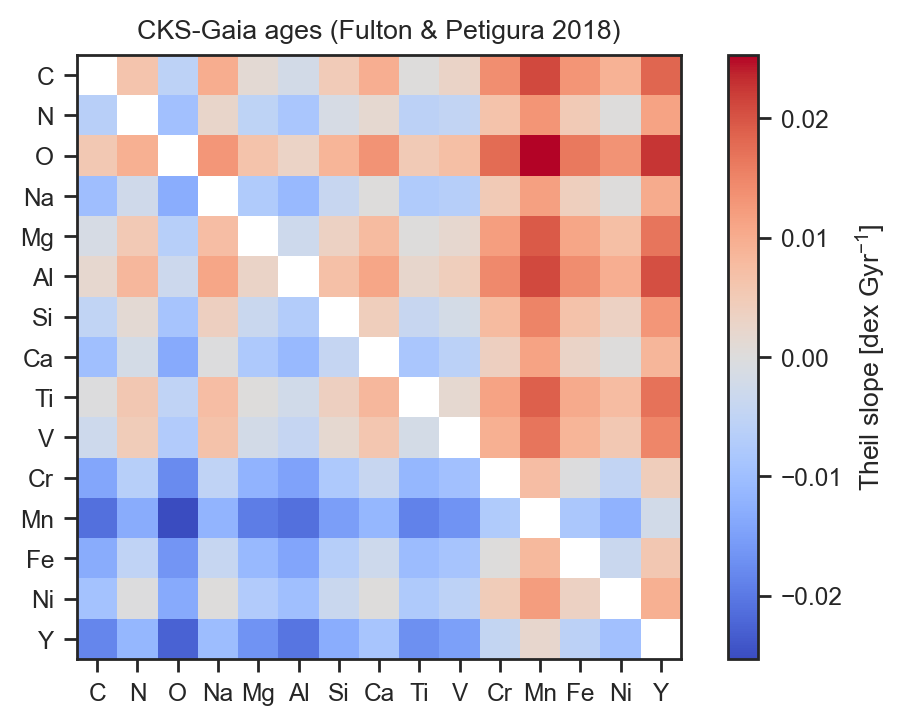

In [63]:
def age_sensitivity_matrix(age_ref='cks', 
                           corr_test='pearson',
                           sun_like=False,
                           fig_path=None):
    
    
    sns.set(style="ticks", context="paper")
    
    n20_sun_like = (df.cks_Teff>5600)&(df.cks_Teff<5950)&\
               (df.p20_cks_slogg>4.2)&(df.p20_cks_slogg<4.53)&\
               (df['cks_[Fe/H]']>-0.3)&(df['cks_[Fe/H]']<0.3) & (df['bf18_S/N']>30)
    

    elems = ["C","N","O","Na","Mg","Al","Si","Ca","Ti","V","Cr","Mn","Fe","Ni","Y"]
    c = np.zeros((len(elems),len(elems)))
    p = np.zeros((len(elems),len(elems)))

    if age_ref=='cks':
        age = df['cks_age']
        title = 'CKS-Gaia ages (Fulton & Petigura 2018)'
    elif age_ref=='spocs':
        age = df['bf18_Age']
        title = 'SPOCS ages (Brewer & Fischer 2018)'
    elif age_ref=='berger':
        age = df['b20_iso_age']
        title = 'GKSPC ages (Berger et al. 2020)'
    elif age_ref=='lu':
        age = df['l20_kin_age']
        title = 'Gyro-kinematic ages (Lu et al. 2021)'

    for i in range(len(elems)):
        for j in range(len(elems)):
        
            el1 = elems[i]
            el2 = elems[j]

            x1, e_x1 = df["bf18_["+el1+"/H]"], df["bf18_e_["+el1+"/H]"]
            x2, e_x2 = df["bf18_["+el2+"/H]"], df["bf18_e_["+el2+"/H]"]

            ratio = x1-x2
            _ = (np.isfinite(age)) & (np.isfinite(ratio))
            
            if sun_like == True:
                _ &= n20_sun_like
                
            
            if corr_test == 'pearson':
                coeff,pval = stats.pearsonr(age[_], ratio[_])
            elif corr_test == 'spearman':
                coeff,pval = stats.spearmanr(age[_], ratio[_])
            elif corr_test == 'kendall':
                coeff,pval = stats.kendalltau(age[_], ratio[_])
            elif corr_test == 'theil':
                
                try:
                    res = stats.theilslopes(ratio[_], age[_], 0.90)
                    coeff, pval = res[0], 0
                except:
                    coeff, pval = np.nan, 0
            
            c[i,j] = coeff
            p[i,j] = pval
        
        
    c[p>0.001] = np.nan    
        
    sns.set_style("ticks")
    plt.title(title)
    plt.imshow(c, cmap='coolwarm')
    plt.xticks(np.arange(len(elems)), elems)
    plt.yticks(np.arange(len(elems)), elems)
    
    if corr_test == 'theil':
        plt.colorbar(label=r'Theil slope [dex Gyr$^\mathregular{-1}$]')
    else:
        plt.colorbar(label='Correlation coefficient')
        
    if fig_path:
        plt.savefig(fig_path)
    plt.show()
    
    return


age_sensitivity_matrix(age_ref='cks', corr_test='theil', sun_like=False, fig_path='./figures/agematrix-cks.pdf')
#age_sensitivity_matrix(age_ref='spocs', corr_test='theil', sun_like=False, fig_path='./figures/agematrix-spocs.pdf')
#age_sensitivity_matrix(age_ref='berger', corr_test='theil', sun_like=True, fig_path='./figures/agematrix-berger.pdf')
#age_sensitivity_matrix(age_ref='lu', corr_test='theil', sun_like=True, fig_path='./figures/agematrix-lu.pdf')

# Compute slope and intercept of age trend in HRD cells

In [366]:
teff_grid = np.linspace(4500,7000,40)
feh_grid  = np.linspace(-0.4,0.4,40)
logg_grid = np.linspace(3.,5.,40)



x = df['cks_age']
y = df['bf18_[Y/Mg]']
S = np.zeros((len(teff_grid),len(logg_grid)))
Slo = np.zeros((len(teff_grid),len(logg_grid)))
Shi = np.zeros((len(teff_grid),len(logg_grid)))
I = np.zeros((len(teff_grid),len(logg_grid)))

X,Y = np.meshgrid(teff_grid,logg_grid)

for i,t in enumerate(teff_grid):
    for j,g in enumerate(logg_grid):
        m = (abs(df['p20_cks_steff']-t)<100) & (abs(df['p20_cks_slogg']-g)<0.1)     
        
        if len(x[m])>10:
        
            medslope, medintercept, lo_slope, hi_slope = stats.theilslopes(y[m], x[m], 0.90)
        
            S[i,j] = medslope
            Slo[i,j] = lo_slope
            Shi[i,j] = hi_slope
            I[i,j] = medintercept

        else:
            pass


CKS-Gaia  & [Y/Mg] &  Evolved stars & 0.24785 & -0.03549 _{- 0.00372 }^{+ 0.00370 }
CKS-Gaia  & [Y/Al] &  Evolved stars & 0.28610 & -0.04511 _{- 0.00539 }^{+ 0.00545 }
CKS-Gaia  & [Y/Mg] &  Hot dwarfs & 0.09755 & -0.01960 _{- 0.00146 }^{+ 0.00149 }
CKS-Gaia  & [Y/Al] &  Hot dwarfs & 0.16256 & -0.02520 _{- 0.00205 }^{+ 0.00209 }
CKS-Gaia  & [Y/Mg] &  Cool dwarfs & 0.00598 & -0.01708 _{- 0.00461 }^{+ 0.00463 }
CKS-Gaia  & [Y/Al] &  Cool dwarfs & -0.03455 & -0.01689 _{- 0.00527 }^{+ 0.00443 }


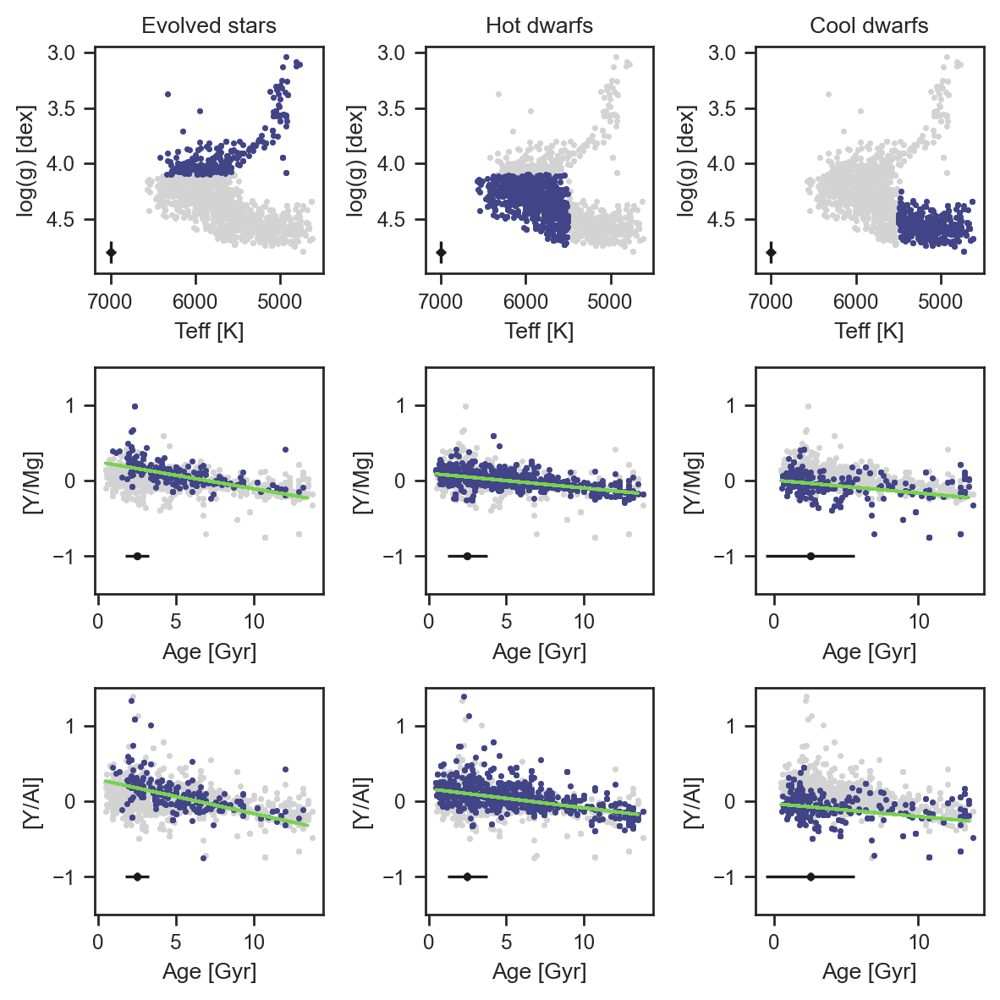

In [119]:
def hrd_compare(source='cks',
               fig_path=None):
    sns.set(style="ticks", context="paper")
    colors = sns.color_palette("viridis", 4)
 
    if source=='cks':
        teff = df['p20_cks_steff']
        teff_err = np.max([df['p20_cks_steff_err1'],df['p20_cks_steff_err2']],axis=0)
        logg = df['p20_cks_slogg']
        logg_err = np.max([df['p20_cks_slogg_err1'],df['p20_cks_slogg_err2']],axis=0)
        feh  = df['p20_cks_smet']
        age  = df['cks_age']
        age_lerr  = df['cks_e_age']
        age_uerr  = df['cks_E_age']
        tex_column = 'CKS-Gaia'

    elif source=='spocs':
        teff = df['bf18_Teff']
        teff_err = df['bf18_e_Teff']
        logg = df['bf18_log(g)']
        logg_err = df['bf18_e_log(g)']
        age  = df['bf18_Age']
        age_lerr  = df['bf18_e_Age']
        age_uerr  = df['bf18_E_Age']
        tex_column = 'SPOCS'
        
    elif source=='berger':
        teff = df['b20_iso_teff']
        teff_err = np.max([-df['b20_iso_teff_err2'], df['b20_iso_teff_err1']],axis=0)
        logg = df['b20_iso_logg']
        logg_err = np.max([-df['b20_iso_logg_err2'], df['b20_iso_logg_err1']],axis=0)
        age  = df['b20_iso_age']
        age_lerr  = -df['b20_iso_age_err2']
        age_uerr  = df['b20_iso_age_err1']
        tex_column = 'GKSPC'
        
    
    yal  = df['bf18_[Y/Al]']
    yal_err  = df['bf18_e_[Y/Al]']
    ymg  = df['bf18_[Y/Mg]']
    ymg_err = df['bf18_e_[Y/Mg]']
    
    group1 = (logg<4.1)
    group2 = (logg>=4.1) & (teff>=5500)
    group3 = (logg>=4.2) & (teff<5500)

    group_labels = ['Evolved stars', 'Hot dwarfs', 'Cool dwarfs']

    sc_kws = {"s":3, "rasterized":True}

    fig, ax = plt.subplots(nrows=3,ncols=3, figsize=(6,6))

    for i,group in enumerate([group1,group2,group3]):

        ax[0][i].set_title(group_labels[i])
        ax[0][i].scatter(teff, logg, color='lightgrey', **sc_kws)
        ax[0][i].scatter(teff[group], logg[group], **sc_kws, color=colors[0])
        ax[0][i].invert_xaxis()
        ax[0][i].invert_yaxis()
        ax[0][i].set_xlabel("Teff [K]"); ax[0][i].set_ylabel("log(g) [dex]")
        ax[0][i].errorbar(7000,4.8,
                          xerr=np.nanmedian(teff_err[group]),
                          yerr=np.nanmedian(logg_err[group]), fmt='.', color='k')

        ax[1][i].scatter(age, ymg, color='lightgrey', **sc_kws)
        ax[1][i].scatter(age[group], ymg[group], **sc_kws, color=colors[0])
        ax[1][i].errorbar(2.5,-1,
                          xerr=np.nanmedian(df['cks_age_maxerr'][group]), 
                          yerr=np.nanmedian(ymg_err[group]), fmt='.', color='k')


        _ = group & (np.isfinite(age)) & (np.isfinite(ymg)) & (np.isfinite(yal))


        medslope, medintercept, lo_slope, hi_slope = stats.theilslopes(ymg[_], age[_], 0.90)
        print(tex_column, " & [Y/Mg] & ", group_labels[i],"&",
              "{:.5f}".format(medintercept),"&", 
              "{:.5f}".format(medslope),"_{-",
              "{:.5f}".format(medslope-lo_slope),"}^{+",
              "{:.5f}".format(hi_slope-medslope),"}")

        ax[1][i].plot(age, medintercept+age*medslope, color=colors[3])
        ax[1][i].set_ylim(-1.5,1.5)
        ax[1][i].set_xlabel("Age [Gyr]"); ax[1][i].set_ylabel("[Y/Mg]")


        ax[2][i].scatter(age, yal, color='lightgrey', **sc_kws)
        ax[2][i].scatter(age[group], yal[group], **sc_kws, color=colors[0]) 
        ax[2][i].errorbar(2.5,-1,
                          xerr=np.nanmedian(df['cks_age_maxerr'][group]), 
                          yerr=np.nanmedian(yal_err[group]), fmt='.', color='k')    
        ax[2][i].set_xlabel("Age [Gyr]"); ax[2][i].set_ylabel("[Y/Al]")

        medslope, medintercept, lo_slope, hi_slope = stats.theilslopes(yal[_], age[_], 0.90)
        print(tex_column, " & [Y/Al] & ", group_labels[i],"&",
              "{:.5f}".format(medintercept),"&", 
              "{:.5f}".format(medslope),"_{-",
              "{:.5f}".format(medslope-lo_slope),"}^{+",
              "{:.5f}".format(hi_slope-medslope),"}")        
        
        ax[2][i].plot(age, medintercept+age*medslope, color=colors[3])
        ax[2][i].set_ylim(-1.5,1.5)    



    plt.tight_layout()
    if fig_path:
        plt.savefig(fig_path)
    plt.show()
                            
hrd_compare(source='cks', fig_path='./figures/hrdcompare-cks.pdf')

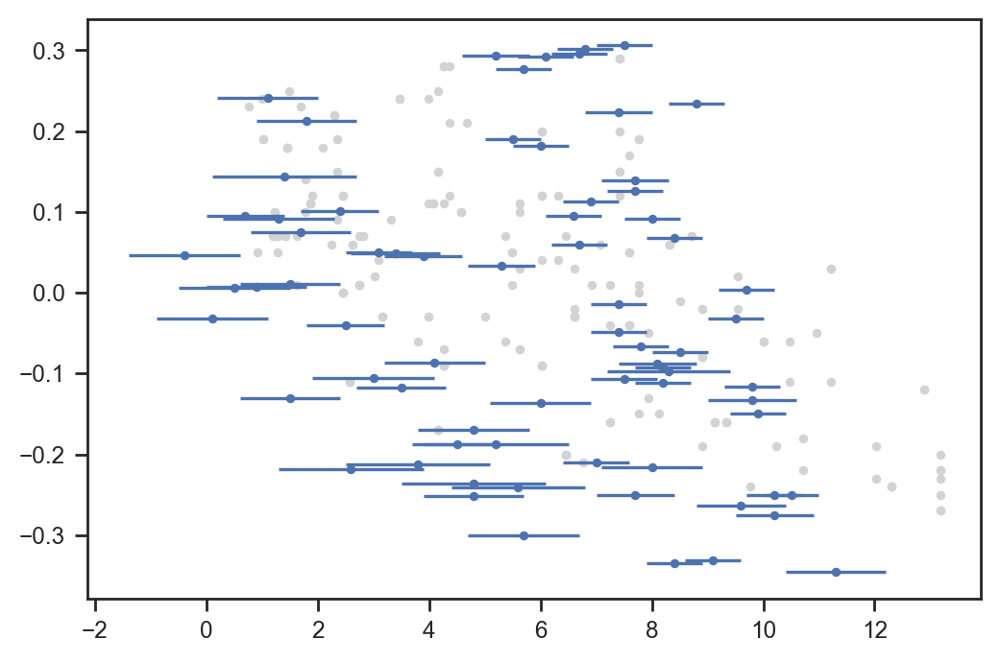

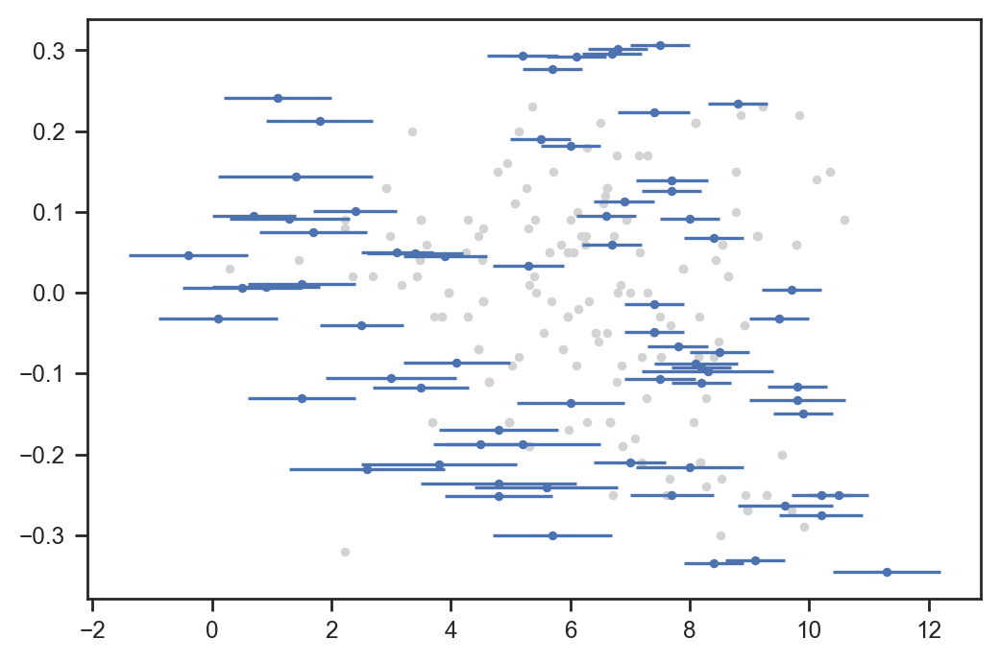

In [464]:
plt.errorbar(df['cks_age'][n20_sun_like], df['cks_[Fe/H]'][n20_sun_like], color='lightgrey', fmt='.')
plt.errorbar(nis['Age'], nis['[Fe/H]'], xerr=nis['e_Age'], fmt='.', zorder=99)
plt.show()

plt.errorbar(df['bf18_Age'][n20_sun_like], df['bf18_[Fe/H]'][n20_sun_like], color='lightgrey', fmt='.')
plt.errorbar(nis['Age'], nis['[Fe/H]'], xerr=nis['e_Age'], fmt='.', zorder=99)
plt.show()

### Comparison to Bedell et al. 2018

In [337]:
import astropy.constants as c
logg_sun = np.log10(c.GM_sun.cgs.value/(c.R_sun.cgs.value)**2.)
teff_sun = 5772.

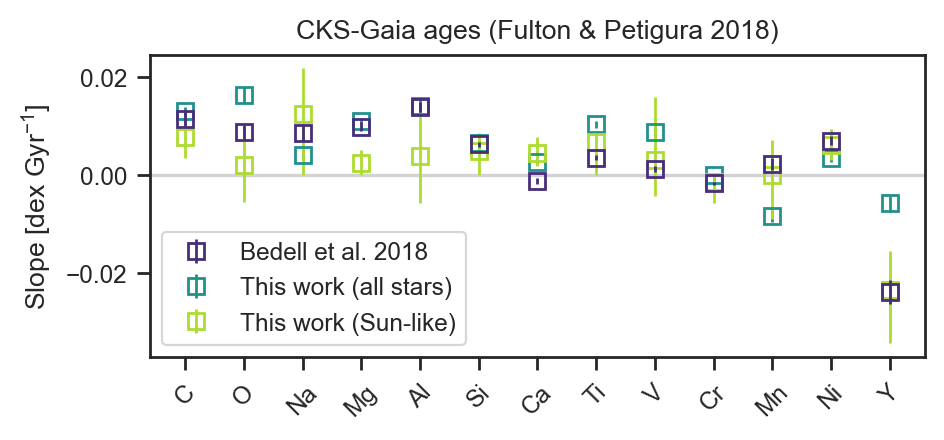

All stars RMS: 0.0039215050410609424
Sun-like stars RMS: 0.003221379409644824


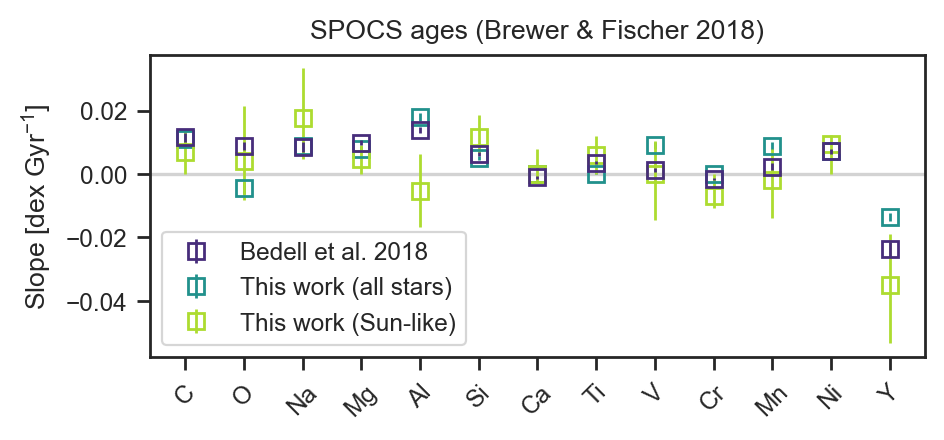

All stars RMS: 0.0019382165605095567
Sun-like stars RMS: 0.004775855130784708


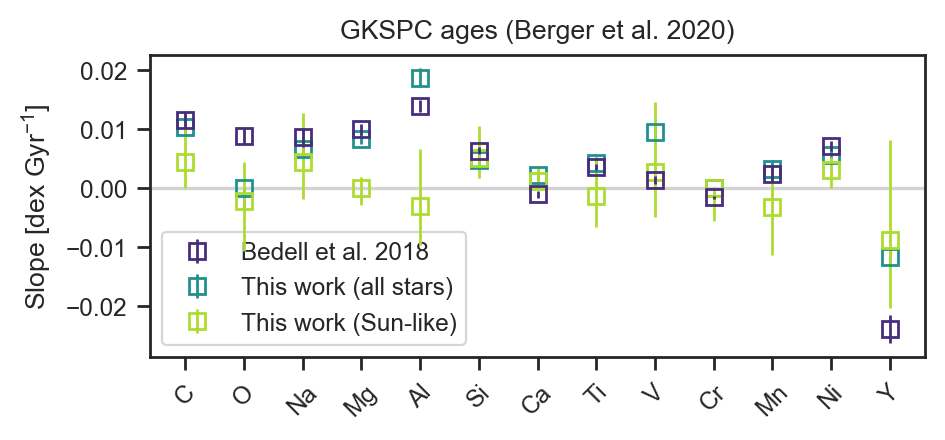

All stars RMS: 0.0016488372093023214
Sun-like stars RMS: 0.004935113484646194


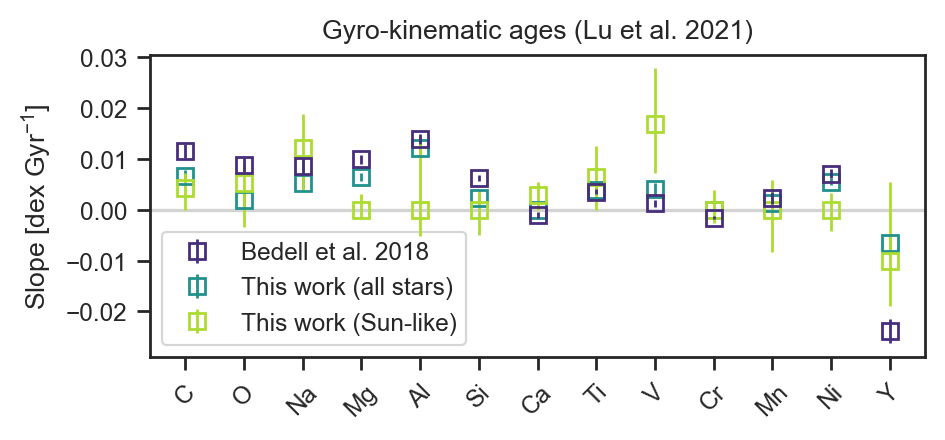

All stars RMS: 0.0027693658807460223
Sun-like stars RMS: 0.0063


In [341]:
def bedell_comparison(age_ref='cks',
                     fig_path=None):
    
    sns.set(context="paper", font_scale=1, style="ticks")
    
    colors = sns.color_palette("viridis", 7)
    
    
    if age_ref=='cks':
        age = df['cks_age']
        title = 'CKS-Gaia ages (Fulton & Petigura 2018)'
    elif age_ref=='spocs':
        age = df['bf18_Age']
        title = 'SPOCS ages (Brewer & Fischer 2018)'
    elif age_ref=='berger':
        age = df['b20_iso_age']
        title = 'GKSPC ages (Berger et al. 2020)'
    elif age_ref=='lu':
        age = df['l20_kin_age']
        title = 'Gyro-kinematic ages (Lu et al. 2021)'
    

    elems = ["C","O","Na","Mg","Al","Si","Ca","Ti","V","Cr","Mn","Ni","Y"]

    b18_sun_like = (abs(df.cks_Teff-teff_sun)<100)&\
                   (abs(df.p20_cks_slogg-logg_sun)<0.1)&\
                   (abs(df['cks_[Fe/H]'])<0.1)# & (df['bf18_S/N']>30)


    slopes = []
    intercepts = []
    lo_slopes = []
    hi_slopes = []

    sunlike_slopes = []
    sunlike_intercepts = []
    sunlike_lo_slopes = []
    sunlike_hi_slopes = []

    for el in elems:
        abundance = df["bf18_["+el+"/Fe]"]
        #age = df["b20_iso_age"]

        arg1 = (np.isfinite(abundance)) & (np.isfinite(age))
        arg2 = arg1 & b18_sun_like

        res = stats.theilslopes(abundance[arg1], age[arg1], 0.90)
        slope, intercept, lo_slope, hi_slope = res
        slopes.append(slope)
        intercepts.append(intercept)
        lo_slopes.append(lo_slope)
        hi_slopes.append(hi_slope)


        res = stats.theilslopes(abundance[arg2], age[arg2], 0.90)
        slope, intercept, lo_slope, hi_slope = res
        sunlike_slopes.append(slope)
        sunlike_intercepts.append(intercept)
        sunlike_lo_slopes.append(lo_slope)
        sunlike_hi_slopes.append(hi_slope)    


    slopes=np.array(slopes)
    intercepts=np.array(intercepts)
    lo_slopes=np.array(lo_slopes)
    hi_slopes=np.array(hi_slopes)

    sunlike_slopes=np.array(sunlike_slopes)
    sunlike_intercepts=np.array(sunlike_intercepts)
    sunlike_lo_slopes=np.array(sunlike_lo_slopes)
    sunlike_hi_slopes=np.array(sunlike_hi_slopes)
    
    mb = pd.read_csv('./tables/bedell2018_table3.csv', comment='#')

    xlabels = [s.split("I")[0] for s in mb['species']]

    eb_kws = {"fmt":"s", "mfc":"None", "alpha": 1, "ms":6, "mew":1, "lw":1}

    plt.errorbar(np.arange(len(mb)), mb['m'], yerr=mb['e_m'], **eb_kws, label='Bedell et al. 2018', color=colors[0], zorder=999)
    plt.errorbar(np.arange(len(slopes)), slopes, yerr=(slopes-lo_slopes, hi_slopes-slopes), **eb_kws, label='This work (all stars)', color=colors[3], zorder=99)
    plt.errorbar(np.arange(len(slopes)), sunlike_slopes, yerr=(sunlike_slopes-sunlike_lo_slopes, sunlike_hi_slopes-sunlike_slopes), **eb_kws, label='This work (Sun-like)', color=colors[6], zorder=99)
    plt.xticks(np.arange(len(mb)), xlabels, rotation=45)
    plt.gcf().set_size_inches(0.5*10,0.5*4)
    plt.ylabel(r'Slope [dex Gyr$^\mathregular{-1}$]')
    plt.axhline(0, color="lightgrey")
    plt.legend(loc='lower left')
    plt.title(title)
    if fig_path:
        plt.savefig(fig_path)
    plt.show()
    
     
    print('All stars RMS:', np.sqrt(np.median((mb['m']-slopes) ** 2)))
    print('Sun-like stars RMS:', np.sqrt(np.median((mb['m']-sunlike_slopes) ** 2)))
    
    return 

bedell_comparison(age_ref='cks', fig_path='./figures/bedell-cks.pdf')
bedell_comparison(age_ref='spocs', fig_path='./figures/bedell-spocs.pdf')
bedell_comparison(age_ref='berger', fig_path='./figures/bedell-berger.pdf')
bedell_comparison(age_ref='lu', fig_path='./figures/bedell-lu.pdf')

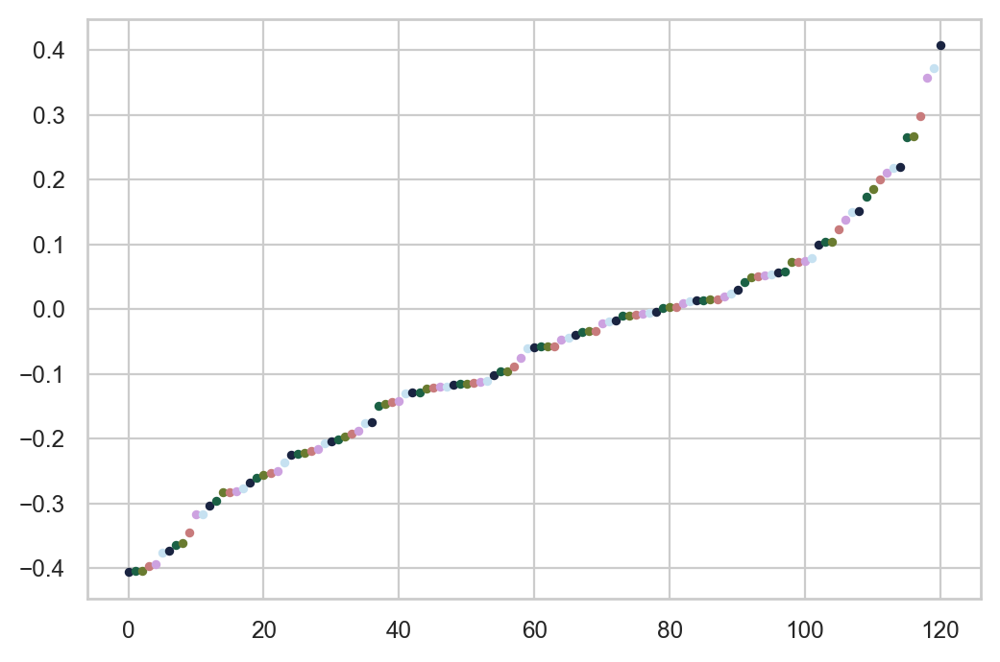

<Figure size 1200x400 with 0 Axes>

In [92]:
colors = sns.color_palette("viridis", 4)

tau_med = np.zeros(len(abcols))
tau_min = np.zeros(len(abcols))
tau_max = np.zeros(len(abcols))


for i,col in enumerate(abcols):
    _taus = [taus_cks[i],taus_spocs[i],taus_berg[i],taus_lu[i]]
    
    tau_med[i] = np.median(_taus)
    tau_min[i] = np.min(_taus)
    tau_max[i] = np.max(_taus)
    
    
order = np.argsort(tau_med)
abcols  = abcols[order]
tau_med = tau_med[order]
tau_min = tau_min[order]
tau_max = tau_max[order]

for i, col in enumerate(abcols):
    #print(tau_med[i]-tau_min[i], tau_max[i]-tau_med[i])
    #plt.errorbar(i, tau_med[i], yerr=, fmt='.')
    plt.plot(i, tau_med[i], '.')
    
    
plt.show()
plt.gcf().set_size_inches(12,4)
#plt.plot(np.ones(len(taus_cks)), abs(taus_cks), 'o')
#plt.show()

In [ ]:
#Adaptively define solar twin cut, making progressively broader then find the scatter in age relation

# Understanding the scatter in age-abundance relations

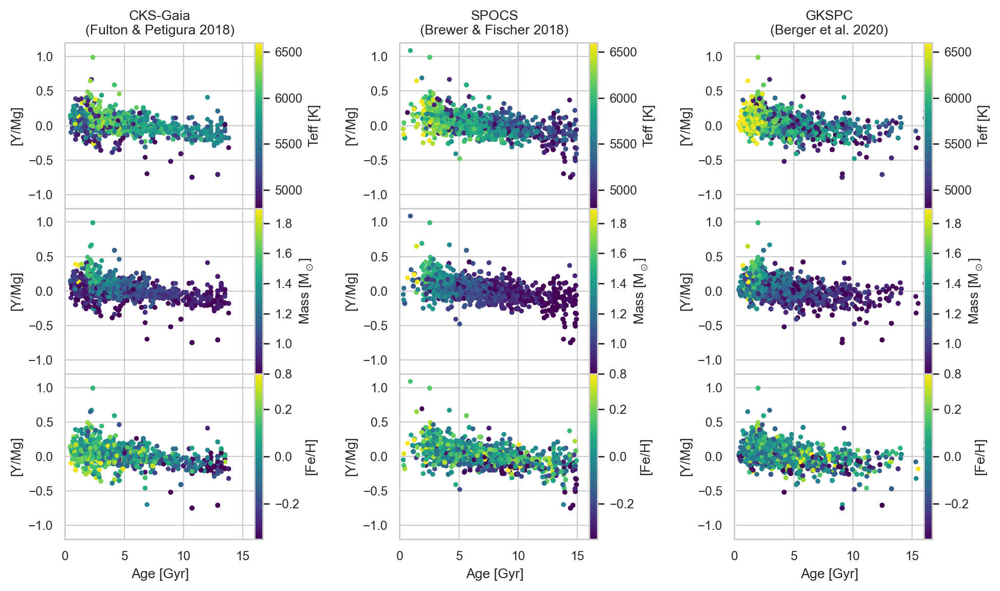

In [335]:
sns.set(context='paper', style='whitegrid')

fig,ax = plt.subplots(nrows=3,ncols=3,figsize=(0.8*14,0.8*8))

#sc_kws = {'cmap': 'viridis', 's': 8, "rasterized":True, 'edgecolors':'grey', 'lw':0.5}

#ages = [df['cks_logAiso'], np.log10(df['bf18_Age']*1e9), np.log10(df['b20_iso_age']*1e9)]
ages = [df['cks_age'], df['bf18_Age'], df['b20_iso_age']]
teff = [df['cks_Teff'], df['bf18_Teff'], df['b20_iso_teff']]
mass = [df['cks_Miso'], df['bf18_Mass'], df['b20_iso_mass']]
feh  = [df['cks_[Fe/H]'], df['bf18_[Fe/H]'], df['b20_iso_feh']]

ref_labels = ['CKS-Gaia\n(Fulton & Petigura 2018)',
              'SPOCS\n(Brewer & Fischer 2018)',
              'GKSPC\n(Berger et al. 2020)']

for i,a in enumerate(ages):
    ax[0][i].set_title(ref_labels[i])
    sc0 = ax[0][i].scatter(a, df['ymg_ratio'], c=teff[i], **sc_kws, vmin=4800, vmax=6600)
    sc1 = ax[1][i].scatter(a, df['ymg_ratio'], c=mass[i], **sc_kws, vmin=0.8, vmax=1.9)
    sc2 = ax[2][i].scatter(a, df['ymg_ratio'], c=feh[i], **sc_kws, vmin=-0.35, vmax=0.35)
    
    cb0 = fig.colorbar(sc0, ax=ax[0][i], pad=0)
    cb1 = fig.colorbar(sc1, ax=ax[1][i], pad=0)
    cb2 = fig.colorbar(sc2, ax=ax[2][i], pad=0)
    cb0.set_label('Teff [K]')
    cb1.set_label('Mass [$\mathregular{M_\odot}$]')
    cb2.set_label('[Fe/H]')
    
for i in range(3):
    #ax[2][i].set_xlabel(r'$\mathregular{log_{10}(age~yr^{-1})}$')
    ax[2][i].set_xlabel('Age [Gyr]')
    for j in range(3):
        ax[i][j].set_ylabel('[Y/Mg]')
        ax[i][j].set_ylim(-1.2,1.2)
        #ax[i][j].set_xlim(8.4,10.4)
        ax[i][j].set_xlim(0,16)
        if i<2:
            ax[i][j].set_xticklabels([])

plt.subplots_adjust(hspace=0, wspace=0.5)
plt.savefig('./figures/ymg-age-scatter.pdf')

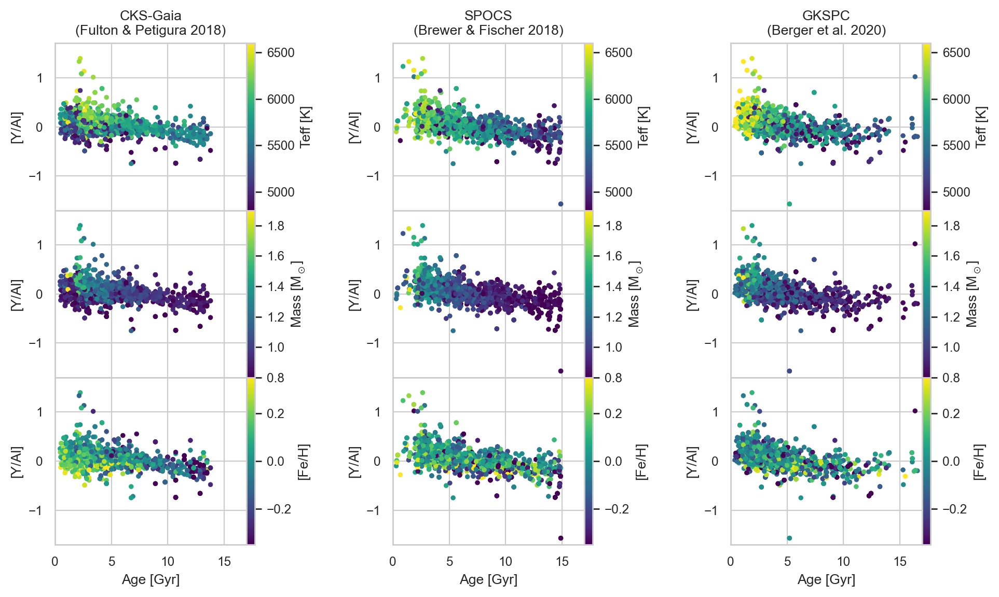

In [336]:
fig,ax = plt.subplots(nrows=3,ncols=3,figsize=(0.8*14,0.8*8))

#sc_kws = {'cmap': 'viridis', 's': 8, "rasterized":True, 'edgecolors':'grey', 'lw':0.5}

#ages = [df['cks_logAiso'], np.log10(df['bf18_Age']*1e9), np.log10(df['b20_iso_age']*1e9)]
ages = [df['cks_age'], df['bf18_Age'], df['b20_iso_age']]
teff = [df['cks_Teff'], df['bf18_Teff'], df['b20_iso_teff']]
mass = [df['cks_Miso'], df['bf18_Mass'], df['b20_iso_mass']]
feh  = [df['cks_[Fe/H]'], df['bf18_[Fe/H]'], df['b20_iso_feh']]


ref_labels = ['CKS-Gaia\n(Fulton & Petigura 2018)',
              'SPOCS\n(Brewer & Fischer 2018)',
              'GKSPC\n(Berger et al. 2020)']

for i,a in enumerate(ages):
    ax[0][i].set_title(ref_labels[i])
    sc0 = ax[0][i].scatter(a, df['yal_ratio'], c=teff[i], **sc_kws, vmin=4800, vmax=6600)
    sc1 = ax[1][i].scatter(a, df['yal_ratio'], c=mass[i], **sc_kws, vmin=0.8, vmax=1.9)
    sc2 = ax[2][i].scatter(a, df['yal_ratio'], c=feh[i], **sc_kws, vmin=-0.35, vmax=0.35)
    
    cb0 = fig.colorbar(sc0, ax=ax[0][i], pad=0)
    cb1 = fig.colorbar(sc1, ax=ax[1][i], pad=0)
    cb2 = fig.colorbar(sc2, ax=ax[2][i], pad=0)
    cb0.set_label('Teff [K]')
    cb1.set_label('Mass [$\mathregular{M_\odot}$]')
    cb2.set_label('[Fe/H]')
    
for i in range(3):
    #ax[2][i].set_xlabel(r'$\mathregular{log_{10}(age~yr^{-1})}$')
    ax[2][i].set_xlabel('Age [Gyr]')
    for j in range(3):
        ax[i][j].set_ylabel('[Y/Al]')
        ax[i][j].set_ylim(-1.7,1.7)
        #ax[i][j].set_xlim(8.4,10.4)
        ax[i][j].set_xlim(0,17)
        if i<2:
            ax[i][j].set_xticklabels([])
    

plt.subplots_adjust(hspace=0, wspace=0.5)
plt.savefig('./figures/yal-age-scatter.pdf')

# Solar twin comparison

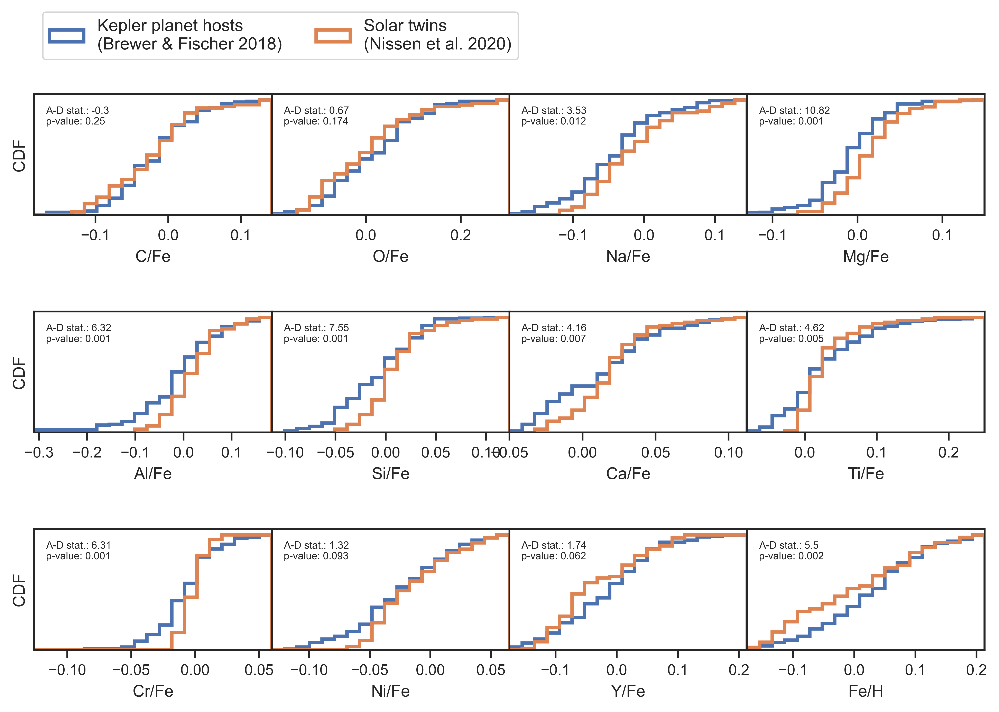

In [80]:
#berry = ['#6797aa', '#7d3f79', '#201e5b', '#dda3d1', '#805da4', '#0c0c0d']
#sns.set_palette()
#sns.set(font_scale=1, style='ticks', palette=sns.color_palette(berry))
#sns.set(font_scale=1, style='ticks', palette=sns.color_palette("cubehelix",3))

sns.set(context='paper', style='ticks')

elems = [['C','O','Na','Mg'],['Al','Si','Ca','Ti'],['Cr','Ni','Y']]
el_class = ['V','','V','R','R',]
hist_kws = {"density":True, "histtype":"step", "lw":2, "cumulative": True}

from scipy.stats import anderson_ksamp

#fig, ax = plt.subplots(nrows=1,ncols=12,figsize=(24,2),dpi=300)
fig, ax = plt.subplots(nrows=3, ncols=4, figsize=(10,6), dpi=300)

#for i,el in enumerate(elems):

adstats = []
pvals = []


for i in range(3):
    for j in range(4):
        
        if (i==2) & (j==3):
            _x = df["bf18_[Fe/H]"]
            _x = _x[n20_sun_like&(df["koi_score"]>0.99)&(np.isfinite(_x))]
            _y = nis['[Fe/H]']
            _y = _y[(np.isfinite(_y))& (_y<9)]
            xlabel = 'Fe/H'
        
        else:
            
            el = elems[i][j]
            
            
            _x = df["bf18_["+el+"/H]"] - df["bf18_[Fe/H]"]
            _x = _x[n20_sun_like&(df["koi_score"]>0.99)&(np.isfinite(_x))]
    
            _y = nis["["+el+"/Fe]"]
            _y = _y[(np.isfinite(_y))& (_y<9)]

            bins = np.linspace(np.nanpercentile(_x[n20_sun_like],1),np.nanpercentile(_x[n20_sun_like],99),20)
            #bins=20
            
            xlabel = el+'/Fe'

        cax = ax[i][j]

        cax.hist(_x, **hist_kws, bins=bins, label='Kepler planet hosts\n(Brewer & Fischer 2018)')
        cax.hist(_y, **hist_kws, bins=bins, label='Solar twins\n(Nissen et al. 2020)')
        cax.set_xlabel(xlabel)
        cax.set_yticks([])
        cax.set_xlim(bins.min(),bins.max())
        
        #if i==0:
            #cax.legend(bbox_to_anchor=(-2.75, 1.05), loc='upper left', ncol=1, prop={'size':14})

        if (i==0) & (j==0):
            cax.legend(bbox_to_anchor=(0, 1.75), loc='upper left', ncol=2, prop={'size':10})        


        ad_result = anderson_ksamp([_x, _y], midrank=True)
        pval = ad_result.significance_level
        adstat = ad_result.statistic
        #cax.text(0.05,1.05,'A-D stat.: '+str(np.round(adstat, 2))+'\np-value: '+str(np.round(pval, 5)), transform=cax.transAxes, size=12)            
        cax.text(0.05,0.75,'A-D stat.: '+str(np.round(adstat, 2))+'\np-value: '+str(np.round(pval, 3)), transform=cax.transAxes, size=6)            
            
            
        adstats.append(adstat)
        pvals.append(pval)
    
#     _x = df["bf18_["+el+"/H]"] - df["bf18_[Fe/H]"]
#     _x = _x[n20_sun_like&(df["koi_score"]>0.99)&(np.isfinite(_x))]
    
#     _y = nis["["+el+"/Fe]"]
#     _y = _y[(np.isfinite(_y))& (_y<9)]
    
#     bins = np.linspace(np.nanpercentile(_x[n20_sun_like],0.01),np.nanpercentile(_x[n20_sun_like],99.99),20)
#     #bins=20
    
#     cax = ax[i]
    
#     cax.hist(_x, **hist_kws, bins=bins, label='Kepler planet hosts\n(Brewer & Fischer 2018)')
#     cax.hist(_y, **hist_kws, bins=bins, label='Solar twins\n(Nissen et al. 2020)')
#     cax.set_xlabel(el+'/Fe', fontsize=12)
#     cax.set_yticks([])
#     cax.set_xlim(bins.min(),bins.max())
#     #if i==0:
#         #cax.legend(bbox_to_anchor=(-2.75, 1.05), loc='upper left', ncol=1, prop={'size':14})
        
#     if i==0:
#         cax.legend(bbox_to_anchor=(0, 1.75), loc='upper left', ncol=2, prop={'size':14})        
        
    
#     ad_result = anderson_ksamp([_x, _y], midrank=True)
#     pval = ad_result.significance_level
#     adstat = ad_result.statistic
#     cax.text(0.05,1.05,'A-D stat.: '+str(np.round(adstat, 2))+'\np-value: '+str(np.round(pval, 5)), transform=cax.transAxes, size=12)
    
#     #print(el, ad_result.statistic, pval)
    
    
# _x = df["bf18_[Fe/H]"]
# _x = _x[n20_sun_like&(df["koi_score"]>0.99)&(np.isfinite(_x))]
# _y = nis['[Fe/H]']
# _y = _y[(np.isfinite(_y))& (_y<9)]

# bins = np.linspace(np.nanpercentile(_x,0.1),np.nanpercentile(_x,99.9),20)
# ax[11].hist(_x, **hist_kws, bins=bins, label='BF18')
# ax[11].hist(_y, **hist_kws, bins=bins, label='N20')
# ax[11].set_xlabel('Fe/H')
# ax[11].set_yticks([])
# ad_result = anderson_ksamp([_x, _y], midrank=True)
# pval = ad_result.significance_level
# adstat = ad_result.statistic

# ax[11].text(0.05,1.05,'A-D stat.: '+str(np.round(adstat, 2))+'\np-value: '+str(np.round(pval, 4)), transform=ax[11].transAxes, size=12)
# ax[11].set_xlim(bins.min(),bins.max())
# #print('Fe', pval)

for i in range(3):
    ax[i][0].set_ylabel('CDF')

plt.subplots_adjust(wspace=0, hspace=0.8)
plt.savefig('./figures/solartwin-comparison.pdf')

#plt.tight_layout()    
# bf18_[C/H]
# bf18_[N/H]
# bf18_[O/H]
# bf18_[Na/H]
# bf18_[Mg/H]
# bf18_[Al/H]
# bf18_[Si/H]
# bf18_[Ca/H]
# bf18_[Ti/H]
# bf18_[V/H]
# bf18_[Cr/H]
# bf18_[Mn/H]
# bf18_[Fe/H]
# bf18_[Ni/H]
# bf18_[Y/H]

#nis.columns
#[C/Fe]
#[O/Fe]
#[Na/Fe]
#[Mg/Fe]
#[Al/Fe]
#[Si/Fe]
#[Ca/Fe]
#[Ti/Fe]
#[Cr/Fe]
#[Ni/Fe]
#[Sr/Fe]
#[Y/Fe]

### Empirical open cluster gyrochrones ([Curtis et al. 2020](https://arxiv.org/abs/2010.02272))
We will use published gyrochrones derived from open clusters to empirically age-rank planet hosts

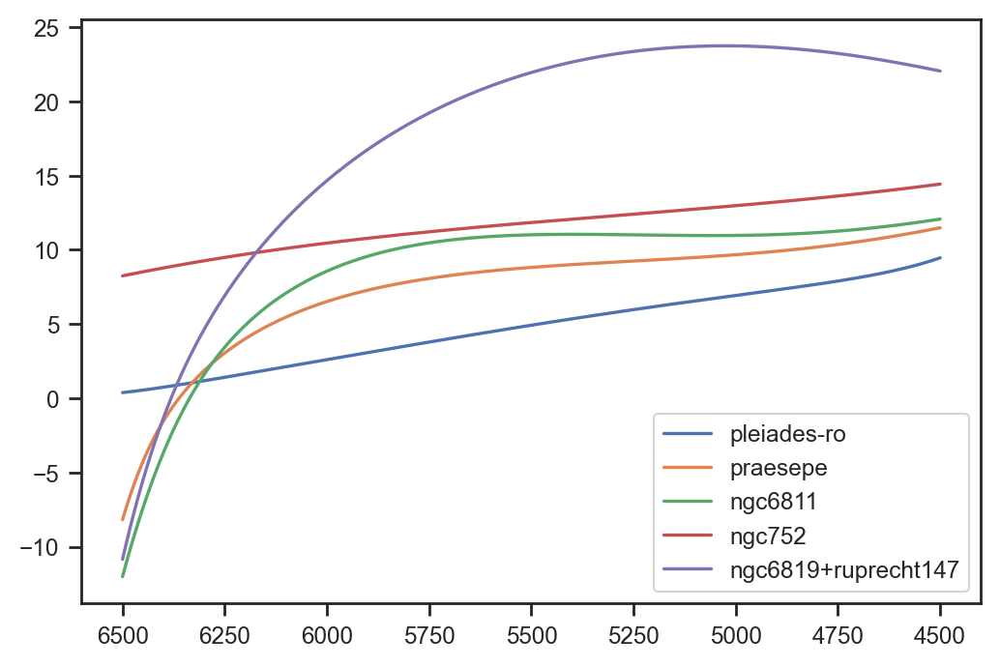

In [163]:
# Curtis et al. 2020 table
def curtis_bprp_teff(bprp):
    #Estimating effective temperature from the dereddened Gaia DR2 (Bp-Rp) color
    bprp  = np.array(bprp)
    coeff = [-416.585, 39780.0, -84190.5, 85203.9, -48225.9, 15598.5, -2694.76, 192.865]    
    teff  = np.array([np.sum([co*_bprp**i for i,co in enumerate(coeff)]) for _bprp in bprp])
    mask  = (bprp>=0.55) & (bprp<=3.25)
    teff[~mask] = np.nan
    return teff

def curtis_gyrochrone(bprp, kind):
    bprp = np.array(bprp)
    
    if kind=='kepler': #Kepler lower envelope
        bprp_min, bprp_max = 0.6, 2.1
        coeff = [36.4756, -202.718, 414.752, -395.161, 197.800, -50.0287, 5.05738]
        
    elif kind=='pleiades-ro':
        bprp_min, bprp_max = 0.6, 1.3
        coeff = [37.068, -188.02, 332.32, -235.78, 60.395]

    elif kind=='pleiades-quad':
        bprp_min, bprp_max = 0.6, 1.3
        coeff = [-8.467, 19.64, -5.438]
        
    elif kind=='praesepe':
        bprp_min, bprp_max = 0.6, 2.4
        coeff = [-330.810, 1462.48, -2569.35, 2347.13, -1171.90, 303.620, -31.9227]
        
    elif kind=='ngc6811':
        bprp_min, bprp_max = 0.65, 1.95 
        coeff = [-594.019, 2671.90, -4791.80, 4462.64, -2276.40, 603.772, -65.0830]
        
    elif kind=='ngc752':
        bprp_min, bprp_max = 1.32, 2.24
        coeff = [6.80, 5.63] 
    
    elif kind=='ngc6819+ruprecht147':
        bprp_min, bprp_max = 0.62, 2.07
        coeff = [-271.783, 932.879, -1148.51, 695.539, -210.562, 25.8119]
        
    prot  = np.array([np.sum([co*_bprp**i for i,co in enumerate(coeff)]) for _bprp in bprp])
    mask  = (bprp>=bprp_min) & (bprp<=bprp_max)
    prot[~mask] = np.nan
    
    return prot
        

#Re-casting the Curtis et al. 2020 polynomial relations in Teff

from scipy import interpolate

def curtis_teff_gyrochrone(teff, kind):
    
    _bprp = np.linspace(0,5,10000)
    _teff = curtis_bprp_teff(_bprp)
    _prot = curtis_gyrochrone(_bprp, kind)
    
    _ = (np.isfinite(_teff)) & (np.isfinite(_prot))
    
    # Be cognizant that using "extrapolate" means the resulting relations will be unreliable
    # outside the Teff ranges over which they were derived, but for our purposes it is effective 
    f = interpolate.interp1d(_teff[_], _prot[_], kind='cubic', fill_value='extrapolate')
    
    return f(teff)


def curtis_teff_bprp(teff):
    #Invert Teff-BpRp relation
    
    _bprp = np.linspace(0.55,3.25,10000)
    _teff = curtis_bprp_teff(_bprp)
    
    _ = (np.isfinite(_teff)) & (np.isfinite(_bprp))
    
    # Be cognizant that using "extrapolate" means the resulting relations will be unreliable
    # outside the Teff ranges over which they were derived, but for our purposes it is effective 
    f = interpolate.interp1d(_teff[_], _bprp[_], kind='cubic', fill_value='extrapolate')
    
    return f(teff)


sequences = ['pleiades-ro', 'praesepe', 'ngc6811', 'ngc752', 'ngc6819+ruprecht147']

_teff = np.linspace(4500,6500,1000)

for seq in sequences:
    plt.plot(_teff, curtis_teff_gyrochrone(_teff, kind=seq), label=seq)

plt.legend()
plt.gca().invert_xaxis()    
plt.show()

### Empirical gyrochronology selection

In [130]:
m = (df['koi_score']>0.99)
m &= (df['koi_disposition']!='FALSE POSITIVE')
m &= (df['p17_Disp']!='FP')
m &= (df['cks_R']<1.0)
#m &= (df['gaia_d20_ruwe']<1.2)
m &= (df['koi_period']<100)
#m &= (df['cks_Rp']<10)
#m &= (df['b20b_Radius']<10)
#m &= (df['cks_Rp']>1.8)
#m &= (df['single_transit_snr']>1)
m &= (df['cks_Teff']<5750)
#m &= (df['cks_Teff']<5900)
#m &= (df['b20_iso_teff']>5000)
m &= (df['cks_E_Rp']/df['cks_Rp'] < 0.1)

#gyro = common_cuts & m_ruwe & (cks['f18_Teff']<6000.)

gyro_yng = m & (df['d21_prot']<curtis_teff_gyrochrone(df['cks_Teff'], kind='ngc6819+ruprecht147'))&\
               (df['d21_prot']>curtis_teff_gyrochrone(df['cks_Teff'], kind='pleiades-quad'))&\
               (df['d21_prot_numflag']>=3)

gyro_old = m & (df['d21_prot']>=curtis_teff_gyrochrone(df['cks_Teff'], kind='ngc6819+ruprecht147')) & (df['d21_prot_numflag']>=2)
#gyro_nop = m & (np.isnan(df['d21_prot']))
gyro_nop = m & (df['d21_prot_numflag']==0)

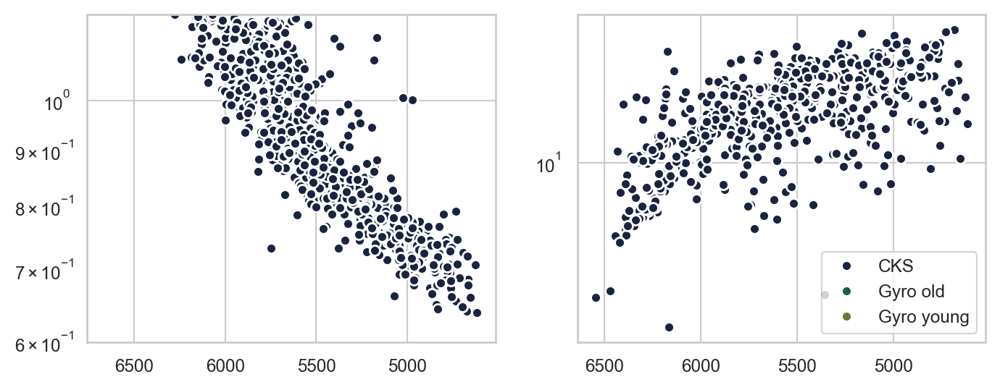

In [135]:
sc_kws = {'ms':5, 'mec': 'white'}

masks  = [np.ones(len(df), dtype=bool), gyro_old, gyro_yng]
labels = ['CKS', 'Gyro old', 'Gyro young']

fig,(ax1,ax2) = plt.subplots(nrows=1,ncols=2, figsize=(8,3))

for i,mask in enumerate(masks):
    ax1.plot(df['cks_Teff'][mask], df['cks_R'][mask], 'o', label=labels[i], **sc_kws)
    ax2.plot(df['cks_Teff'][mask], df['d21_prot'][mask], 'o', label=labels[i], **sc_kws)

for ax in [ax1,ax2]:
    ax.invert_xaxis()
    ax.semilogy()
#ax1.set_ylim(np.log10(0.5),np.log10(2))
ax1.set_ylim(0.6,1.2)
plt.legend()
plt.show()

In [128]:
from scipy import stats
from scipy.stats import anderson_ksamp

hist_kws = {"alpha": 0.4, "histtype":"step", "density":True, "lw":4, "bins":np.linspace(0,30,100)}

def cdf(x, nbins=100, normed=True, method=2):
    
    # Methods 1 & 2 return normalized CDF
    
    if method==1:    
        h,x1 = np.histogram(x, bins = nbins, normed=normed)
        dx = x1[1]-x1[0]
        f1 = np.cumsum(h)*dx
        cdfx, cdfy = x1[1:], f1

    elif method==2:
        x2 = np.sort(x)
        f2 = np.array(range(len(x)))/float(len(x))
        cdfx, cdfy = x2, f2
        
    elif method==3:
        from scipy import stats
        res  = stats.cumfreq(x, numbins=nbins)
        cdfx = res.lowerlimit + np.linspace(0, res.binsize*res.cumcount.size, res.cumcount.size)
        cdfy = res.cumcount
            
    return cdfx, cdfy


def plot_distributions(x1, x2,
                       labels=['label 1','label 2'], title=None):
    
    arg1 = (np.isfinite(x1))
    arg2 = (np.isfinite(x2))

    ad_result = anderson_ksamp([x1[arg1], x2[arg2]], midrank=False)

    #labels = ['sample', 'control']
    
    fig,(ax1,ax2) = plt.subplots(nrows=1,ncols=2,figsize=(7,2.5))
    
    hist_kws = {'histtype':'stepfilled', 'alpha':0.3, 
            'density':True, 
            'bins': np.linspace(0,10,40),
            'lw':2}
    for i,arr in enumerate([x1,x2]):
        ax1.hist(arr, **hist_kws, label=labels[i])
    
    #ax1.set_xlim(np.nanpercentile(x2,[0.1,99.]))
    #ax1.set_xlim(0,10)
    
    ax1.legend()
    ax1.set_xlabel('Radius [$\mathregular{R_\oplus}$]')
    ax1.set_ylabel('PDF')
    if title:
        ax1.set_title(title)
    
    for i,arr in enumerate([x1,x2]):
        _cdfx, _cdfy = cdf(arr)
        ax2.plot(_cdfx, _cdfy, label=labels[i])
        
    ax2.legend()
    #ax2.set_xlim(0,10)
    ax2.set_ylim(0,1)
    #ax2.set_xlim(np.nanpercentile(x2,[0.1,99.]))
    ax2.set_xlabel('Radius [$\mathregular{R_\oplus}$]')
    ax2.set_ylabel('CDF')
    
    
    adst = "{:.2f}".format(ad_result.statistic)
    pval = "{:.3f}".format(ad_result.significance_level)
    
    if ad_result.significance_level<0.25:
        ax2.text(0.45,0.45,'A-D stat. = '+adst+'\np-value = '+pval, transform=ax2.transAxes, size=8)
    elif ad_result.significance_level>=0.25:
        ax2.text(0.45,0.45,'A-D stat. = '+adst+'\np-value > '+pval, transform=ax2.transAxes, size=8)
    
    plt.tight_layout()
    plt.show()
    
    
def plot_arbitrary_distributions(x1, x2,
                                 labels=['label 1','label 2'], xlabel='', title=None):
    
    arg1 = (np.isfinite(x1))
    arg2 = (np.isfinite(x2))

    ad_result = anderson_ksamp([x1[arg1], x2[arg2]], midrank=False)
    
    fig,(ax1,ax2) = plt.subplots(nrows=1,ncols=2,figsize=(7,2.5))
    
    hist_kws = {'histtype':'step', 'alpha':0.7, 
            'density':True, 
            'bins': np.linspace(-0.3,0.3,15),
            'lw':2}
    
    for i,arr in enumerate([x1,x2]):
        ax1.hist(arr, **hist_kws, label=labels[i])
    
    ax1.legend()
    ax1.set_xlabel(xlabel)
    ax1.set_ylabel('PDF')
    if title:
        ax1.set_title(title)
    
    for i,arr in enumerate([x1,x2]):
        _cdfx, _cdfy = cdf(arr)
        ax2.plot(_cdfx, _cdfy, label=labels[i])
        
    ax2.legend()
    ax2.set_ylim(0,1)
    ax2.set_xlabel(xlabel)
    ax2.set_ylabel('CDF')
    
    adst = "{:.2f}".format(ad_result.statistic)
    pval = "{:.3f}".format(ad_result.significance_level)
    
    if ad_result.significance_level<0.25:
        ax2.text(0.7,0.05,'A-D stat. = '+adst+'\np-value = '+pval, transform=ax2.transAxes, size=8)
    elif ad_result.significance_level>=0.25:
        ax2.text(0.7,0.05,'A-D stat. = '+adst+'\np-value > '+pval, transform=ax2.transAxes, size=8)
    
    plt.tight_layout()
    plt.show()    

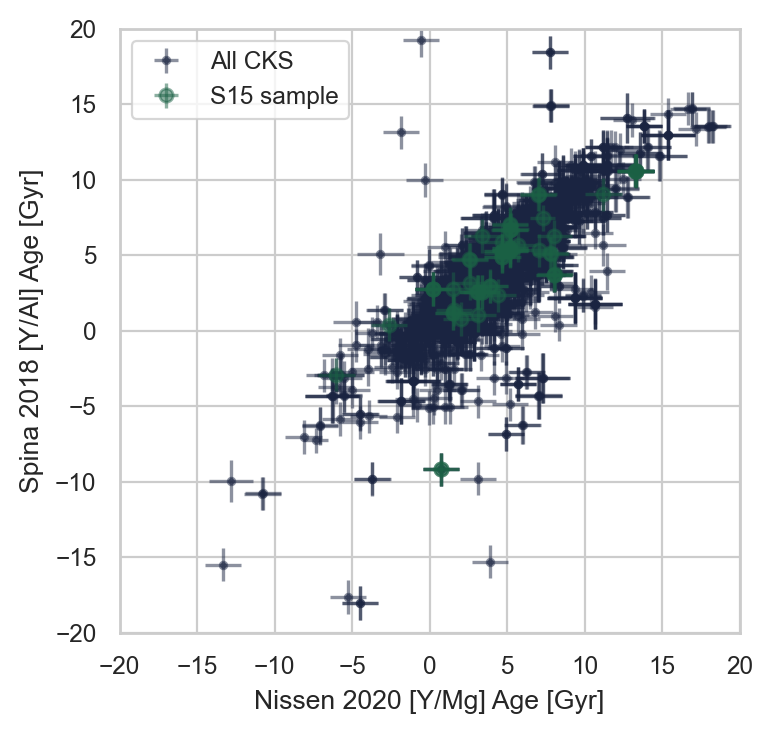

In [137]:
_ = (abs(df["ymg_age_n20"]-df["yal_age_s18"])<3*df["ymg_age_err_n20"]) & (abs(df["ymg_age_n20"]-df["yal_age_s18"])<3*df["yal_age_err_s18"])
__ = (np.isfinite(df["s15_Age"]))

plt.errorbar(df["ymg_age_n20"], df["yal_age_s18"], xerr=df["ymg_age_err_n20"], yerr=df["yal_age_err_s18"], fmt='.', label='All CKS', alpha=0.5)
#plt.errorbar(df["ymg_age_n20"][_], df["yal_age_s18"][_], xerr=df["ymg_age_err_n20"][_], yerr=df["yal_age_err_s18"][_], fmt='.')
plt.errorbar(df["ymg_age_n20"][__], df["yal_age_s18"][__], xerr=df["ymg_age_err_n20"][__], yerr=df["yal_age_err_s18"][__], fmt='o', zorder=99, label='S15 sample', alpha=0.5)

plt.xlabel("Nissen 2020 [Y/Mg] Age [Gyr]")
plt.ylabel("Spina 2018 [Y/Al] Age [Gyr]")
plt.gcf().set_size_inches(4,4)
plt.legend()
plt.xlim(-20,20)
plt.ylim(-20,20)
plt.show()

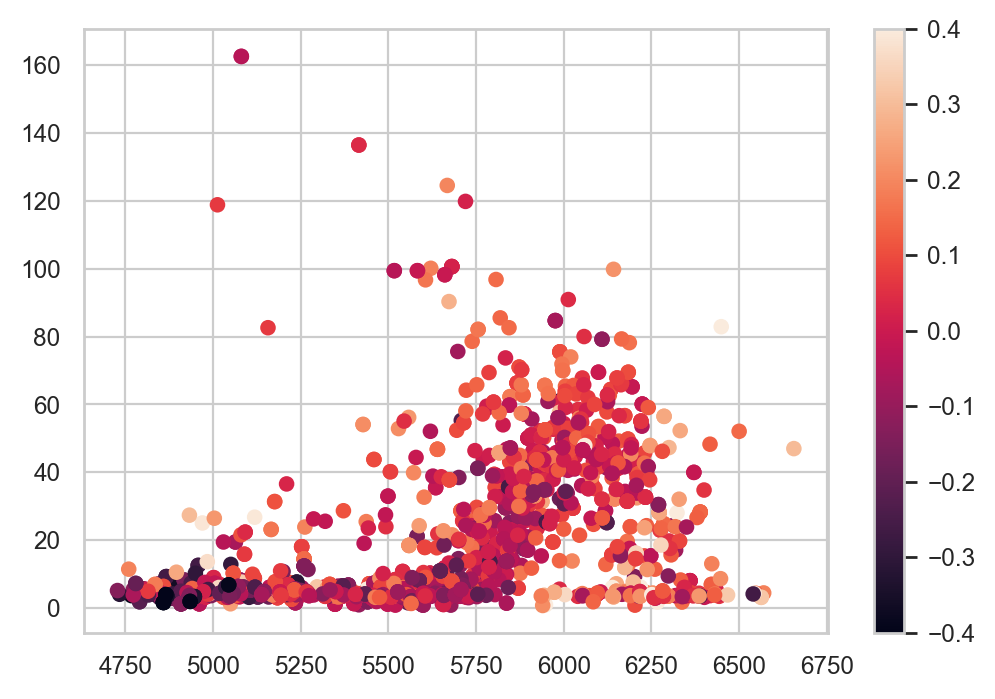

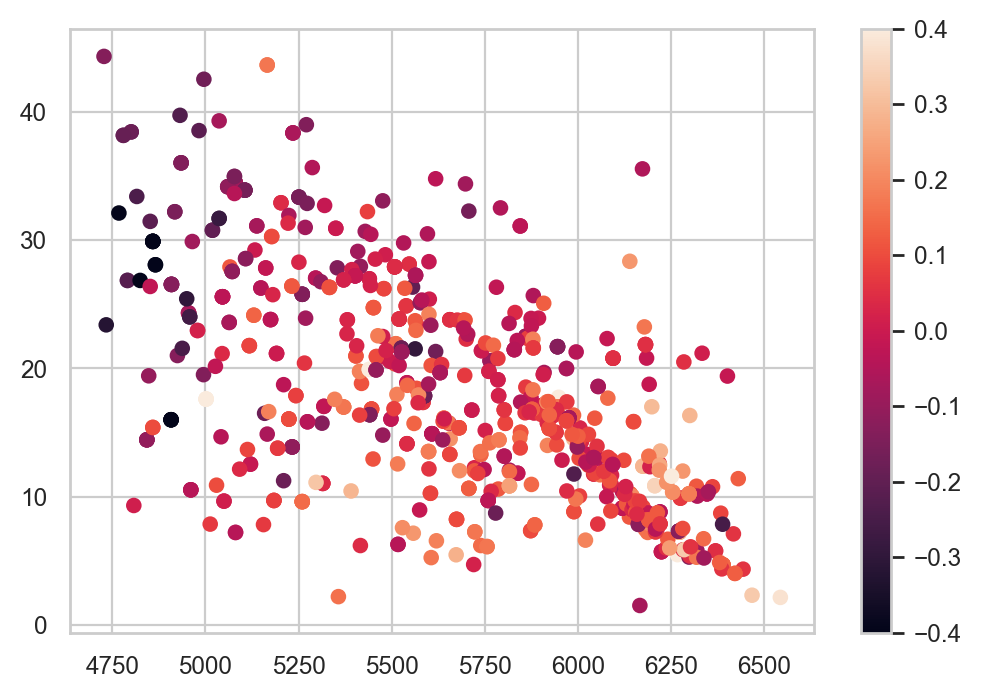

In [138]:
plt.scatter(df['b18_Teff'],df['b18_EW(Li)'],c=df['ymg_ratio'], vmin=-0.4, vmax=0.4)
plt.colorbar()
plt.show()

plt.scatter(df['cks_Teff'],df['d21_prot'],c=df['ymg_ratio'], vmin=-0.4, vmax=0.4)
plt.colorbar()
plt.show()

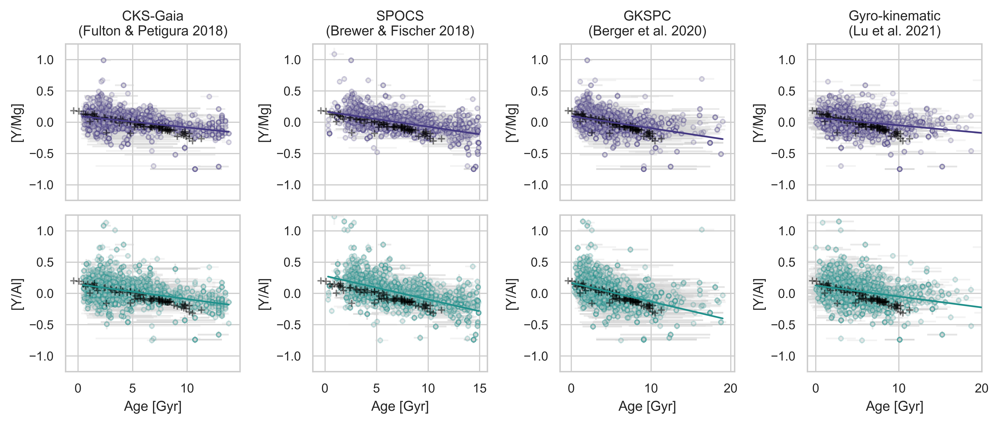

In [32]:
from matplotlib.figure import figaspect

colors = sns.color_palette("viridis", 5)
eb_kws = {'color':'lightgrey', 'alpha':0.25, 'fmt':'o', 'ms':3, 'rasterized':True}

ages = [df["cks_age"], 
        df["bf18_Age"],
        df["b20_iso_age"],
        df["l20_kin_age"]]

lerr = [df["cks_e_age"],
        df["bf18_e_Age"],
        -df["b20_iso_age_err2"], 
        1.8*np.ones(len(df))]

uerr = [df["cks_E_age"],
        df["bf18_E_Age"],
        df["b20_iso_age_err1"], 
        1.8*np.ones(len(df))]

ymg = df["ymg_ratio"]
ymg_err = df["ymg_ratio_err"]

yal = df["yal_ratio"]
yal_err = df["yal_ratio_err"]

age_labels = ['CKS-Gaia\n(Fulton & Petigura 2018)',
              'SPOCS\n(Brewer & Fischer 2018)',
              'GKSPC\n(Berger et al. 2020)',
              'Gyro-kinematic\n(Lu et al. 2021)']

fig,ax = plt.subplots(nrows=2, ncols=len(ages), figsize=(0.7*14,0.7*6), dpi=300)

for i,a in enumerate(ages):
    
    arg = (np.isfinite(a)) & (np.isfinite(ymg)) & (np.isfinite(yal))
    
    ax[0][i].errorbar(a, ymg, xerr=[lerr[i],uerr[i]], yerr=ymg_err, **eb_kws, mec=colors[0])
    ax[1][i].errorbar(a, yal, xerr=[lerr[i],uerr[i]], yerr=yal_err, **eb_kws, mec=colors[2])
    ax[0][i].set_ylim(-1.25,1.25)
    ax[1][i].set_ylim(-1.25,1.25)
    
    ax[0][i].plot(nis['Age'], nis['ymg_ratio'], 'k+', alpha=0.5, zorder=998)
    ax[1][i].plot(nis['Age'], nis['yal_ratio'], 'k+', alpha=0.5, zorder=998)
    
    z1 = np.polyfit(a[arg], ymg[arg], 1)
    p1 = np.poly1d(z1)
    
    z2 = np.polyfit(a[arg], yal[arg], 1)
    p2 = np.poly1d(z2)    
    
    z3 = np.polyfit(ymg[arg], a[arg], 1)
    p3 = np.poly1d(z3)
    
    z4 = np.polyfit(yal[arg], a[arg], 1)
    p4 = np.poly1d(z4)    
    
    if i==0:
        df['cks_age_ymg_resid'] = a - p3(ymg)
        df['cks_age_yal_resid'] = a - p4(yal)
        
    elif i==1:
        df['bf18_age_ymg_resid'] = a - p3(ymg)
        df['bf18_age_yal_resid'] = a - p4(yal)        
        
    elif i==2:
        df['b20_age_ymg_resid'] = a - p3(ymg)
        df['b20_age_yal_resid'] = a - p4(yal)
        
    elif i==3:
        df['l20_age_ymg_resid'] = a - p3(ymg)
        df['l20_age_yal_resid'] = a - p4(yal)
    
    
    ax[0][i].plot(np.sort(a),p1(np.sort(a)), color=colors[0], zorder=999)
    ax[1][i].plot(np.sort(a),p2(np.sort(a)), color=colors[2], zorder=999)
    
    ax[0][i].set_title(age_labels[i])
    ax[0][i].set_xticklabels([])
    ax[1][i].set_xlabel("Age [Gyr]")
    
    ax[0][i].set_ylabel("[Y/Mg]")
    ax[1][i].set_ylabel("[Y/Al]")
    
    
ax[0][3].set_xlim(-1,20)
ax[1][3].set_xlim(-1,20)

plt.subplots_adjust(hspace=0, wspace=0.25)
plt.tight_layout()
#plt.savefig('./figures/age-trends.pdf')
plt.show()

### Quantify what variables lead to scatter in ymg-age and yal-age relations

In [239]:
tmp1=[]
tmp2=[]

for col in df. columns:
    try:
        tmp1.append(col)
        #tmp2.append(abs(df['cks_age_ymg_resid'].corr(df[col], method='spearman')))
        tmp2.append(abs(df['bf18_age_ymg_resid'].corr(df[col], method='spearman')))
    except:
        pass
    
    
tmp1=np.array(tmp1)
tmp2=np.array(tmp2)

arg = np.isfinite(tmp2)
tmp1 = tmp1[arg]
tmp2 = tmp2[arg]

tmp1 = tmp1[np.argsort(tmp2)[::-1]]
tmp2 = tmp2[np.argsort(tmp2)[::-1]]

for i in range(len(tmp2)):
    print(tmp1[i], tmp2[i])

/Users/tdavid/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


bf18_Age 1.0
bf18_age_yal_resid 1.0
bf18_age_ymg_resid 1.0
bf18_B_Age 0.9769583772387
bf18_b_Age 0.9539304534282247
s15_Teff 0.9206270225346636
s15_Mass 0.8443853320401543
s15_L 0.8370826816025833
s15_E_Radius 0.8139910299281573
s15_e_L 0.7923556726549018
s15_Age 0.7911360912028197
s15_E_L 0.7813268586193335
p20_iso_slogage 0.7717703038419046
p20_iso_sage 0.7717703038419046
p20_v18_steff 0.7716011264547212
bf18_b_Mass 0.7691191633943647
bf18_Mass 0.7674101979820409
s15_E_Mass 0.7625323446608953
bf18_B_Mass 0.7621956889794052
bf18_vbroad 0.7560842770421349
s15_e_logg 0.7520709800565754
bf18_vmac 0.7454929525126022
s15_e_Radius 0.7365905344722253
p20_v18_smass 0.7206573315883135
s15_E_logg 0.7088963037089819
b18_Teff 0.7087478974156732
m19_Vturb 0.7060235367968145
p20_cks_steff 0.702815088726193
p20_iso_steff 0.7005280370334835
cks_Teff 0.7003240375026343
bf18_Teff 0.6997115158840036
p20_cks_svsini 0.6954105255066894
b20_iso_age_err2 0.6953740792658913
p20_iso_sage_err2 0.691267389980222

ch_q14_cdpp 0.05469569307952071
koi_comment 0.05415544697396968
ch_koi_sparprov 0.05410414013666525
ch_q10_tonsource 0.05394040119304623
gaia_feh_err2 0.05365273132459538
ch_q2_cdpp 0.05339127543549955
bf18_S/N 0.053120547591334166
ch_koi_ror_err2 0.05279150098659424
p20_koi_dor_err1 0.05231848060249906
p20_koi_dor_err2 0.05231848060249906
gaia_phot_bp_n_obs 0.052249857559815364
koi_tce_plnt_num 0.052209340446753336
ch_q8_ttotal 0.052136448277180045
m15_KIC 0.05208256591949909
b20_iso_feh 0.052014580599243
ch_q12_ttotal 0.0519287476739982
b20b_KIC 0.05170198151170507
koi_ror_err1 0.05164153576531246
p20_Rtau 0.051523674039816475
ch_q11_cdpp 0.05132276406008046
ch_koi_fittype 0.0512808036783036
ch_koi_dor_err2 0.05044485398584747
ch_koi_dor_err1 0.05044485398584747
p20_iso_steff_err2 0.05012138387600635
ch_q10_cdpp 0.05007671446013734
bf18_RAh 0.05006682190585433
koi_parm_prov 0.04989896172479881
koi_tce_delivname 0.04977244365483905
koi_impact 0.04928921835431884
ch_koi_dikco_mdec 0.04

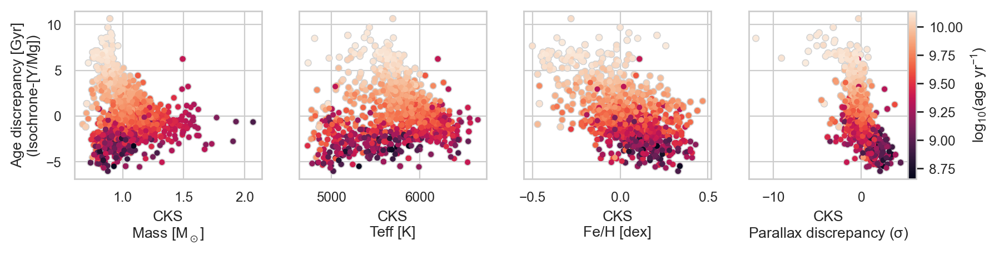

In [63]:
sns.set(context='paper', style='whitegrid')

_x = [df['cks_Miso'], 
      df['cks_Teff'],
      df['cks_[Fe/H]'],
      (df['cks_plx']-df['cks_plxspec'])/(df['cks_e_plxspec'])]


_xlabels = ['CKS\nMass [$\mathregular{M_\odot}$]',
           'CKS\nTeff [K]',
           'CKS\nFe/H [dex]',
            'CKS\nParallax discrepancy ($\mathregular{\sigma}$)']

fig, ax = plt.subplots(nrows=1, ncols=len(_x), figsize=(len(_x)*2.5, 2), sharey=True)

for i in range(len(_x)):
    
    _ = (np.isfinite(_x[i])) & (np.isfinite(df['cks_age_ymg_resid']))
    rho, pval = stats.spearmanr(_x[i][_], df['cks_age_ymg_resid'][_])
    
    sc = ax[i].scatter(_x[i], df['cks_age_ymg_resid'], c=df['cks_logAiso'], s=14, edgecolors='lightgrey', lw=1)
    ax[i].scatter(_x[i], df['cks_age_ymg_resid'], c=df['cks_logAiso'], s=13, lw=0)
    ax[i].set_xlabel(_xlabels[i])    
    #ax[i].text(0.5,0.9,r'$\rho$ = '+str(np.round(rho,2)), transform=ax[i].transAxes)
    #ax[i].text(0.5,0.8,r'p-val. = '+"{:.4f}".format(pval), transform=ax[i].transAxes)

    if i==len(_x)-1:
       
        cb = fig.colorbar(sc, ax=ax[i], pad=0)
        cb.set_label(r'log$_\mathregular{10}$(age yr$^\mathregular{-1}$)')    
    
ax[0].set_ylabel('Age discrepancy [Gyr]\n(Isochrone-[Y/Mg])')

plt.show()

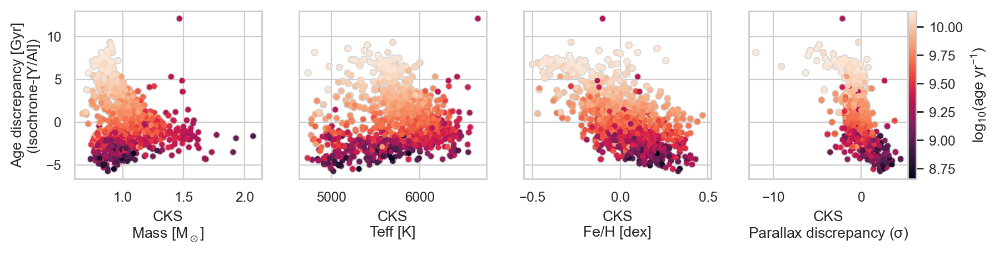

In [65]:
sns.set(context='paper', style='whitegrid')

_x = [df['cks_Miso'], 
      df['cks_Teff'],
      df['cks_[Fe/H]'],
      (df['cks_plx']-df['cks_plxspec'])/(df['cks_e_plxspec'])]


_xlabels = ['CKS\nMass [$\mathregular{M_\odot}$]',
           'CKS\nTeff [K]',
           'CKS\nFe/H [dex]',
            'CKS\nParallax discrepancy ($\mathregular{\sigma}$)']

fig, ax = plt.subplots(nrows=1, ncols=len(_x), figsize=(len(_x)*2.5, 2), sharey=True)

for i in range(len(_x)):
    
    sc = ax[i].scatter(_x[i], df['cks_age_yal_resid'], c=df['cks_logAiso'], s=14, edgecolors='lightgrey', lw=1)
    ax[i].scatter(_x[i], df['cks_age_yal_resid'], c=df['cks_logAiso'], s=13, lw=0)
    ax[i].set_xlabel(_xlabels[i])    

    if i==len(_x)-1:
       
        cb = fig.colorbar(sc, ax=ax[i], pad=0)
        cb.set_label(r'log$_\mathregular{10}$(age yr$^\mathregular{-1}$)')    
    
ax[0].set_ylabel('Age discrepancy [Gyr]\n(Isochrone-[Y/Al])')

plt.show()

### Remake this plot with N20 relation ages

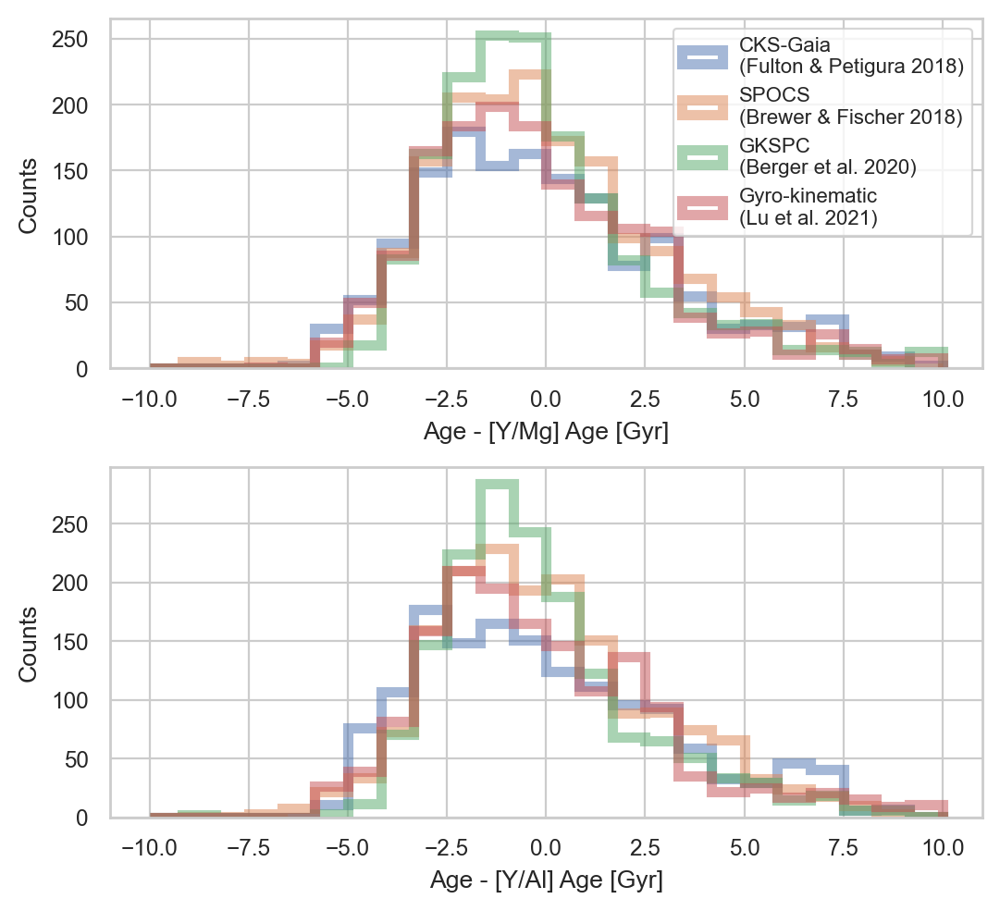

In [140]:
sns.set(context='paper', style='whitegrid')
bins = np.linspace(-10,10,25)
hist_kws = {"histtype":"step", "lw":4, "alpha":0.5, "density":False}

fig,(ax1,ax2) = plt.subplots(nrows=2,ncols=1,figsize=(5.5,5))

ax1.hist(df['cks_age_ymg_resid'], bins=bins, **hist_kws, label="CKS-Gaia\n(Fulton & Petigura 2018)")
ax1.hist(df['bf18_age_ymg_resid'], bins=bins, **hist_kws, label="SPOCS\n(Brewer & Fischer 2018)")
ax1.hist(df['b20_age_ymg_resid'], bins=bins, **hist_kws, label="GKSPC\n(Berger et al. 2020)")
ax1.hist(df['l20_age_ymg_resid'], bins=bins, **hist_kws, label='Gyro-kinematic\n(Lu et al. 2021)')
ax1.set_xlabel('Age - [Y/Mg] Age [Gyr]')

ax2.hist(df['cks_age_yal_resid'], bins=bins, **hist_kws, label="CKS-Gaia\n(Fulton & Petigura 2018)")
ax2.hist(df['bf18_age_yal_resid'], bins=bins, **hist_kws, label="SPOCS\n(Brewer & Fischer 2018)")
ax2.hist(df['b20_age_yal_resid'], bins=bins, **hist_kws, label="GKSPC\n(Berger et al. 2020)")
ax2.hist(df['l20_age_yal_resid'], bins=bins, **hist_kws, label='Gyro-kinematic\n(Lu et al. 2021)')
ax2.set_xlabel('Age - [Y/Al] Age [Gyr]')

ax1.legend(prop={'size':8})
ax1.set_ylabel('Counts')
ax2.set_ylabel('Counts')

plt.tight_layout()
plt.show()

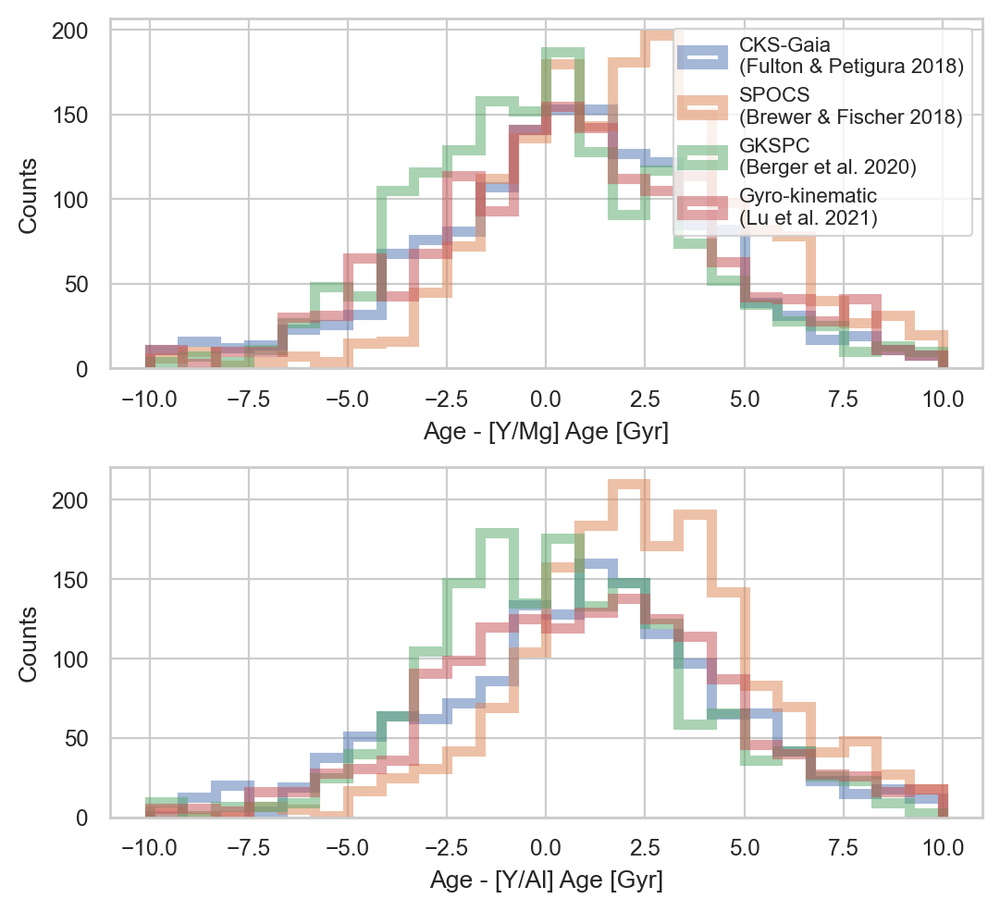

In [141]:
sns.set(context='paper', style='whitegrid')
bins = np.linspace(-10,10,25)
hist_kws = {"histtype":"step", "lw":4, "alpha":0.5, "density":False, "bins":bins}

fig,(ax1,ax2) = plt.subplots(nrows=2,ncols=1,figsize=(5.5,5))

ax1.hist(df['cks_age']-df['ymg_age_n20'],  **hist_kws, label="CKS-Gaia\n(Fulton & Petigura 2018)")
ax1.hist(df['bf18_Age']-df['ymg_age_n20'],  **hist_kws, label="SPOCS\n(Brewer & Fischer 2018)")
ax1.hist(df['b20_iso_age']-df['ymg_age_n20'],  **hist_kws, label="GKSPC\n(Berger et al. 2020)")
ax1.hist(df['l20_kin_age']-df['ymg_age_n20'],  **hist_kws, label='Gyro-kinematic\n(Lu et al. 2021)')
ax1.set_xlabel('Age - [Y/Mg] Age [Gyr]')

ax2.hist(df['cks_age']-df['yal_age_s18'], **hist_kws, label="CKS-Gaia\n(Fulton & Petigura 2018)")
ax2.hist(df['bf18_Age']-df['yal_age_s18'], **hist_kws, label="SPOCS\n(Brewer & Fischer 2018)")
ax2.hist(df['b20_iso_age']-df['yal_age_s18'], **hist_kws, label="GKSPC\n(Berger et al. 2020)")
ax2.hist(df['l20_kin_age']-df['yal_age_s18'], **hist_kws, label='Gyro-kinematic\n(Lu et al. 2021)')
ax2.set_xlabel('Age - [Y/Al] Age [Gyr]')

ax1.legend(prop={'size':8})
ax1.set_ylabel('Counts')
ax2.set_ylabel('Counts')

plt.tight_layout()
plt.show()

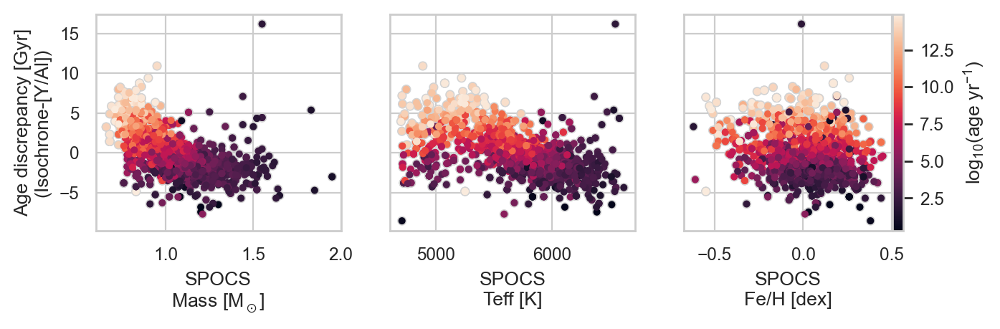

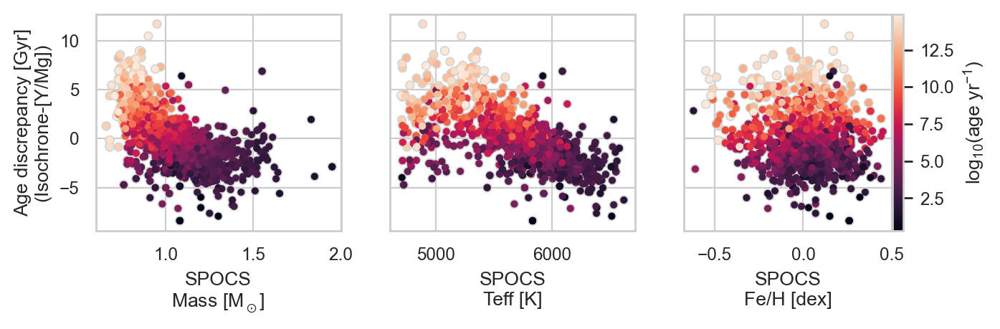

In [142]:
_x = [df['bf18_Mass'], 
      df['bf18_Teff'],
      df['bf18_[Fe/H]']]

_xlabels = ['SPOCS\nMass [$\mathregular{M_\odot}$]',
           'SPOCS\nTeff [K]',
           'SPOCS\nFe/H [dex]']

fig, ax = plt.subplots(nrows=1, ncols=len(_x), figsize=(len(_x)*2.5, 2), sharey=True)

for i in range(len(_x)):
    
    sc = ax[i].scatter(_x[i], df['bf18_age_yal_resid'], c=df['bf18_Age'], s=14, edgecolors='lightgrey', lw=1)
    ax[i].scatter(_x[i], df['bf18_age_yal_resid'], c=df['bf18_Age'], s=13, lw=0)
    ax[i].set_xlabel(_xlabels[i])    

    if i==len(_x)-1:
       
        cb = fig.colorbar(sc, ax=ax[i], pad=0)
        cb.set_label(r'log$_\mathregular{10}$(age yr$^\mathregular{-1}$)')    
    
ax[0].set_ylabel('Age discrepancy [Gyr]\n(Isochrone-[Y/Al])')
ax[0].set_xlim(0.6,2)

plt.show()


_x = [df['bf18_Mass'], 
      df['bf18_Teff'],
      df['bf18_[Fe/H]']]

_xlabels = ['SPOCS\nMass [$\mathregular{M_\odot}$]',
           'SPOCS\nTeff [K]',
           'SPOCS\nFe/H [dex]']

fig, ax = plt.subplots(nrows=1, ncols=len(_x), figsize=(len(_x)*2.5, 2), sharey=True)

for i in range(len(_x)):
    
    sc = ax[i].scatter(_x[i], df['bf18_age_ymg_resid'], c=df['bf18_Age'], s=14, edgecolors='lightgrey', lw=1)
    ax[i].scatter(_x[i], df['bf18_age_ymg_resid'], c=df['bf18_Age'], s=13, lw=0)
    ax[i].set_xlabel(_xlabels[i])    

    if i==len(_x)-1:
       
        cb = fig.colorbar(sc, ax=ax[i], pad=0)
        cb.set_label(r'log$_\mathregular{10}$(age yr$^\mathregular{-1}$)')    
    
ax[0].set_ylabel('Age discrepancy [Gyr]\n(Isochrone-[Y/Mg])')
ax[0].set_xlim(0.6,2)

plt.show()

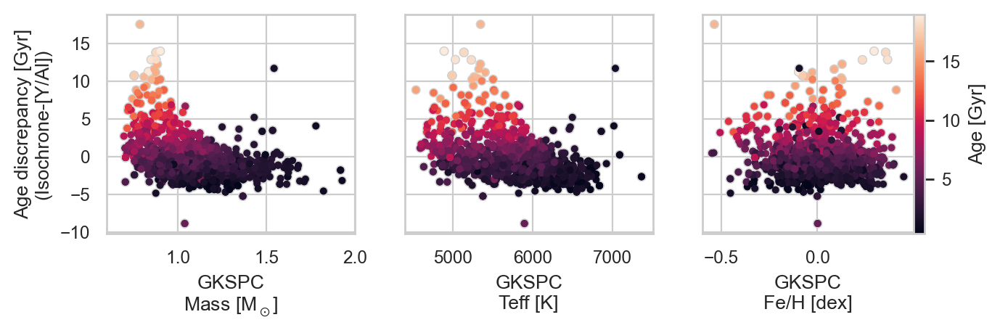

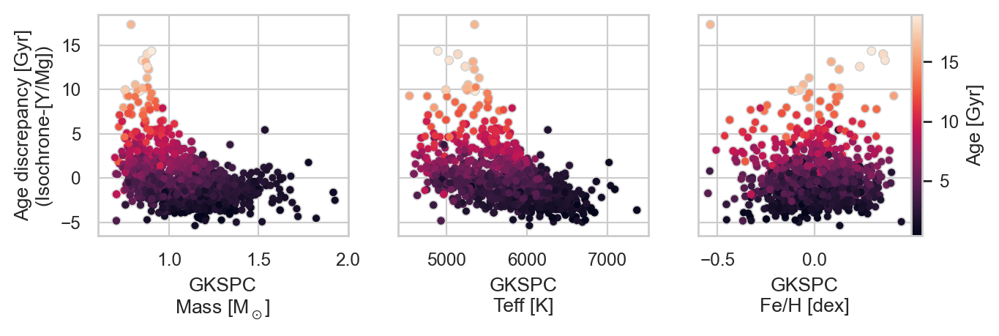

In [143]:
_x = [df['b20_iso_mass'], 
      df['b20_iso_teff'],
      df['b20_iso_feh']]

_xlabels = ['GKSPC\nMass [$\mathregular{M_\odot}$]',
           'GKSPC\nTeff [K]',
           'GKSPC\nFe/H [dex]']

fig, ax = plt.subplots(nrows=1, ncols=len(_x), figsize=(len(_x)*2.5, 2), sharey=True)

for i in range(len(_x)):
    
    sc = ax[i].scatter(_x[i], df['b20_age_yal_resid'], c=df['b20_iso_age'], s=14, edgecolors='lightgrey', lw=1)
    ax[i].scatter(_x[i], df['b20_age_yal_resid'], c=df['b20_iso_age'], s=13, lw=0)
    ax[i].set_xlabel(_xlabels[i])    

    if i==len(_x)-1:
       
        cb = fig.colorbar(sc, ax=ax[i], pad=0)
        cb.set_label('Age [Gyr]')    
    
ax[0].set_ylabel('Age discrepancy [Gyr]\n(Isochrone-[Y/Al])')
ax[0].set_xlim(0.6,2)

plt.show()



fig, ax = plt.subplots(nrows=1, ncols=len(_x), figsize=(len(_x)*2.5, 2), sharey=True)

for i in range(len(_x)):
    
    sc = ax[i].scatter(_x[i], df['b20_age_ymg_resid'], c=df['b20_iso_age'], s=14, edgecolors='lightgrey', lw=1)
    ax[i].scatter(_x[i], df['b20_age_ymg_resid'], c=df['b20_iso_age'], s=13, lw=0)
    ax[i].set_xlabel(_xlabels[i])    

    if i==len(_x)-1:
       
        cb = fig.colorbar(sc, ax=ax[i], pad=0)
        cb.set_label('Age [Gyr]')    
    
ax[0].set_ylabel('Age discrepancy [Gyr]\n(Isochrone-[Y/Mg])')
ax[0].set_xlim(0.6,2)

plt.show()

# Cuts:
-parallax discrepancy > 2.5 sigma
-

In [74]:
# fig,ax = plt.subplots(nrows=1,ncols=4,figsize=(12,2.5))

# for i,var in enumerate(["ymg_ratio","yal_ratio","bf18_logRHK","a18_period"]):
#     if i<2:
#         sc = ax[i].scatter(df["cks_Teff"], df["cks_R"], c=df[var], s=6, cmap='coolwarm', vmin=-0.4, vmax=0.4, rasterized=True)
#     elif i==2:
#         sc = ax[i].scatter(df["cks_Teff"], df["cks_R"], c=df[var], s=6, cmap='coolwarm', vmin=-6, vmax=-4, rasterized=True)
#     elif i==3:
#         sc = ax[i].scatter(df["cks_Teff"], df["cks_R"], c=df[var], s=6, cmap='coolwarm_r', vmin=0, vmax=40, rasterized=True)
    
#     cb = fig.colorbar(sc, ax=ax[i])
#     cb.set_label(var)
    
#     ax[i].invert_xaxis()
#     ax[i].semilogy()
#     ax[i].set_xlabel('CKS Teff [K]')
#     ax[i].set_ylabel('CKS R [R$_\mathregular{\odot}$]')
    
# plt.tight_layout()
#plt.savefig('cks-4panel.pdf', dpi=300, bbox_inches='tight')

#######################################################################################################################

# plt.scatter(df["cks_Teff"], df["cks_R"], c=df["ymg_ratio"], s=14, cmap='coolwarm', vmin=-0.4, vmax=0.4)
# plt.gca().invert_xaxis()
# plt.semilogy()
# plt.show()


# plt.scatter(df["cks_Teff"], df["cks_R"], c=df["yal_ratio"], s=14, cmap='coolwarm', vmin=-0.4, vmax=0.4)
# plt.gca().invert_xaxis()
# plt.semilogy()
# plt.show()


# plt.scatter(df["cks_Teff"], df["cks_R"], c=df["bf18_logRHK"], s=14, cmap='coolwarm')
# plt.gca().invert_xaxis()
# plt.semilogy()
# plt.show()

# plt.scatter(df["cks_Teff"], df["cks_R"], c=df["a18_period"], s=14, cmap='coolwarm', vmin=0, vmax=40)
# plt.gca().invert_xaxis()
# plt.semilogy()
# plt.show()

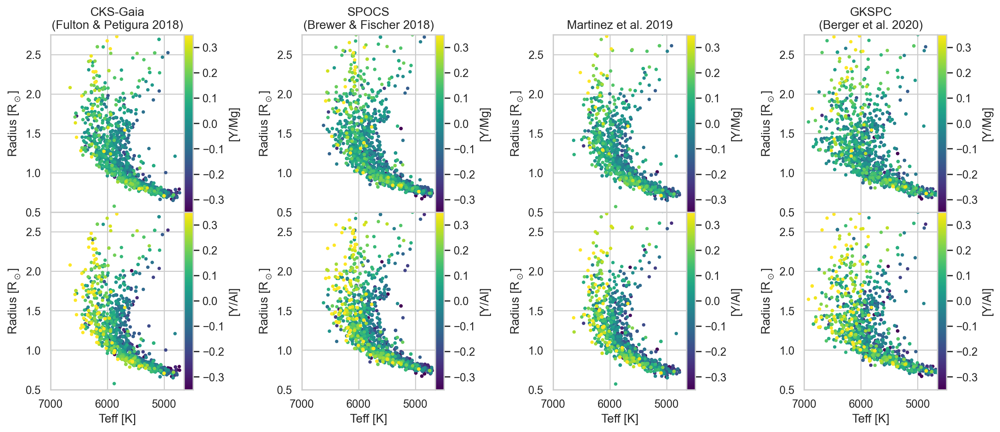

In [330]:
sns.set(font_scale=1, style='whitegrid')

fig,ax = plt.subplots(nrows=2,ncols=4,figsize=(0.65*25,0.65*10),
                      sharex=True, sharey=False)

labels = ['CKS-Gaia\n(Fulton & Petigura 2018)', 
          'SPOCS\n(Brewer & Fischer 2018)', 
          'Martinez et al. 2019', 
          'GKSPC\n(Berger et al. 2020)']

var_labels = ['[Y/Mg]', '[Y/Al]']

cmap = sns.diverging_palette(220, 20, as_cmap=True)

sc_kws = {"cmap": 'viridis', 
          "s": 10, 
          "vmin":-0.35, 
          "vmax":0.35, 
          "rasterized":True, 
          "lw": 0.25, 
          "alpha": 1}


for i,var in enumerate(["ymg_ratio","yal_ratio"]):
    
    
    _ = np.argsort(np.array(df[var]))
    #_ = np.argsort(np.array(df['']))
    
    sc0 = ax[i][0].scatter(df["cks_Teff"][_], df["cks_R"][_], c=df[var][_], **sc_kws)
    sc1 = ax[i][1].scatter(df["bf18_Teff"][_], df["bf18_Rad"][_], c=df[var][_], **sc_kws)
    sc2 = ax[i][2].scatter(df["m19_Teff"][_], df["m19_R*"][_], c=df[var][_], **sc_kws)
    sc3 = ax[i][3].scatter(df["b20_iso_teff"][_], df["b20_iso_rad"][_], c=df[var][_], **sc_kws)
    
    cb0 = fig.colorbar(sc0, ax=ax[i][0], pad=0)
    cb1 = fig.colorbar(sc1, ax=ax[i][1], pad=0)
    cb2 = fig.colorbar(sc2, ax=ax[i][2], pad=0)
    cb3 = fig.colorbar(sc3, ax=ax[i][3], pad=0)   
    
    cb0.set_label(var_labels[i])
    cb1.set_label(var_labels[i])
    cb2.set_label(var_labels[i])
    cb3.set_label(var_labels[i])
    
    
for i in range(len(labels)):
    ax[0][i].set_title(labels[i])
    
ax[0][0].set_xlim(7000,4650)
#ax[0][0].set_ylim(0.5,2.75)

for i in range(4):
    ax[1][i].set_xlabel('Teff [K]')
    ax[0][i].set_ylabel('Radius [$\mathregular{R_\odot}$]')
    ax[1][i].set_ylabel('Radius [$\mathregular{R_\odot}$]')
    ax[0][i].set_ylim(0.5,2.75)
    ax[1][i].set_ylim(0.5,2.75)

#for i in range(2):
#    ax[i][0].set_ylabel('Radius [$\mathregular{R_\odot}$]')

plt.subplots_adjust(hspace=0, wspace=0.6)
plt.savefig('./figures/teff-rad.pdf')    

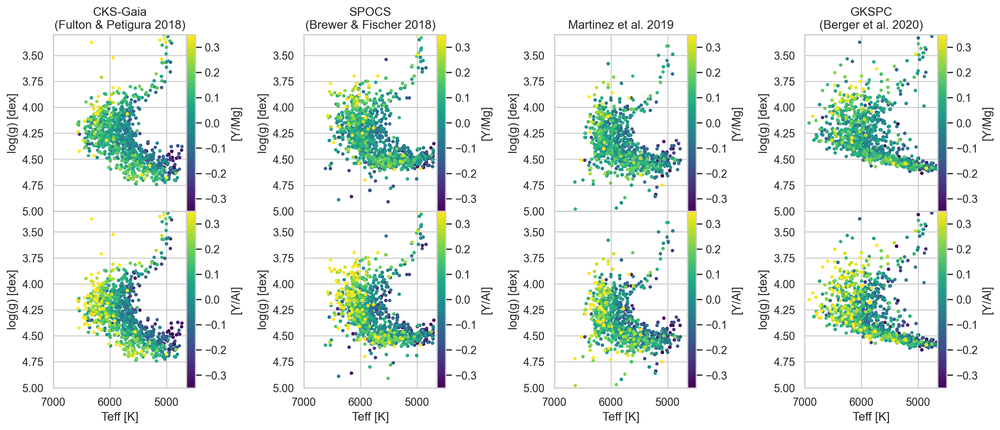

In [331]:
sns.set(font_scale=1, style='whitegrid')

fig,ax = plt.subplots(nrows=2,ncols=4,figsize=(0.65*25,0.65*10),
                      sharex=True, sharey=False)

labels = ['CKS-Gaia\n(Fulton & Petigura 2018)', 
          'SPOCS\n(Brewer & Fischer 2018)', 
          'Martinez et al. 2019', 
          'GKSPC\n(Berger et al. 2020)']

var_labels = ['[Y/Mg]', '[Y/Al]']

cmap = sns.diverging_palette(220, 20, as_cmap=True)

#sc_kws = {'cmap': 'cubehelix_r', 's': 8, 'vmin':-0.35, 'vmax':0.35, "rasterized":True, 'edgecolors':'grey', 'lw':0.5, "alpha":0.9}
#sc_kws = {'cmap': 'viridis', 's': 4, 'vmin':-0.35, 'vmax':0.35, "rasterized":True, 'lw':0.5, "alpha":0.9}

sc_kws = {"cmap": 'viridis', 
          "s": 10, 
          "vmin":-0.35, 
          "vmax":0.35, 
          "rasterized":True, 
          "lw": 0.25, 
          "alpha": 1}


for i,var in enumerate(["ymg_ratio","yal_ratio"]):
    
    
    _ = np.argsort(np.array(df[var]))
    
    sc0 = ax[i][0].scatter(df["cks_Teff"][_], df["p20_cks_slogg"][_], c=df[var][_], **sc_kws)
    sc1 = ax[i][1].scatter(df["bf18_Teff"][_], df["bf18_log(g)"][_], c=df[var][_], **sc_kws)
    sc2 = ax[i][2].scatter(df["m19_Teff"][_], df["m19_log(g)"][_], c=df[var][_], **sc_kws)
    sc3 = ax[i][3].scatter(df["b20_iso_teff"][_], df["b20_iso_logg"][_], c=df[var][_], **sc_kws)
    
    cb0 = fig.colorbar(sc0, ax=ax[i][0], pad=0)
    cb1 = fig.colorbar(sc1, ax=ax[i][1], pad=0)
    cb2 = fig.colorbar(sc2, ax=ax[i][2], pad=0)
    cb3 = fig.colorbar(sc3, ax=ax[i][3], pad=0)   
    
    cb0.set_label(var_labels[i])
    cb1.set_label(var_labels[i])
    cb2.set_label(var_labels[i])
    cb3.set_label(var_labels[i])
    
    
for i in range(len(labels)):
    ax[0][i].set_title(labels[i])
    
ax[0][0].set_xlim(7000,4650)
#ax[0][0].invert_yaxis()
#ax[0][0].set_ylim(5.,3.3)


for i in range(4):
    ax[1][i].set_xlabel('Teff [K]')
    ax[0][i].set_ylabel('log(g) [dex]')
    ax[1][i].set_ylabel('log(g) [dex]')
    ax[0][i].set_ylim(5.,3.3)
    ax[1][i].set_ylim(5.,3.3)

#for i in range(2):
#    ax[i][0].set_ylabel('log(g) [dex]')

plt.subplots_adjust(hspace=0, wspace=0.6)
plt.savefig('./figures/teff-logg.pdf')    

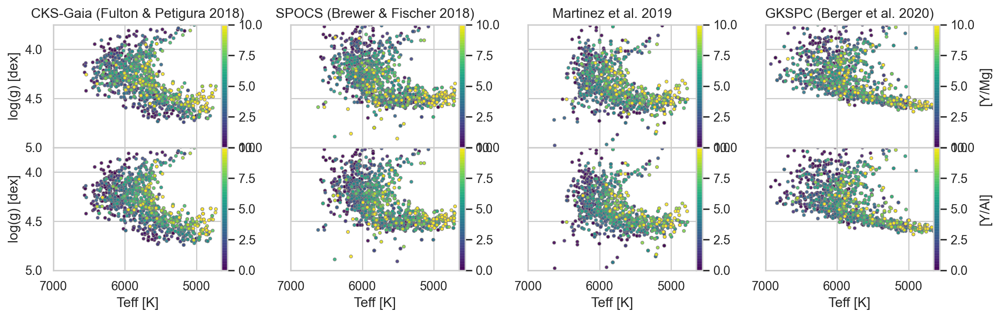

In [184]:
sns.set(font_scale=1, style='whitegrid')

fig,ax = plt.subplots(nrows=2,ncols=4,figsize=(0.8*18,0.8*5),
                      sharex=True, sharey=True)

labels = ['CKS-Gaia (Fulton & Petigura 2018)', 
          'SPOCS (Brewer & Fischer 2018)', 
          'Martinez et al. 2019', 
          'GKSPC (Berger et al. 2020)']

var_labels = ['[Y/Mg]', '[Y/Al]']

cmap = sns.diverging_palette(220, 20, as_cmap=True)

#sc_kws = {'cmap': 'cubehelix_r', 's': 8, 'vmin':-0.35, 'vmax':0.35, "rasterized":True, 'edgecolors':'grey', 'lw':0.5, "alpha":0.9}
sc_kws = {'cmap': 'viridis', 's': 8, 'vmin':0, 'vmax':10, "rasterized":True, 'edgecolors':'grey', 'lw':0.5, "alpha":0.9}


for i,var in enumerate(["ymg_age_n20","yal_age_s18"]):
    
    
    _ = np.argsort(np.array(df[var]))
    
    sc0 = ax[i][0].scatter(df["cks_Teff"][_], df["p20_cks_slogg"][_], c=df[var][_], **sc_kws)
    sc1 = ax[i][1].scatter(df["bf18_Teff"][_], df["bf18_log(g)"][_], c=df[var][_], **sc_kws)
    sc2 = ax[i][2].scatter(df["m19_Teff"][_], df["m19_log(g)"][_], c=df[var][_], **sc_kws)
    sc3 = ax[i][3].scatter(df["b20_iso_teff"][_], df["b20_iso_logg"][_], c=df[var][_], **sc_kws)
    
    cb0 = fig.colorbar(sc0, ax=ax[i][0], pad=0)
    cb1 = fig.colorbar(sc1, ax=ax[i][1], pad=0)
    cb2 = fig.colorbar(sc2, ax=ax[i][2], pad=0)
    cb3 = fig.colorbar(sc3, ax=ax[i][3], pad=0)   
    
    cb3.set_label(var_labels[i])
    
    
for i in range(len(labels)):
    ax[0][i].set_title(labels[i])
    
ax[0][0].set_xlim(7000,4650)
#ax[0][0].invert_yaxis()

ax[0][0].set_ylim(5.,3.75)

for i in range(4):
    ax[1][i].set_xlabel('Teff [K]')

for i in range(2):
    ax[i][0].set_ylabel('log(g) [dex]')

plt.subplots_adjust(hspace=0, wspace=0.2)
#plt.savefig('./figures/teff-logg.pdf')    
#plt.savefig('/Users/tdavid/Downloads/teff-logg.png')    

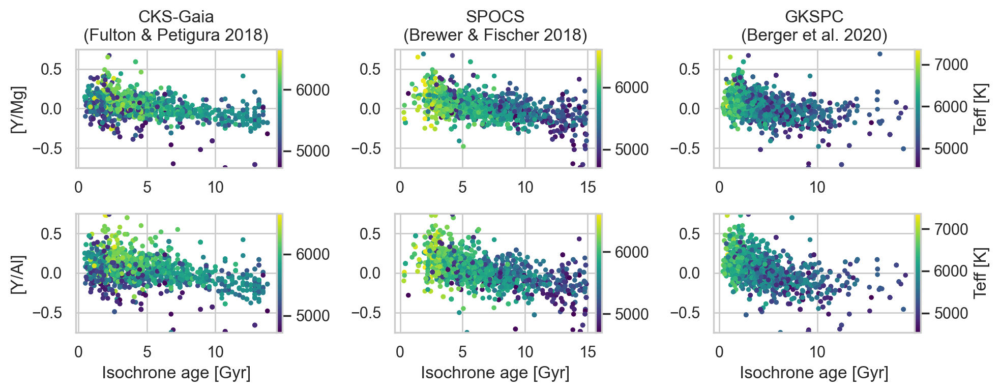

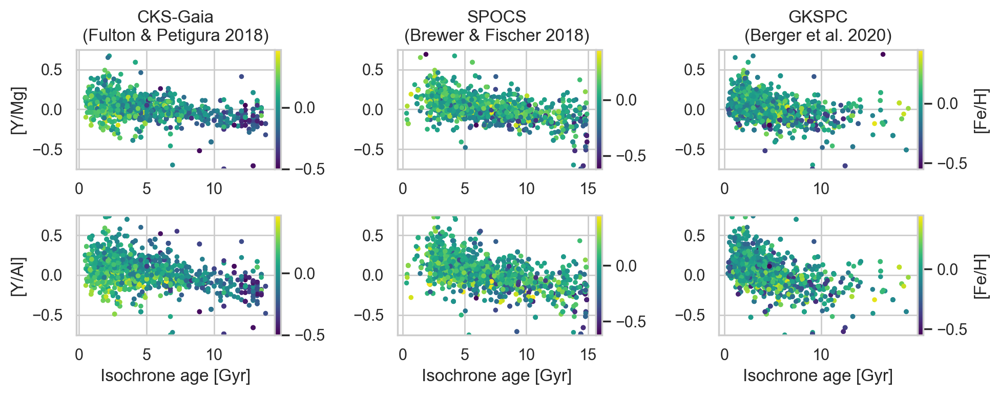

In [198]:
xs = [df['cks_age'], df['bf18_Age'], df['b20_iso_age']]
zs = [df['cks_Teff'], df['bf18_Teff'], df['b20_iso_teff']]

labels = ['CKS-Gaia\n(Fulton & Petigura 2018)',
          'SPOCS\n(Brewer & Fischer 2018)',
          'GKSPC\n(Berger et al. 2020)',]

sc_kws = {'cmap':'viridis', 's':6}

fig, ax = plt.subplots(nrows=2, ncols=len(xs), figsize=(10,4))

for i,x in enumerate(xs):
    sc1 = ax[0][i].scatter(x, df['ymg_ratio'], c=zs[i], **sc_kws)
    sc2 = ax[1][i].scatter(x, df['yal_ratio'], c=zs[i], **sc_kws)
    
    cb1 = fig.colorbar(sc1, ax=ax[0][i], pad=0)
    cb2 = fig.colorbar(sc2, ax=ax[1][i], pad=0)    
    
    
    ax[0][i].set_title(labels[i])
    ax[0][i].set_ylim(-0.75,0.75)
    ax[1][i].set_ylim(-0.75,0.75)
    ax[1][i].set_xlabel('Isochrone age [Gyr]')

    
    
    if i==0:
        ax[0][i].set_ylabel('[Y/Mg]')
        ax[1][i].set_ylabel('[Y/Al]')
        
        
    if i==2:
        cb1.set_label('Teff [K]')        
        cb2.set_label('Teff [K]')                
    
    
    #ax[0][i].invert_xaxis()
    #ax[1][i].invert_xaxis()
    
plt.tight_layout()
plt.savefig('/Users/tdavid/Downloads/teff-trends.png')
plt.show()




xs = [df['cks_age'], df['bf18_Age'], df['b20_iso_age']]
zs = [df['cks_[Fe/H]'], df['bf18_[Fe/H]'], df['b20_iso_feh']]

#labels = ['McQuillan et al. 2013','Mazeh et al. 2015', 'Angus et al. 2018', 'David et al. 2021\n(vetting)']

sc_kws = {'cmap':'viridis', 's':6}

fig, ax = plt.subplots(nrows=2, ncols=len(xs), figsize=(10,4))

for i,x in enumerate(xs):
    sc1 = ax[0][i].scatter(x, df['ymg_ratio'], c=zs[i], **sc_kws)
    sc2 = ax[1][i].scatter(x, df['yal_ratio'], c=zs[i], **sc_kws)
    
    cb1 = fig.colorbar(sc1, ax=ax[0][i], pad=0)
    cb2 = fig.colorbar(sc2, ax=ax[1][i], pad=0)    
    
    
    if i==2:
        cb1.set_label('[Fe/H]')
        cb2.set_label('[Fe/H]')        
        
        
    ax[0][i].set_title(labels[i])
    ax[0][i].set_ylim(-0.75,0.75)
    ax[1][i].set_ylim(-0.75,0.75)
    #ax[0][i].invert_xaxis()
    #ax[1][i].invert_xaxis()
    
    ax[1][i].set_xlabel('Isochrone age [Gyr]')

    
    if i==0:
        ax[0][i].set_ylabel('[Y/Mg]')
        ax[1][i].set_ylabel('[Y/Al]')
    
    
plt.tight_layout()
plt.savefig('/Users/tdavid/Downloads/feh-trends.png')
plt.show()

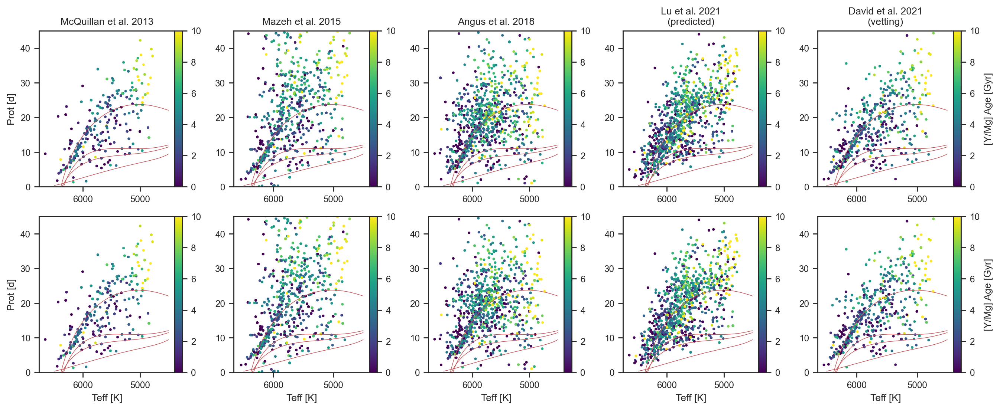

In [178]:
x = df['cks_Teff']
ys = [df['m13_Prot'], df['m15_Prot'], df['a18_period'], df['l20_Prot_predict'], df['d21_prot']]
labels = ['McQuillan et al. 2013','Mazeh et al. 2015', 'Angus et al. 2018', 'Lu et al. 2021\n(predicted)', 'David et al. 2021\n(vetting)']

sc_kws = {'cmap':'viridis', 's':3, 'vmin':0, 'vmax':10}

gyro_sequences = ['pleiades-ro', 'praesepe', 'ngc6811', 'ngc6819+ruprecht147']

fig, ax = plt.subplots(nrows=2, ncols=len(ys), figsize=(0.8*17,0.8*7))

for i,y in enumerate(ys):
    sc1 = ax[0][i].scatter(x, y, c=df['ymg_age_n20'], **sc_kws)
    sc2 = ax[1][i].scatter(x, y, c=df['ymg_age_n20'], **sc_kws)
    
    cb1 = fig.colorbar(sc1, ax=ax[0][i], pad=0)
    cb2 = fig.colorbar(sc2, ax=ax[1][i], pad=0)    
    
    ax[0][i].set_ylim(0,45)
    ax[1][i].set_ylim(0,45)
    ax[0][i].invert_xaxis()
    ax[1][i].invert_xaxis()
    ax[0][i].set_title(labels[i])
    ax[1][i].set_xlabel('Teff [K]')
    if i==0:
        ax[0][i].set_ylabel('Prot [d]')
        ax[1][i].set_ylabel('Prot [d]')
    if i==4:
        cb1.set_label('[Y/Mg] Age [Gyr]')
        cb2.set_label('[Y/Mg] Age [Gyr]')
        
    _teff = np.linspace(4500,6500,1000)

    for seq in gyro_sequences:
        ax[0][i].plot(_teff, curtis_teff_gyrochrone(_teff, kind=seq), label=seq, color='r', lw=0.5)
        ax[1][i].plot(_teff, curtis_teff_gyrochrone(_teff, kind=seq), label=seq, color='r', lw=0.5)

# plt.legend()
# plt.gca().invert_xaxis()    
# plt.show()    
    
plt.tight_layout()
plt.savefig('/Users/tdavid/Downloads/kepler-ymg-age-gyro.png')
plt.show()

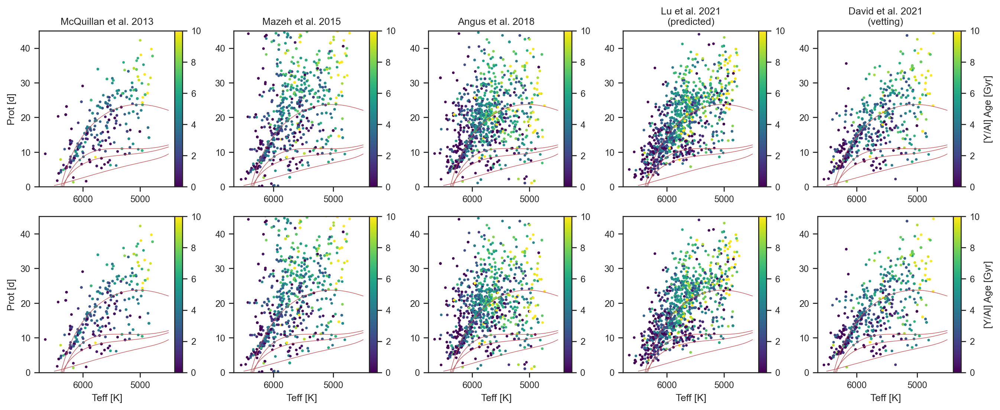

In [179]:
x = df['cks_Teff']
ys = [df['m13_Prot'], df['m15_Prot'], df['a18_period'], df['l20_Prot_predict'], df['d21_prot']]
labels = ['McQuillan et al. 2013','Mazeh et al. 2015', 'Angus et al. 2018', 'Lu et al. 2021\n(predicted)', 'David et al. 2021\n(vetting)']

sc_kws = {'cmap':'viridis', 's':3, 'vmin':0, 'vmax':10}

gyro_sequences = ['pleiades-ro', 'praesepe', 'ngc6811', 'ngc6819+ruprecht147']

fig, ax = plt.subplots(nrows=2, ncols=len(ys), figsize=(0.8*17,0.8*7))

for i,y in enumerate(ys):
    sc1 = ax[0][i].scatter(x, y, c=df['yal_age_s18'], **sc_kws)
    sc2 = ax[1][i].scatter(x, y, c=df['yal_age_s18'], **sc_kws)
    
    cb1 = fig.colorbar(sc1, ax=ax[0][i], pad=0)
    cb2 = fig.colorbar(sc2, ax=ax[1][i], pad=0)    
    
    ax[0][i].set_ylim(0,45)
    ax[1][i].set_ylim(0,45)
    ax[0][i].invert_xaxis()
    ax[1][i].invert_xaxis()
    ax[0][i].set_title(labels[i])
    ax[1][i].set_xlabel('Teff [K]')
    if i==0:
        ax[0][i].set_ylabel('Prot [d]')
        ax[1][i].set_ylabel('Prot [d]')
    if i==4:
        cb1.set_label('[Y/Al] Age [Gyr]')
        cb2.set_label('[Y/Al] Age [Gyr]')
        
    _teff = np.linspace(4500,6500,1000)

    for seq in gyro_sequences:
        ax[0][i].plot(_teff, curtis_teff_gyrochrone(_teff, kind=seq), label=seq, color='r', lw=0.5)
        ax[1][i].plot(_teff, curtis_teff_gyrochrone(_teff, kind=seq), label=seq, color='r', lw=0.5)
    
plt.tight_layout()
plt.savefig('/Users/tdavid/Downloads/kepler-yal-age-gyro.png')
plt.show()

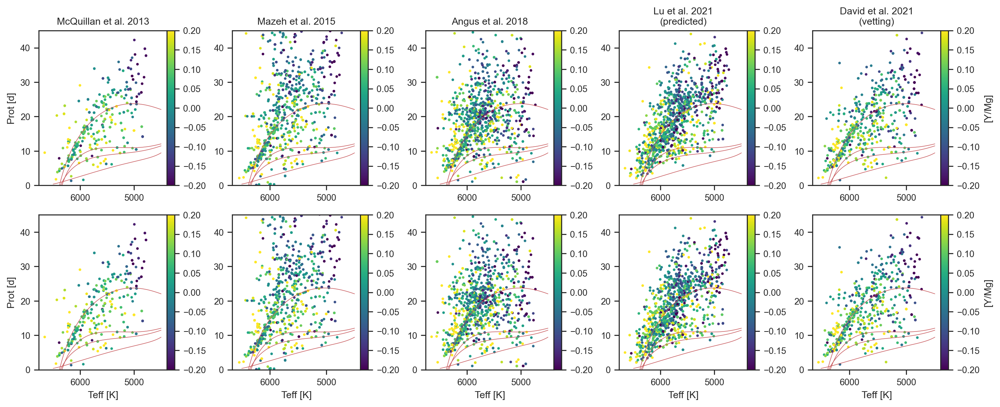

In [180]:
x = df['cks_Teff']
ys = [df['m13_Prot'], df['m15_Prot'], df['a18_period'], df['l20_Prot_predict'], df['d21_prot']]
labels = ['McQuillan et al. 2013','Mazeh et al. 2015', 'Angus et al. 2018', 'Lu et al. 2021\n(predicted)', 'David et al. 2021\n(vetting)']

sc_kws = {'cmap':'viridis', 's':3, 'vmin':-0.2, 'vmax':0.2}

gyro_sequences = ['pleiades-ro', 'praesepe', 'ngc6811', 'ngc6819+ruprecht147']

fig, ax = plt.subplots(nrows=2, ncols=len(ys), figsize=(0.8*17,0.8*7))

for i,y in enumerate(ys):
    sc1 = ax[0][i].scatter(x, y, c=df['ymg_ratio'], **sc_kws)
    sc2 = ax[1][i].scatter(x, y, c=df['ymg_ratio'], **sc_kws)
    
    cb1 = fig.colorbar(sc1, ax=ax[0][i], pad=0)
    cb2 = fig.colorbar(sc2, ax=ax[1][i], pad=0)    
    
    ax[0][i].set_ylim(0,45)
    ax[1][i].set_ylim(0,45)
    ax[0][i].invert_xaxis()
    ax[1][i].invert_xaxis()
    ax[0][i].set_title(labels[i])
    ax[1][i].set_xlabel('Teff [K]')
    if i==0:
        ax[0][i].set_ylabel('Prot [d]')
        ax[1][i].set_ylabel('Prot [d]')
    if i==4:
        cb1.set_label('[Y/Mg]')
        cb2.set_label('[Y/Mg]')
        
    _teff = np.linspace(4500,6500,1000)

    for seq in gyro_sequences:
        ax[0][i].plot(_teff, curtis_teff_gyrochrone(_teff, kind=seq), label=seq, color='r', lw=0.5)
        ax[1][i].plot(_teff, curtis_teff_gyrochrone(_teff, kind=seq), label=seq, color='r', lw=0.5)
    
plt.tight_layout()
plt.savefig('/Users/tdavid/Downloads/kepler-ymg-gyro.png')
plt.show()

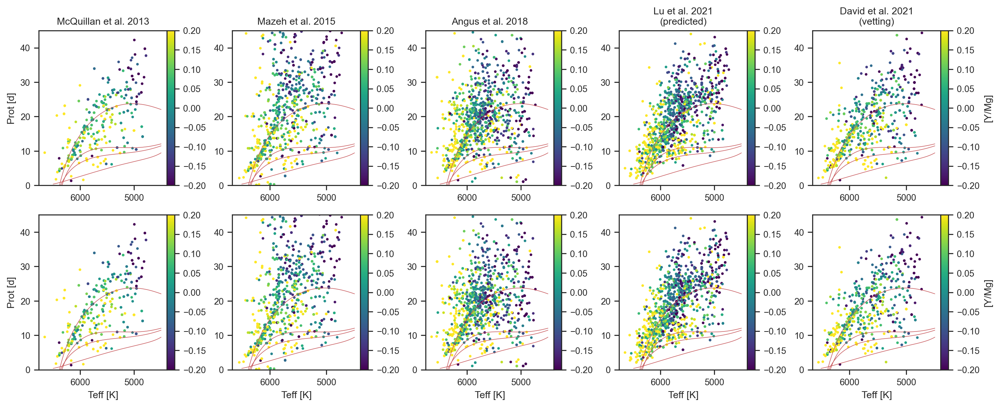

In [181]:
x = df['cks_Teff']
ys = [df['m13_Prot'], df['m15_Prot'], df['a18_period'], df['l20_Prot_predict'], df['d21_prot']]
labels = ['McQuillan et al. 2013','Mazeh et al. 2015', 'Angus et al. 2018', 'Lu et al. 2021\n(predicted)', 'David et al. 2021\n(vetting)']

sc_kws = {'cmap':'viridis', 's':3, 'vmin':-0.2, 'vmax':0.2}

gyro_sequences = ['pleiades-ro', 'praesepe', 'ngc6811', 'ngc6819+ruprecht147']

fig, ax = plt.subplots(nrows=2, ncols=len(ys), figsize=(0.8*17,0.8*7))

for i,y in enumerate(ys):
    sc1 = ax[0][i].scatter(x, y, c=df['yal_ratio'], **sc_kws)
    sc2 = ax[1][i].scatter(x, y, c=df['yal_ratio'], **sc_kws)
    
    cb1 = fig.colorbar(sc1, ax=ax[0][i], pad=0)
    cb2 = fig.colorbar(sc2, ax=ax[1][i], pad=0)    
    
    ax[0][i].set_ylim(0,45)
    ax[1][i].set_ylim(0,45)
    ax[0][i].invert_xaxis()
    ax[1][i].invert_xaxis()
    ax[0][i].set_title(labels[i])
    ax[1][i].set_xlabel('Teff [K]')
    if i==0:
        ax[0][i].set_ylabel('Prot [d]')
        ax[1][i].set_ylabel('Prot [d]')
    if i==4:
        cb1.set_label('[Y/Mg]')
        cb2.set_label('[Y/Mg]')
        
    _teff = np.linspace(4500,6500,1000)

    for seq in gyro_sequences:
        ax[0][i].plot(_teff, curtis_teff_gyrochrone(_teff, kind=seq), label=seq, color='r', lw=0.5)
        ax[1][i].plot(_teff, curtis_teff_gyrochrone(_teff, kind=seq), label=seq, color='r', lw=0.5)
    
plt.tight_layout()
plt.savefig('/Users/tdavid/Downloads/kepler-yal-gyro.png')
plt.show()

In [ ]:
fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(nrows=2, ncols=2, 
                                          figsize=(6,6), dpi=300)


x = df['cks_age']
y = df['bf18_[Y/H]']
z = df['bf18_[Fe/H]']

ax1.errorbar(x, y, 
             xerr=[df['cks_e_age'],df['cks_E_age']], 
             yerr=df['bf18_e_[Y/H]'], 
             fmt='.', ecolor='lightgrey', lw=0.5)
sc1 = ax1.scatter(x, y, c=z, cmap='viridis', zorder=999, s=6)
cb1 = fig.colorbar(sc1, ax=ax1, pad=0)

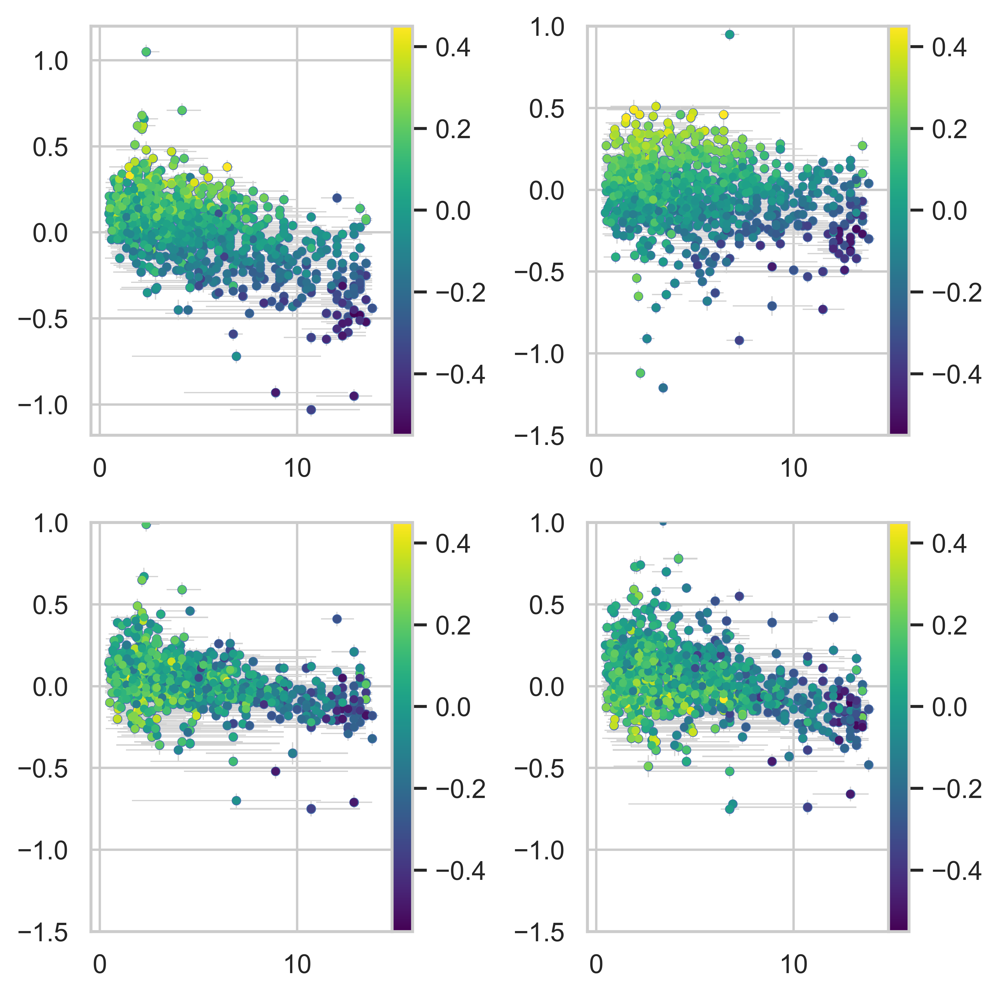

In [225]:
fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(nrows=2, ncols=2, 
                                          figsize=(6,6), dpi=300)


x = df['cks_age']
y = df['bf18_[Y/H]']
z = df['bf18_[Fe/H]']

ax1.errorbar(x, y, 
             xerr=[df['cks_e_age'],df['cks_E_age']], 
             yerr=df['bf18_e_[Y/H]'], 
             fmt='.', ecolor='lightgrey', lw=0.5)
sc1 = ax1.scatter(x, y, c=z, cmap='viridis', zorder=999, s=6)
cb1 = fig.colorbar(sc1, ax=ax1, pad=0)


x = df['cks_age']
y = df['bf18_[Al/H]']
z = df['bf18_[Fe/H]']

ax2.errorbar(x, y, 
             xerr=[df['cks_e_age'],df['cks_E_age']], 
             yerr=df['bf18_e_[Al/H]'], 
             fmt='.', ecolor='lightgrey', lw=0.5)
sc2 = ax2.scatter(x, y, c=z, cmap='viridis', zorder=999, s=6)
cb2 = fig.colorbar(sc2, ax=ax2, pad=0)
ax2.set_ylim(-1.5,1)

x = df['cks_age']
y = df['ymg_ratio']
z = df['bf18_[Fe/H]']

ax3.errorbar(x, y, 
             xerr=[df['cks_e_age'],df['cks_E_age']], 
             yerr=df['ymg_ratio_err'], 
             fmt='.', ecolor='lightgrey', lw=0.5)
sc3 = ax3.scatter(x, y, c=z, cmap='viridis', zorder=999, s=6)
cb3 = fig.colorbar(sc3, ax=ax3, pad=0)
ax3.set_ylim(-1.5,1)

x = df['cks_age']
y = df['yal_ratio']
z = df['bf18_[Fe/H]']

ax4.errorbar(x, y, 
             xerr=[df['cks_e_age'],df['cks_E_age']], 
             yerr=df['ymg_ratio_err'], 
             fmt='.', ecolor='lightgrey', lw=0.5)
sc4 = ax4.scatter(x, y, c=z, cmap='viridis', zorder=999, s=6)
cb4 = fig.colorbar(sc4, ax=ax4, pad=0)
ax4.set_ylim(-1.5,1)
plt.tight_layout()
plt.show()


ax1.set_ylabel('[Y/H]')
ax2.set_ylabel('[Al/H]')
ax3.set_ylabel('[Y/Mg]')
ax4.set_ylabel('[Y/Al]')

for ax in [ax1,ax2,ax3,ax4]:
    ax.set_xlabel('CKS Age [Gyr]')
    

In [318]:
for col in df.columns:
    if 'bf18_[' in col:
        print()

MH
CH
NH
OH
NaH
MgH
AlH
SiH
CaH
TiH
VH
CrH
MnH
FeH
NiH
YH
CFe
NFe
OFe
NaFe
MgFe
AlFe
SiFe
CaFe
TiFe
VFe
CrFe
MnFe
NiFe
YFe
CO
CNa
CMg
CAl
CSi
CCa
CTi
CCr
CNi
CY
ONa
OMg
OAl
OSi
OCa
OTi
OCr
ONi
OY
NaMg
NaAl
NaSi
NaCa
NaTi
NaCr
NaNi
NaY
MgAl
MgSi
MgCa
MgTi
MgCr
MgNi
MgY
AlSi
AlCa
AlTi
AlCr
AlNi
AlY
SiCa
SiTi
SiCr
SiNi
SiY
CaTi
CaCr
CaNi
CaY
TiCr
TiNi
TiY
CrNi
CrY
NiY


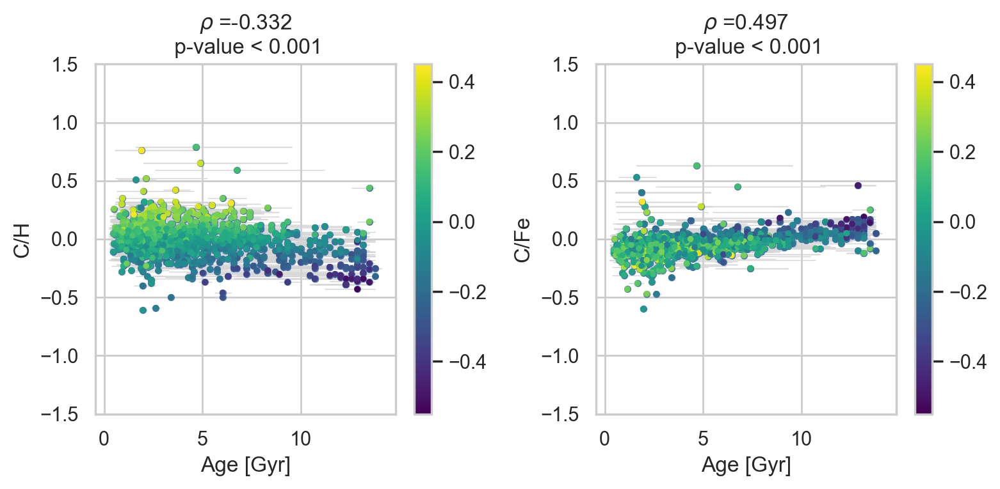

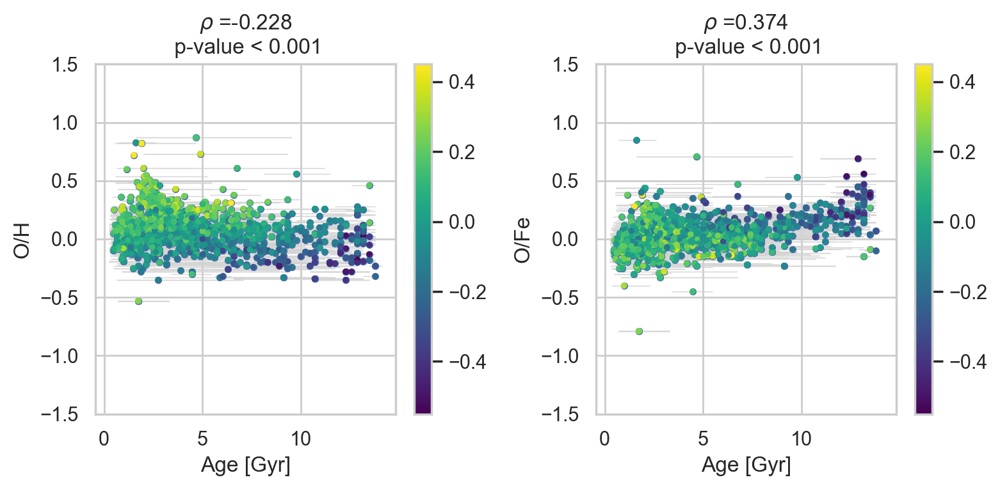

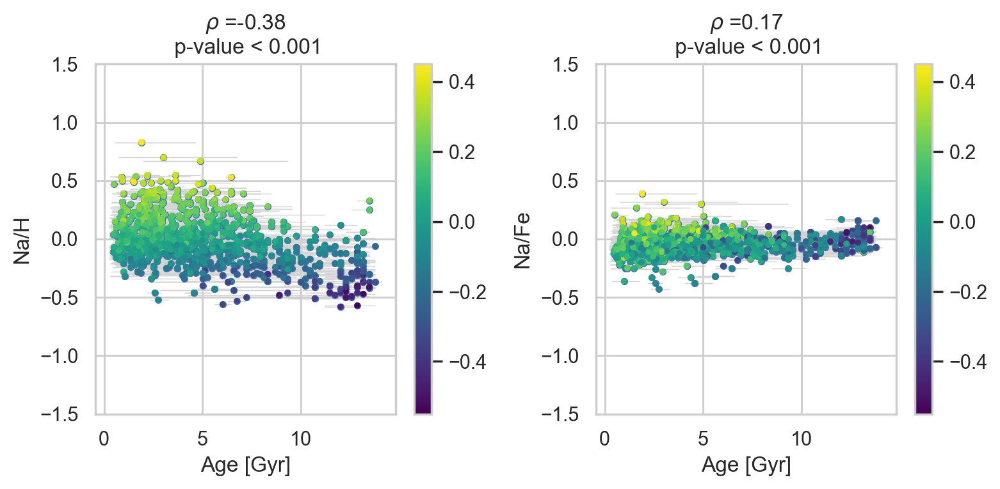

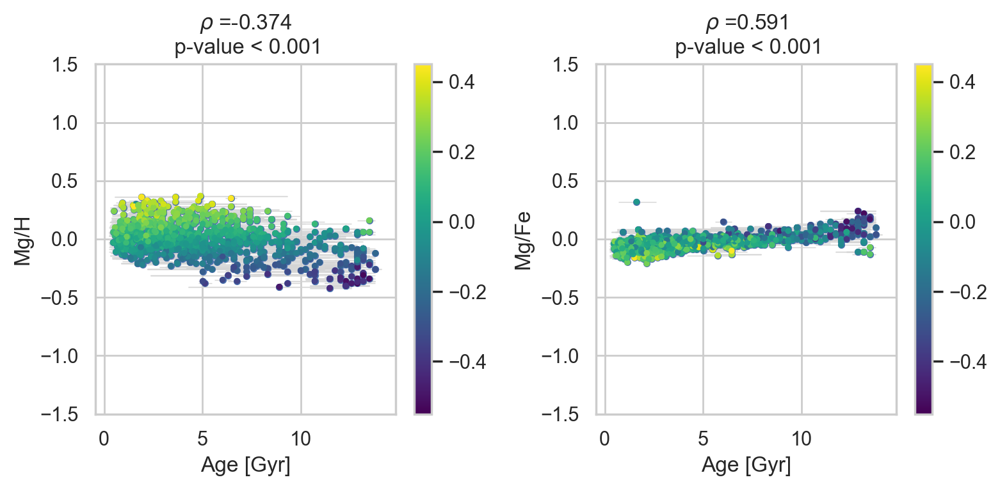

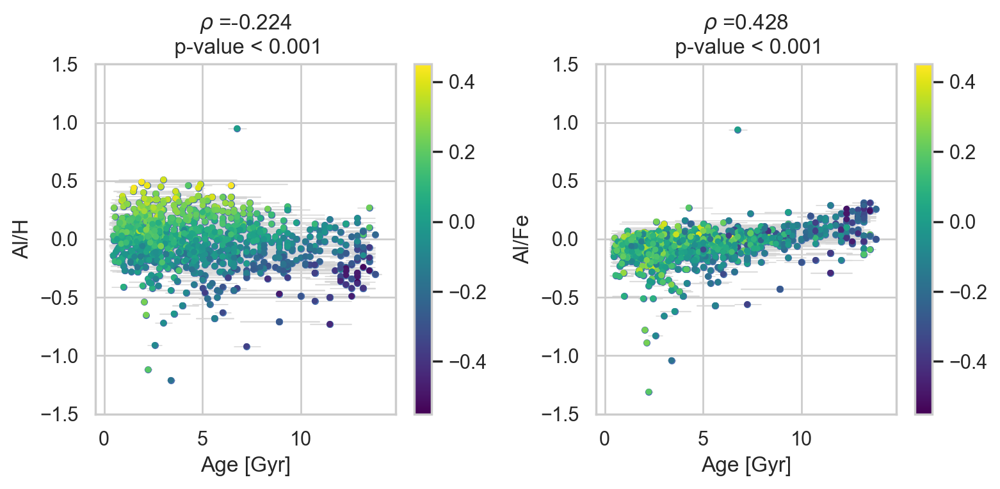

...

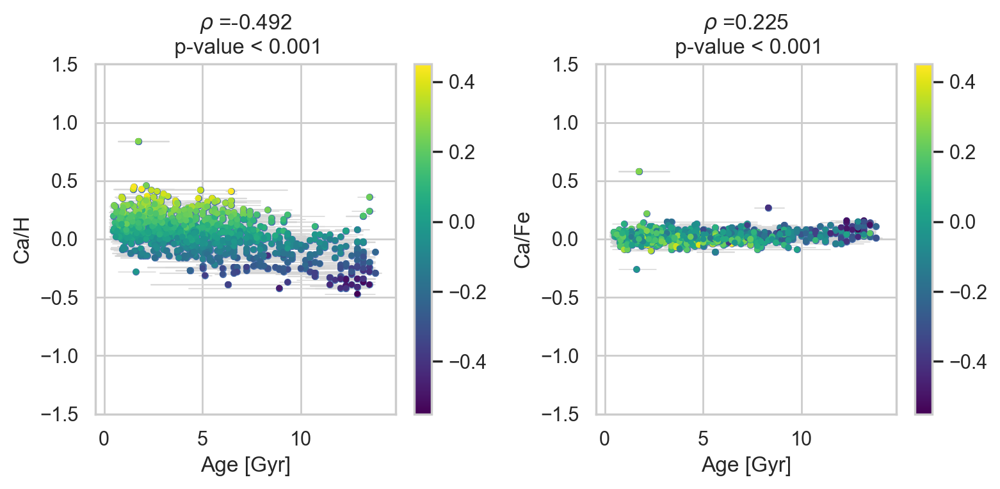

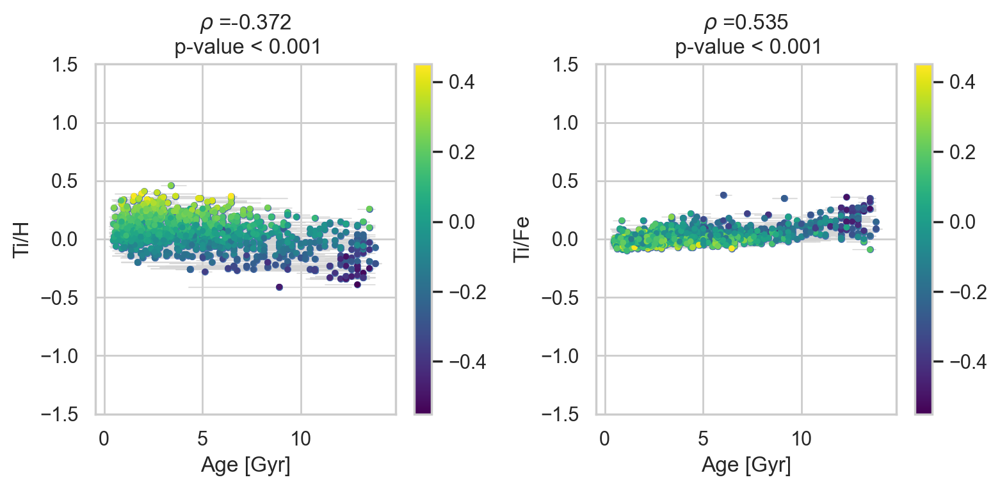

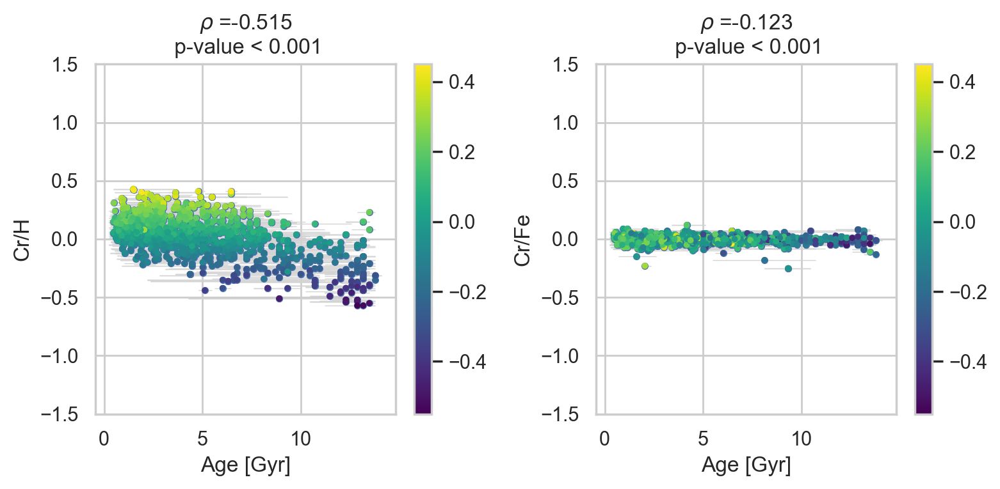

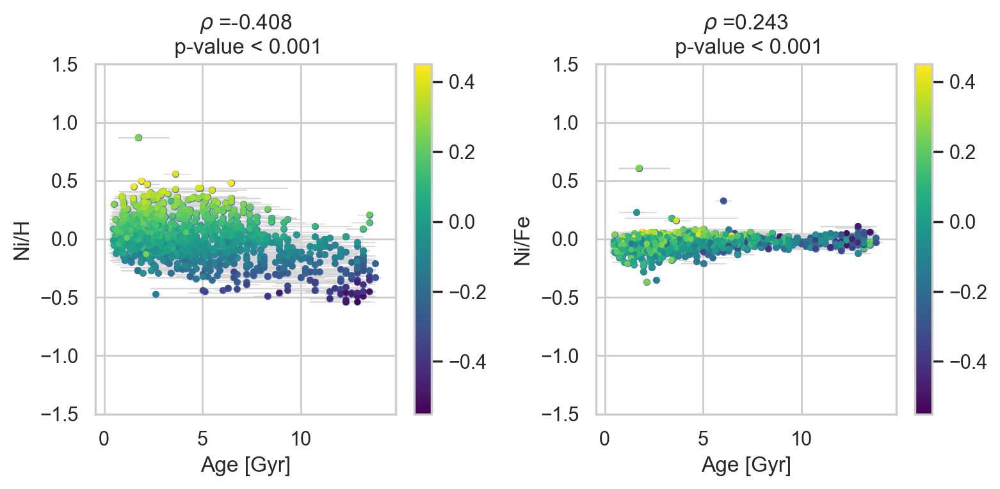

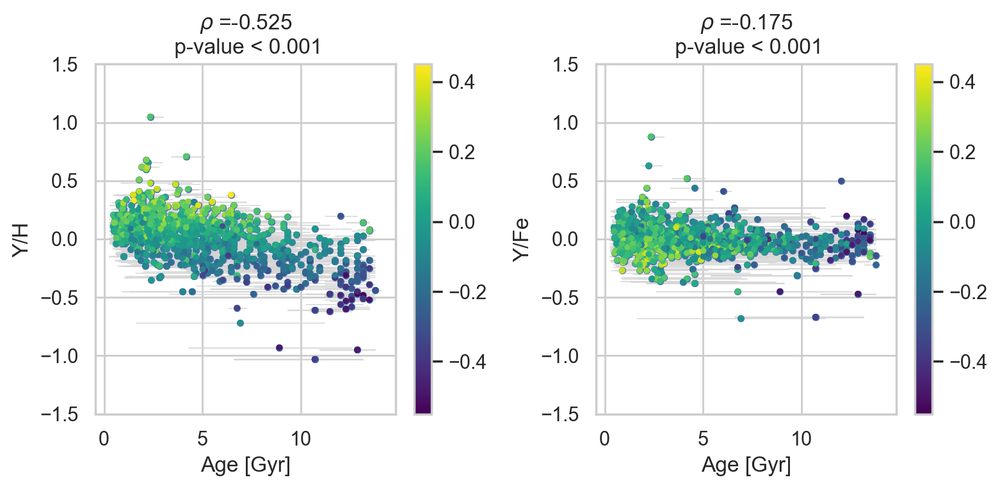

In [242]:
elems = ['C','O','Na','Mg','Al','Si','Ca','Ti','Cr','Ni','Y']

x = df['cks_age']
xerr=[df['cks_e_age'],df['cks_E_age']]
#y = df['bf18_[Y/H]']
z = df['bf18_[Fe/H]']

for el in elems:
    y = df['bf18_['+el+'/H]']
    yerr = df['bf18_e_['+el+'/H]']
    
    y2 = df['bf18_['+el+'/Fe]']
    
    fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(8,4))
    
    _ = (np.isfinite(x)) & (np.isfinite(y))
    rho,pval = stats.spearmanr(x[_], y[_])
    rho2,pval2 = stats.spearmanr(x[_], y2[_])

    ax1.errorbar(x, y, 
             xerr=xerr, 
             fmt='.', ecolor='lightgrey', lw=0.5)
    ax2.errorbar(x, y2, 
             xerr=xerr, 
             fmt='.', ecolor='lightgrey', lw=0.5)    
    
    sc1 = ax1.scatter(x, y, c=z, cmap='viridis', zorder=999, s=6)
    sc2 = ax2.scatter(x, y2, c=z, cmap='viridis', zorder=999, s=6)
    
    cb1 = fig.colorbar(sc1, ax=ax1)
    cb2 = fig.colorbar(sc2, ax=ax2)
    
    
    if pval>0.001:
        ax1.set_title(r'$\rho$ ='+str(np.round(rho,3))+'\n'+"{:.4f}".format(pval))    
    elif pval<0.001:
        ax1.set_title(r'$\rho$ ='+str(np.round(rho,3))+'\n p-value < 0.001')
        
        
    if pval2>0.001:
        ax2.set_title(r'$\rho$ ='+str(np.round(rho2,3))+'\n'+"{:.4f}".format(pval2))
        
    elif pval<0.001:
        ax2.set_title(r'$\rho$ ='+str(np.round(rho2,3))+'\n p-value < 0.001')        
        
    
    #plt.colorbar()
    ax1.set_ylabel(el+'/H')
    ax2.set_ylabel(el+'/Fe')
    ax1.set_xlabel('Age [Gyr]')
    ax2.set_xlabel('Age [Gyr]')
    ax1.set_ylim(-1.5,1.5)
    ax2.set_ylim(-1.5,1.5)
    plt.tight_layout()
    plt.show()

In [230]:
# #Grid up HR diagram into overlapping cells, compute correlation coefficient between ymg, yal, and age for different age catalogs

# from scipy import stats

# arg = (np.isfinite(df['cks_Teff'])) & (np.isfinite(df['cks_R'])) & (np.isfinite(df['ymg_ratio'])) & (np.isfinite(df['yal_ratio']))

# x, y, z, age = df['cks_Teff'], np.log10(df['cks_R']), df['ymg_ratio'], df['cks_logAiso']

# xgrid = np.linspace(np.nanmin(x), np.nanmax(x), 40)
# ygrid = np.linspace(np.nanmin(y), np.nanmax(y), 40)

# X, Y = np.meshgrid(xgrid, ygrid)

# Z = np.zeros(np.shape(X))

# for i in range(len(xgrid)):
#     for j in range(len(ygrid)):
        
#         _xcen = X[i,j]
#         _ycen = Y[i,j]
        
#         _arg  = abs(x-_xcen)<2*np.min(np.diff(xgrid))
#         _arg &= abs(y-_ycen)<2*np.min(np.diff(ygrid))
#         _arg &= np.isfinite(x)
#         _arg &= np.isfinite(y)
#         _arg &= np.isfinite(z)
#         _arg &= np.isfinite(age)
        
#         _z = z[_arg]
#         _a = age[_arg]
        
#         rho, pval = stats.spearmanr(_z, _a)
        
#         Z[i,j] = pval
        
        


In [206]:
# fig,(ax1,ax2,ax3,ax4) = plt.subplots(nrows=1,ncols=4,figsize=(12,3))
# for ax in [ax1,ax2,ax3,ax4]:
#     ax.invert_xaxis()
    
# ast = np.isfinite(df["s15_Age"])

# #for _z in ["s15_Age","ymg_age_n20","yal_age_s18",""]:
    
# sc = ax1.scatter(df["cks_Teff"][ast], df["cks_R"][ast], c=df["s15_Age"][ast])
# cb = fig.colorbar(sc, ax=ax1)

# sc = ax2.scatter(df["cks_Teff"][ast], df["cks_R"][ast], c=df["bf18_logRHK"][ast])
# cb = fig.colorbar(sc, ax=ax2)

# sc = ax3.scatter(df["cks_Teff"][ast], df["cks_R"][ast], c=df["ymg_ratio"][ast])
# cb = fig.colorbar(sc, ax=ax3)

# sc = ax4.scatter(df["cks_Teff"][ast], df["cks_R"][ast], c=df["yal_ratio"][ast])
# cb = fig.colorbar(sc, ax=ax4)

# #cb.set_label("BF18 S/N")

# plt.show()

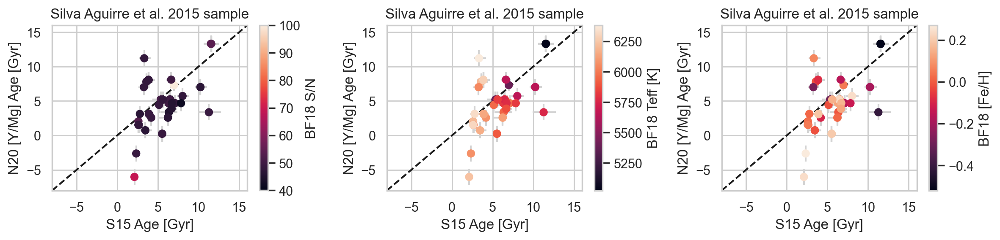

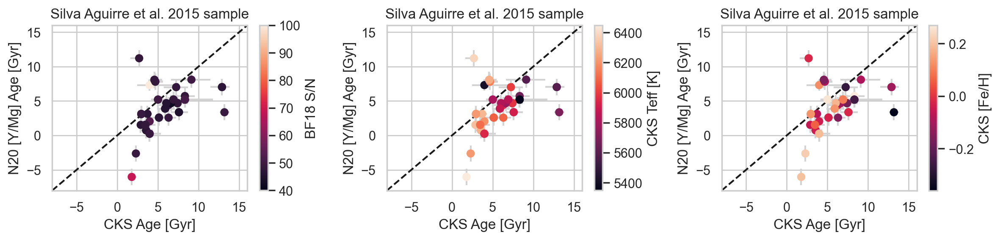

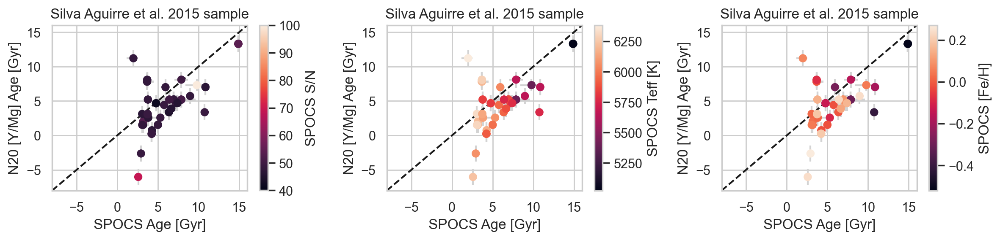

In [453]:
fig,(ax1,ax2,ax3) = plt.subplots(nrows=1,ncols=3,figsize=(12,3))

for ax in [ax1,ax2,ax3]:
    ax.set_title("Silva Aguirre et al. 2015 sample")
    ax.plot([-8,16],[-8,16],'k--')
    ax.set_xlim(-8,16)
    ax.set_ylim(-8,16)
    ax.set_xlabel("S15 Age [Gyr]")
    ax.set_ylabel("N20 [Y/Mg] Age [Gyr]")
        
ax1.errorbar(df["s15_Age"], df["ymg_age_n20"], 
             xerr=[df["s15_e_Age"],df["s15_E_Age"]], 
             yerr=df["ymg_age_err_n20"], fmt='.', ecolor='lightgrey')
sc = ax1.scatter(df["s15_Age"], df["ymg_age_n20"], c=df["bf18_S/N"], zorder=99, vmin=40, vmax=100)
cb = fig.colorbar(sc, ax=ax1)
cb.set_label("BF18 S/N")

ax2.errorbar(df["s15_Age"], df["ymg_age_n20"], 
             xerr=[df["s15_e_Age"],df["s15_E_Age"]], 
             yerr=df["ymg_age_err_n20"], fmt='.', ecolor='lightgrey')
sc = ax2.scatter(df["s15_Age"], df["ymg_age_n20"], c=df["bf18_Teff"], zorder=99)
cb = fig.colorbar(sc, ax=ax2)
cb.set_label("BF18 Teff [K]")

ax3.errorbar(df["s15_Age"], df["ymg_age_n20"], 
             xerr=[df["s15_e_Age"],df["s15_E_Age"]], 
             yerr=df["ymg_age_err_n20"], fmt='.', ecolor='lightgrey')
sc = ax3.scatter(df["s15_Age"], df["ymg_age_n20"], c=df["bf18_[Fe/H]"], zorder=99)
cb = fig.colorbar(sc, ax=ax3)
cb.set_label("BF18 [Fe/H]")
plt.tight_layout()
plt.savefig('s15-compare1.pdf', dpi=300, bbox_inches='tight')




fig,(ax1,ax2,ax3) = plt.subplots(nrows=1,ncols=3,figsize=(12,3))

for ax in [ax1,ax2,ax3]:
    ax.set_title("Silva Aguirre et al. 2015 sample")
    ax.plot([-8,16],[-8,16],'k--')
    ax.set_xlim(-8,16)
    ax.set_ylim(-8,16)
    ax.set_xlabel("CKS Age [Gyr]")
    ax.set_ylabel("N20 [Y/Mg] Age [Gyr]")    
    
_ = np.isfinite(df["s15_Age"])
        
ax1.errorbar(df["cks_age"][_], df["ymg_age_n20"][_], 
             xerr=[df["cks_e_age"][_],df["cks_E_age"][_]], 
             yerr=df["ymg_age_err_n20"][_], fmt='.', ecolor='lightgrey')
sc = ax1.scatter(df["cks_age"][_], df["ymg_age_n20"][_], c=df["bf18_S/N"][_], zorder=99, vmin=40, vmax=100)
cb = fig.colorbar(sc, ax=ax1)
cb.set_label("BF18 S/N")


ax2.errorbar(df["cks_age"][_], df["ymg_age_n20"][_], 
             xerr=[df["cks_e_age"][_],df["cks_E_age"][_]], 
             yerr=df["ymg_age_err_n20"][_], fmt='.', ecolor='lightgrey')
sc = ax2.scatter(df["cks_age"][_], df["ymg_age_n20"][_], c=df["cks_Teff"][_], zorder=99)
cb = fig.colorbar(sc, ax=ax2)
cb.set_label("CKS Teff [K]")

ax3.errorbar(df["cks_age"][_], df["ymg_age_n20"][_], 
             xerr=[df["cks_e_age"][_],df["cks_E_age"][_]], 
             yerr=df["ymg_age_err_n20"][_], fmt='.', ecolor='lightgrey')
sc = ax3.scatter(df["cks_age"][_], df["ymg_age_n20"][_], c=df["cks_[Fe/H]"][_], zorder=99)
cb = fig.colorbar(sc, ax=ax3)
cb.set_label("CKS [Fe/H]")

plt.tight_layout()
#plt.savefig('s15-compare2.pdf', dpi=300, bbox_inches='tight')



fig,(ax1,ax2,ax3) = plt.subplots(nrows=1,ncols=3,figsize=(12,3))

for ax in [ax1,ax2,ax3]:
    ax.set_title("Silva Aguirre et al. 2015 sample")
    ax.plot([-8,16],[-8,16],'k--')
    ax.set_xlim(-8,16)
    ax.set_ylim(-8,16)
    ax.set_xlabel("SPOCS Age [Gyr]")
    ax.set_ylabel("N20 [Y/Mg] Age [Gyr]")    
    
_ = np.isfinite(df["s15_Age"])
        
ax1.errorbar(df["bf18_Age"][_], df["ymg_age_n20"][_], 
             xerr=[df["bf18_e_Age"][_], df["bf18_E_Age"][_]], 
             yerr=df["ymg_age_err_n20"][_], fmt='.', ecolor='lightgrey')
sc = ax1.scatter(df["bf18_Age"][_], df["ymg_age_n20"][_], c=df["bf18_S/N"][_], zorder=99, vmin=40, vmax=100)
cb = fig.colorbar(sc, ax=ax1)
cb.set_label("SPOCS S/N")


ax2.errorbar(df["bf18_Age"][_], df["ymg_age_n20"][_], 
             xerr=[df["bf18_e_Age"][_],df["bf18_E_Age"][_]], 
             yerr=df["ymg_age_err_n20"][_], fmt='.', ecolor='lightgrey')
sc = ax2.scatter(df["bf18_Age"][_], df["ymg_age_n20"][_], c=df["bf18_Teff"][_], zorder=99)
cb = fig.colorbar(sc, ax=ax2)
cb.set_label("SPOCS Teff [K]")

ax3.errorbar(df["bf18_Age"][_], df["ymg_age_n20"][_], 
             xerr=[df["bf18_e_Age"][_], df["bf18_E_Age"][_]], 
             yerr=df["ymg_age_err_n20"][_], fmt='.', ecolor='lightgrey')
sc = ax3.scatter(df["bf18_Age"][_], df["ymg_age_n20"][_], c=df["bf18_[Fe/H]"][_], zorder=99)
cb = fig.colorbar(sc, ax=ax3)
cb.set_label("SPOCS [Fe/H]")

plt.tight_layout()
#plt.savefig('s15-compare2.pdf', dpi=300, bbox_inches='tight')

<ipython-input-120-689dad101744>:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df["cks_age_gyr"] = 10.**df["cks_logAiso"]/1.0e9
<ipython-input-120-689dad101744>:33: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df["cks_age_lerr"] = df["cks_age_gyr"]-10.**(df["cks_logAiso"]-df["cks_e_logAiso"])/1.0e9
<ipython-input-120-689dad101744>:34: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using 

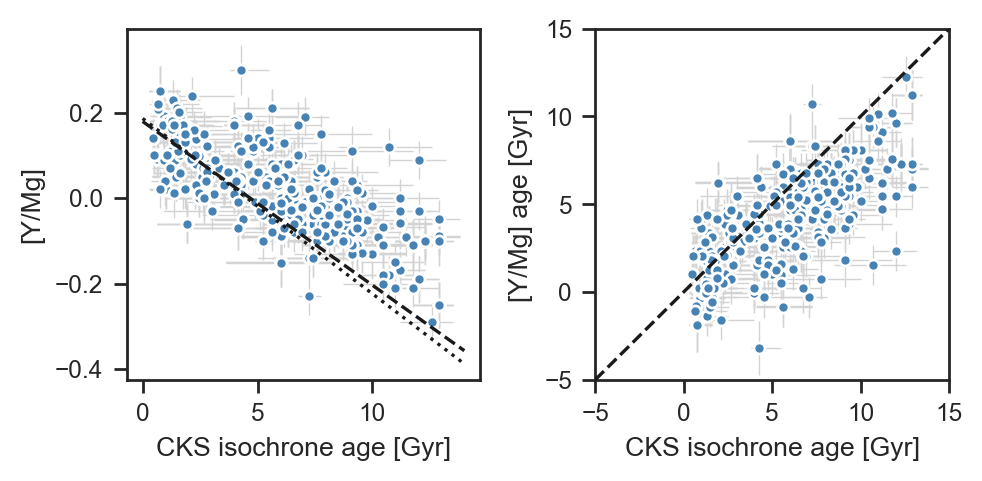

In [120]:
ebar_kwargs = {'lw':0.5, 'fmt':'o', 'ms':4, 'mec':'white', 'ecolor':'lightgrey', 'color':'steelblue'}

sun_logg = np.log10(c.GM_sun.cgs.value/(c.R_sun.cgs.value**2))

#Based loosely on Bedell 2018
sun_like = (abs(df['cks_Teff']-5772)<250) &\
           (abs(df['cks_[Fe/H]'])<0.2) &\
           (abs(df['p20_cks_slogg']-sun_logg)<0.5)

#This is from....Reinhold?
sun_rvar = 0.07
sun_ervar = 0.13

def nissen2020_age(ymg):
    return (ymg - 0.179)/(-0.0383)

def nissen2016_yal_age(yal):
    return (yal - 0.196)/(-0.0427)

def tuccimaia2020_age(ymg):
    return (4.5-24.18*ymg)


#df["ymg_ratio"] = np.log10(10.**df["bf18_[Y/H]"]/10.**df["bf18_[Mg/H]"])
#df["yal_ratio"] = np.log10(10.**df["bf18_[Y/H]"]/10.**df["bf18_[Al/H]"])
#df["ymg_age_n20"] = nissen2020_age(df["ymg_ratio"])
#df["yal_age_n16"] = nissen2016_yal_age(df["yal_ratio"])

ymg_arg = sun_like & (df["bf18_S/N"]>30)


df["cks_age_gyr"] = 10.**df["cks_logAiso"]/1.0e9
df["cks_age_lerr"] = df["cks_age_gyr"]-10.**(df["cks_logAiso"]-df["cks_e_logAiso"])/1.0e9
df["cks_age_uerr"] = 10.**(df["cks_logAiso"]+df["cks_E_logAiso"])/1.0e9 - df["cks_age_gyr"]


fig,(ax1,ax2) = plt.subplots(nrows=1,ncols=2,figsize=(5,2.5),dpi=100)

ax1.errorbar(df["cks_age_gyr"][ymg_arg], df["ymg_ratio"][ymg_arg], 
             xerr=[df["cks_age_lerr"][ymg_arg],df["cks_age_uerr"][ymg_arg]],
             yerr=df["ymg_ratio_err"][ymg_arg], **ebar_kwargs)


ax2.errorbar(df["cks_age_gyr"][ymg_arg], df["ymg_age_n20"][ymg_arg], 
             xerr=[df["cks_age_lerr"][ymg_arg],df["cks_age_uerr"][ymg_arg]],
             yerr=df["ymg_age_err_n20"][ymg_arg], **ebar_kwargs)


#ax1.plot([-3,15],[-3,15],'k--')
#ax1.set_xlim(-3,15)
#ax1.set_ylim(-3,15)

#Nissen et al. 2020 [Y/Mg]-age relation
n20x = np.linspace(0,14,100)
n20y = 0.179 - 0.0383*n20x
#Tucci-Maia et al. 2016 [Y/Mg]-age relation
t16y = 0.186 - 0.041*n20x

ax1.plot(n20x,n20y,'k--', zorder=99)
ax1.plot(n20x,t16y,'k:', zorder=98)

ax2.plot([-5,15],[-5,15],'k--', zorder=99)
ax2.set_xlim(-5,15)
ax2.set_ylim(-5,15)


ax1.set_xlabel("CKS isochrone age [Gyr]")
ax1.set_ylabel("[Y/Mg]")
ax2.set_xlabel("CKS isochrone age [Gyr]")
ax2.set_ylabel("[Y/Mg] age [Gyr]")

plt.tight_layout()
plt.show()

In [80]:
def radius_gap(period, ref='vaneylen2018'):
    
    if ref=='vaneylen2018':
        alpha = -0.09
        beta  = 0.37
        
    elif ref=='martinez2019':
        alpha = -0.11
        beta  = 0.39
        
    elif ref=='david2021':
        alpha = -0.12
        beta  = 0.37
        
        
    log10rvalley = alpha*np.log10(period) + beta
    
    return 10**log10rvalley

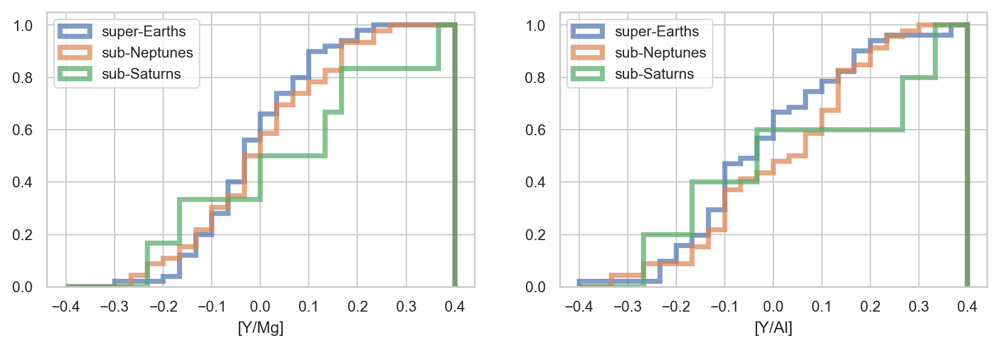

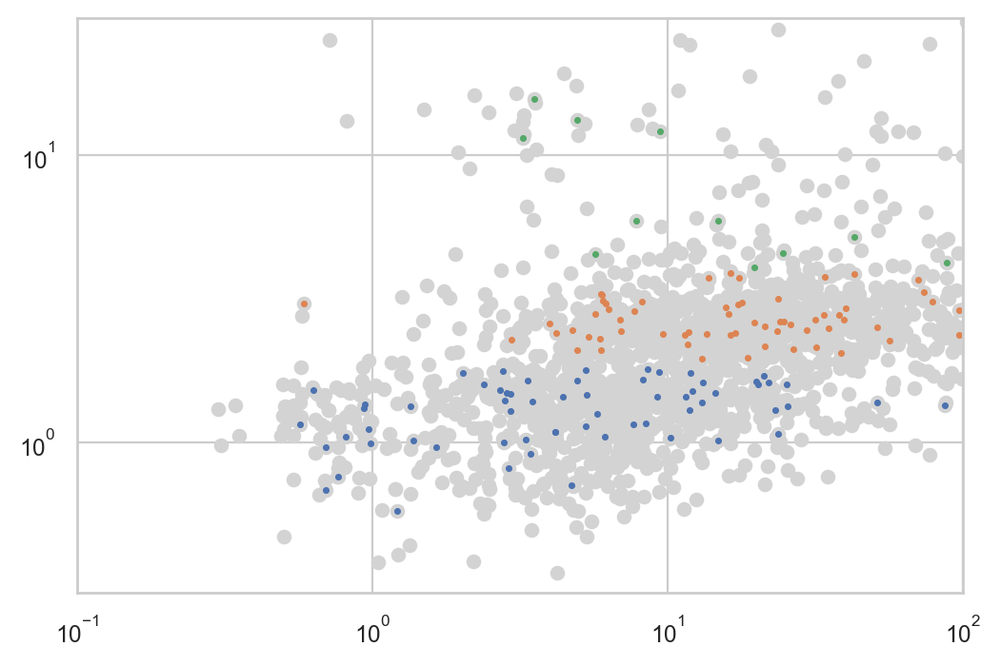

In [154]:
# se_sunlike = n20_sun_like & (df['cks_Rp']<1.8)
# sn_sunlike = n20_sun_like & (df['cks_Rp']>1.8)

# se = n20_sun_like & (df['koi_period']<100) & (df['b20b_Radius']<2)
# sn = n20_sun_like & (df['koi_period']<100) & (df['b20b_Radius']>2) & (df['b20b_Radius']<4)
# ss = n20_sun_like & (df['koi_period']<100) & (df['b20b_Radius']>4)


#Berger radii
# se = n20_sun_like & (df['koi_period']<60) & (df['b20b_Radius']<radius_gap(df['koi_period']))
# sn = n20_sun_like & (df['koi_period']<60) & (df['b20b_Radius']>radius_gap(df['koi_period'])) & (df['b20b_Radius']<4)
# ss = n20_sun_like & (df['koi_period']<60) & (df['b20b_Radius']>4)

# #CKS radii
# se = n20_sun_like & (df['koi_period']<100) & (df['cks_Rp']<radius_gap(df['koi_period']))
# sn = n20_sun_like & (df['koi_period']<100) & (df['cks_Rp']>radius_gap(df['koi_period'])) & (df['cks_Rp']<4)
# ss = n20_sun_like & (df['koi_period']<100) & (df['cks_Rp']>4)

se = sun_like & (df['koi_period']<100) & (df['cks_Rp']<radius_gap(df['koi_period']))
sn = sun_like & (df['koi_period']<100) & (df['cks_Rp']>radius_gap(df['koi_period'])) & (df['cks_Rp']<4)
ss = sun_like & (df['koi_period']<100) & (df['cks_Rp']>4)

#CKS radii
# se = (df['koi_period']<100) & (df['cks_Rp']<radius_gap(df['koi_period']))
# sn = (df['koi_period']<100) & (df['cks_Rp']>radius_gap(df['koi_period'])) & (df['cks_Rp']<4)
# ss = (df['koi_period']<100) & (df['cks_Rp']>4)

fig,(ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(10,3))

hist_kws = {'cumulative':True, 'histtype': 'step', 'density':True, 'lw': 3, 'alpha':0.7, 'bins': np.linspace(-0.4,0.4,25)}

ax1.hist(df['ymg_ratio'][se], **hist_kws, label='super-Earths')
ax1.hist(df['ymg_ratio'][sn], **hist_kws, label='sub-Neptunes')
ax1.hist(df['ymg_ratio'][ss], **hist_kws, label='sub-Saturns')
ax1.legend(loc='upper left')
ax1.set_xlabel('[Y/Mg]')

ax2.hist(df['yal_ratio'][se], **hist_kws, label='super-Earths')
ax2.hist(df['yal_ratio'][sn], **hist_kws, label='sub-Neptunes')
ax2.hist(df['yal_ratio'][ss], **hist_kws, label='sub-Saturns')
ax2.legend(loc='upper left')
ax2.set_xlabel('[Y/Al]')
plt.show()

plt.scatter(df['koi_period'], df['cks_Rp'], color='lightgrey')
plt.scatter(df['koi_period'][se], df['cks_Rp'][se], s=3)
plt.scatter(df['koi_period'][sn], df['cks_Rp'][sn], s=3)
plt.scatter(df['koi_period'][ss], df['cks_Rp'][ss], s=3)
plt.loglog()
plt.ylim(0.3,30)
plt.xlim(0.1,100)
plt.show()

In [89]:
for col in df.columns:
   print(col)

kepid
kepoi_name
kepler_name
ra
ra_err
ra_str
dec
dec_err
dec_str
koi_gmag
koi_gmag_err
koi_rmag
koi_rmag_err
koi_imag
koi_imag_err
koi_zmag
koi_zmag_err
koi_jmag
koi_jmag_err
koi_hmag
koi_hmag_err
koi_kmag
koi_kmag_err
koi_kepmag
koi_kepmag_err
koi_delivname
koi_vet_stat
koi_quarters
koi_disposition
koi_pdisposition
koi_count
koi_num_transits
koi_max_sngle_ev
koi_max_mult_ev
koi_bin_oedp_sig
koi_limbdark_mod
koi_ldm_coeff4
koi_ldm_coeff3
koi_ldm_coeff2
koi_ldm_coeff1
koi_trans_mod
koi_model_snr
koi_model_dof
koi_model_chisq
koi_time0bk
koi_time0bk_err1
koi_time0bk_err2
koi_eccen
koi_eccen_err1
koi_eccen_err2
koi_longp
koi_longp_err1
koi_longp_err2
koi_prad
koi_prad_err1
koi_prad_err2
koi_sma
koi_sma_err1
koi_sma_err2
koi_impact
koi_impact_err1
koi_impact_err2
koi_duration
koi_duration_err1
koi_duration_err2
koi_ingress
koi_ingress_err1
koi_ingress_err2
koi_depth
koi_depth_err1
koi_depth_err2
koi_period
koi_period_err1
koi_period_err2
koi_ror
koi_ror_err1
koi_ror_err2
koi_dor
koi_dor_e

# SN multis vs SE multis

In [144]:
#for col in df.columns:
#    print(col)
#df['p20_multi']

# for i in range(100):
#     _kic = df['kepid'].iloc[i]
#     _koi = df['kepoi_name'][df['kepid']==_kic]
#     print(_kic, _koi)
    
    

/Users/tdavid/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/Users/tdavid/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1366: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


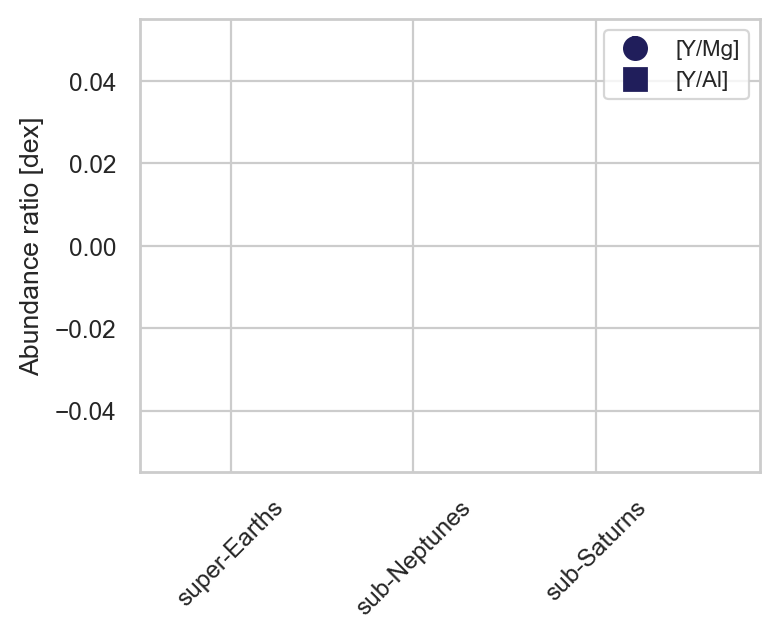

In [153]:
m =  (df['koi_score']>0.99)
m &= (df['b20_iso_rad']<2)
m &= (df['koi_period']<100)
m &= (df['koi_disposition']!='FALSE POSITIVE')
m &= (df['p17_Disp']!='FP')

se = m & (df['koi_period']<100) & (df['cks_Rp']<radius_gap(df['koi_period']))
sn = m & (df['koi_period']<100) & (df['cks_Rp']>radius_gap(df['koi_period'])) & (df['cks_Rp']<4)
ss = m & (df['koi_period']<100) & (df['cks_Rp']>4)

var = [df['ymg_ratio'][se], df['ymg_ratio'][sn], df['ymg_ratio'][ss]]

ebar_kws = {'ms':8, 'lw':2}

for i,v in enumerate(var):
    _yerr =[[np.nanmedian(v)-np.nanpercentile(v,16)],[np.nanpercentile(v,84)-np.nanmedian(v)]]
    if i == 2:
        plt.errorbar(i, np.nanmedian(v), yerr=_yerr, fmt='o', color=berry[i], label='[Y/Mg]', **ebar_kws)
    else:
        plt.errorbar(i, np.nanmedian(v), yerr=_yerr, fmt='o', color=berry[i], **ebar_kws)        

var = [df['yal_ratio'][se], df['yal_ratio'][sn], df['yal_ratio'][ss]]

for i,v in enumerate(var):
    _yerr =[[np.nanmedian(v)-np.nanpercentile(v,16)],[np.nanpercentile(v,84)-np.nanmedian(v)]]
    if i == 2:
        plt.errorbar(i+0.2, np.nanmedian(v), yerr=_yerr, fmt='s', color=berry[i], label='[Y/Al]', **ebar_kws)
    else:
        plt.errorbar(i+0.2, np.nanmedian(v), yerr=_yerr, fmt='s', color=berry[i], **ebar_kws)
    
plt.legend(prop={'size':8})
plt.xticks([0.1,1.1,2.1],['super-Earths','sub-Neptunes','sub-Saturns'], rotation=45)
plt.ylabel('Abundance ratio [dex]')
plt.xlim(-0.4,3)
plt.gcf().set_size_inches(4,3)
plt.show()

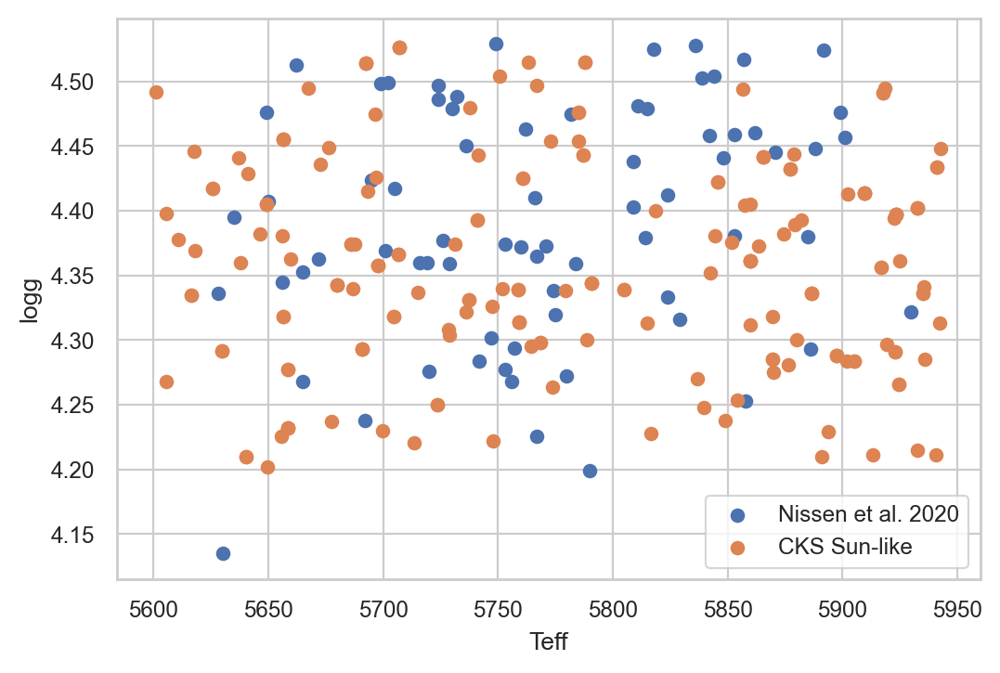

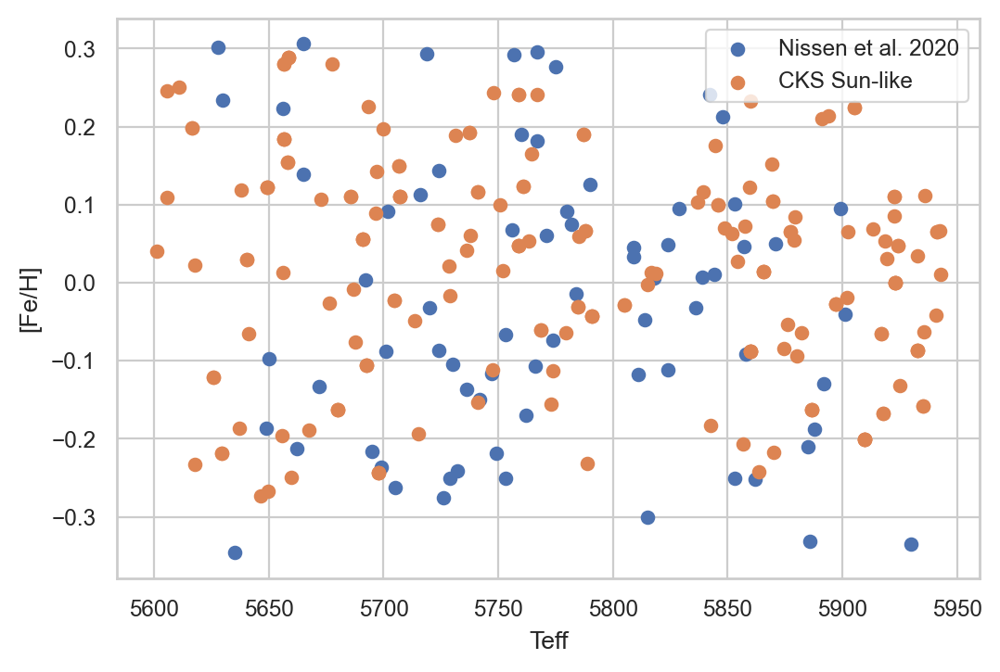

72 stars in solar twin sample
128 stars in exoplanet host sample


In [155]:
plt.scatter(nis['Teff'], nis['logg-sp'], label='Nissen et al. 2020')
plt.scatter(df['p20_cks_steff'][n20_sun_like], df['p20_cks_slogg'][n20_sun_like], label='CKS Sun-like')
plt.legend()
plt.xlabel('Teff')
plt.ylabel('logg')
plt.show()


plt.scatter(nis['Teff'], nis['[Fe/H]'], label='Nissen et al. 2020')
plt.scatter(df['p20_cks_steff'][n20_sun_like], df['p20_cks_smet'][n20_sun_like], label='CKS Sun-like')
plt.legend()
plt.xlabel('Teff')
plt.ylabel('[Fe/H]')
plt.show()

print(len(nis['Teff']), 'stars in solar twin sample')
print(len(np.unique(df['kepid'][n20_sun_like])), 'stars in exoplanet host sample')


In [271]:
# tmp = Table.read("https://cdsarc.cds.unistra.fr/ftp/J/ApJ/865/68/table2.dat",
#                 readme="https://cdsarc.cds.unistra.fr/ftp/J/ApJ/865/68/ReadMe",
#                 format="ascii.cds")
# tmp.info()

In [145]:
# plt.hist(nis['Teff'], alpha=0.2, density=True, label='N20')
# plt.hist(df['cks_Teff'][n20_sun_like], alpha=0.2, density=True, label='CKS')
# plt.legend()
# plt.show()

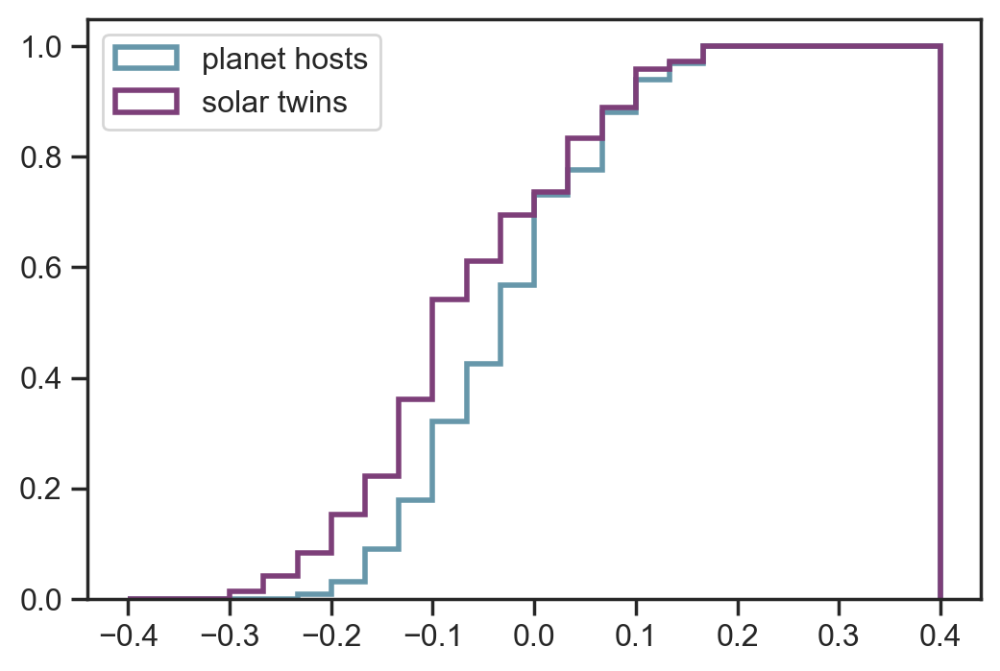

Anderson_ksampResult(statistic=5.019499418691325, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.003413370267153048)
Anderson_ksampResult(statistic=6.0935553565830105, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.0014362300399338814)


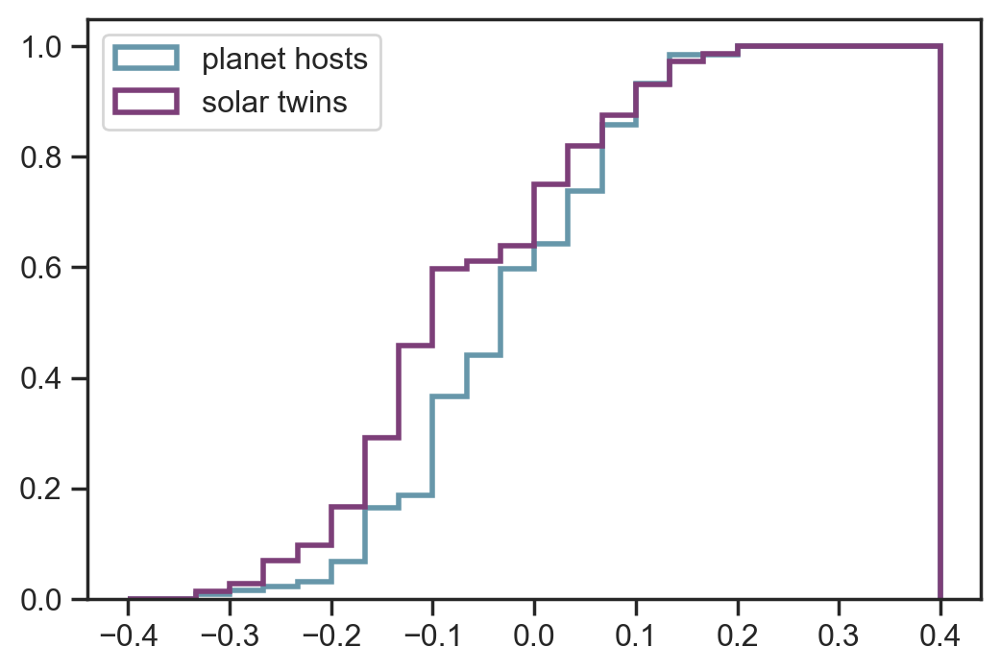

Anderson_ksampResult(statistic=-0.17273057388231094, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.25)


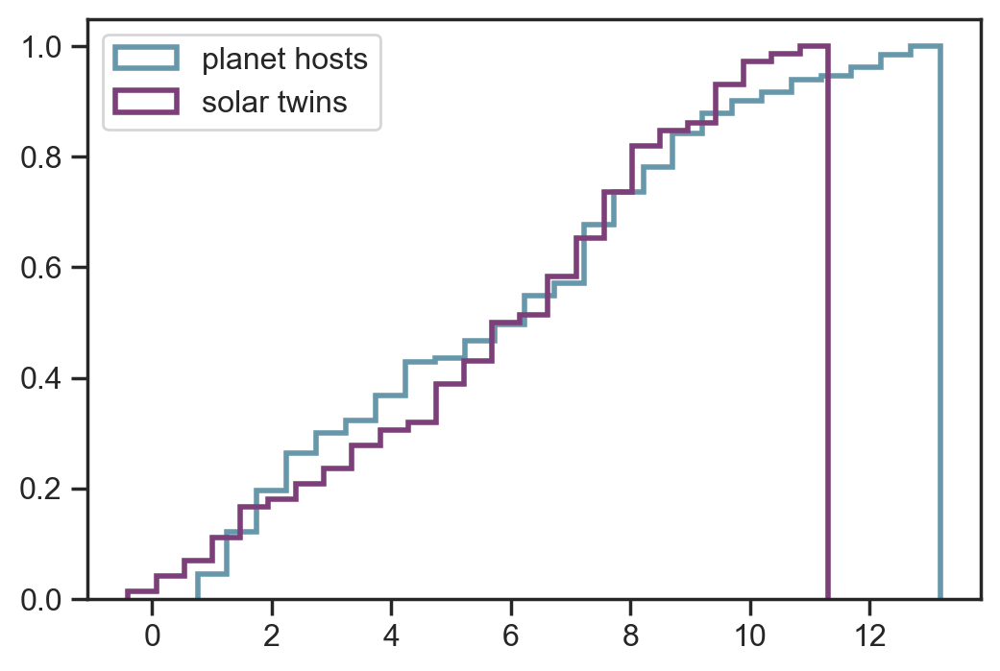

Anderson_ksampResult(statistic=5.945808762545391, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.0016138350694875426)


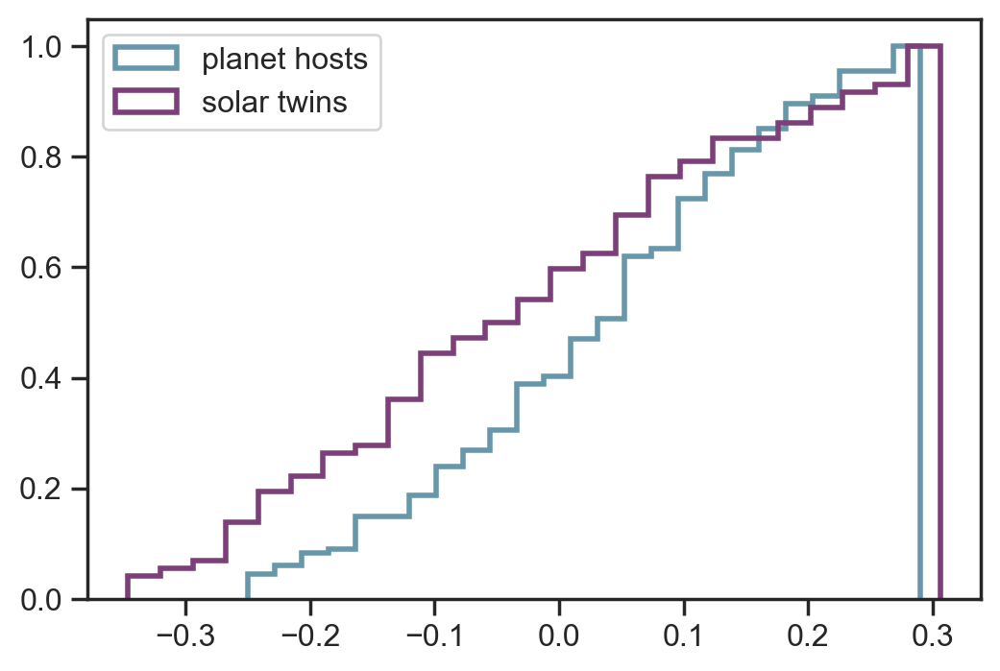

In [272]:
hist_kws = {"density":True, "histtype":"step", "lw":2, "cumulative":True, "bins": np.linspace(-0.4,0.4,25)}

_x = df['ymg_ratio'][n20_sun_like]
_y = nis['ymg_ratio']
plt.hist(_x, **hist_kws, label='planet hosts')
plt.hist(_y, **hist_kws, label='solar twins')
plt.legend(loc='upper left')
plt.show()

ad_result = anderson_ksamp([_x, _y], midrank=True)
print(ad_result)


_x = df['yal_ratio'][n20_sun_like]
_y = nis['yal_ratio']
plt.hist(_x, **hist_kws, label='planet hosts')
plt.hist(_y, **hist_kws, label='solar twins')
plt.legend(loc='upper left')

ad_result = anderson_ksamp([_x, _y], midrank=True)
print(ad_result)
plt.show()

hist_kws = {"density":True, "histtype":"step", "lw":2, "cumulative":True, "bins": 25}

_x = df['cks_age_gyr'][n20_sun_like]
_y = nis['Age']
plt.hist(_x, **hist_kws, label='planet hosts')
plt.hist(_y, **hist_kws, label='solar twins')
plt.legend(loc='upper left')

ad_result = anderson_ksamp([_x, _y], midrank=True)
print(ad_result)
plt.show()

hist_kws = {"density":True, "histtype":"step", "lw":2, "cumulative":True, "bins": 25}

_x = df['cks_[Fe/H]'][n20_sun_like]
_y = nis['[Fe/H]']
plt.hist(_x, **hist_kws, label='planet hosts')
plt.hist(_y, **hist_kws, label='solar twins')
plt.legend(loc='upper left')

ad_result = anderson_ksamp([_x, _y], midrank=True)
print(ad_result)
plt.show()

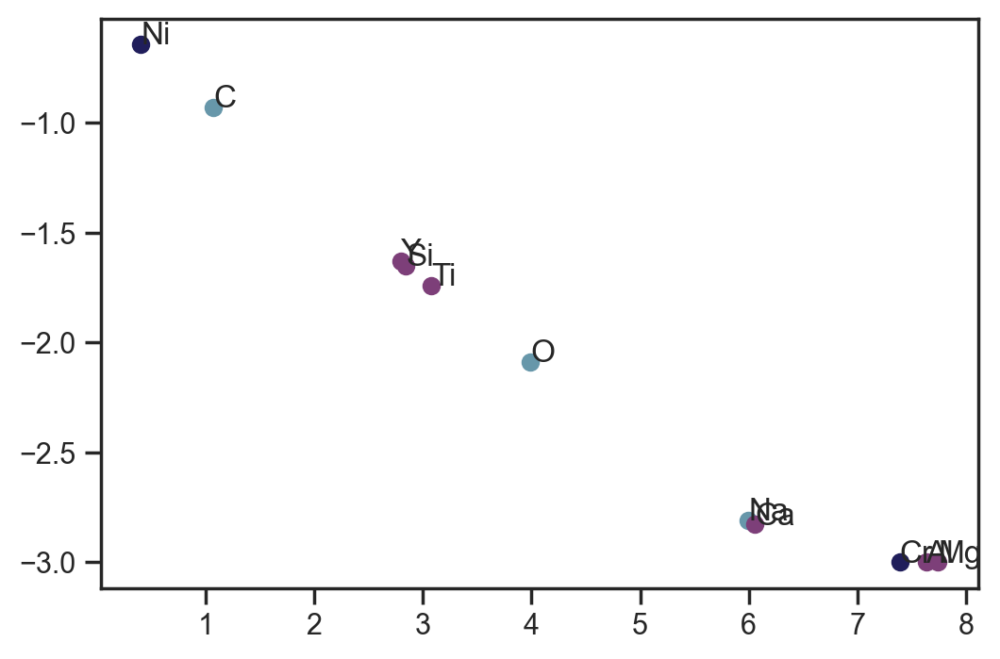

In [485]:
#C ?
#O volatile lithophile
#Na volatile lithophile

#Si refractory lithophile
#Mg refractory lithophile
#Al refractory lithophile
#Ca refractory lithophile
#Y refractory lithophile
#Ti refractory lithophile

#Cr refractory siderophile
#Fe refractory siderophile
#Ni refractory siderophile

elems = ['C','O','Na','Mg','Al','Si','Ca','Ti','Cr','Ni','Y']
elem_types = [0,0,0,1,1,1,1,1,2,2,1]

for i in range(len(elems)):
    plt.scatter(adstats[i], np.log10(pvals[i]), c=berry[elem_types[i]])
    plt.text(adstats[i], np.log10(pvals[i]), elems[i])
plt.show()

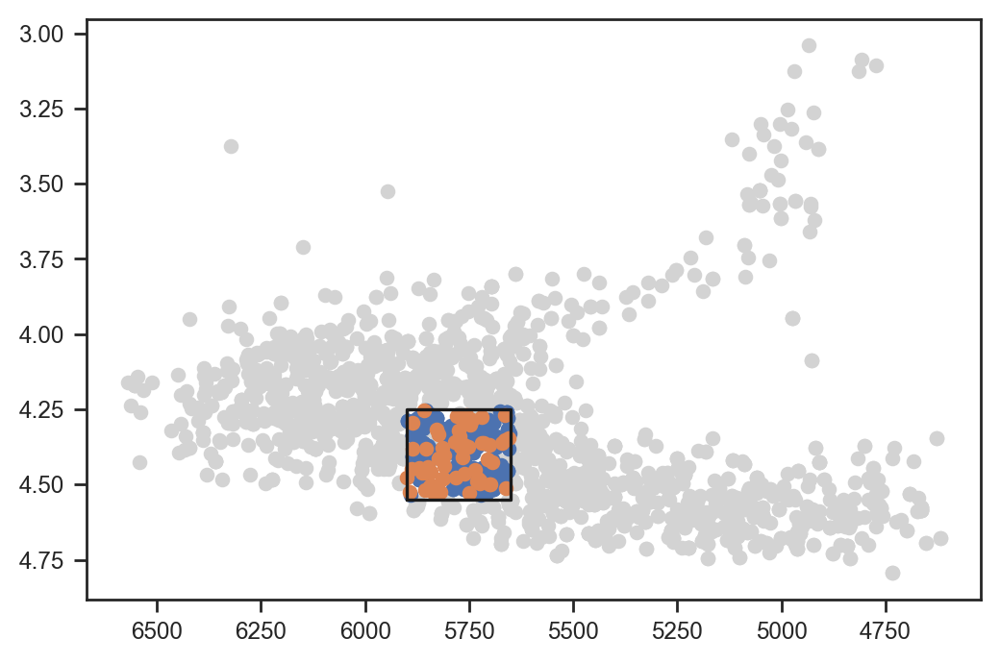

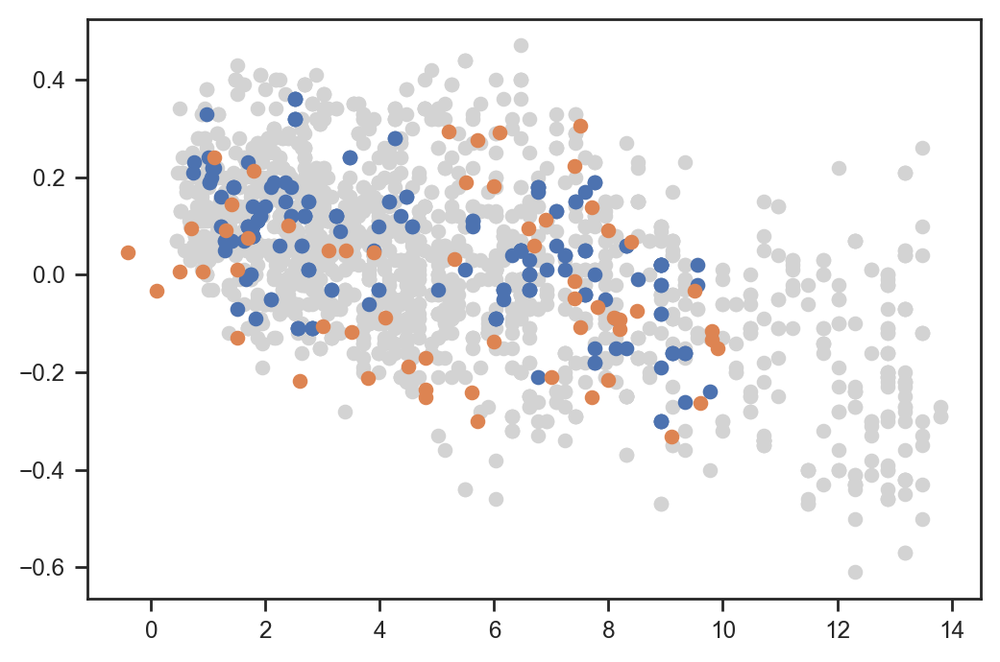

In [133]:
n20_sun_like = (df['cks_Teff']>5650)&(df['cks_Teff']<5900)&\
               (df['p20_cks_slogg']>4.25)&(df['p20_cks_slogg']<4.55)&\
               (df['cks_age']<10)#(df['cks_[Fe/H]']>-0.3)&(df['cks_[Fe/H]']<0.3) #& (df['bf18_S/N']>30)



n20_cut = (nis['Teff']>5650) & (nis['Teff']<5900)&\
          (nis['logg-sp']>4.25) & (nis['logg-sp']<4.55)&\
          (nis['Age']<10)


plt.scatter(df['p20_cks_steff'], df['p20_cks_slogg'], color='lightgrey')
plt.scatter(df['p20_cks_steff'][n20_sun_like], df['p20_cks_slogg'][n20_sun_like])
plt.scatter(nis['Teff'][n20_cut], nis['logg-sp'][n20_cut])
#plt.xlim(6250,5500)
#plt.ylim(4.75,3.75)
plt.gca().invert_yaxis()
plt.gca().invert_xaxis()
plt.plot([5900,5900,5650,5650,5900],[4.55,4.25,4.25,4.55,4.55],'k')
plt.show()

plt.scatter(df['cks_age'], df['cks_[Fe/H]'], color='lightgrey')
plt.scatter(df['cks_age'][n20_sun_like], df['cks_[Fe/H]'][n20_sun_like])
plt.scatter(nis['Age'][n20_cut], nis['[Fe/H]'][n20_cut])
#plt.xlim(6250,5500)
#plt.ylim(4.75,3.75)
#plt.gca().invert_yaxis()
#plt.gca().invert_xaxis()
#plt.plot([5900,5900,5650,5650,5900],[4.55,4.25,4.25,4.55,4.55],'k')
plt.show()

C O


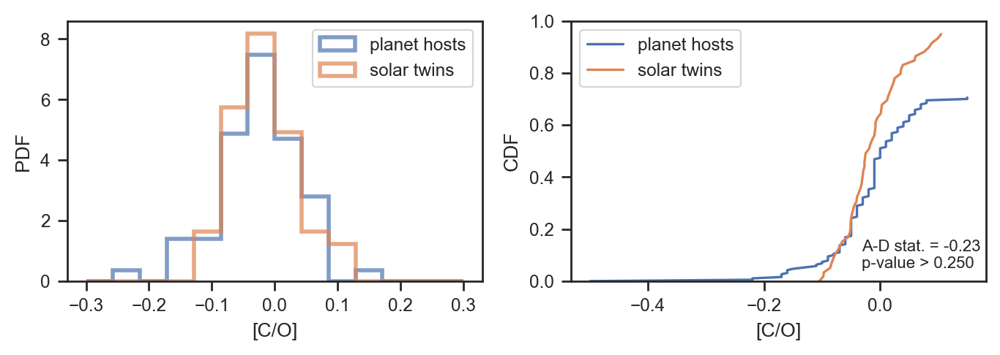

C Na


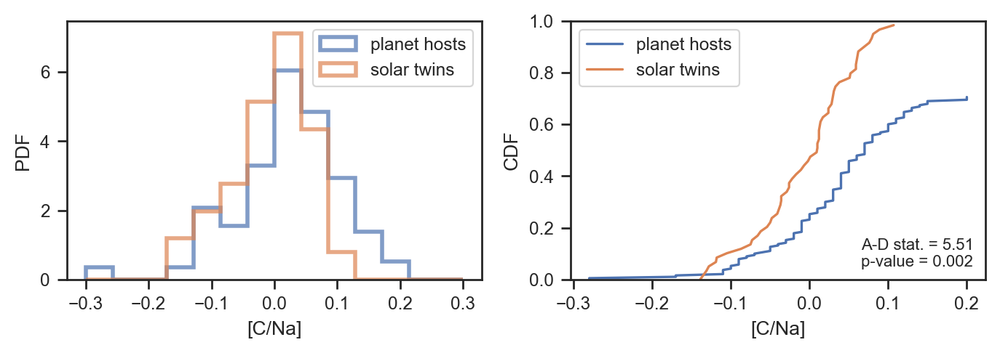

C Mg


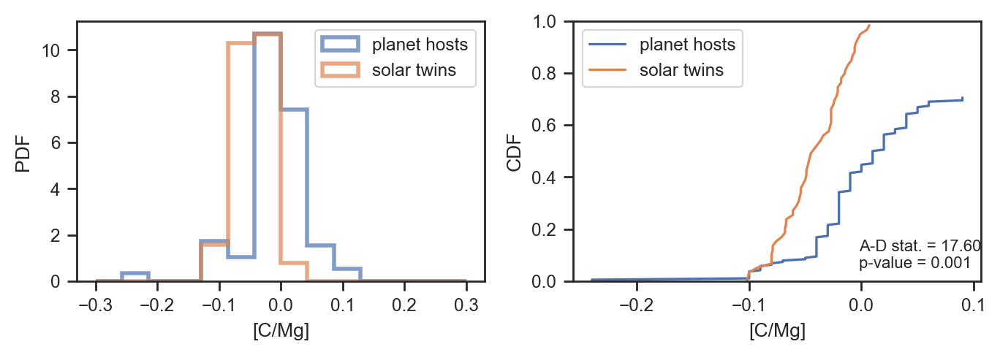

C Al


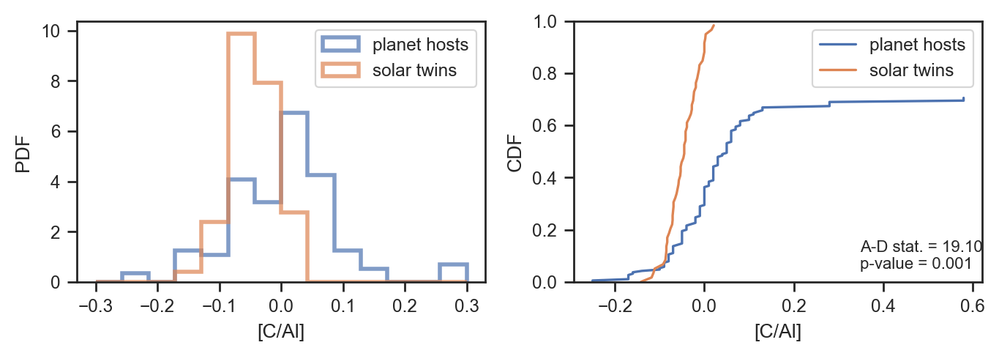

C Si


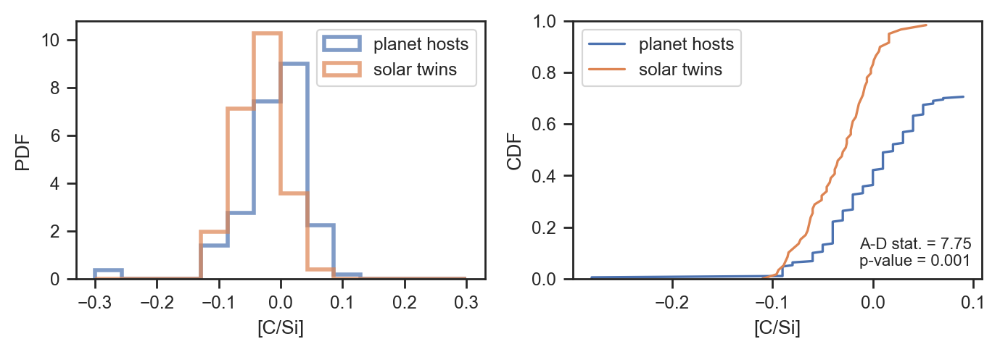

C Ca


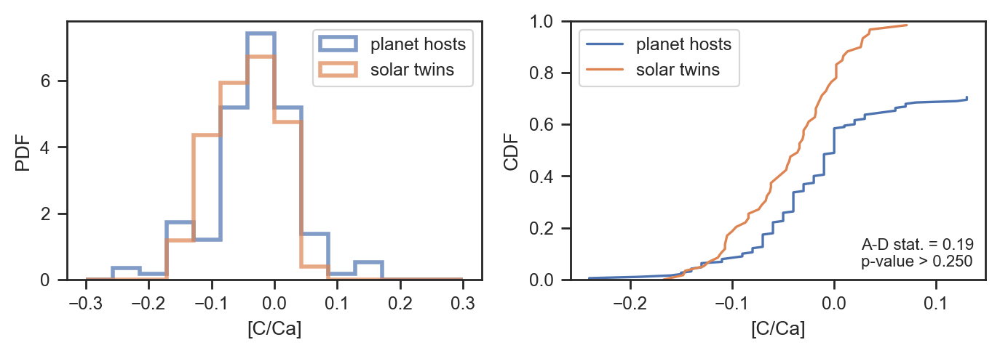

C Ti


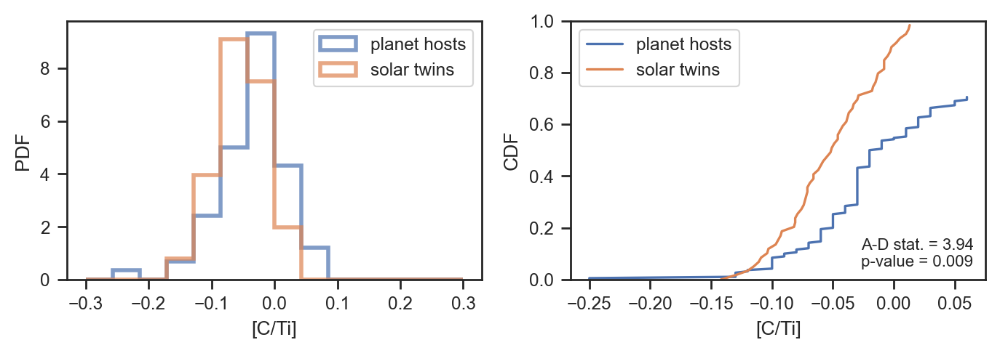

C Cr


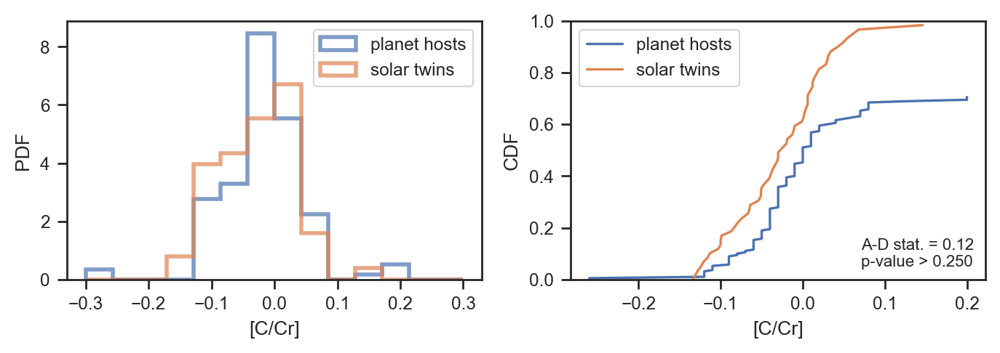

C Ni


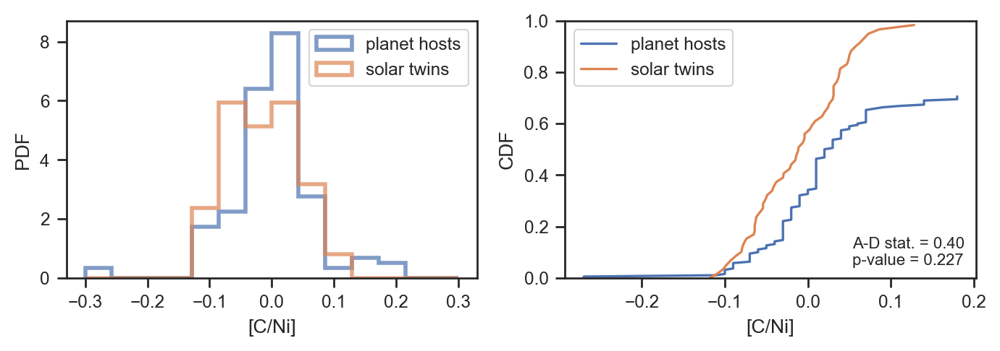

C Y


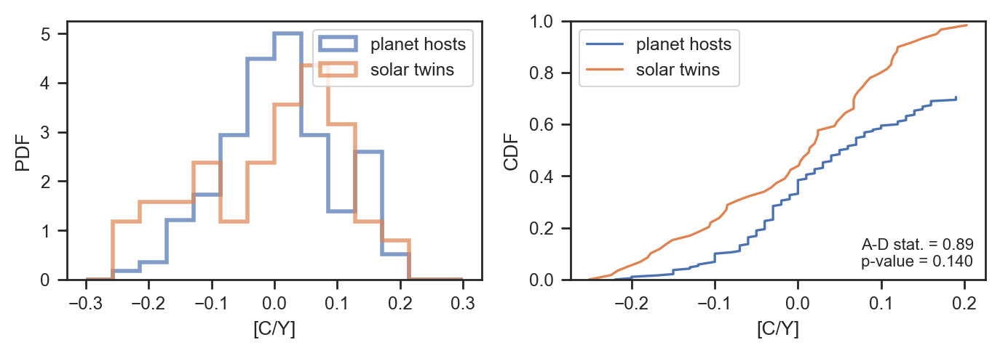

O C


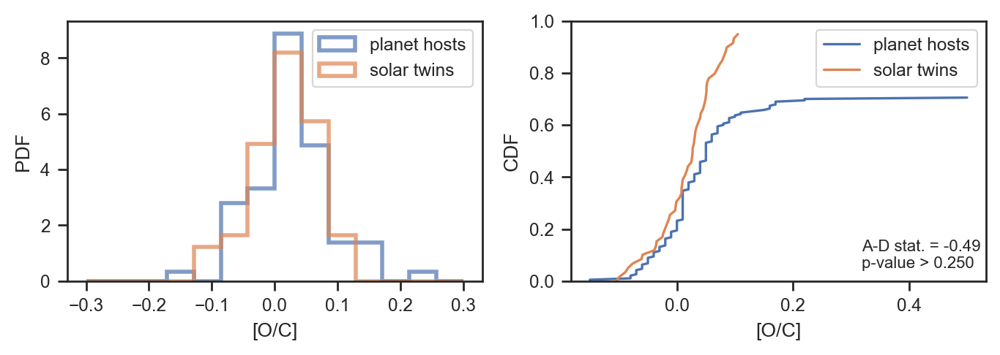

O Na


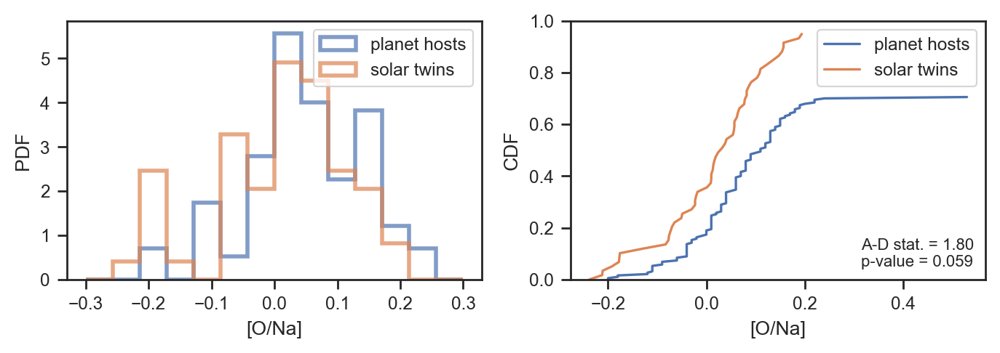

O Mg


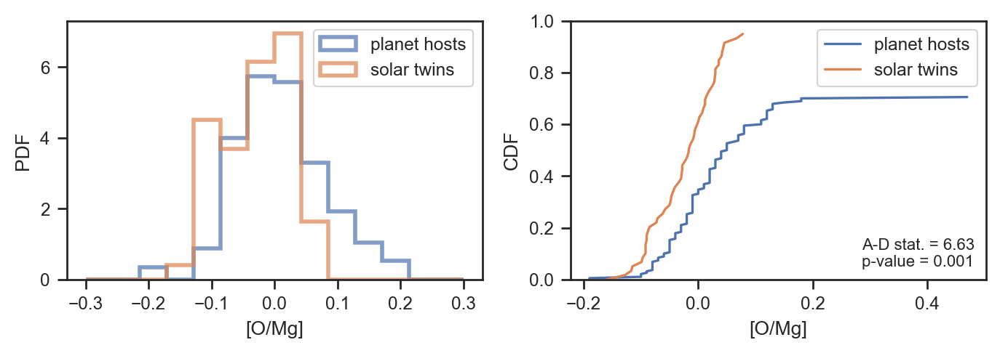

O Al


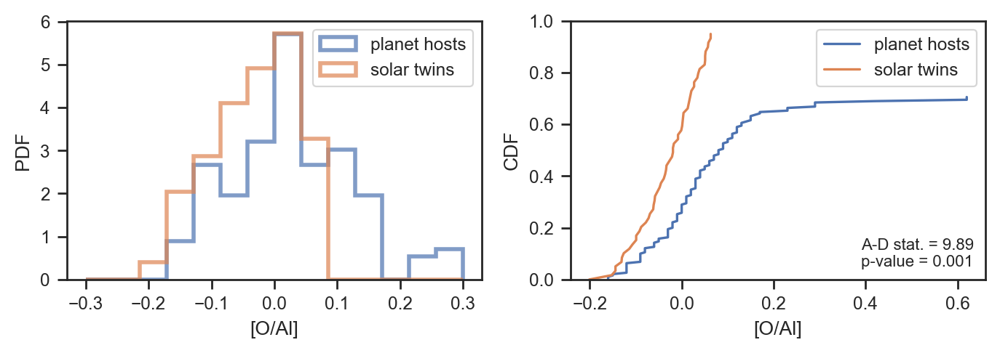

O Si


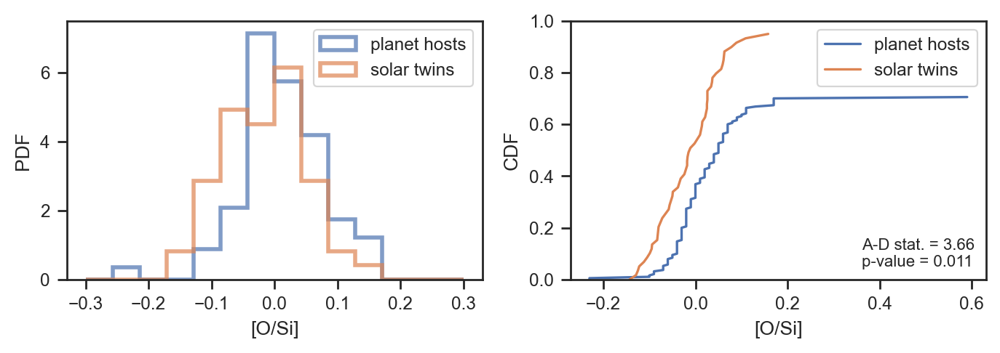

O Ca


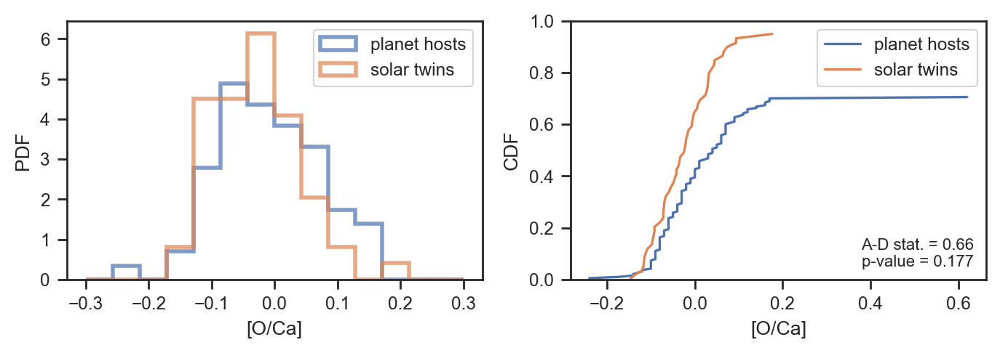

O Ti


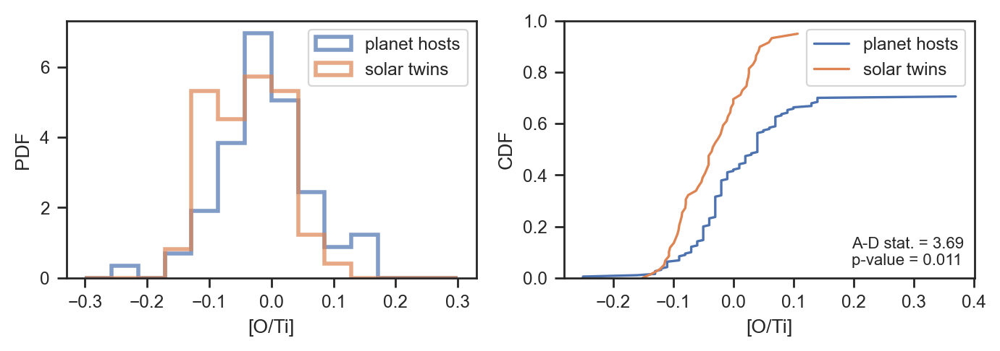

O Cr


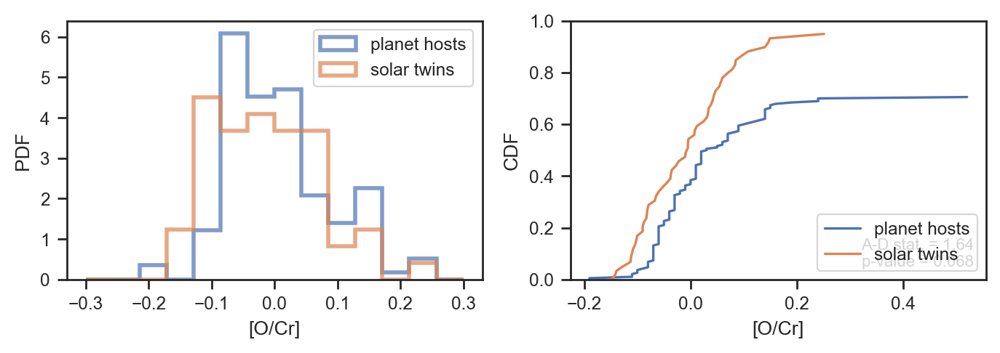

O Ni


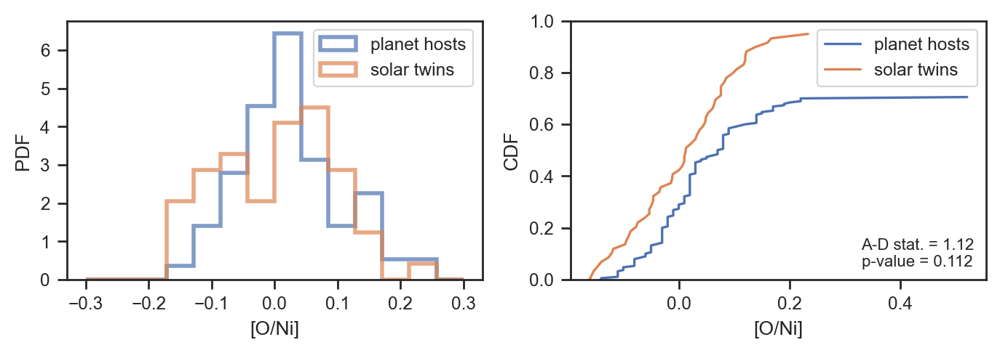

O Y


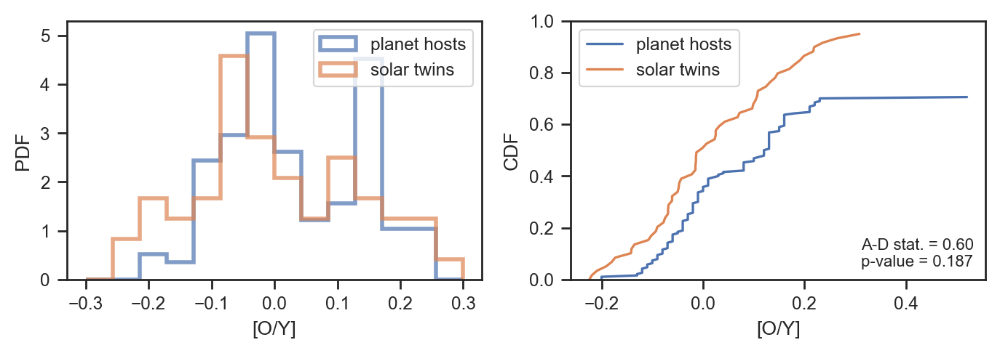

Na C


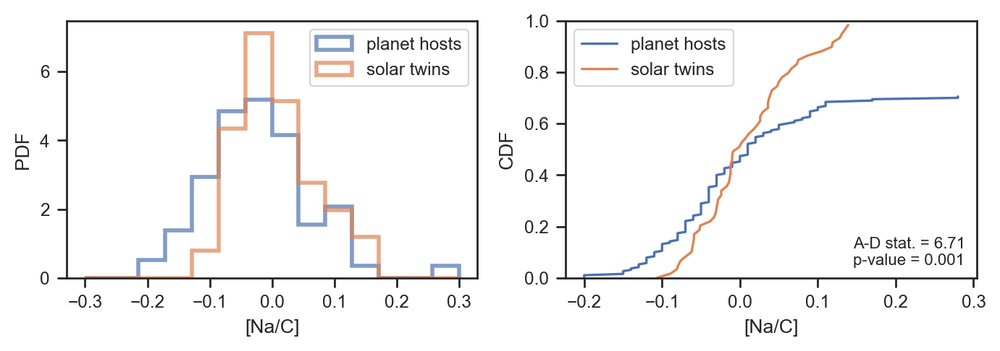

Na O


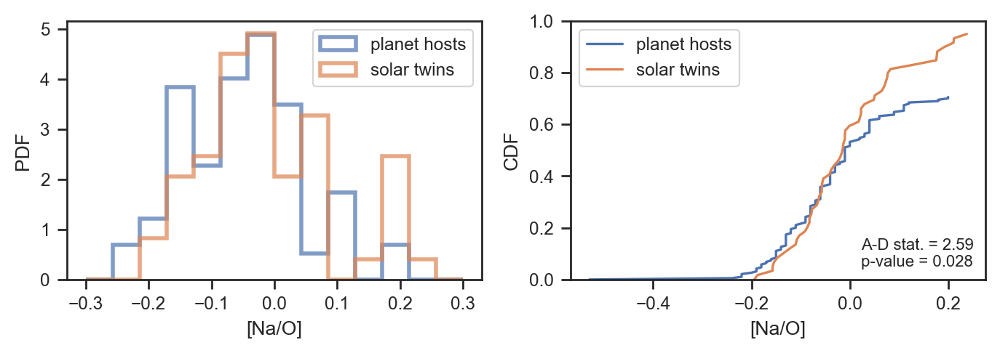

Na Mg


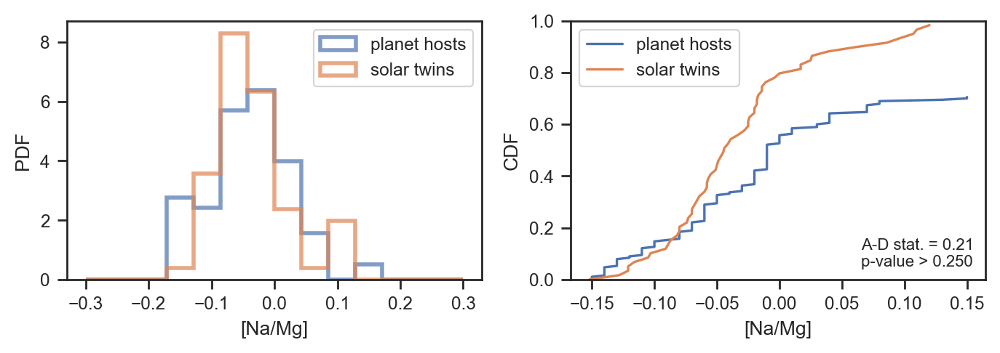

Na Al


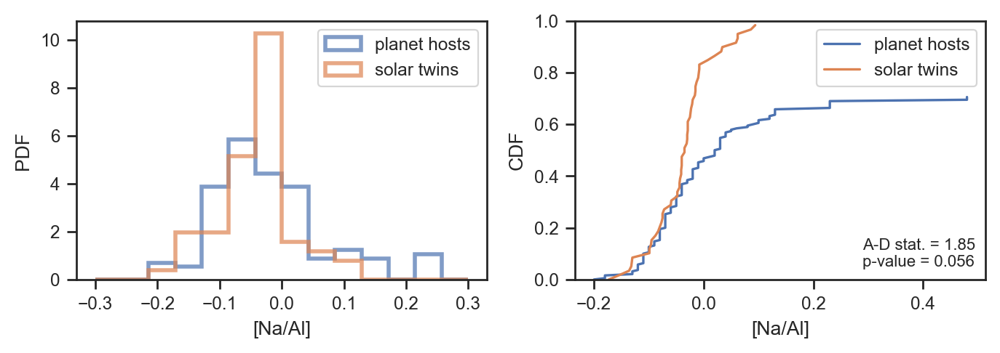

Na Si


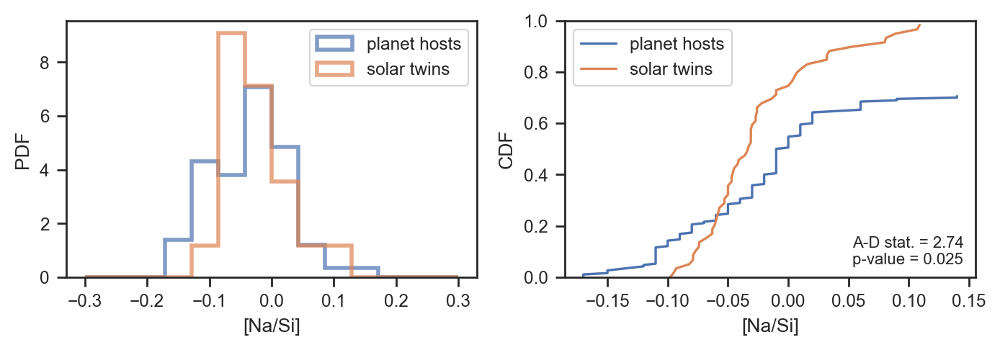

Na Ca


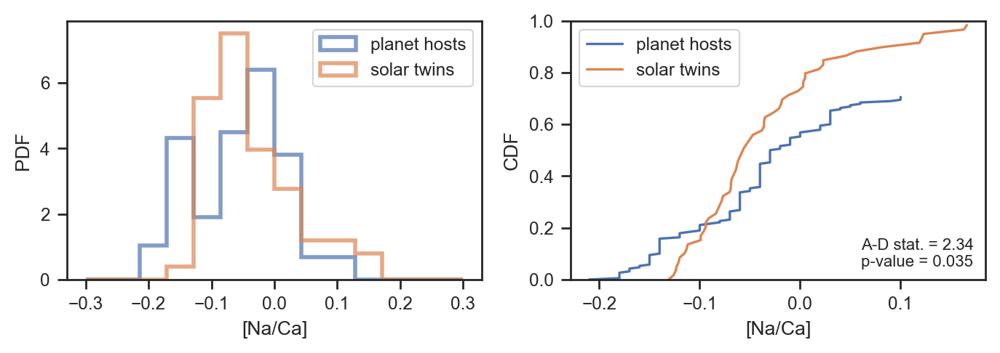

Na Ti


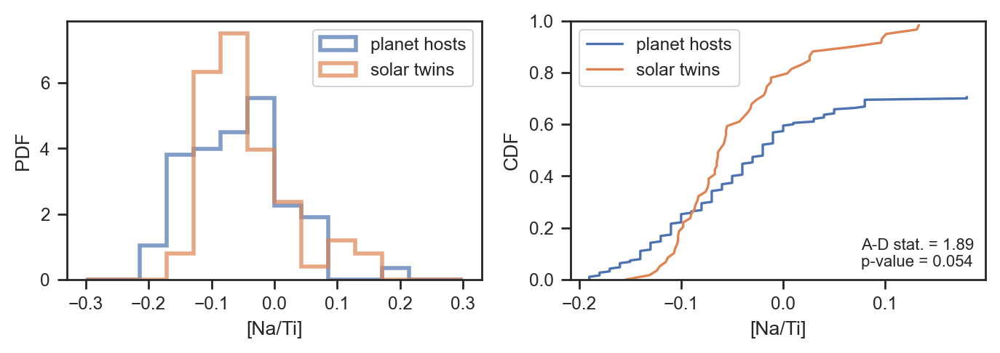

Na Cr


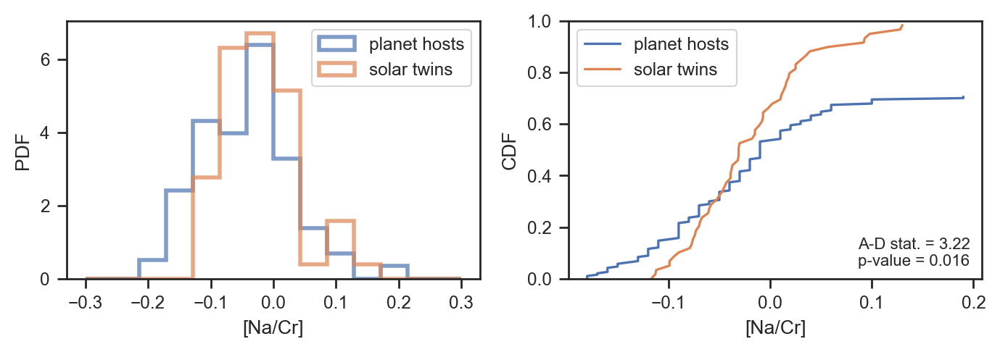

Na Ni


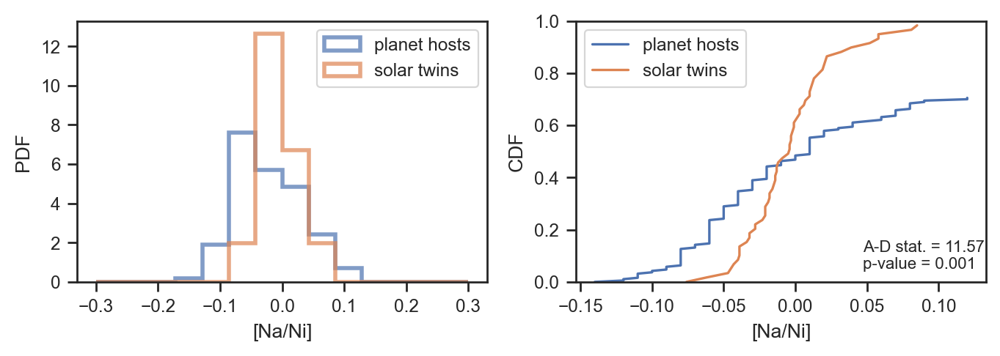

Na Y


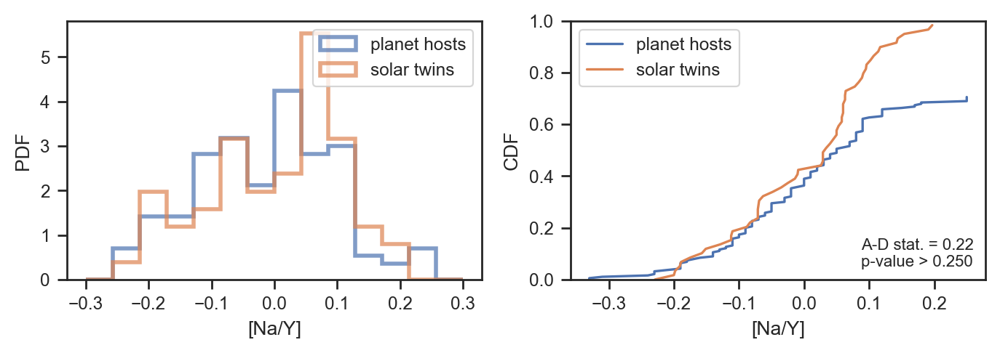

Mg C


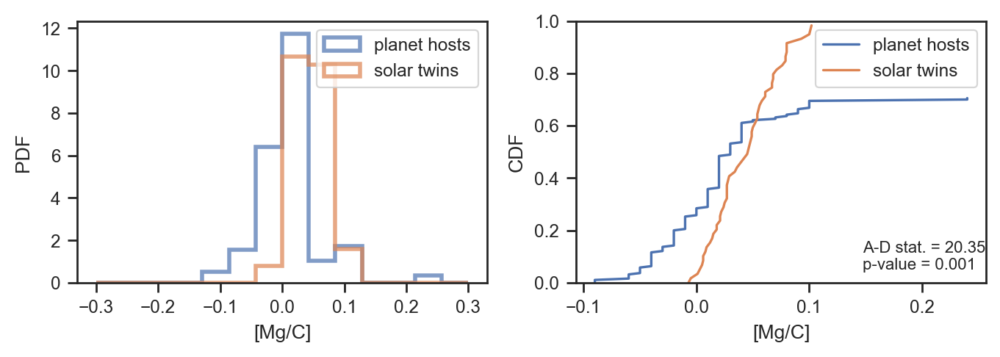

Mg O


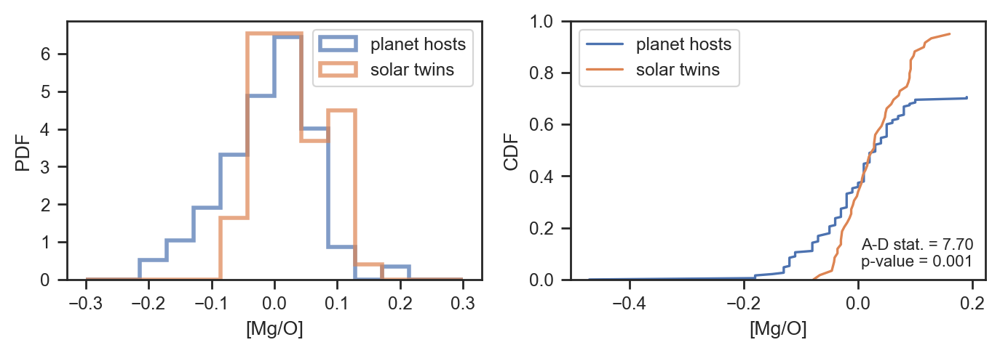

Mg Na


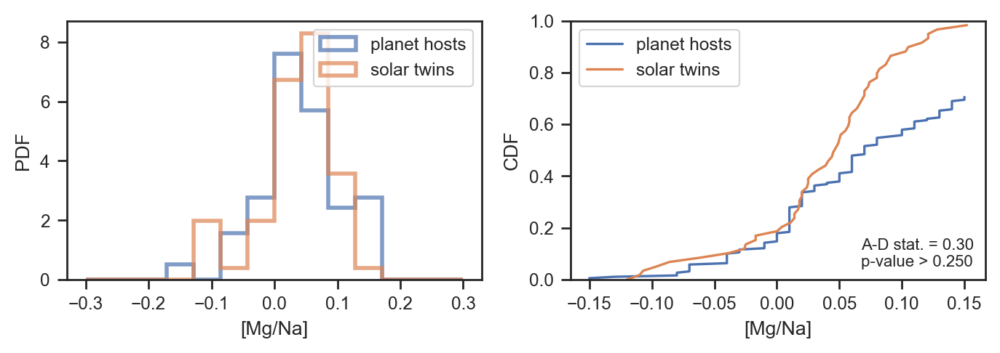

Mg Al


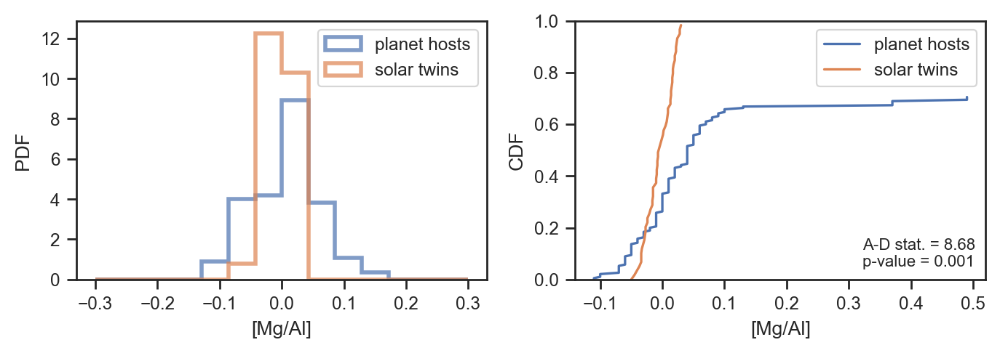

Mg Si


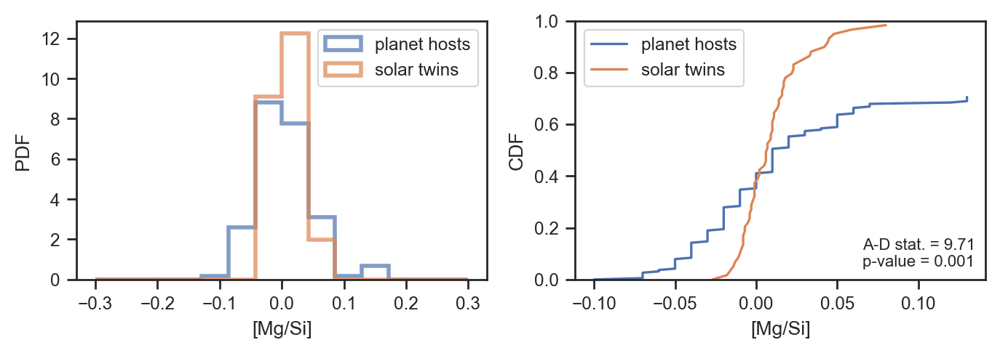

Mg Ca


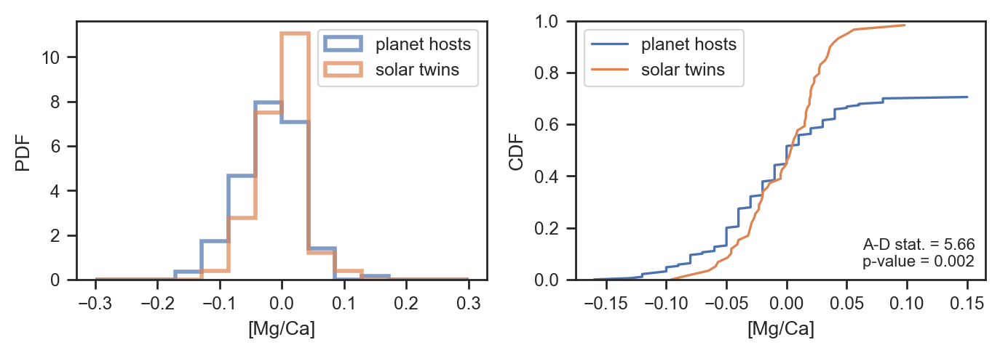

Mg Ti


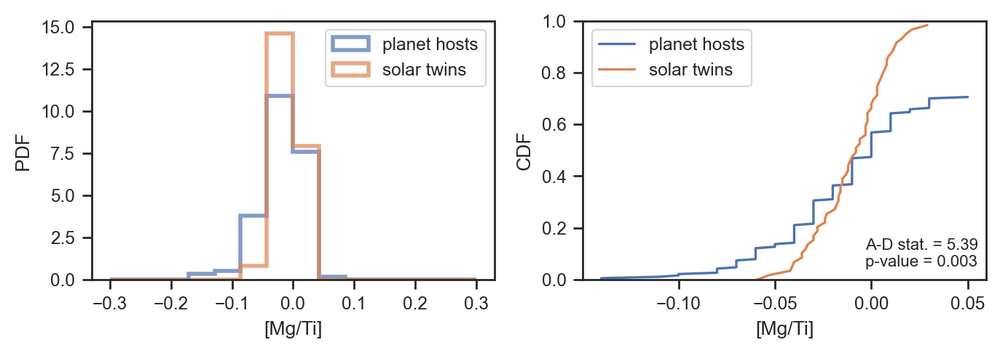

Mg Cr


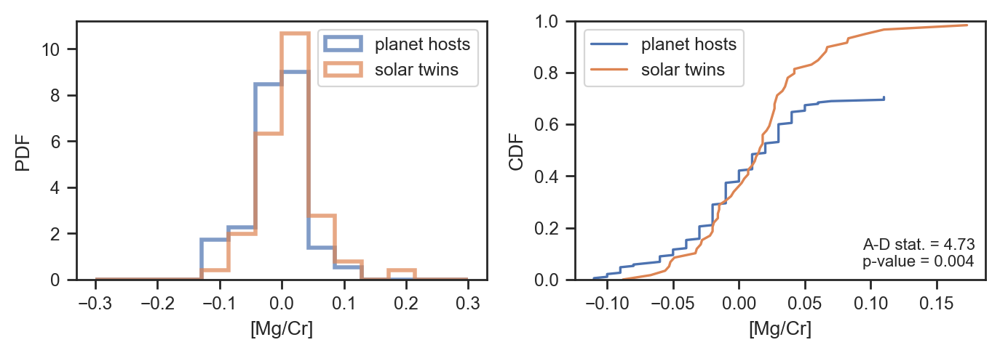

Mg Ni


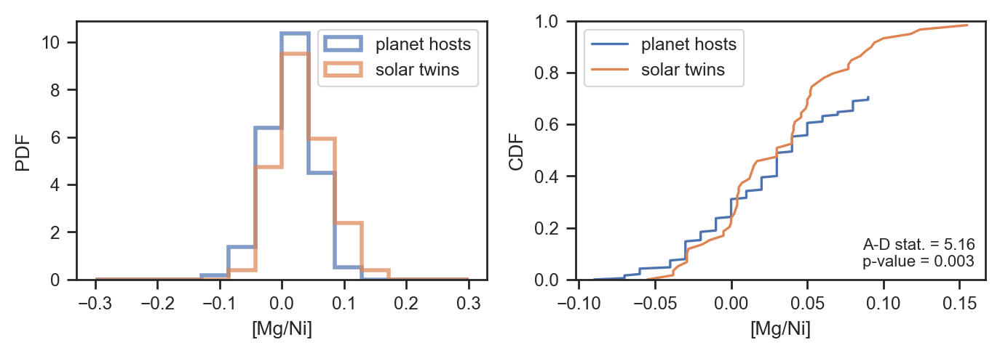

Mg Y


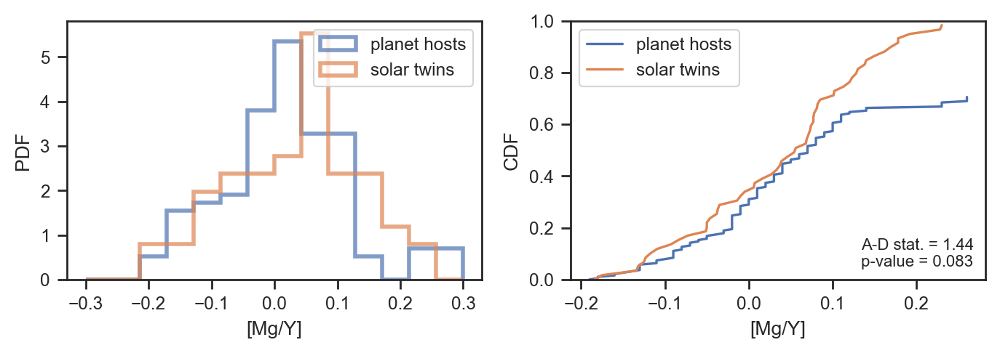

Al C


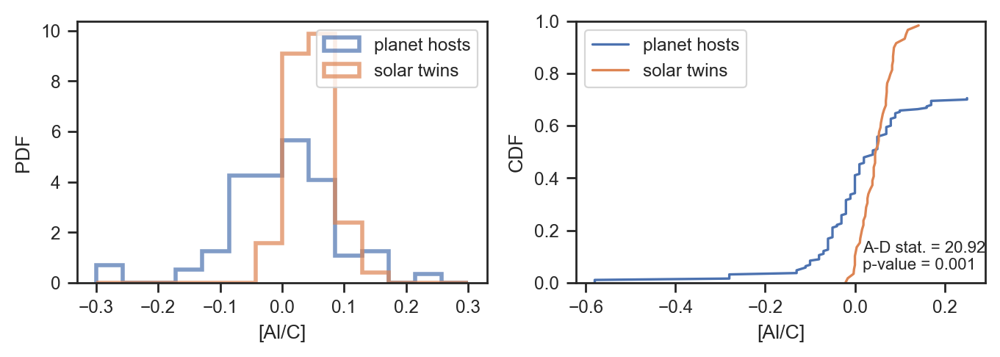

Al O


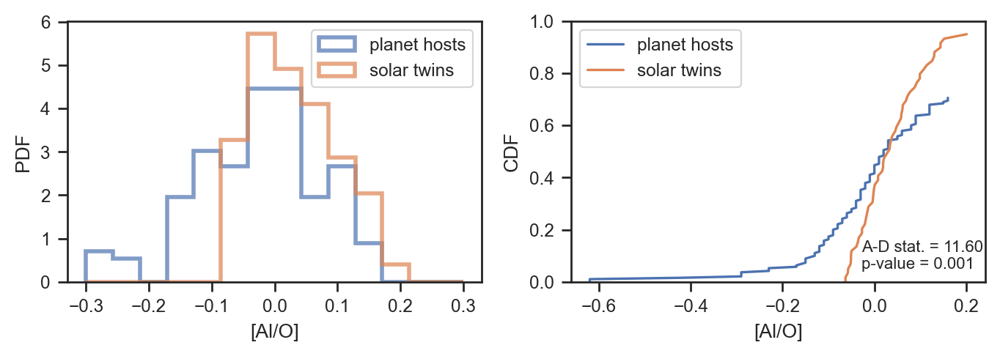

Al Na


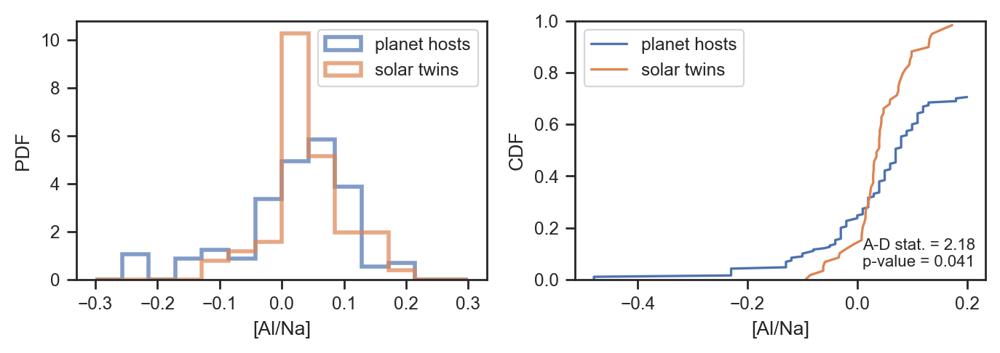

Al Mg


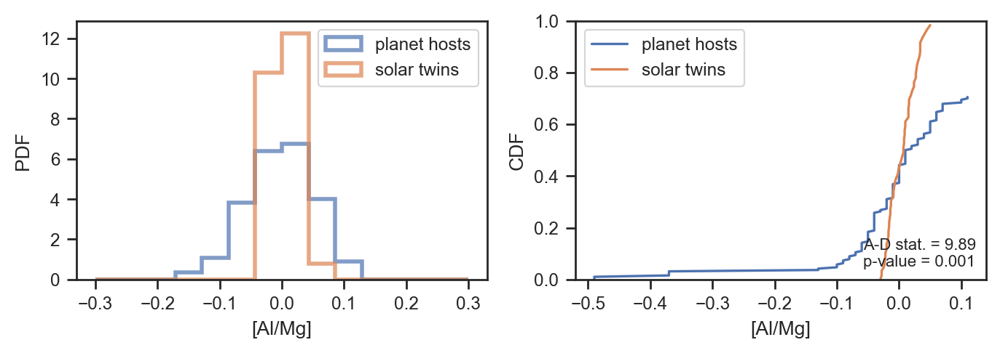

Al Si


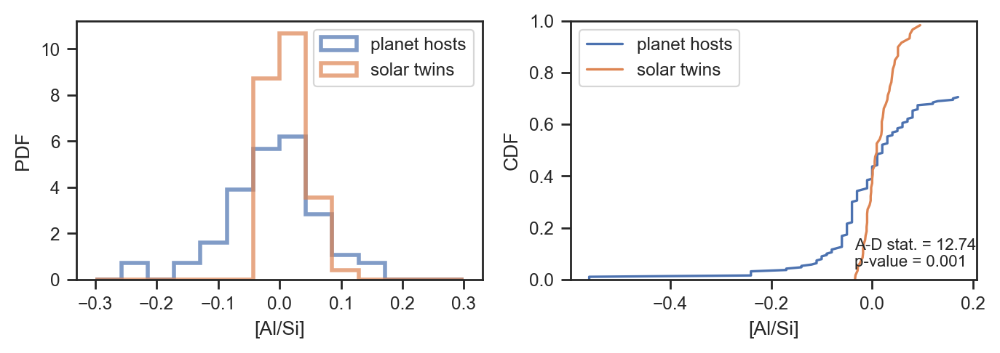

Al Ca


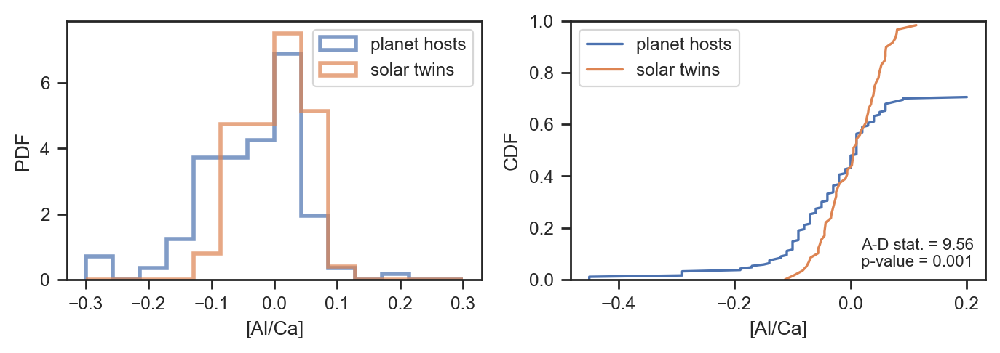

Al Ti


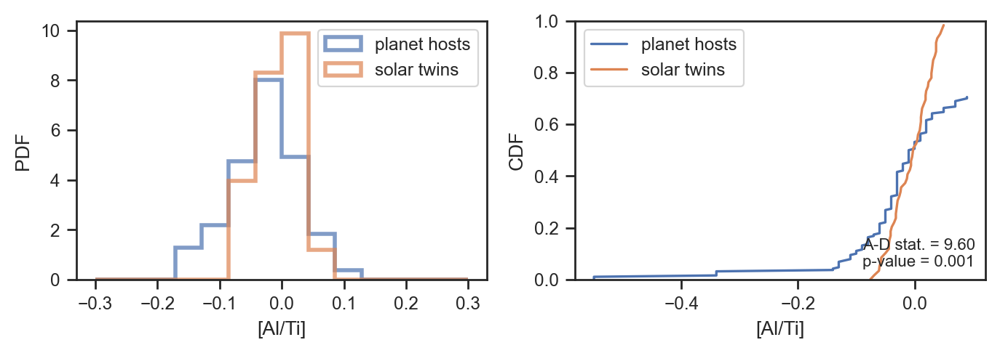

Al Cr


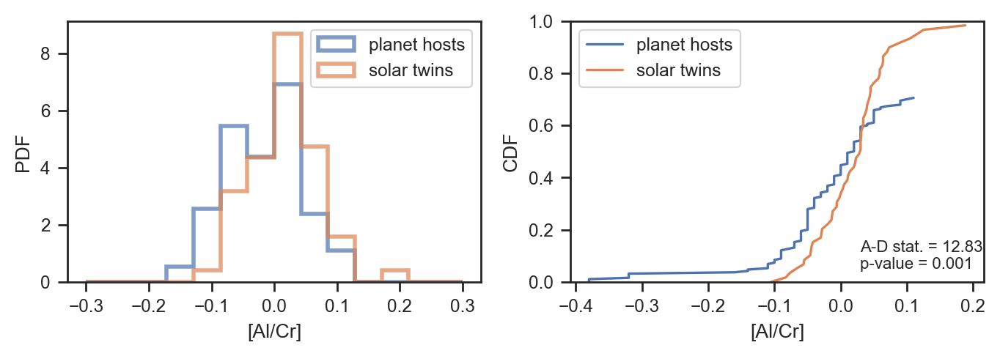

Al Ni


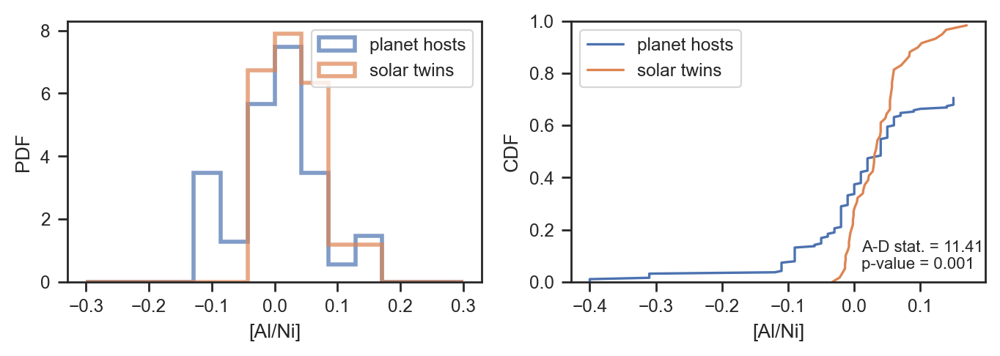

Al Y


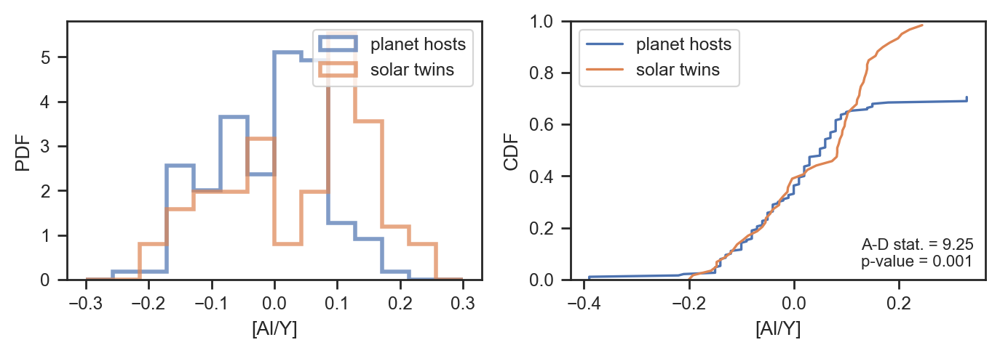

Si C


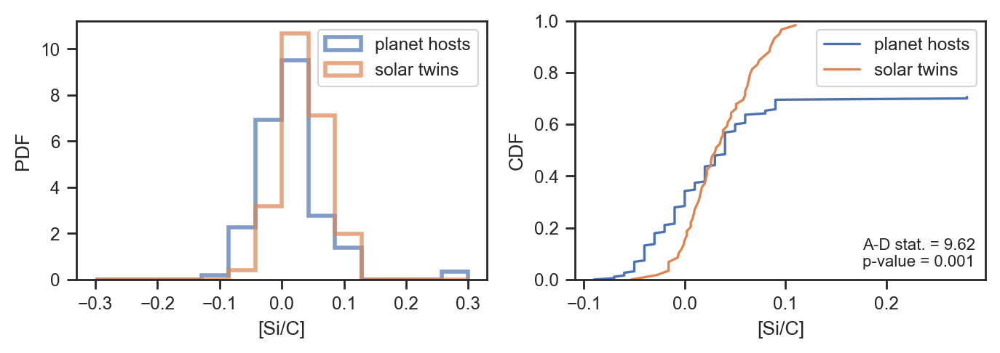

Si O


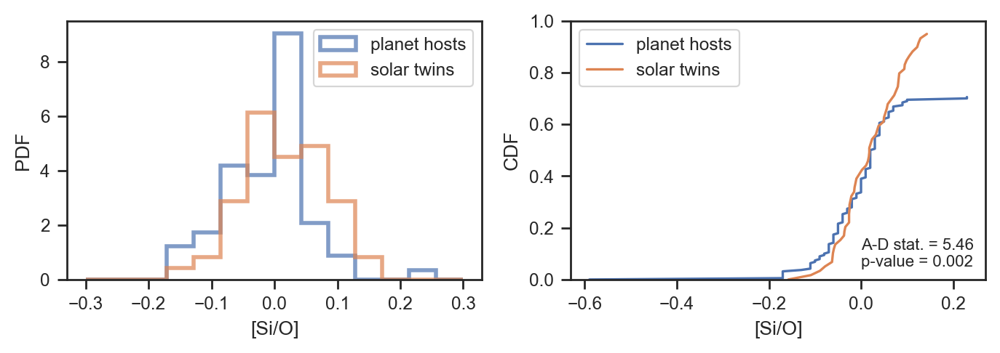

Si Na


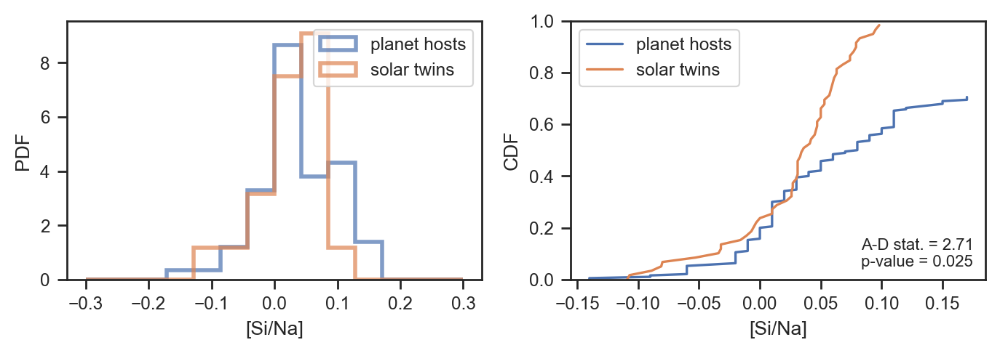

Si Mg


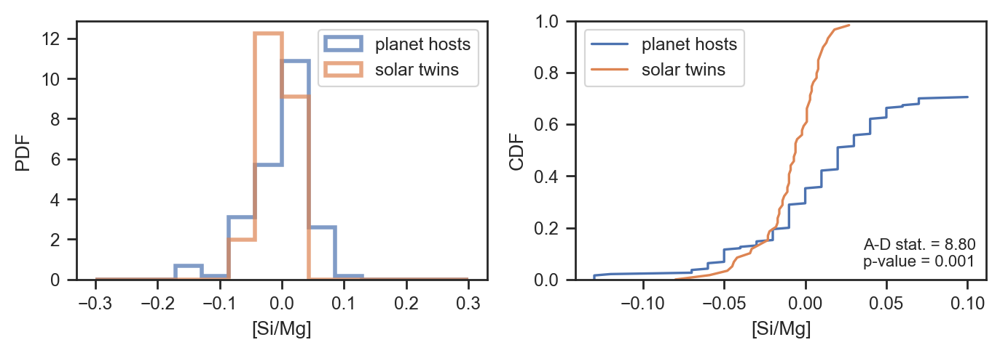

Si Al


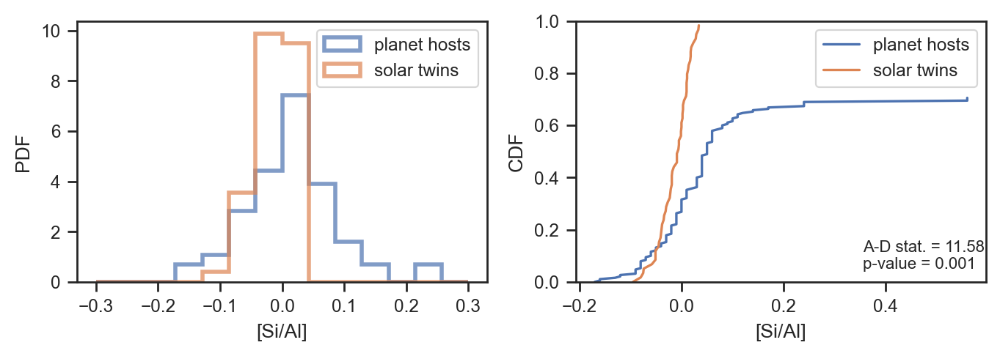

Si Ca


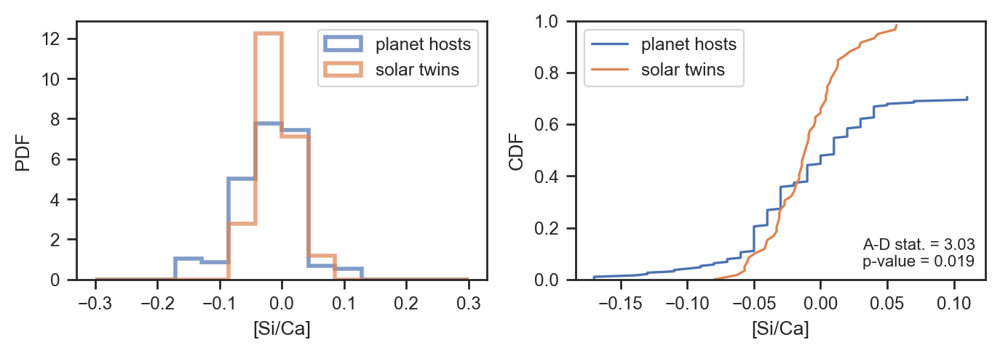

Si Ti


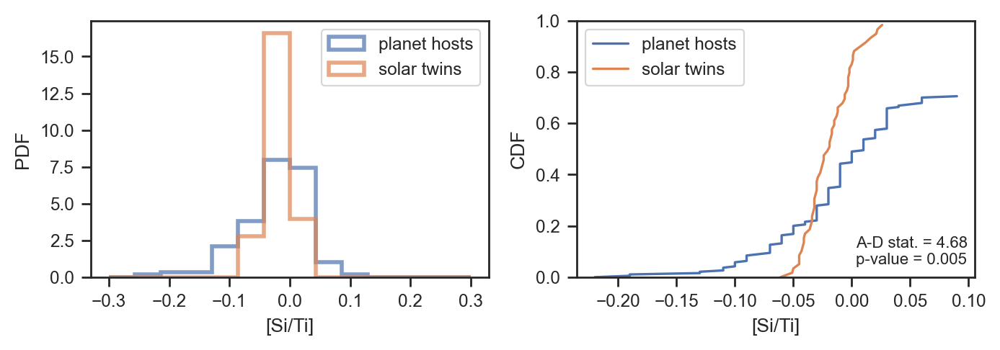

Si Cr


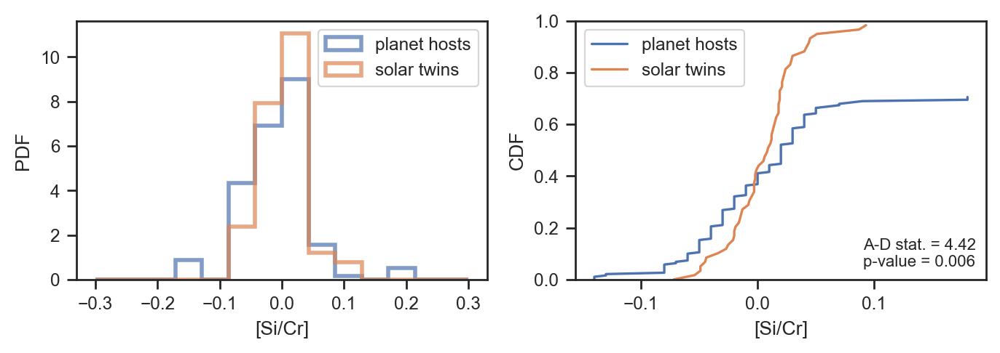

Si Ni


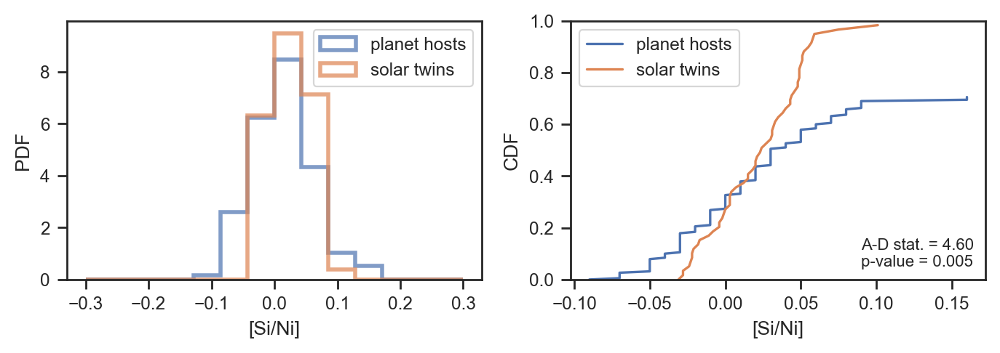

Si Y


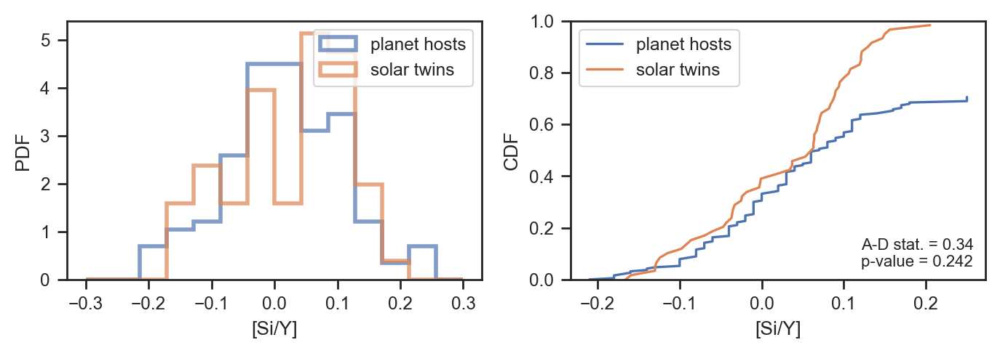

Ca C


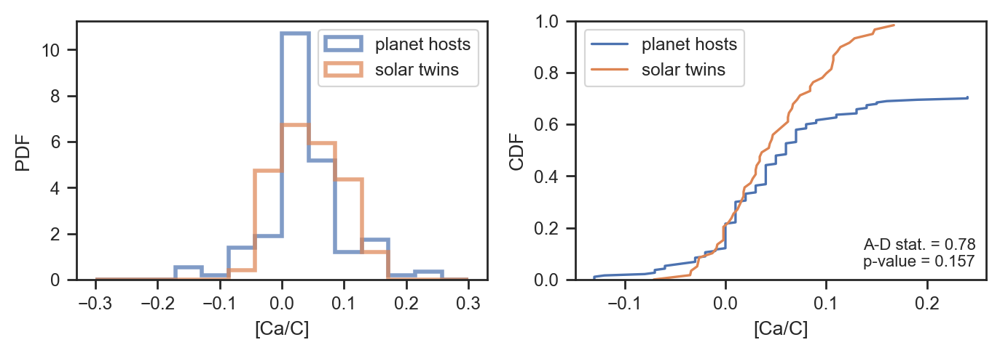

Ca O


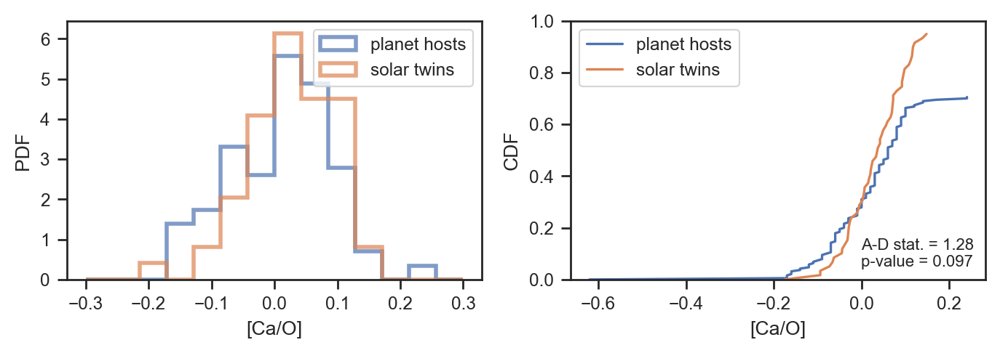

Ca Na


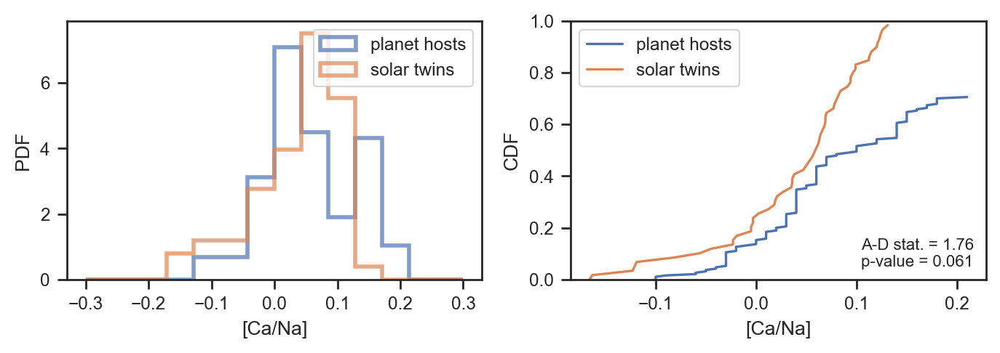

Ca Mg


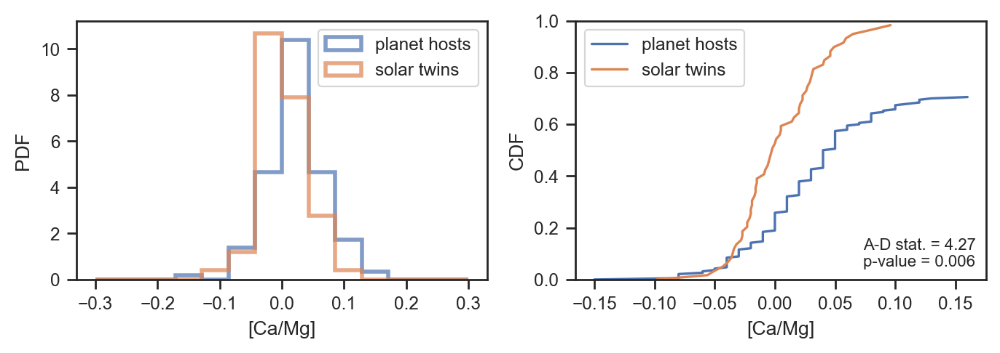

Ca Al


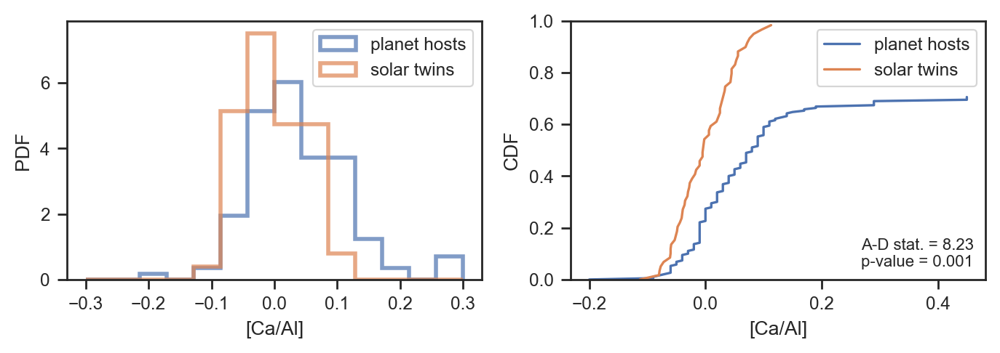

Ca Si


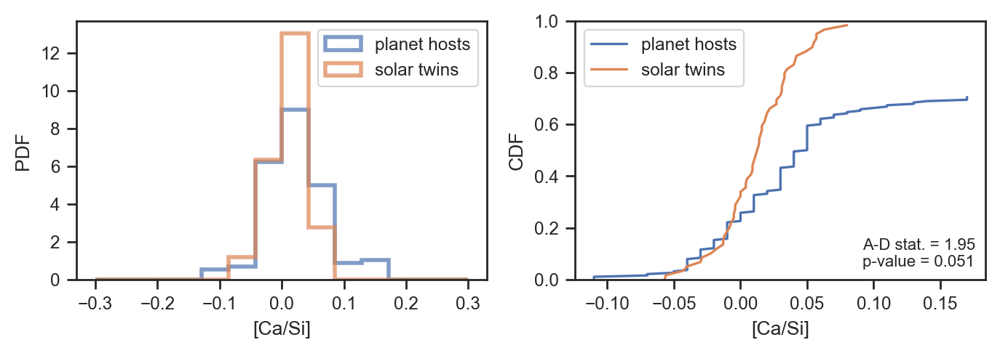

Ca Ti


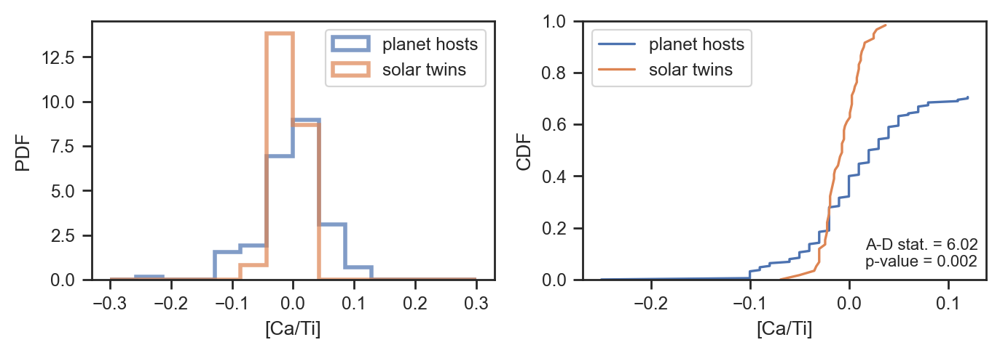

Ca Cr


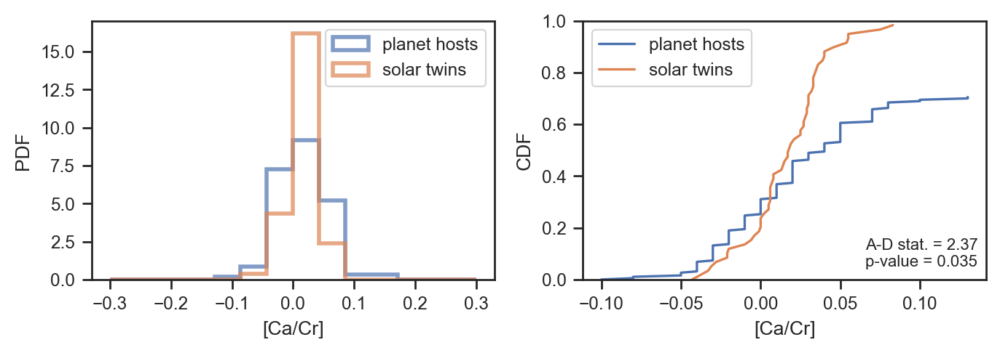

Ca Ni


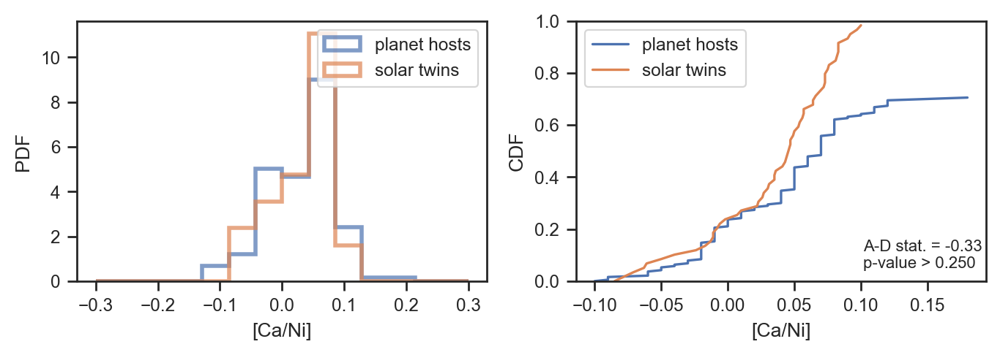

Ca Y


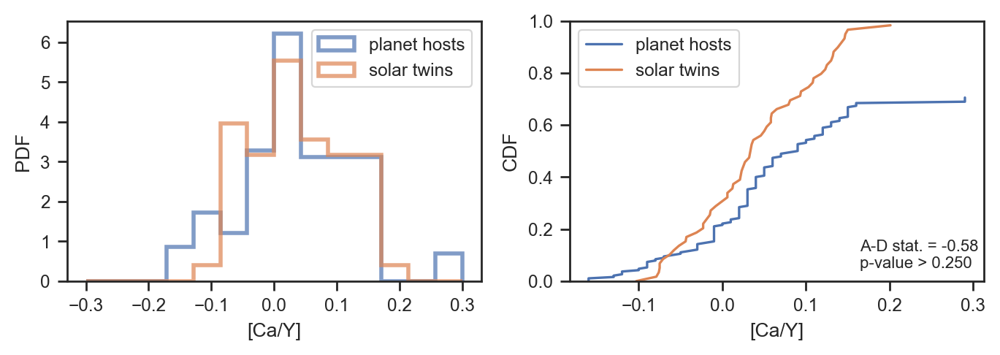

Ti C


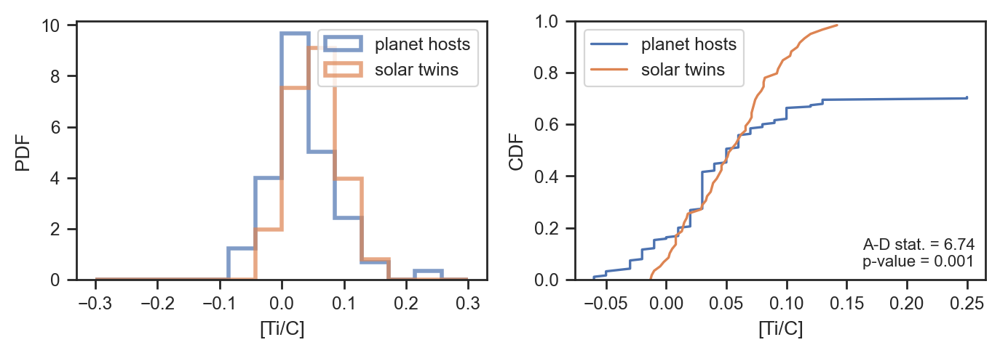

Ti O


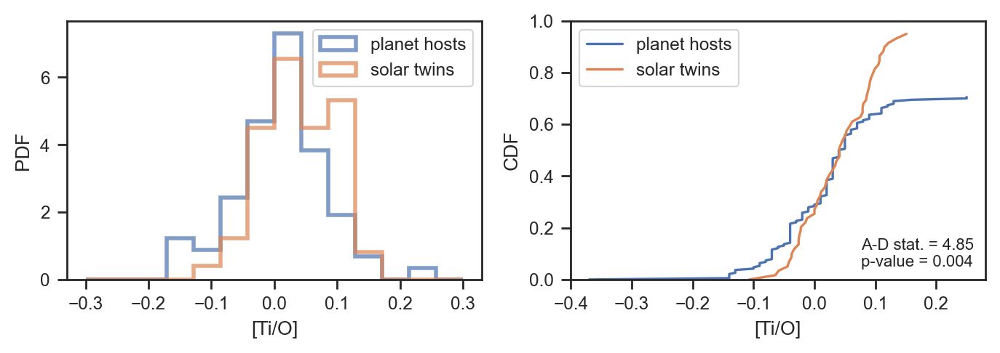

Ti Na


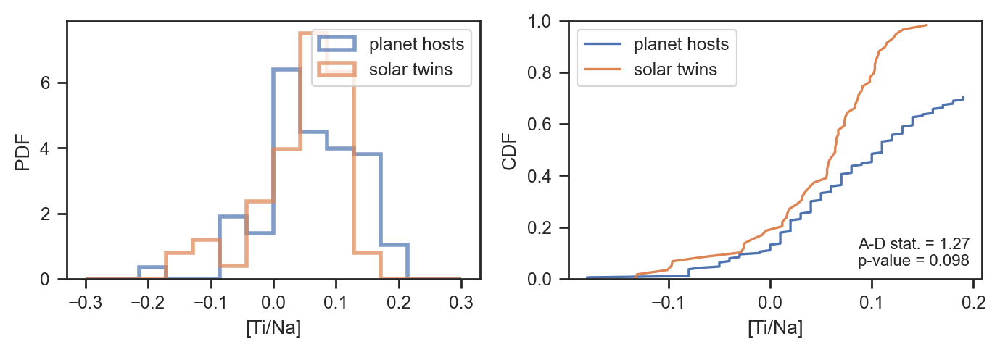

Ti Mg


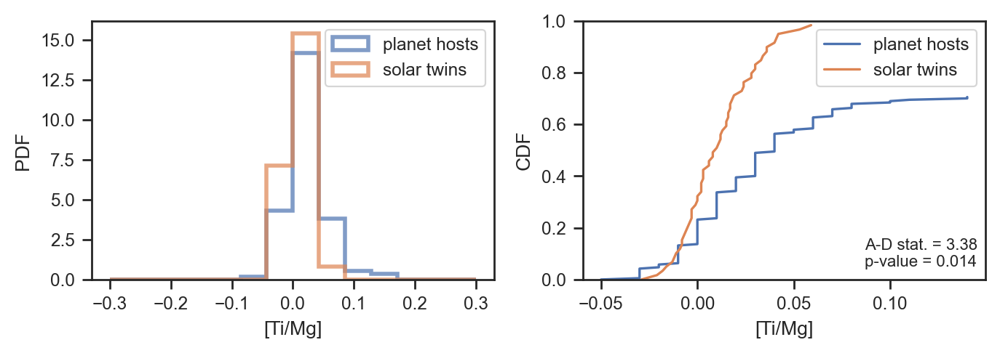

Ti Al


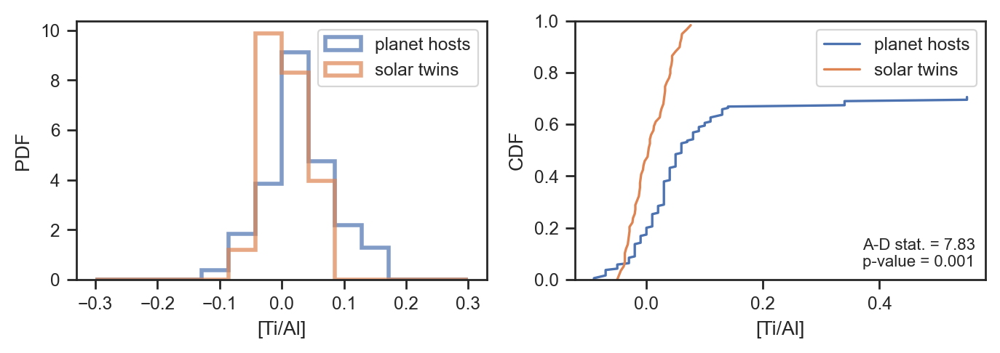

Ti Si


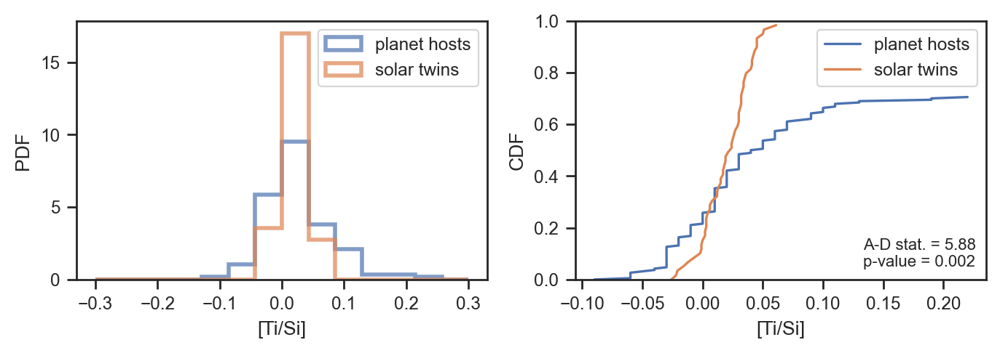

Ti Ca


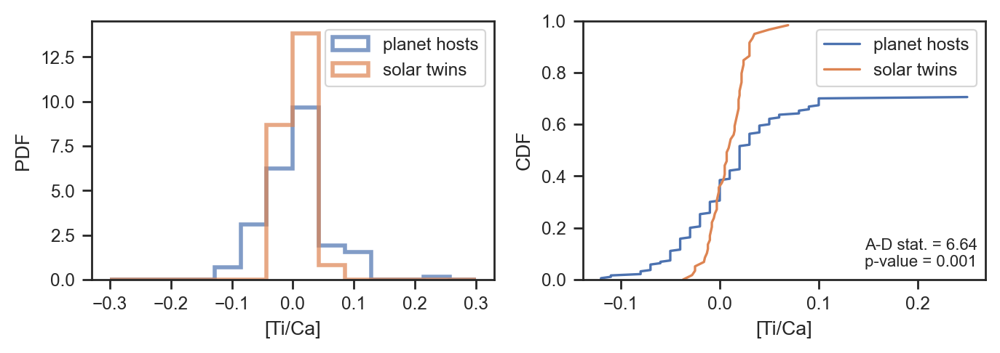

Ti Cr


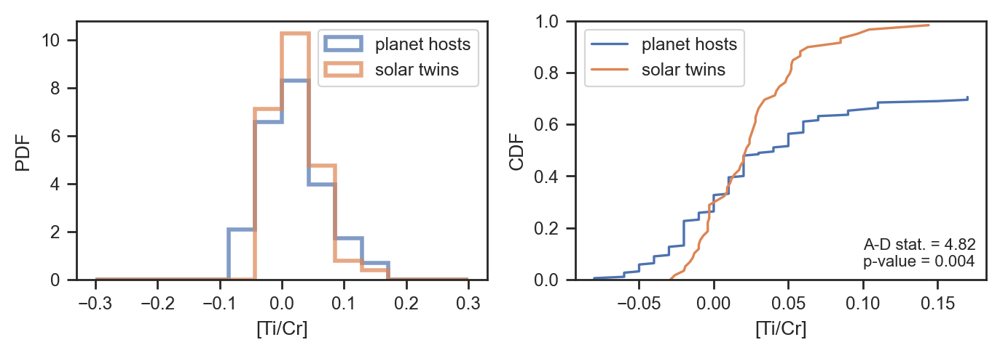

Ti Ni


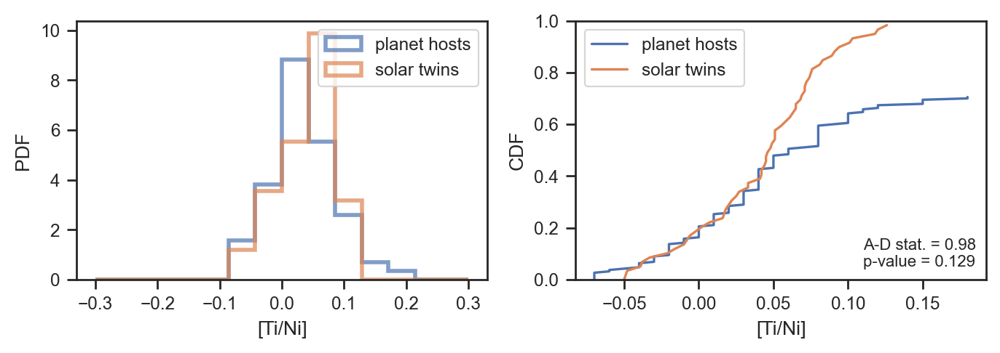

Ti Y


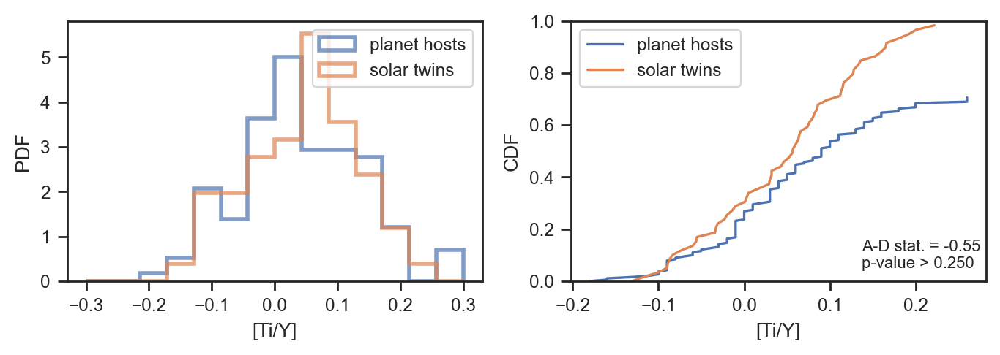

Cr C


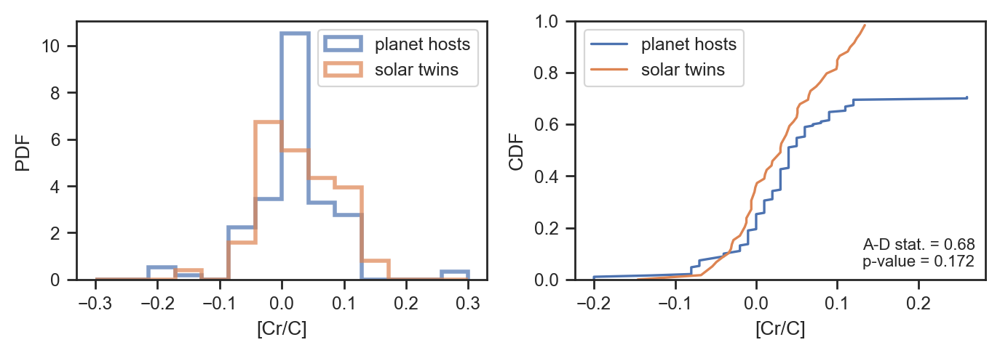

Cr O


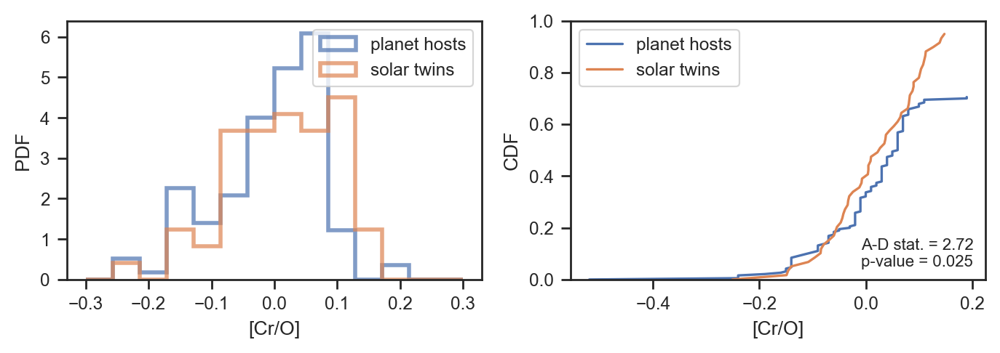

Cr Na


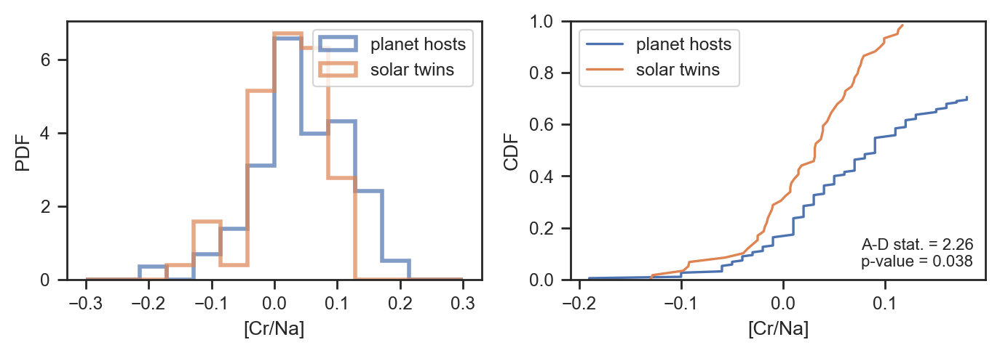

Cr Mg


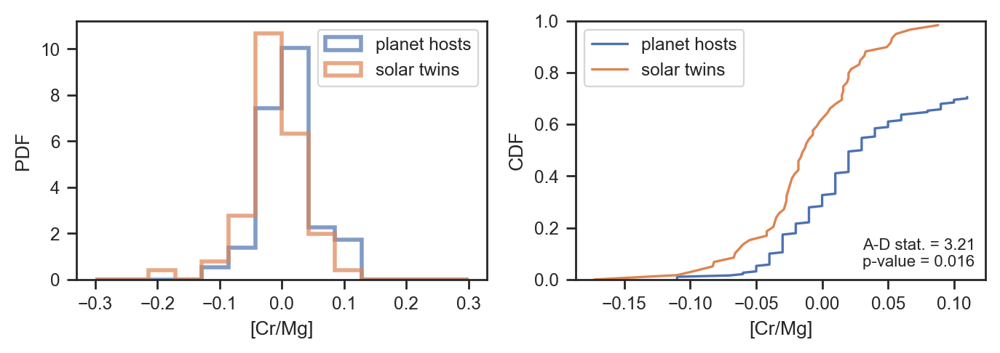

Cr Al


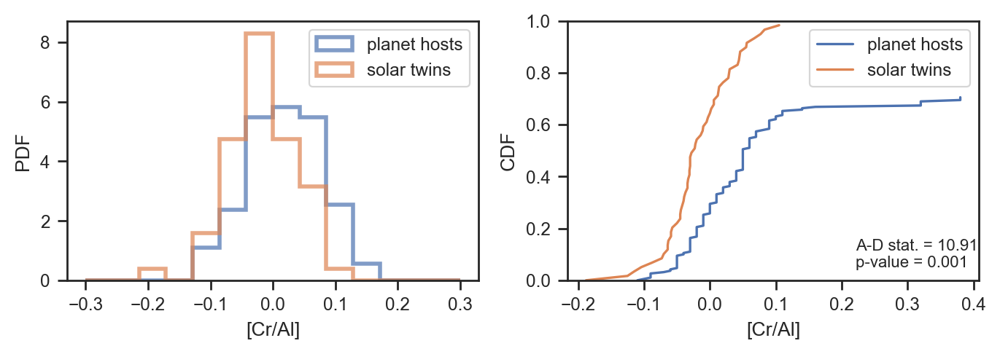

Cr Si


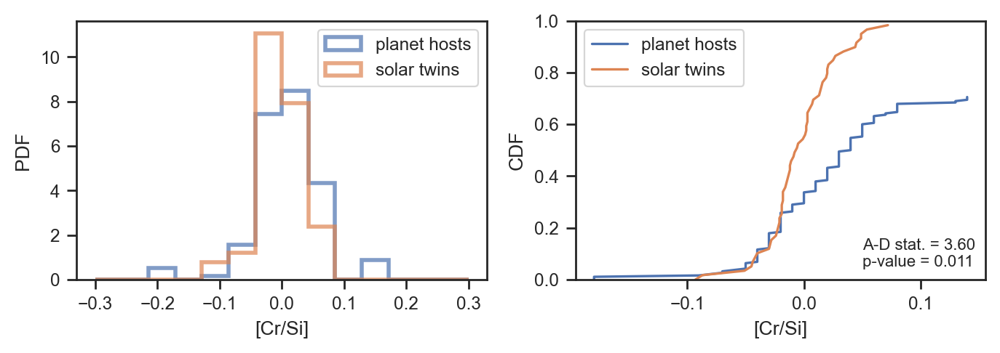

Cr Ca


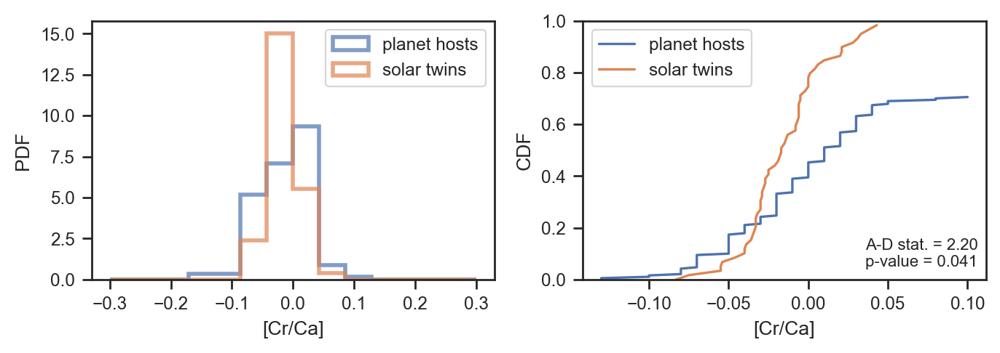

Cr Ti


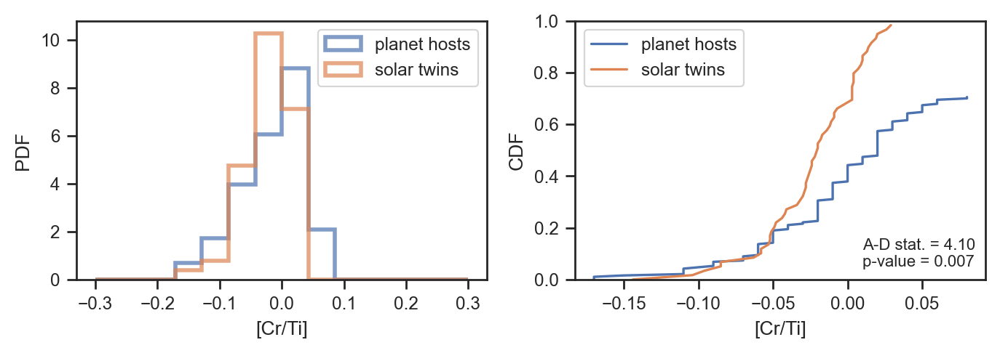

Cr Ni


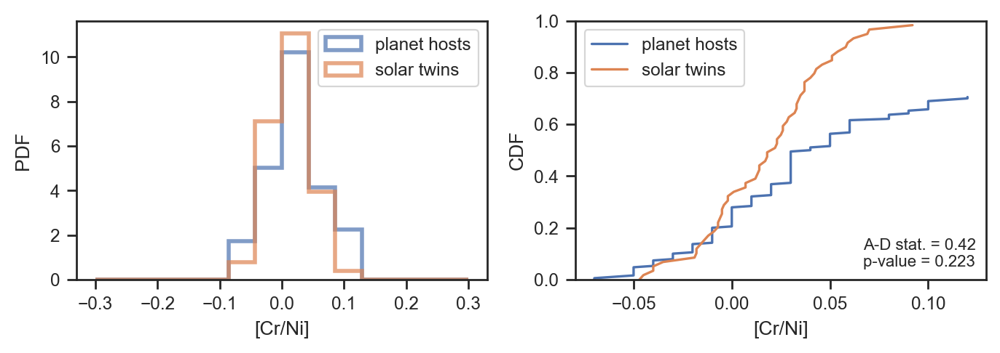

Cr Y


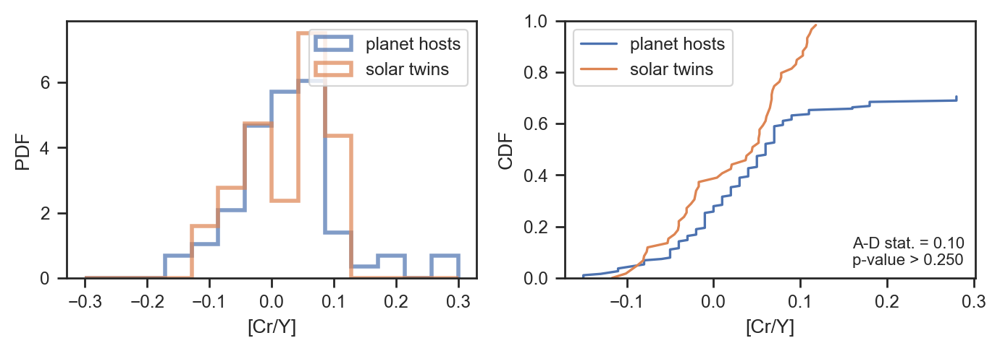

Ni C


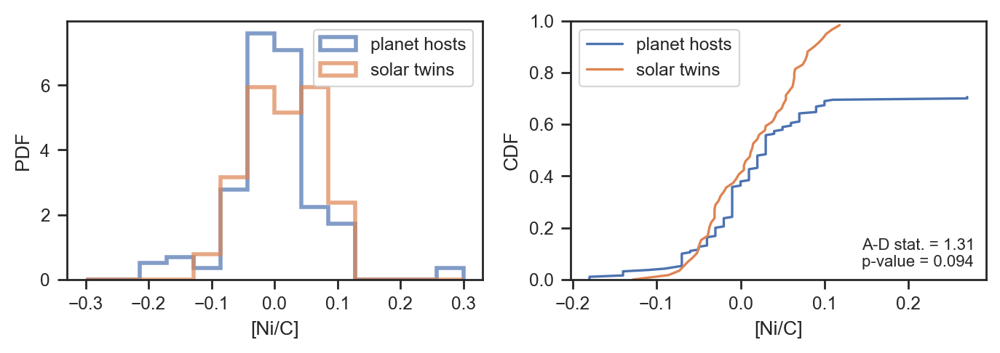

Ni O


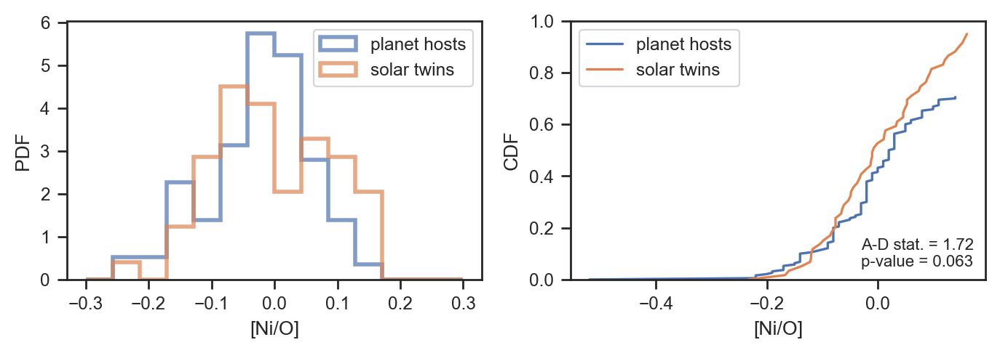

Ni Na


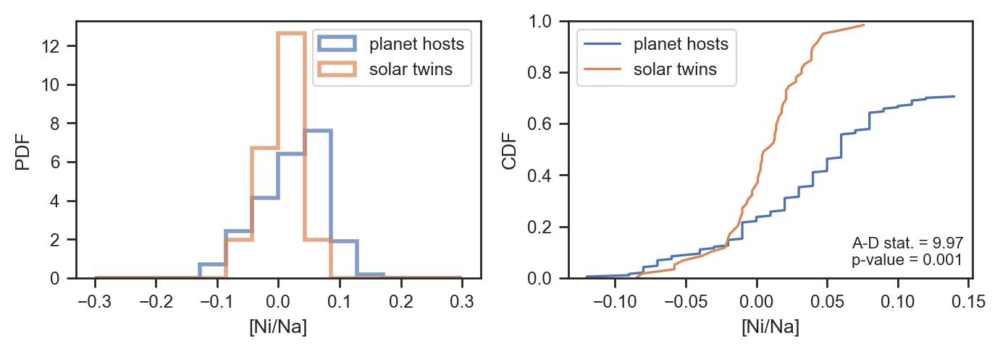

Ni Mg


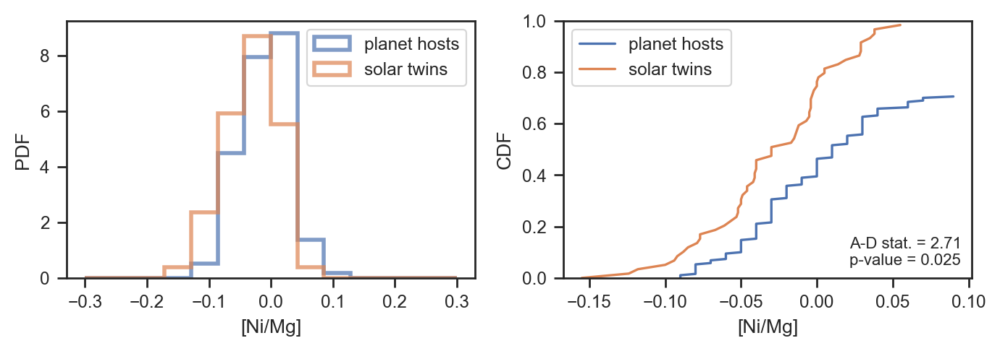

Ni Al


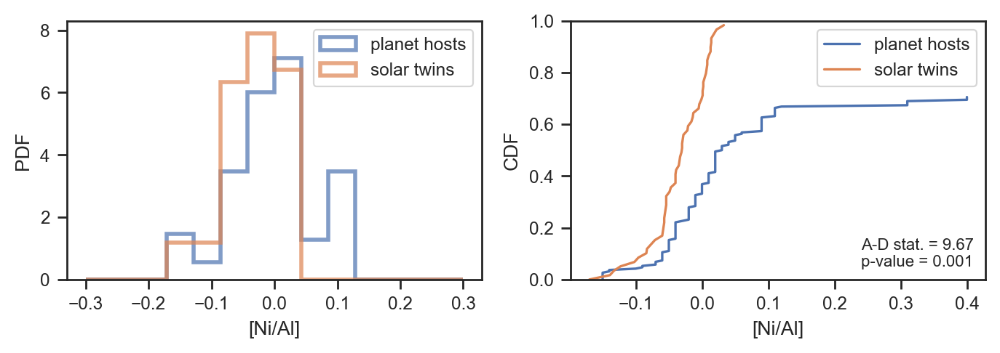

Ni Si


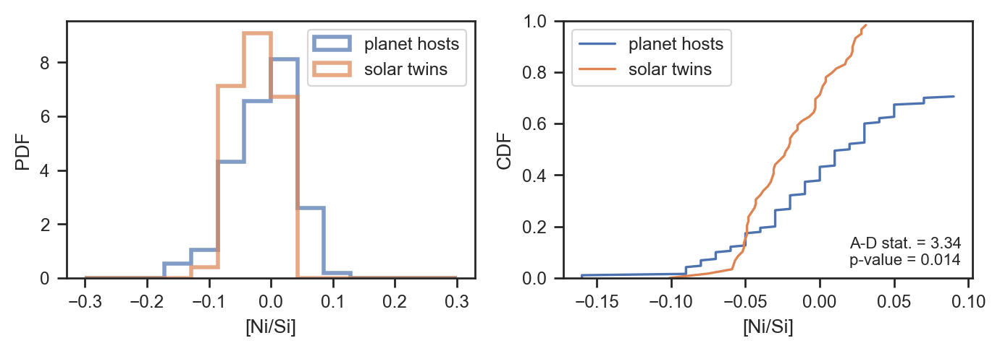

Ni Ca


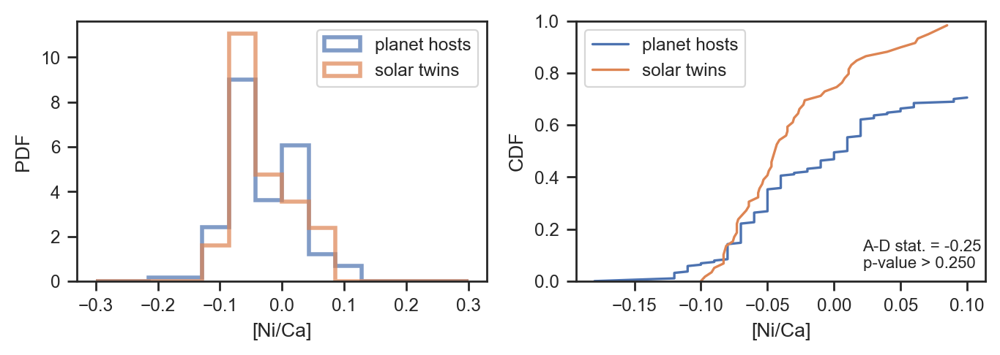

Ni Ti


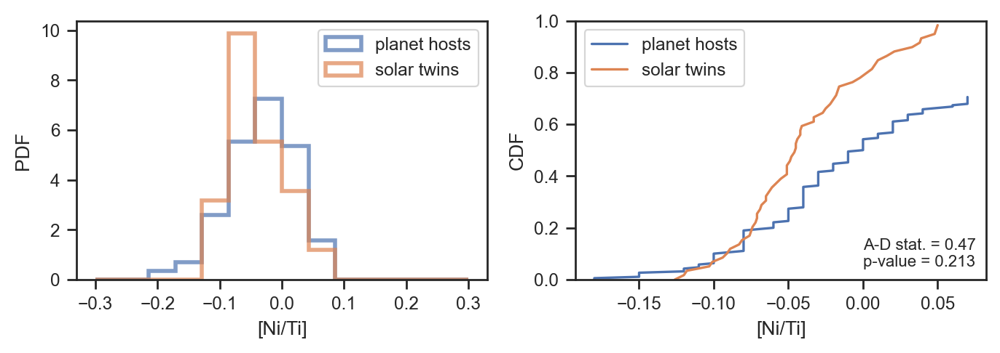

Ni Cr


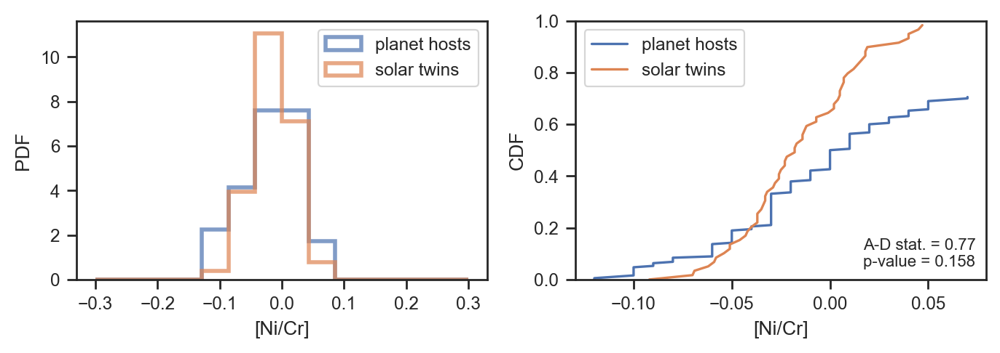

Ni Y


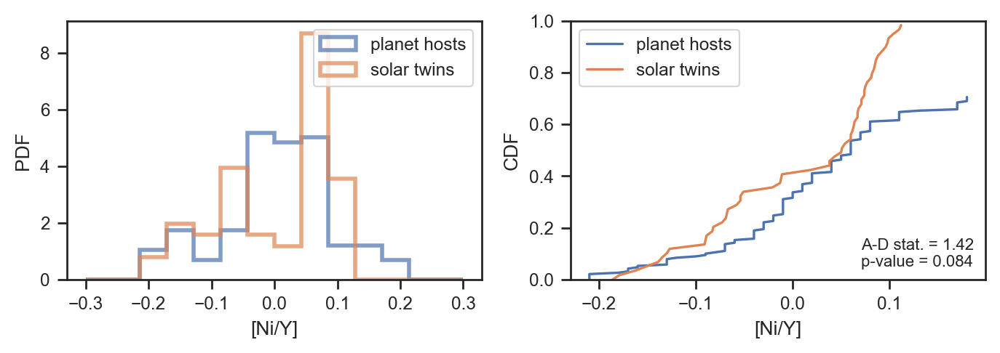

Y C


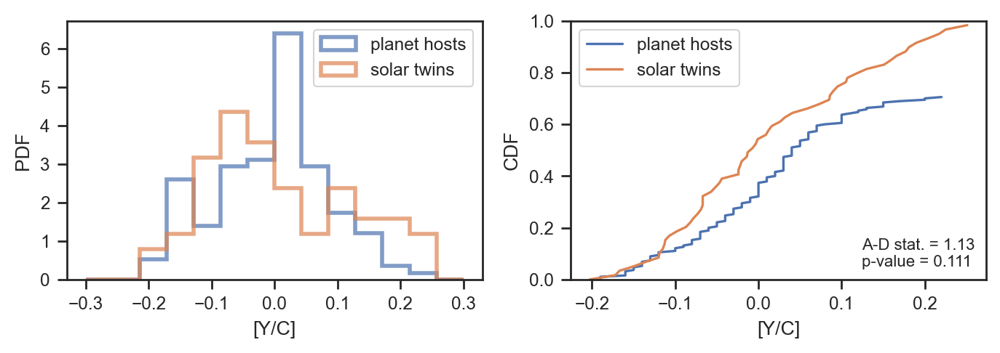

Y O


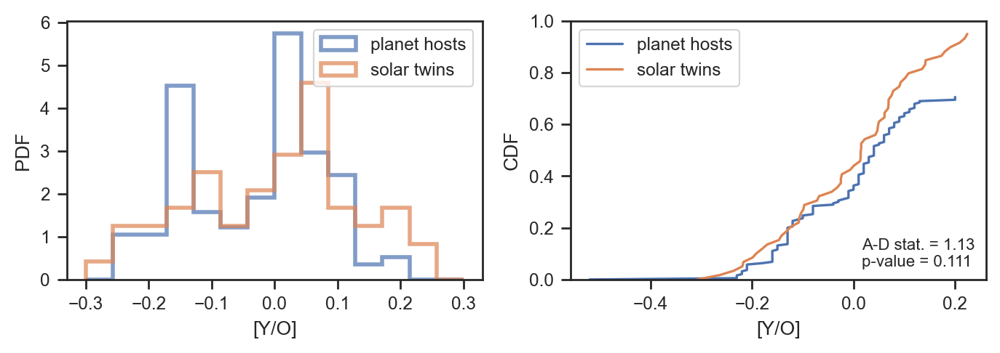

Y Na


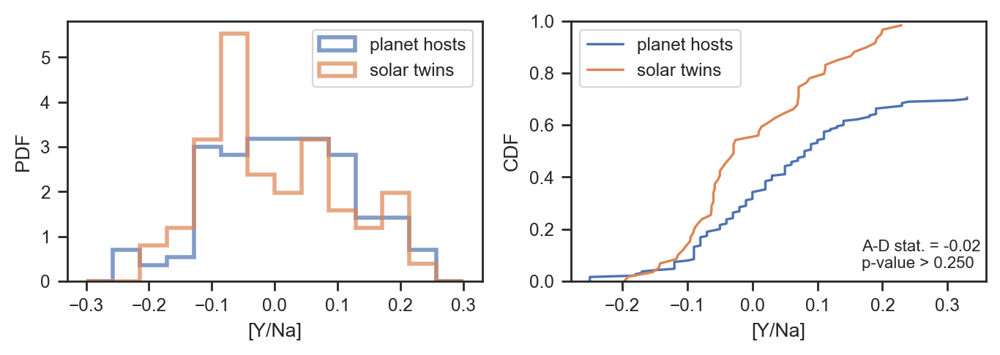

Y Mg


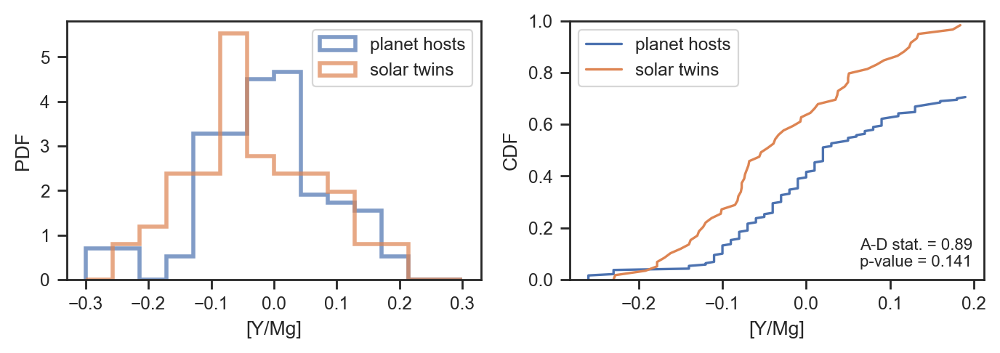

Y Al


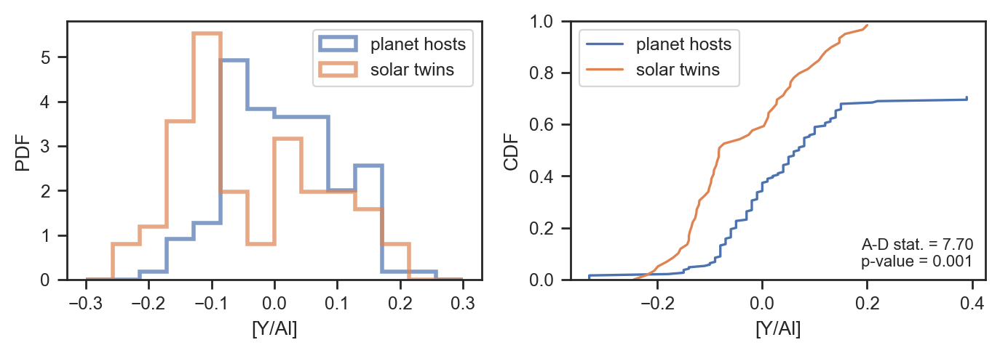

Y Si


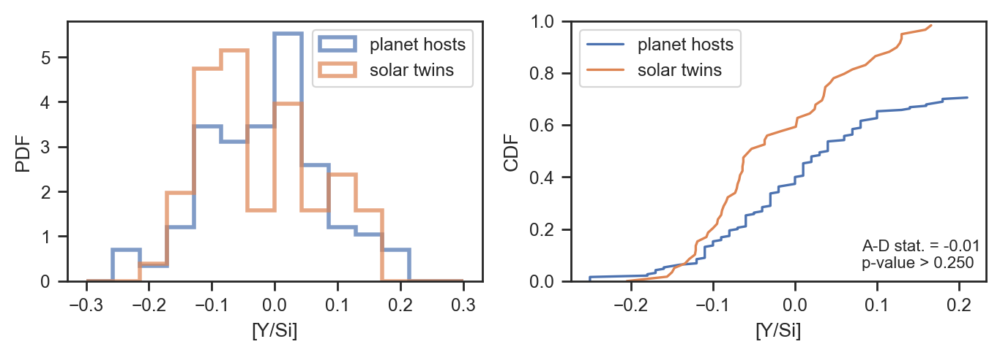

Y Ca


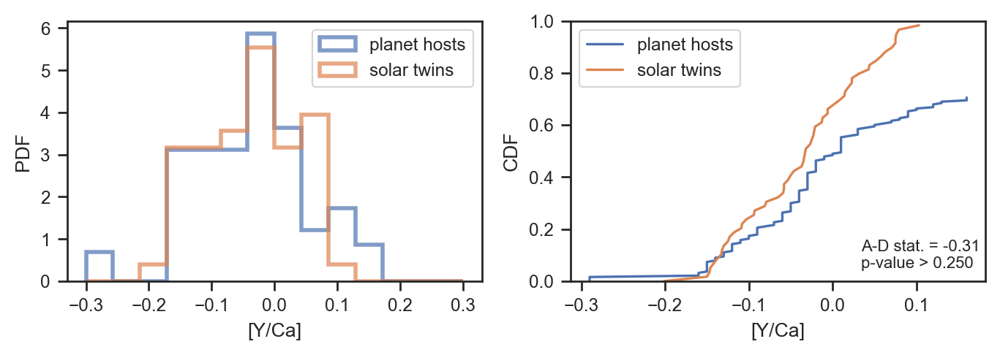

Y Ti


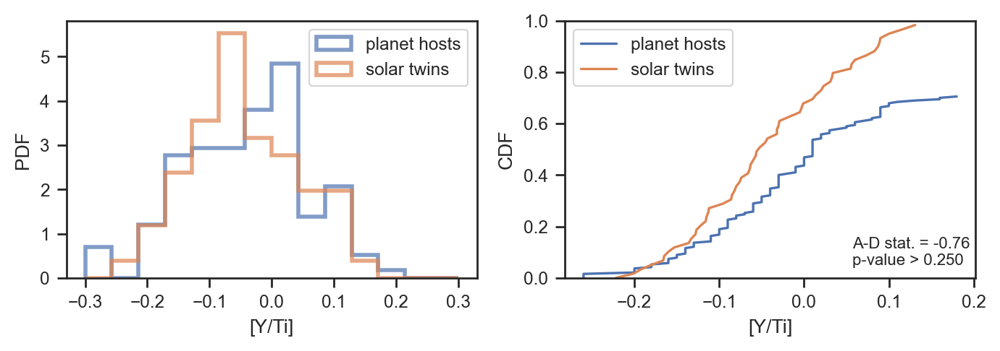

Y Cr


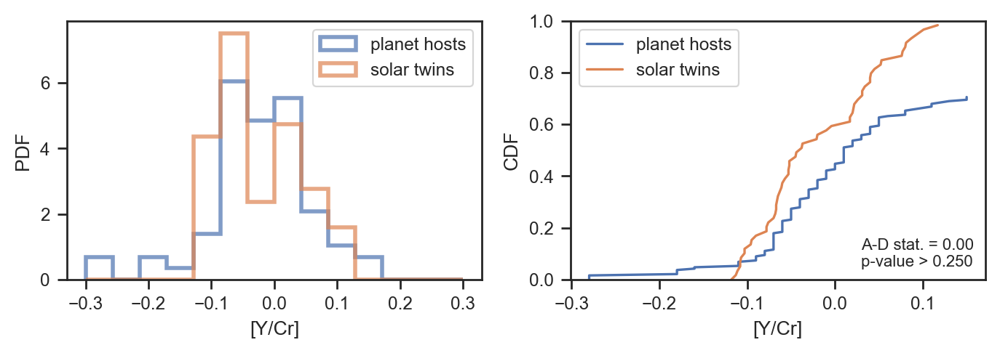

Y Ni


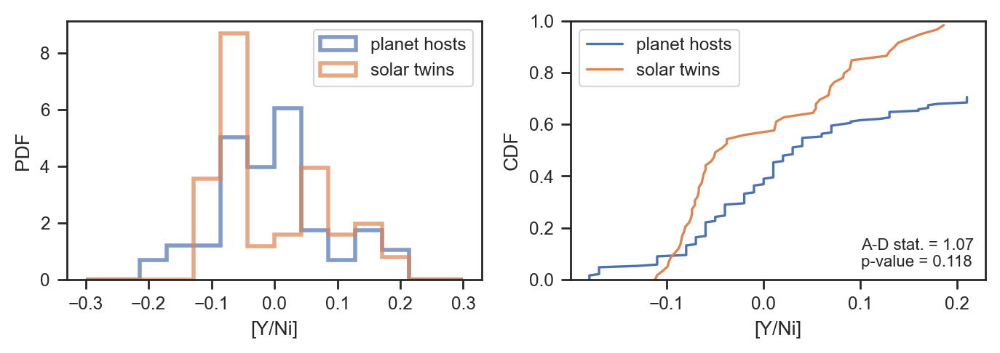

In [130]:
elems = ['C','O','Na','Mg','Al','Si','Ca','Ti','Cr','Ni','Y']
el_class = ['V','','V','R','R',]
hist_kws = {"density":True, "histtype":"step", "lw":2, "cumulative":True}

from scipy.stats import anderson_ksamp

for i in range(len(elems)):
    el1 = elems[i]
    for j in range(len(elems)):
        el2 = elems[j]
        
        _x1 = df["bf18_["+el1+"/Fe]"][n20_sun_like] - df["bf18_["+el2+"/Fe]"][n20_sun_like]
        _x2 = nis["["+el1+"/Fe]"][n20_cut] -  nis["["+el2+"/Fe]"][n20_cut]
        
        if i!=j:
            print(el1,el2)
            plot_arbitrary_distributions(_x1, _x2, xlabel='['+el1+'/'+el2+']', 
                                         labels=['planet hosts', 'solar twins'])

In [121]:
elems = ['C','O','Na','Mg','Al','Si','Ca','Ti','Cr','Ni','Y']
el_class = ['V','','V','R','R',]
hist_kws = {"density":True, "histtype":"step", "lw":2, "cumulative":True}

from scipy.stats import anderson_ksamp

fig, ax = plt.subplots(nrows=11, ncols=11, figsize=(24,24), dpi=300)

for i in range(len(elems)):
    el1 = elems[i]
    for j in range(len(elems)):
        el2 = elems[j]
        
        _x1 = df["bf18_["+el1+"/Fe]"][n20_sun_like]
        _y1 = df["bf18_["+el2+"/Fe]"][n20_sun_like]
        
        _x2 = nis["["+el1+"/Fe]"]; #_x2 = _x2[np.isfinite(_x2)]
        _y2 = nis["["+el2+"/Fe]"]; #_y2 = _y2[np.isfinite(_y2)]
        
        if i>j:
            ax[i][j].scatter(_x1, _y1, alpha=1, color='lightgrey', rasterized=True)
            ax[i][j].scatter(_x2, _y2, alpha=1, color='k', rasterized=True)
            ax[i][j].set_xlabel(el1+"/Fe", size=18)
            ax[i][j].set_ylabel(el2+"/Fe", size=18)
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])
        else:
            ax[i][j].axis('off')
        
plt.tight_layout()
#plt.savefig('/Users/tdavid/Desktop/elem-corner.png')
plt.savefig('./figures/elem-corner.pdf')

Anderson_ksampResult(statistic=14.533287509393885, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)


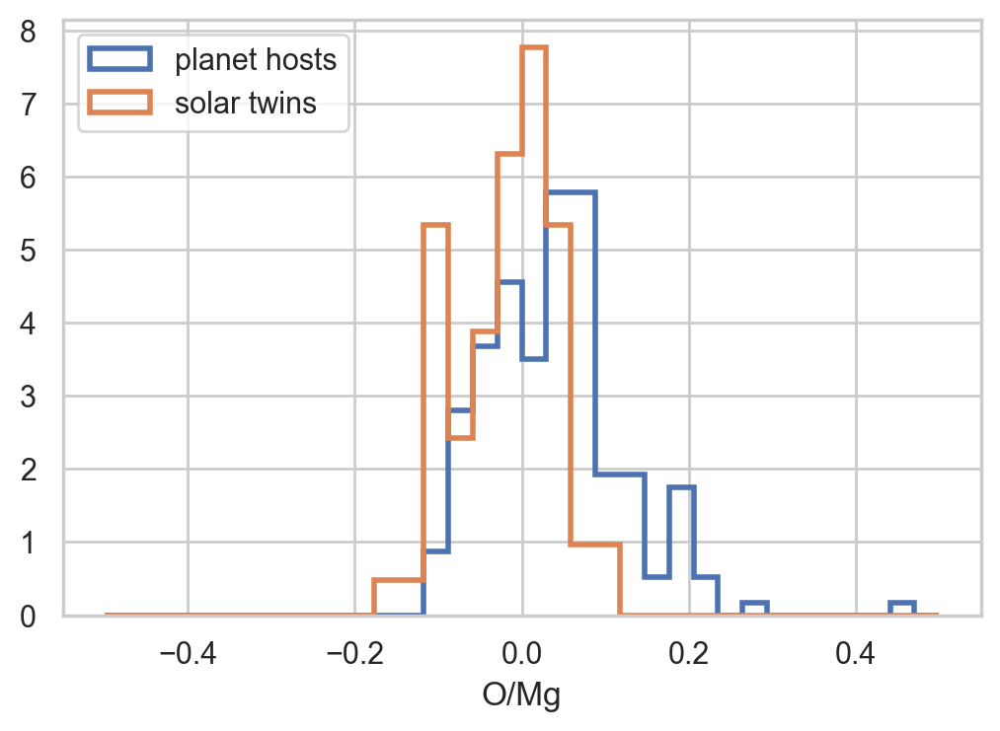

Anderson_ksampResult(statistic=29.40198834975108, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)


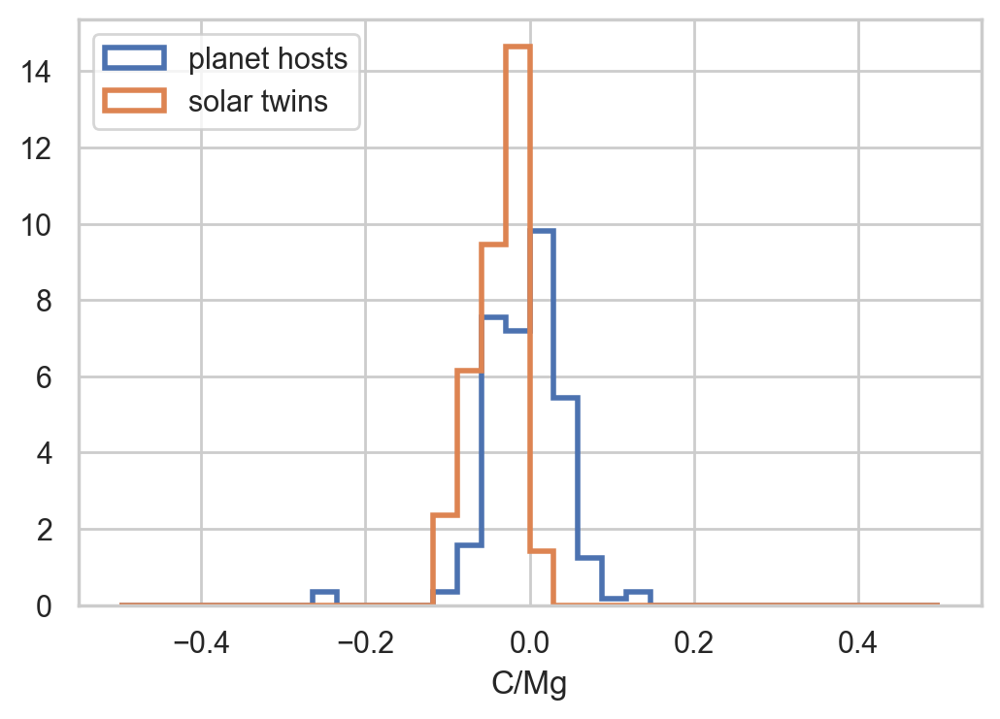

In [520]:
hist_kws = {"density":True, "histtype":"step", "lw":2, "cumulative":False, "bins": np.linspace(-0.5,0.5,35)}

_x = df['bf18_[O/Fe]'][n20_sun_like]-df['bf18_[Mg/Fe]'][n20_sun_like]
_y = nis['[O/Fe]']-nis['[Mg/Fe]']
plt.hist(_x, **hist_kws, label='planet hosts')
plt.hist(_y, **hist_kws, label='solar twins')
plt.legend(loc='upper left')
plt.xlabel('O/Mg')

ad_result = anderson_ksamp([_x, _y], midrank=True)
print(ad_result)
plt.show()


hist_kws = {"density":True, "histtype":"step", "lw":2, "cumulative":False, "bins": np.linspace(-0.5,0.5,35)}

_x = df['bf18_[C/Fe]'][n20_sun_like]-df['bf18_[Mg/Fe]'][n20_sun_like]
_y = nis['[C/Fe]']-nis['[Mg/Fe]']
plt.hist(_x, **hist_kws, label='planet hosts')
plt.hist(_y, **hist_kws, label='solar twins')
plt.legend(loc='upper left')
plt.xlabel('C/Mg')

ad_result = anderson_ksamp([_x, _y], midrank=True)
print(ad_result)
plt.show()

 
-0.02466 x + 0.1288
 
-0.01648 x + 0.07841
 
-0.03366 x + 0.1972
 
-0.02553 x + 0.1485
 
-0.01803 x + 0.05545
 
-0.0109 x + 0.02778


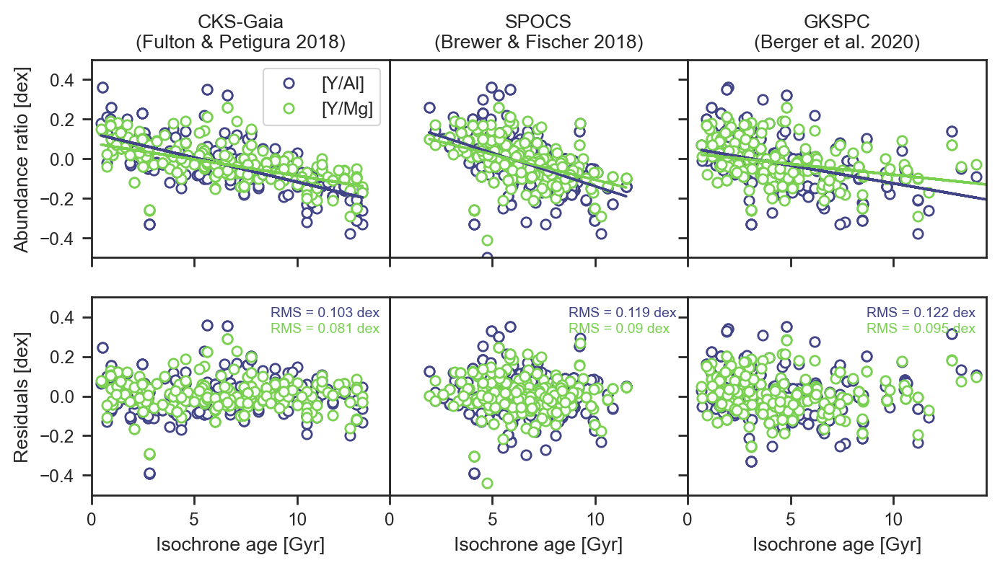

In [128]:
sns.set_palette(sns.color_palette("viridis",4))

axd = plt.figure(constrained_layout=True,figsize=(8,4)).subplot_mosaic(
    """
    ABC
    DEF
    """
)
#identify_axes(axd)

# for k, ax in axd.items():
#     print(k)
#     ax.scatter(np.random.normal(0,10,100),np.random.normal(0,10,100))
    
#axd['A']

sc_kwargs = {'mfc':'white', 'mew':1, 'marker':'o', 'ls':''}

age_cols = ["cks_age", "bf18_Age", "b20_iso_age"]

#fig,ax = plt.subplots(nrows=1,ncols=3,figsize=(9,3), sharey=True)

y1 = df["yal_ratio"][n20_sun_like]; y1err = df["yal_ratio_err"][n20_sun_like]
y2 = df["ymg_ratio"][n20_sun_like]; y2err = df["ymg_ratio_err"][n20_sun_like]

top = ['A','B','C']
bot = ['D','E','F']

for i, col in enumerate(age_cols):
    
    x = df[col][n20_sun_like]
    arg = (np.isfinite(x))&(np.isfinite(y1))&(np.isfinite(y2))
    
    z1 = np.polyfit(x[arg],y1[arg],1)
    p1 = np.poly1d(z1)
    z2 = np.polyfit(x[arg],y2[arg],1)
    p2 = np.poly1d(z2)    
        
    #Clip outliers
    out1 = abs(y1-p1(x))/y1err > 5
    out2 = abs(y2-p2(x))/y2err > 5

    arg = (np.isfinite(x))&(np.isfinite(y1))&(np.isfinite(y2))&(~out1)&(~out2)
    z1 = np.polyfit(x[arg],y1[arg],1)
    p1 = np.poly1d(z1)
    z2 = np.polyfit(x[arg],y2[arg],1)
    p2 = np.poly1d(z2)    
    print(p1)
    print(p2)    

    axd[top[i]].plot(x, y1, label='[Y/Al]', **sc_kwargs, color="C0")
    axd[top[i]].plot(x, y2, label='[Y/Mg]', **sc_kwargs, color="C3")
    
    axd[top[i]].plot(x, p1(x), color="C0")
    axd[top[i]].plot(x, p2(x), color="C3")
    
    
    axd[bot[i]].plot(x, y1-p1(x), **sc_kwargs, color="C0")
    axd[bot[i]].plot(x, y2-p2(x), **sc_kwargs, color="C3")
    
    axd[bot[i]].text(0.6,0.9, 'RMS = '+str(np.round(np.std(y1-p1(x)),3))+' dex', transform=axd[bot[i]].transAxes, color="C0", size=7)
    axd[bot[i]].text(0.6,0.82, 'RMS = '+str(np.round(np.std(y2-p2(x)),3))+' dex', transform=axd[bot[i]].transAxes, color="C3", size=7)
    
    axd[top[i]].set_xlim(0,14.5)
    axd[bot[i]].set_xlim(0,14.5)
    axd[top[i]].set_ylim(-0.5,0.5)
    axd[bot[i]].set_ylim(-0.5,0.5)
    
    axd[bot[i]].set_xlabel('Isochrone age [Gyr]')
    
    axd[top[i]].set_xticklabels([])
    
    if i==0:
        axd[top[i]].legend(prop={'size':9})

    if i>0:
        axd[top[i]].set_yticklabels([])
        axd[bot[i]].set_yticklabels([])
        
    #axd[top[i]].set_xticklabels([])
    #if i!=0:
    #    axd[top[i]].set_yticklabels([])

    
axd['A'].set_title('CKS-Gaia\n(Fulton & Petigura 2018)')
axd['B'].set_title('SPOCS\n(Brewer & Fischer 2018)')
axd['C'].set_title('GKSPC\n(Berger et al. 2020)')
axd['A'].set_ylabel('Abundance ratio [dex]')    
axd['D'].set_ylabel('Residuals [dex]')    
    
plt.subplots_adjust(wspace=0,hspace=0.2)
#plt.savefig('./figures/abundance-age.pdf')
plt.show()

### Comparing planet radius distributions

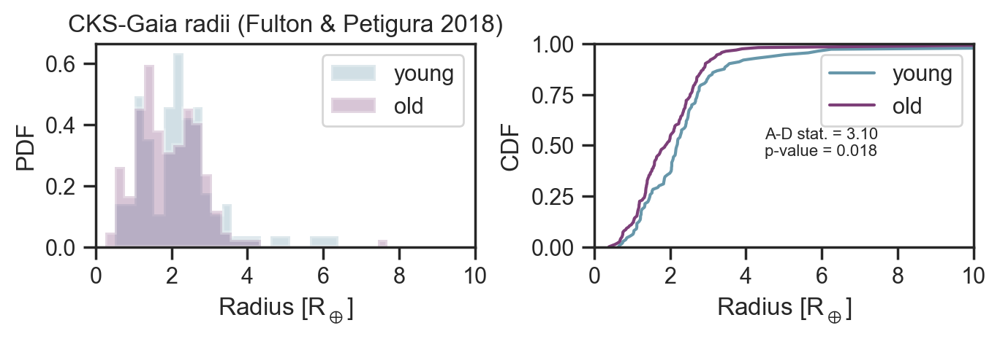

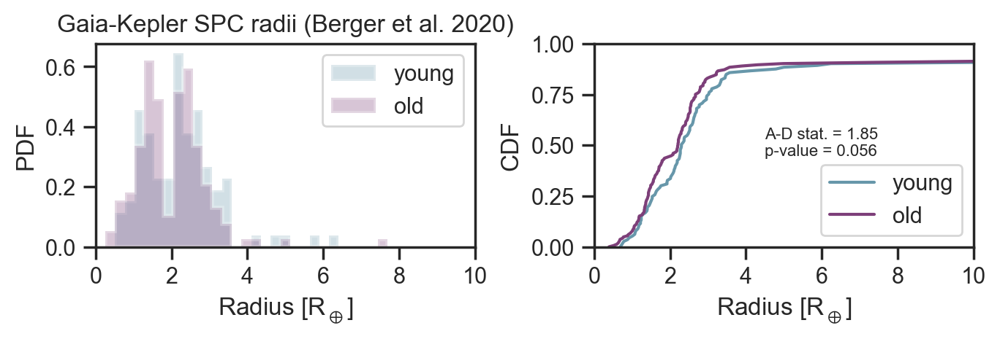

In [288]:
plot_distributions(df['cks_Rp'][gyro_yng], 
                   df['cks_Rp'][gyro_old], 
                   labels=['young','old'], title='CKS-Gaia radii (Fulton & Petigura 2018)')

plot_distributions(df['b20b_Radius'][gyro_yng], 
                   df['b20b_Radius'][gyro_old], 
                   labels=['young','old'], title='Gaia-Kepler SPC radii (Berger et al. 2020)')

#plot_distributions(df['single_transit_snr'][gyro_yng], 
#                   df['single_transit_snr'][gyro_old], labels=['young','old'], title='CKS')

#plot_distributions(df['b20b_Radius'][m_yng], df['b20b_Radius'][m_old], title='GKSPC')

178
232


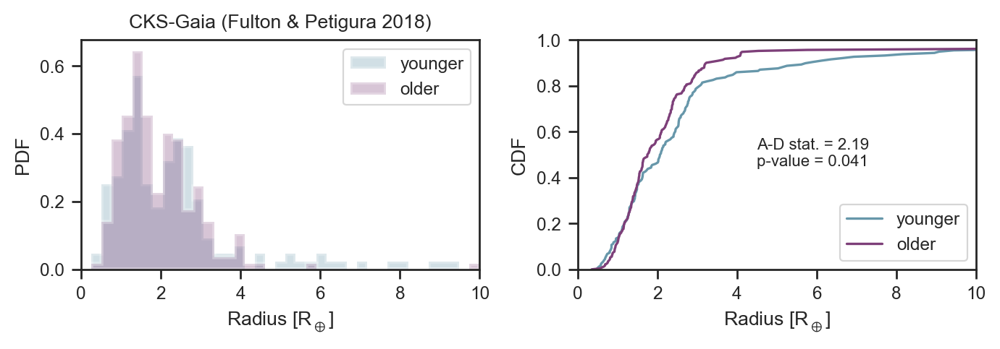

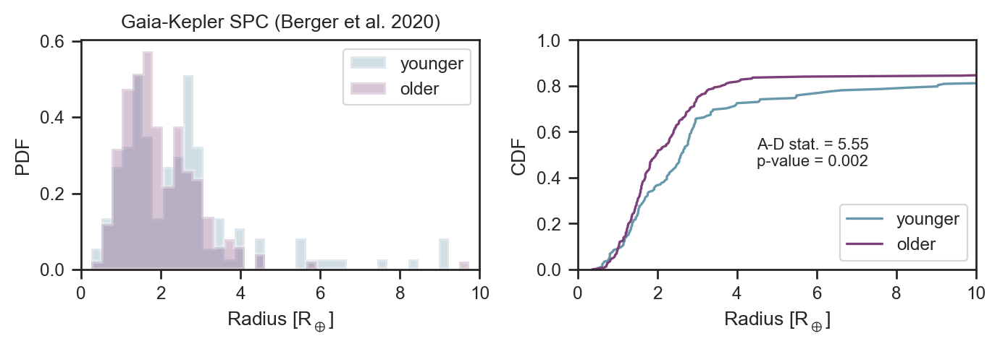

206
204


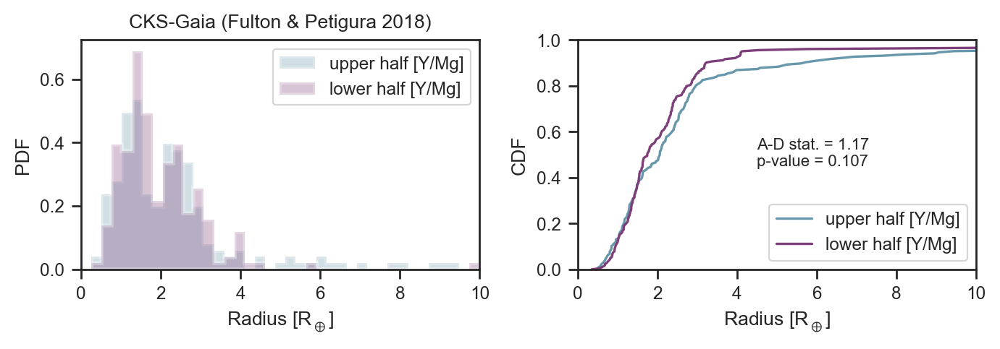

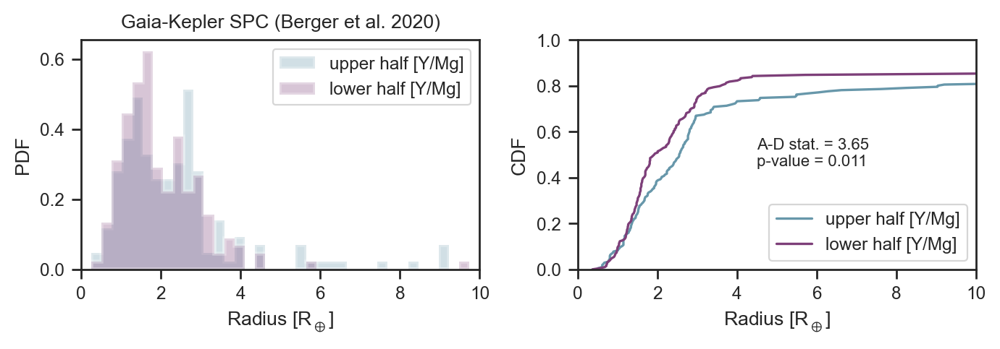

213
197


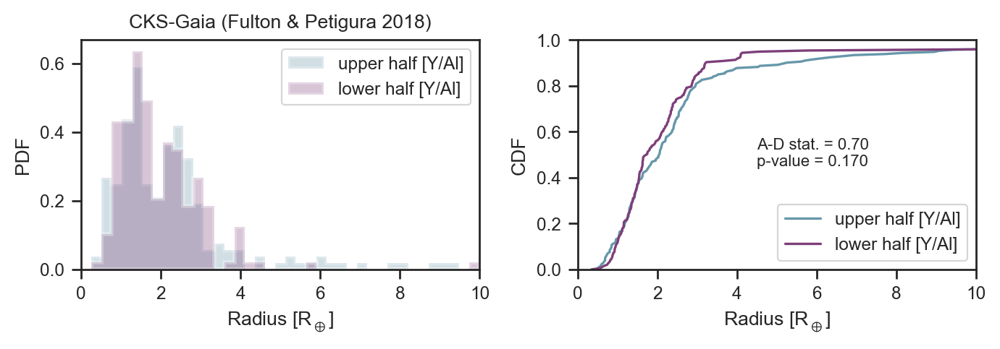

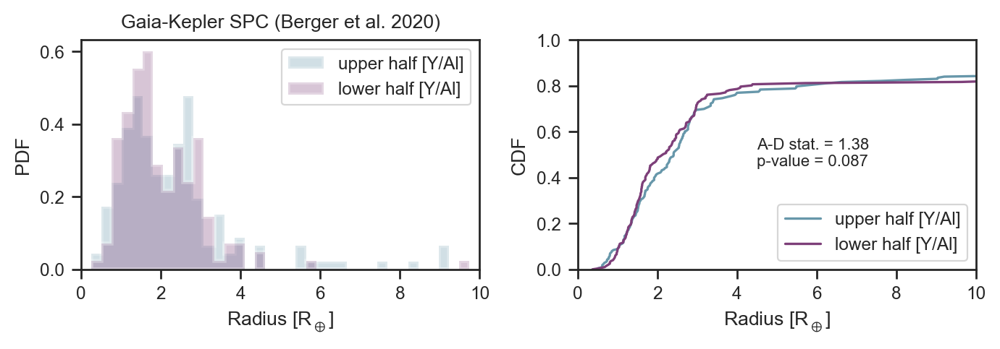

In [289]:
sns.set_context("paper")
sns.set_style("ticks")

ymg_yng = ymg_arg & (df["ymg_age_n20"]<4) #& (df["cks_[Fe/H]"]>0) 
ymg_old = ymg_arg & (df["ymg_age_n20"]>4) #& (df["cks_[Fe/H]"]>0)

print(len(df["cks_Rp"][ymg_yng]))
print(len(df["cks_Rp"][ymg_old]))

plot_distributions(df["cks_Rp"][ymg_yng], df["cks_Rp"][ymg_old], labels=["younger","older"], title='CKS-Gaia (Fulton & Petigura 2018)')
plot_distributions(df["b20b_Radius"][ymg_yng], df["b20b_Radius"][ymg_old], labels=["younger","older"], title='Gaia-Kepler SPC (Berger et al. 2020)')

ymg_upq = ymg_arg & (df["ymg_ratio"]>np.nanpercentile(df["ymg_ratio"],50.)) #& (df["cks_[Fe/H]"]>0) 
ymg_loq = ymg_arg & (df["ymg_ratio"]<np.nanpercentile(df["ymg_ratio"],50.)) #& (df["cks_[Fe/H]"]>0)

print(len(df["cks_Rp"][ymg_upq]))
print(len(df["cks_Rp"][ymg_loq]))

plot_distributions(df["cks_Rp"][ymg_upq], df["cks_Rp"][ymg_loq], labels=["upper half [Y/Mg]","lower half [Y/Mg]"], title='CKS-Gaia (Fulton & Petigura 2018)')
plot_distributions(df["b20b_Radius"][ymg_upq], df["b20b_Radius"][ymg_loq], labels=["upper half [Y/Mg]","lower half [Y/Mg]"], title='Gaia-Kepler SPC (Berger et al. 2020)')


yal_upq = ymg_arg & (df["yal_ratio"]>np.nanpercentile(df["yal_ratio"],50.)) #& (df["cks_[Fe/H]"]>0) 
yal_loq = ymg_arg & (df["yal_ratio"]<np.nanpercentile(df["yal_ratio"],50.)) #& (df["cks_[Fe/H]"]>0)

print(len(df["cks_Rp"][yal_upq]))
print(len(df["cks_Rp"][yal_loq]))

plot_distributions(df["cks_Rp"][yal_upq], df["cks_Rp"][yal_loq], labels=["upper half [Y/Al]","lower half [Y/Al]"], title='CKS-Gaia (Fulton & Petigura 2018)')
plot_distributions(df["b20b_Radius"][yal_upq], df["b20b_Radius"][yal_loq], labels=["upper half [Y/Al]","lower half [Y/Al]"], title='Gaia-Kepler SPC (Berger et al. 2020)')

# Multivariate relations for solar-type stars

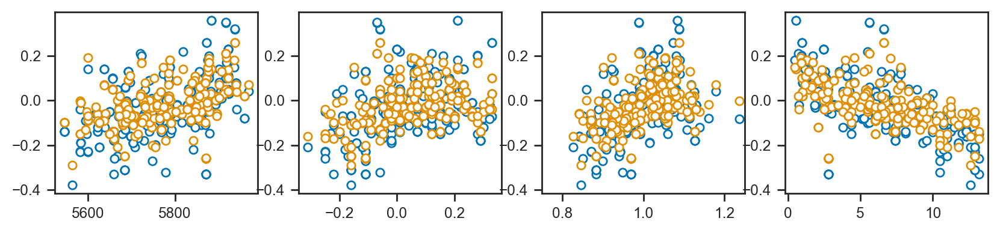

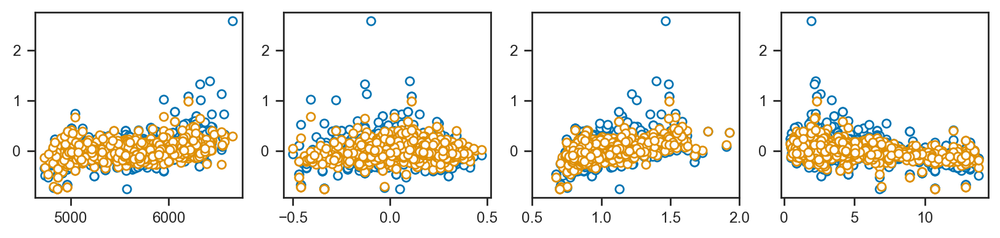

In [133]:
sns.set_palette(sns.color_palette("colorblind"))

xvals = ["cks_Teff", "cks_[Fe/H]", "cks_Miso", "cks_age"]

y1 = df["yal_ratio"][n20_sun_like]; y1err = df["yal_ratio_err"][n20_sun_like]
y2 = df["ymg_ratio"][n20_sun_like]; y2err = df["ymg_ratio_err"][n20_sun_like]

fig, ax = plt.subplots(nrows=1,ncols=4,figsize=(10,2))

for i,x in enumerate(xvals):
    ax[i].plot(df[x][n20_sun_like], y1, **sc_kwargs)
    ax[i].plot(df[x][n20_sun_like], y2, **sc_kwargs)

ax[2].set_xlim(0.75,1.25)
plt.show()

# arg = n20_sun_like & (np.isfinite(df["p20_cks_steff"])) & (df["p20_cks_slogg"]) & (df["p20_cks_smet"]) & (df["cks_age_gyr"])

# z1 = np.polyfit(df["cks_Miso"][arg], df["ymg_ratio"][arg], 1)
# p1 = np.poly1d(z1)

# fig, ax = plt.subplots(nrows=1,ncols=4,figsize=(10,2))

# for i,x in enumerate(xvals):
#     #ax[i].plot(df[x][n20_sun_like], y1, **sc_kwargs)
#     ax[i].plot(df[x][n20_sun_like], y2-p1(df[x][n20_sun_like]), **sc_kwargs)
    

# ax[2].set_xlim(0.75,1.25)
# plt.show()


xvals = ["cks_Teff", "cks_[Fe/H]", "cks_Miso", "cks_age"]

y1 = df["yal_ratio"]; y1err = df["yal_ratio_err"]
y2 = df["ymg_ratio"]; y2err = df["ymg_ratio_err"]

fig, ax = plt.subplots(nrows=1,ncols=4,figsize=(10,2))

for i,x in enumerate(xvals):
    ax[i].plot(df[x], y1, **sc_kwargs)
    ax[i].plot(df[x], y2, **sc_kwargs)
    
ax[2].set_xlim(0.5,2)
plt.show()

In [277]:
# data = dict(y=np.array(nis["[Y/Fe]"]-nis["[Mg/Fe]"]), yerr=0.02*np.ones(len(nis)),
#             x1=np.array(nis["Teff"]),
#             x2=np.array(nis["logg-sp"]), 
#             x3=np.array(nis["[Fe/H]"]),
#             x4=np.array(nis["Age"]))




# data = dict(y=np.array(df["ymg_ratio"][arg]), yerr=np.array(df["ymg_ratio_err"][arg]),
#             x1=np.array(df["p20_cks_steff"][arg]),
#             x2=np.array(df["p20_cks_slogg"][arg]), 
#             x3=np.array(df["p20_cks_smet"][arg]),
#             x4=np.array(df["cks_age"][arg]))


arg = n20_sun_like & (np.isfinite(df["p20_cks_steff"])) & (df["p20_cks_slogg"]) & (df["p20_cks_smet"]) & (df["cks_age"])


#Revised 8/27/2021
#Combined CKS + Nissen et al. 2020 data sets
# data = dict(y=np.append(nis["[Y/Fe]"]-nis["[Mg/Fe]"], df["ymg_ratio"][arg]), yerr=np.append(0.02*np.ones(len(nis)), df["ymg_ratio_err"][arg]),
#             x1=np.append(nis["Teff"], df["p20_cks_steff"][arg]), x1err=np.append(10.*np.ones(len(nis)), df["p20_cks_steff_err1"][arg]),
#             x2=np.append(nis["logg-sp"], df["p20_cks_slogg"][arg]), x2err=np.append(0.02*np.ones(len(nis)), df["p20_cks_slogg_err1"][arg]), 
#             x3=np.append(nis["[Fe/H]"], df["p20_cks_smet"][arg]), x3err=np.append(0.01*np.ones(len(nis)), df["p20_cks_smet_err1"][arg]),
#             x4=np.append(nis["Age"], df["cks_age"][arg]), x4err=np.append(nis["e_Age"], np.max([df["cks_e_age"][arg],df["cks_E_age"][arg]], axis=0)),
#             flag=np.append(['n20']*len(nis), ['cks']*len(df["cks_age"][arg])))

# data = dict(y=np.append(nis["[Y/Fe]"]-nis["[Mg/Fe]"], df["bf18_[Y/Mg]"][arg]), yerr=np.append(0.02*np.ones(len(nis)), df["bf18_e_[Y/Mg]"][arg]),
#             teff=np.append(nis["Teff"], df["p20_cks_steff"][arg]), eteff=np.append(10.*np.ones(len(nis)), df["p20_cks_steff_err1"][arg]),
#             logg=np.append(nis["logg-sp"], df["p20_cks_slogg"][arg]), elogg=np.append(0.02*np.ones(len(nis)), df["p20_cks_slogg_err1"][arg]), 
#             feh=np.append(nis["[Fe/H]"], df["p20_cks_smet"][arg]), efeh=np.append(0.01*np.ones(len(nis)), df["p20_cks_smet_err1"][arg]),
#             age=np.append(nis["Age"], df["cks_age"][arg]), eage=np.append(nis["e_Age"], np.max([df["cks_e_age"][arg],df["cks_E_age"][arg]], axis=0)),
#             flag=np.append(['n20']*len(nis), ['cks']*len(df["cks_age"][arg])))


#Reframing in terms of age
data = dict(ymg=np.append(nis["[Y/Fe]"]-nis["[Mg/Fe]"], df["bf18_[Y/Mg]"][arg]), e_ymg=np.append(0.02*np.ones(len(nis)), df["bf18_e_[Y/Mg]"][arg]),
            yal=np.append(nis["[Y/Fe]"]-nis["[Al/Fe]"], df["bf18_[Y/Al]"][arg]), e_yal=np.append(0.02*np.ones(len(nis)), df["bf18_e_[Y/Al]"][arg]),
            teff=np.append(nis["Teff"], df["p20_cks_steff"][arg]), e_teff=np.append(10.*np.ones(len(nis)), df["p20_cks_steff_err1"][arg]),
            logg=np.append(nis["logg-sp"], df["p20_cks_slogg"][arg]), e_logg=np.append(0.02*np.ones(len(nis)), df["p20_cks_slogg_err1"][arg]), 
            feh=np.append(nis["[Fe/H]"], df["p20_cks_smet"][arg]), e_feh=np.append(0.01*np.ones(len(nis)), df["p20_cks_smet_err1"][arg]),
            age=np.append(nis["Age"], df["cks_age"][arg]), e_age=np.append(nis["e_Age"], np.max([df["cks_e_age"][arg], df["cks_E_age"][arg]], axis=0)),
            flag=np.append(['n20']*len(nis), ['cks']*len(df["cks_age"][arg])))

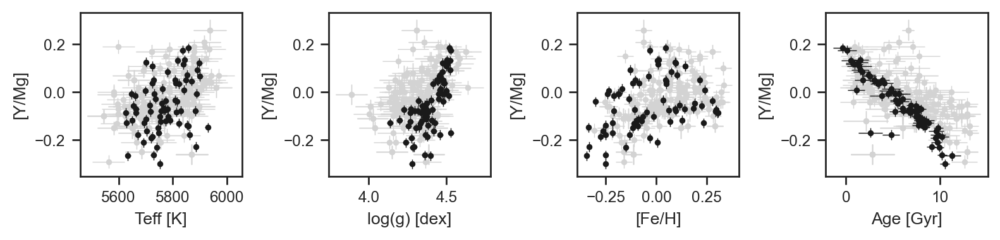

In [282]:
fig, ax = plt.subplots(nrows=1,ncols=4,figsize=(8,2))
xlabels = ['Teff [K]', 'log(g) [dex]', '[Fe/H]', 'Age [Gyr]']
data_labels = ['teff', 'logg', 'feh', 'age']


for i in range(1,5):
    for ref in np.unique(data["flag"]):
        arg = data["flag"]==ref
        col = data_labels[i-1]
        
        #ax[i-1].errorbar(data["x"+str(i)][arg], data["y"][arg], xerr=data["x"+str(i)+"err"][arg], yerr=data["yerr"][arg], fmt='.')
        if ref=='cks':
            #ax[i-1].errorbar(data["x"+str(i)][arg], data["x4"][arg], xerr=data["x"+str(i)+"err"][arg], yerr=data["x4err"][arg], fmt='.', zorder=0)
            #ax[i-1].errorbar(data["x"+str(i)][arg], data["y"][arg], xerr=data["x"+str(i)+"err"][arg], yerr=data["yerr"][arg], fmt='.', zorder=0, color='lightgrey')
            
            #ax[i-1].errorbar(data[col][arg], data["y"][arg], xerr=data["e"+col][arg], yerr=data["yerr"][arg], fmt='.', zorder=0, color='lightgrey')
            ax[i-1].errorbar(data[col], data["ymg"], xerr=data["e_"+col], yerr=data["e_ymg"], fmt='.', zorder=0, color='lightgrey', lw=0.5)

        else:
            #ax[i-1].errorbar(data["x"+str(i)][arg], data["x4"][arg], xerr=data["x"+str(i)+"err"][arg], yerr=data["x4err"][arg], fmt='.', zorder=1)
            #ax[i-1].errorbar(data["x"+str(i)][arg], data["y"][arg], xerr=data["x"+str(i)+"err"][arg], yerr=data["yerr"][arg], fmt='.', zorder=1, color='k')
            ax[i-1].errorbar(data[col][arg], data["ymg"][arg], xerr=data["e_"+col][arg], yerr=data["e_ymg"][arg], fmt='.', zorder=1, color='k', lw=0.5)
            
            
            ax[i-1].set_xlabel(xlabels[i-1])
            ax[i-1].set_ylabel('[Y/Mg]')
            
            
            
            
plt.tight_layout()
plt.show()

# Modeling age

In [329]:
#import theano
import pymc3 as pm
import pymc3_ext as pmx
import aesara_theano_fallback.tensor as tt
import exoplanet as xo

print(pm.__version__)
print(xo.__version__)
print(theano.__version__)

with pm.Model() as model:  # model specifications in PyMC3 are wrapped in a with-statement
    
    # Define priors
    sigma_jit = pm.HalfCauchy("sigma_jit", beta=10, testval=1.0)
    #sigma = pm.Deterministic("sigma", (( (sigma_jit* (data["flag"]=='cks'))**2 + data["eage"]**2))**0.5 )
    sigma = pm.Deterministic("sigma", (( (sigma_jit * (data["flag"]=='cks'))**2 + data["e_age"]**2))**0.5 )
    
    #cks_offset = pm.Uniform("cks_offset", lower=-0.2, upper=0.2)
    #yoffset = pm.Deterministic("yoffset", cks_offset * (data["flag"]=='cks'))
    
    cks_c0 = pm.Normal("cks_c0", 0, sigma=20, testval=0)
    cks_c1 = pm.Normal("cks_c1", 0, sigma=20, testval=0)
    cks_trend = pm.Deterministic("cks_trend", cks_c0 * (data["flag"]=='cks') + cks_c1 * data["ymg"] * (data["flag"]=='cks'))
    
    
    theta0 = pm.Normal("theta0", 0, sigma=20, testval=0)        
    theta_teff = pm.Normal("theta_teff", 0, sigma=20)
    #theta_teff2 = pm.Normal("theta_teff2", 0, sigma=20)
    theta_logg = pm.Normal("theta_logg", 0, sigma=20)
    theta_logg2 = pm.Normal("theta_logg2", 0, sigma=20)
    theta_feh  = pm.Normal("theta_feh", 0, sigma=20)
    #theta_feh2  = pm.Normal("theta_feh2", 0, sigma=20)
    theta_age  = pm.Normal("theta_age", 0, sigma=20)
    
    teff_trend = pm.Deterministic("teff_trend", theta_teff*data["teff"])
    logg_trend = pm.Deterministic("logg_trend", theta_logg*data["logg"])
    feh_trend  = pm.Deterministic("feh_trend", theta_feh*data["feh"])
    ymg_trend  = pm.Deterministic("ymg_trend", theta_age*data["ymg"])

    ymodel = pm.Deterministic("ymodel", 
                              theta0 + teff_trend  + feh_trend + logg_trend + ymg_trend)    
    
    others = pm.Deterministic("others",
                              theta0 + teff_trend + logg_trend + feh_trend)
    
    #trend1 = pm.Deterministic("trend1", theta*data["x2"])
    #map_soln["theta0"]+data["x2"][arg]*map_soln["theta2"]+data["x3"][arg]*map_soln["theta3"]+data["x3"][arg]**2*map_soln["theta3b"]+data["x4"][arg]*map_soln["theta4"]
    
    # Define likelihood
    likelihood = pm.Normal("y", mu=ymodel, 
                                sigma=sigma, 
                                observed=data["age"] - cks_trend) #observed=data["y"] + yoffset)
    
    
    #if start is None:
    start = model.test_point     
    #map_soln = pmx.optimize(start=start, vars=[theta1, theta3, theta4])
    map_soln = pmx.optimize(start=start)
    map_soln = pmx.optimize(start=map_soln)

3.11.4
0.5.1
1.1.2


optimizing logp for variables: [theta_age, theta_feh, theta_logg2, theta_logg, theta_teff, theta0, cks_c1, cks_c0, sigma_jit]


message: Optimization terminated successfully.
logp: -7546.403498405873 -> -669.2131998941545


optimizing logp for variables: [theta_age, theta_feh, theta_logg2, theta_logg, theta_teff, theta0, cks_c1, cks_c0, sigma_jit]


message: Optimization terminated successfully.
logp: -669.2131998941545 -> -669.2131998941545


# Modeling age (scatter in each dimension) not working

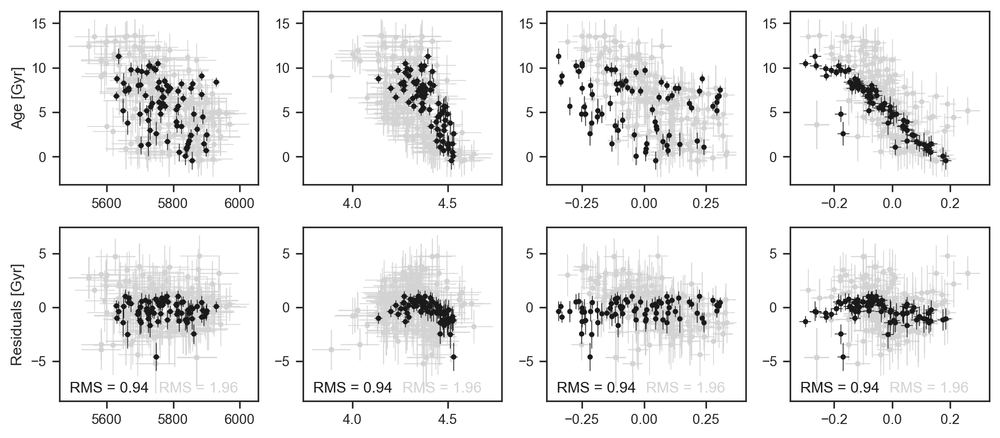

In [330]:
variables = ["teff","logg","feh","ymg"]

fig, (ax1,ax2) = plt.subplots(nrows=2,ncols=4,figsize=(9,4))

for i,v in enumerate(variables):
    for ref in np.unique(data["flag"]):
        arg = data["flag"]==ref
        
        
        oc = data["age"]-map_soln["cks_trend"]-map_soln["ymodel"]

        if ref=='cks':

            ax1[i].errorbar(data[v][arg], 
                            data["age"][arg]-map_soln["cks_trend"][arg], 
                            xerr=data["e_"+v][arg], 
                            yerr=map_soln["sigma"][arg], 
                            fmt='.', zorder=0, color='lightgrey', lw=0.5)
            
            ax2[i].errorbar(data[v][arg],
                            oc[arg], 
                            xerr=data["e_"+v][arg],  
                            yerr=map_soln["sigma"][arg], 
                            fmt='.', zorder=0, color='lightgrey', lw=0.5)
            
            ax2[i].text(0.5,0.05,"RMS = "+str(np.round(np.std(oc[arg]),2)), transform=ax2[i].transAxes, color='lightgrey')
        
        else:

            ax1[i].errorbar(data[v][arg],
                            data["age"][arg], 
                            xerr=data["e_"+v][arg], 
                            yerr=map_soln["sigma"][arg], 
                            fmt='.', zorder=1, color='k', lw=0.5)
            
            ax2[i].errorbar(data[v][arg],
                            oc[arg], 
                            xerr=data["e_"+v][arg], 
                            yerr=map_soln["sigma"][arg],
                            fmt='.', zorder=1, color='k', lw=0.5)
            
            ax2[i].text(0.05,0.05,"RMS = "+str(np.round(np.std(oc[arg]),2)), transform=ax2[i].transAxes, color='k')
            
        
        
        #'RMS = '+str(np.round(np.std(),3))+' dex'
        
        
        #ax1[i].plot(data[v][np.argsort(data[v])], map_soln[v+"_trend"][np.argsort(data[v])], c='r')
    
ax1[0].set_ylabel("Age [Gyr]")
ax2[0].set_ylabel("Residuals [Gyr]")
#ax2[0].set_ylabel("[Y/Mg] corrected")
plt.tight_layout()

In [325]:
import pymc3 as pm
import pymc3_ext as pmx
import aesara_theano_fallback.tensor as tt
import exoplanet as xo

print(pm.__version__)
print(xo.__version__)
print(theano.__version__)


teff = np.ascontiguousarray(data["teff"])
e_teff = np.ascontiguousarray(data["e_teff"])

with pm.Model() as model:  # model specifications in PyMC3 are wrapped in a with-statement


    age_offset = pm.Uniform("age_offset", lower=-5, upper=5)
    ages = pm.Deterministic("ages", data["age"] - age_offset * (data["flag"]=="cks"))
        
    c0_logg = pm.Normal("c0_logg", 0, sigma=20)
    c1_logg = pm.Normal("c1_logg", 0, sigma=20)
    sigma_jit_logg = pm.HalfCauchy("sigma_jit_logg", beta=10, testval=1.0)
    sigma_logg = pm.Deterministic("sigma_logg", tt.sqrt(data["e_logg"]**2 + (sigma_jit_logg*data["logg"])**2))
    logg_trend = pm.Deterministic("logg_trend", c0_logg + c1_logg * data["logg"])
    
#     c0_teff = pm.Normal("c0_teff", 0, sigma=20)
#     c1_teff = pm.Normal("c1_teff", 0, sigma=20)    
#     sigma_jit_teff = pm.HalfCauchy("sigma_jit_teff", beta=10, testval=1.0)
#     sigma_teff = ("sigma_teff", tt.sqrt(e_teff**2 + (sigma_jit_teff*teff)**2))
#     teff_trend = pm.Deterministic("teff_trend", c0_teff + c1_teff * teff)
    
#     c0_feh = pm.Normal("c0_feh", 0, sigma=20)
#     c1_feh = pm.Normal("c1_feh", 0, sigma=20)        
#     sigma_jit_feh = pm.HalfCauchy("sigma_jit_feh", beta=10, testval=1.0)
#     sigma_feh = ("sigma_feh", tt.sqrt(data["e_feh"]**2 + (sigma_jit_feh*data["feh"])**2))
#     feh_trend = pm.Deterministic("feh_trend", c0_feh + c1_feh * data["feh"])
    
    
    logg_chisq = pm.Deterministic("logg_chisq", -0.5*(data["age"] - logg_trend)**2/(sigma_logg**2))
#     teff_chisq = pm.Deterministic("teff_chisq", -0.5*(data["teff"] - teff_trend)**2/(sigma_teff**2))
#     feh_chisq  = pm.Deterministic("feh_chisq", -0.5*(data["feh"] - feh_trend)**2/(sigma_feh**2))
    
#    pm.Potential("other_trends", logg_chisq + teff_chisq + feh_chisq)
    pm.Potential("other_trends", logg_chisq)
    
    #YMg relation
    c0 = pm.Normal("c0", 0, sigma=20)
    c1 = pm.Normal("c1", 0, sigma=20)
    
    #Feed in corrected ymg
    ymodel  = pm.Deterministic("ymodel", c0 + c1 * data["ymg"])    
    
    # Define priors
    sigma_jit = pm.HalfCauchy("sigma_jit", beta=10, testval=1.0)
    sigma = pm.Deterministic("sigma", (( (sigma_jit* (data["flag"]=='cks'))**2 + data["e_age"]**2))**0.5 )
    
    #cks_c0 = pm.Normal("cks_c0", 0, sigma=20, testval=0)
    #cks_c1 = pm.Normal("cks_c1", 0, sigma=20, testval=0)
    #cks_trend = pm.Deterministic("cks_trend", cks_c0 * (data["flag"]=='cks') + cks_c1 * data["ymg"] * (data["flag"]=='cks'))
    
    #trend1 = pm.Deterministic("trend1", theta*data["x2"])
    #map_soln["theta0"]+data["x2"][arg]*map_soln["theta2"]+data["x3"][arg]*map_soln["theta3"]+data["x3"][arg]**2*map_soln["theta3b"]+data["x4"][arg]*map_soln["theta4"]
    
    # Define likelihood
    likelihood = pm.Normal("y", mu=ymodel, 
                                sigma=sigma, 
                                observed=data["age"]) #observed=data["y"] + yoffset)
    
    
    #if start is None:
    start = model.test_point     
    #map_soln = pmx.optimize(start=start, vars=[theta1, theta3, theta4])
    map_soln = pmx.optimize(start=start)
    map_soln = pmx.optimize(start=map_soln)

3.11.4
0.5.1
1.1.2


optimizing logp for variables: [sigma_jit, c1, c0, sigma_jit_logg, c1_logg, c0_logg, age_offset]


message: Optimization terminated successfully.
logp: -7991.14705222494 -> -780.8443851660232


optimizing logp for variables: [sigma_jit, c1, c0, sigma_jit_logg, c1_logg, c0_logg, age_offset]


message: Optimization terminated successfully.
logp: -780.8443851660232 -> -780.8443851660232


# Modeling YMg

In [276]:
#import theano
import pymc3 as pm
import pymc3_ext as pmx
import aesara_theano_fallback.tensor as tt
import exoplanet as xo

print(pm.__version__)
print(xo.__version__)
print(theano.__version__)

with pm.Model() as model:  # model specifications in PyMC3 are wrapped in a with-statement
    # Define priors
    sigma_jit = pm.HalfCauchy("sigma_jit", beta=10, testval=1.0)
    sigma = pm.Deterministic("sigma", ((sigma_jit**2 + data["ymg_err"]**2))**0.5 )
    
    #cks_offset = pm.Uniform("cks_offset", lower=-0.2, upper=0.2)
    #yoffset = pm.Deterministic("yoffset", cks_offset * (data["flag"]=='cks'))
    
    cks_c0 = pm.Normal("cks_c0", 0, sigma=20, testval=0)
    cks_c1 = pm.Normal("cks_c1", 0, sigma=20, testval=0)
    cks_trend = pm.Deterministic("cks_trend", cks_c0 * (data["flag"]=='cks') + cks_c1 * data["age"] * (data["flag"]=='cks'))
    
    
    theta0 = pm.Normal("theta0", 0, sigma=20, testval=0)        
    theta_teff = pm.Normal("theta_teff", 0, sigma=20)
    #theta_teff2 = pm.Normal("theta_teff2", 0, sigma=20)
    theta_logg = pm.Normal("theta_logg", 0, sigma=20)
    #theta_logg2 = pm.Normal("theta_logg2", 0, sigma=20)
    theta_feh  = pm.Normal("theta_feh", 0, sigma=20)
    theta_feh2  = pm.Normal("theta_feh2", 0, sigma=20)
    theta_age  = pm.Normal("theta_age", 0, sigma=20)
    
    
    teff_trend = pm.Deterministic("teff_trend", theta_teff*data["teff"])
    logg_trend = pm.Deterministic("logg_trend", theta_logg*data["logg"])
    feh_trend  = pm.Deterministic("feh_trend", theta_feh*data["feh"] + theta_feh2*data["feh"]**2)
    age_trend  = pm.Deterministic("age_trend", theta_age*data["age"])

    ymodel = pm.Deterministic("ymodel", 
                              theta0 + teff_trend + logg_trend + feh_trend + age_trend)    
    
    others = pm.Deterministic("others",
                              theta0 + teff_trend + logg_trend + feh_trend)
    
    #trend1 = pm.Deterministic("trend1", theta*data["x2"])
    #map_soln["theta0"]+data["x2"][arg]*map_soln["theta2"]+data["x3"][arg]*map_soln["theta3"]+data["x3"][arg]**2*map_soln["theta3b"]+data["x4"][arg]*map_soln["theta4"]
    
    # Define likelihood
    likelihood = pm.Normal("y", mu=ymodel, 
                                sigma=sigma, 
                                observed=data["ymg"] - cks_trend) #observed=data["y"] + yoffset)
    
    
    #if start is None:
    start = model.test_point     
    #map_soln = pmx.optimize(start=start, vars=[theta1, theta3, theta4])
    map_soln = pmx.optimize(start=start)
    map_soln = pmx.optimize(start=map_soln)

3.11.4
0.5.1
1.1.2


KeyError: 'ymg_err'

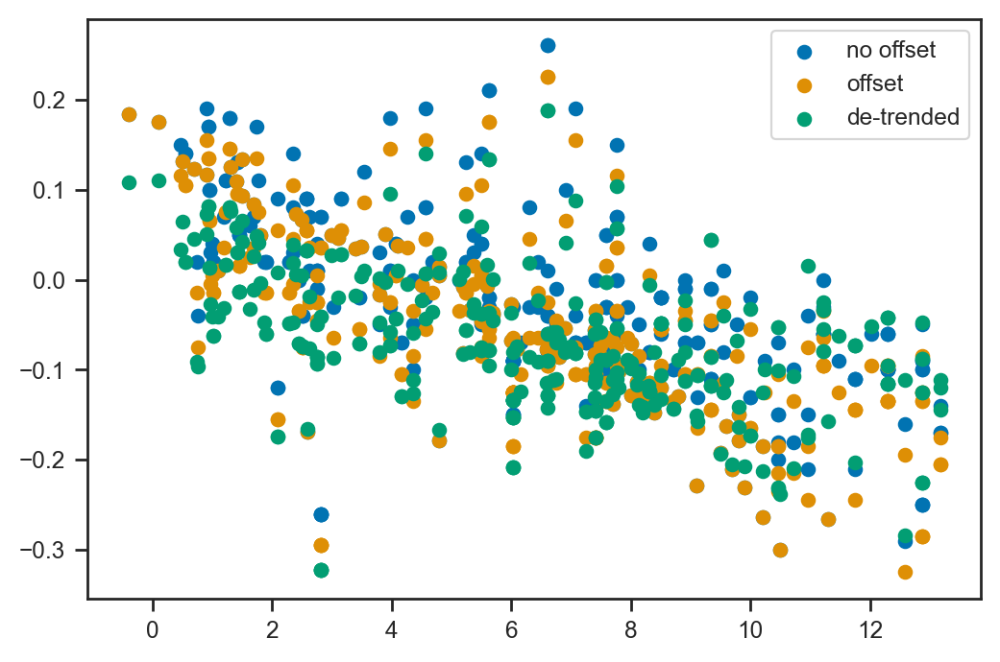

In [200]:
plt.scatter(data["age"], data["y"], label='no offset')
plt.scatter(data["age"], data["y"]+map_soln["yoffset"], label='offset')
plt.scatter(data["age"], data["y"]+map_soln["yoffset"]-map_soln["others"], label='de-trended')

#plt.scatter(data["age"], data["y"]+map_soln["cks_offset"]*(data["flag"]=='cks')-map_soln["others"], label='de-trended')

plt.legend()
plt.show()

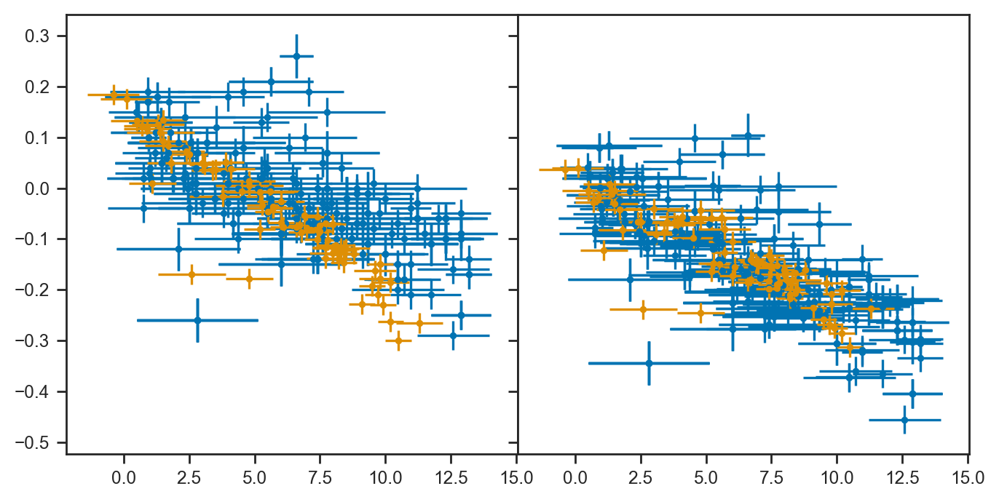

In [232]:
fig,ax = plt.subplots(nrows=1, ncols=2, sharex=True, sharey=True, figsize=(8,4))

for ref in np.unique(data["flag"]):
    arg = data["flag"] == ref
    #Uncorrected
    ax[0].errorbar(data["age"][arg], data["y"][arg], xerr=data["eage"][arg], yerr=data["yerr"][arg], fmt='.')
    #Corrected
    ax[1].errorbar(data["age"][arg], data["y"][arg]-map_soln["cks_trend"][arg]-(map_soln["others"][arg]), xerr=data["eage"][arg], yerr=data["yerr"][arg], fmt='.')
    
plt.subplots_adjust(wspace=0)
#for ref in np.unique(data["flag"]):
#    arg = data["flag"] == ref
    
#plt.gcf().set_size_inches(6,6)
plt.show()

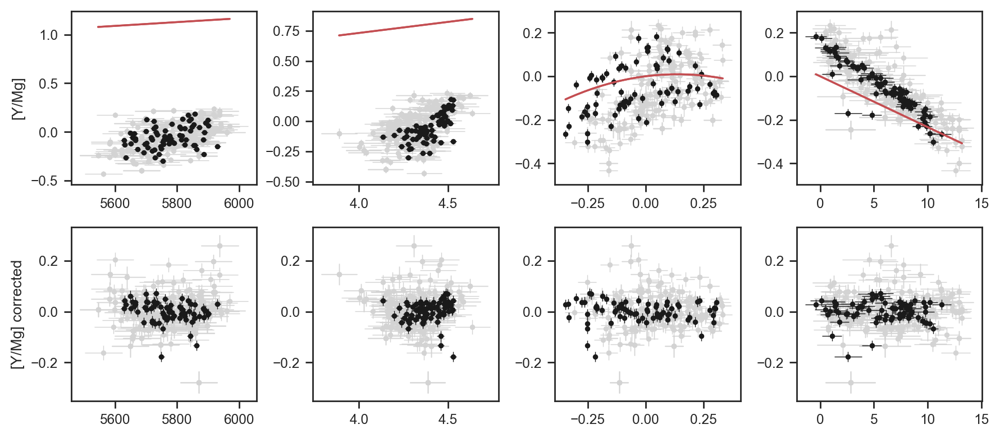

In [241]:
fig, (ax1,ax2) = plt.subplots(nrows=2,ncols=4,figsize=(9,4))


for i,v in enumerate(variables):
    for ref in np.unique(data["flag"]):
        arg = data["flag"]==ref

        if ref=='cks':

            ax1[i].errorbar(data[v][arg], data["y"][arg]-map_soln["cks_trend"][arg], xerr=data["e"+v][arg], yerr=data["yerr"][arg], fmt='.', zorder=0, color='lightgrey', lw=0.5)
            ax2[i].errorbar(data[v][arg], data["y"][arg]-map_soln["cks_trend"][arg]-(map_soln["ymodel"][arg]), xerr=data["e"+v][arg], yerr=data["yerr"][arg], fmt='.', zorder=0, color='lightgrey', lw=0.5)
        
        else:

            ax1[i].errorbar(data[v][arg], data["y"][arg], xerr=data["e"+v][arg], yerr=data["yerr"][arg], fmt='.', zorder=1, color='k', lw=0.5)
            ax2[i].errorbar(data[v][arg], data["y"][arg]-(map_soln["ymodel"][arg]), xerr=data["e"+v][arg], yerr=data["yerr"][arg], fmt='.', zorder=1, color='k', lw=0.5)
            
            
        #ax1[i].plot(data[v][np.argsort(data[v])], map_soln[v+"_trend"][np.argsort(data[v])], c='r')
    
ax1[0].set_ylabel("[Y/Mg]")
ax2[0].set_ylabel("[Y/Mg] corrected")
plt.tight_layout()

In [293]:
with model:
    # specify glm and pass in data. The resulting linear model, its likelihood and
    # and all its parameters are automatically added to our model.
    trace = pm.sample(1000, start=map_soln, cores=2)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [theta4, theta3, theta1, theta0, sigma_jit]
Sampling 2 chains, 0 divergences: 100%|██████████| 3000/3000 [00:35<00:00, 84.83draws/s] 


In [282]:
#pm.summary(trace, round_to=6, var_names=['theta0','theta1','theta2','theta3','theta3b','theta4'])
#pm.summary(trace, round_to=6, var_names=['theta1','theta2','theta3','theta3b','theta4'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
theta1,0.000013,0.000029,-0.000038,0.000069,0.000001,0.000001,734.254548,734.254548,732.633121,841.387652,1.002338
theta2,0.011351,0.037547,-0.059712,0.080316,0.001369,0.000991,752.396067,718.184669,751.284639,839.721639,1.002141
theta3,-0.004329,0.028442,-0.057343,0.047114,0.000889,0.000629,1023.479748,1023.479748,1014.871289,1063.113110,1.007340
theta3b,-0.901589,0.148718,-1.165267,-0.618275,0.004721,0.003424,992.191335,943.742208,1004.089308,1045.881630,1.002817
theta4,-0.021917,0.001441,-0.024515,-0.019137,0.000046,0.000033,968.998123,968.998123,969.867815,1171.668394,1.004725


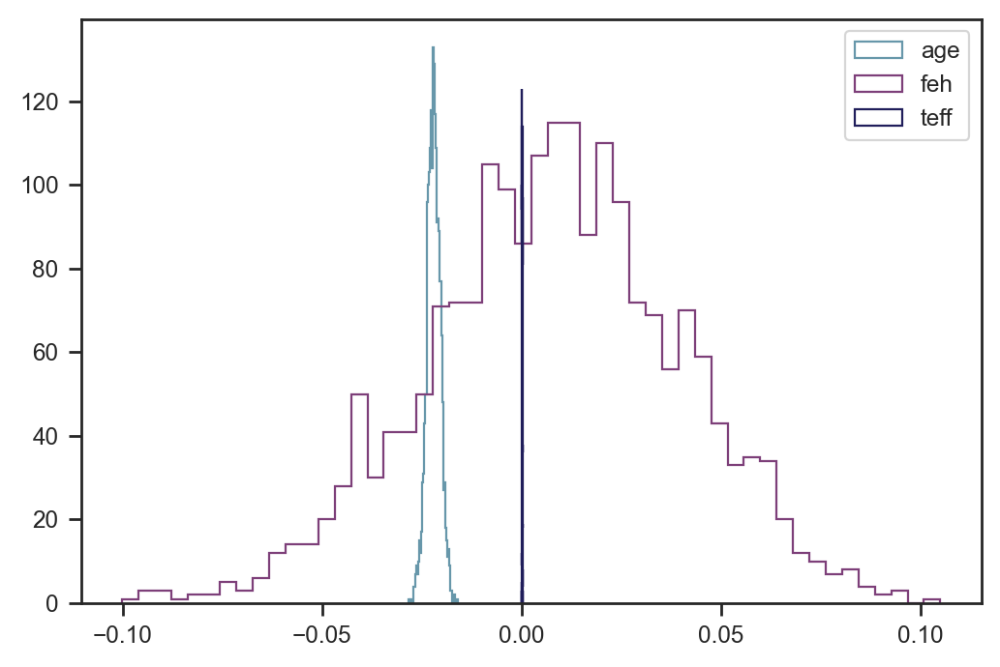

In [295]:
hist_kws={"histtype":"step", "bins":50}

plt.hist(trace["theta4"], **hist_kws, label='age')
plt.hist(trace["theta3"], **hist_kws, label='feh')
#plt.hist(trace["theta3b"], **hist_kws, label='feh^2')
#plt.hist(trace["theta2"], **hist_kws, label='logg')
plt.hist(trace["theta1"], **hist_kws, label='teff')
plt.legend()
plt.show()

In [296]:
_x1 = np.linspace(data["x1"].min(), data["x1"].max(), 100)
_x2 = np.linspace(data["x2"].min(), data["x2"].max(), 100)
_x3 = np.linspace(data["x3"].min(), data["x3"].max(), 100)
#_x3 = np.sort(data["x3"])
_x4 = np.linspace(data["x4"].min(), data["x4"].max(), 100)

data_labels = ["x1","x2","x3","x4"]

th1 = np.median(trace["theta1"])
th2 = np.median(trace["theta2"])
th3 = np.median(trace["theta3"])
th3b = np.median(trace["theta3b"])
th4 = np.median(trace["theta4"])

fig, ax = plt.subplots(nrows=1,ncols=4,figsize=(8,2))

for i,ref in enumerate(np.unique(data["flag"])):
    arg = data["flag"]==ref
#     ax[0].errorbar(data["x1"][arg], data["y"][arg]-(map_soln["theta0"]+data["x2"][arg]*map_soln["theta2"]+data["x3"][arg]*map_soln["theta3"]+data["x3"][arg]**2*map_soln["theta3b"]+data["x4"][arg]*map_soln["theta4"]), yerr=map_soln["sigma"][arg], fmt='.', zorder=99+i, label=ref)
#     ax[1].errorbar(data["x2"][arg], data["y"][arg]-(map_soln["theta0"]+data["x1"][arg]*map_soln["theta1"]+data["x3"][arg]*map_soln["theta3"]+data["x3"][arg]**2*map_soln["theta3b"]+data["x4"][arg]*map_soln["theta4"]), yerr=map_soln["sigma"][arg], fmt='.', zorder=99+i, label=ref)
#     ax[2].errorbar(data["x3"][arg], data["y"][arg]-(map_soln["theta0"]+data["x1"][arg]*map_soln["theta1"]+data["x2"][arg]*map_soln["theta2"]+data["x4"][arg]*map_soln["theta4"]), yerr=map_soln["sigma"][arg], fmt='.', zorder=99+i, label=ref)
#     ax[3].errorbar(data["x4"][arg], data["y"][arg]-(map_soln["theta0"]+data["x1"][arg]*map_soln["theta1"]+data["x2"][arg]*map_soln["theta2"]+data["x3"][arg]*map_soln["theta3"]+data["x3"][arg]**2*map_soln["theta3b"]), yerr=map_soln["sigma"][arg], fmt='.', zorder=99+i, label=ref)
    ax[0].errorbar(data["x1"][arg], data["y"][arg]-(data["x2"][arg]*map_soln["theta2"]+data["x3"][arg]*map_soln["theta3"]+data["x3"][arg]**2*map_soln["theta3b"]+data["x4"][arg]*map_soln["theta4"]), yerr=map_soln["sigma"][arg], fmt='.', zorder=99+i, label=ref)
    ax[1].errorbar(data["x2"][arg], data["y"][arg]-(data["x1"][arg]*map_soln["theta1"]+data["x3"][arg]*map_soln["theta3"]+data["x3"][arg]**2*map_soln["theta3b"]+data["x4"][arg]*map_soln["theta4"]), yerr=map_soln["sigma"][arg], fmt='.', zorder=99+i, label=ref)
    ax[2].errorbar(data["x3"][arg], data["y"][arg]-(data["x1"][arg]*map_soln["theta1"]+data["x2"][arg]*map_soln["theta2"]+data["x4"][arg]*map_soln["theta4"]), yerr=map_soln["sigma"][arg], fmt='.', zorder=99+i, label=ref)
    ax[3].errorbar(data["x4"][arg], data["y"][arg]-(data["x1"][arg]*map_soln["theta1"]+data["x2"][arg]*map_soln["theta2"]+data["x3"][arg]*map_soln["theta3"]+data["x3"][arg]**2*map_soln["theta3b"]), yerr=map_soln["sigma"][arg], fmt='.', zorder=99+i, label=ref)


    
    
ax[0].plot(_x1, map_soln["theta1"]*_x1, 'r', zorder=999)
#ax[0].fill_between(_x1, np.percentile(trace["theta1"],16)*_x1, np.percentile(trace["theta1"],84)*_x1, color='r', alpha=0.2) 
ax[1].legend()

ax[1].plot(_x2, map_soln["theta2"]*_x2, 'r', zorder=999)
#ax[1].fill_between(_x2, np.percentile(trace["theta2"],16)*_x2, np.percentile(trace["theta2"],84)*_x2, color='r', alpha=0.2) 


ax[2].plot(_x3, map_soln["theta3"]*_x3+map_soln["theta3b"]*_x3**2, 'r', zorder=999)
#ax[2].fill_between(_x3, np.percentile(trace["theta3"]*_x3 + trace["theta3b"]*_x3**2,16), np.percentile(trace["theta3"]*_x3 + trace["theta3b"]*_x3**2, 84), color='r', alpha=0.2) 


ax[3].plot(_x4, map_soln["theta4"]*_x4, 'r', zorder=999)


ax[0].set_xlabel("Teff [K]")
ax[1].set_xlabel("logg [dex]")
ax[2].set_xlabel("[Fe/H] [dex]")
ax[3].set_xlabel("Age [Gyr]")

ax[0].set_ylabel("[Y/Mg]")


for i in range(4):
    ax[i].set_yticklabels([])



# for i,_x in enumerate([_x1,_x2,_x3,_x4]):
#     ax[i].scatter(data[data_labels[i]], data["y"])
#     ax[i].plot(_x, map_soln["theta0"]+map_soln["theta1"]*_x1+map_soln["theta2"]*_x2+map_soln["theta3"]*_x3+map_soln["theta3b"]*_x3**2.+map_soln["theta4"]*_x4)
# plt.show()

KeyError: 'Unknown variable theta2'

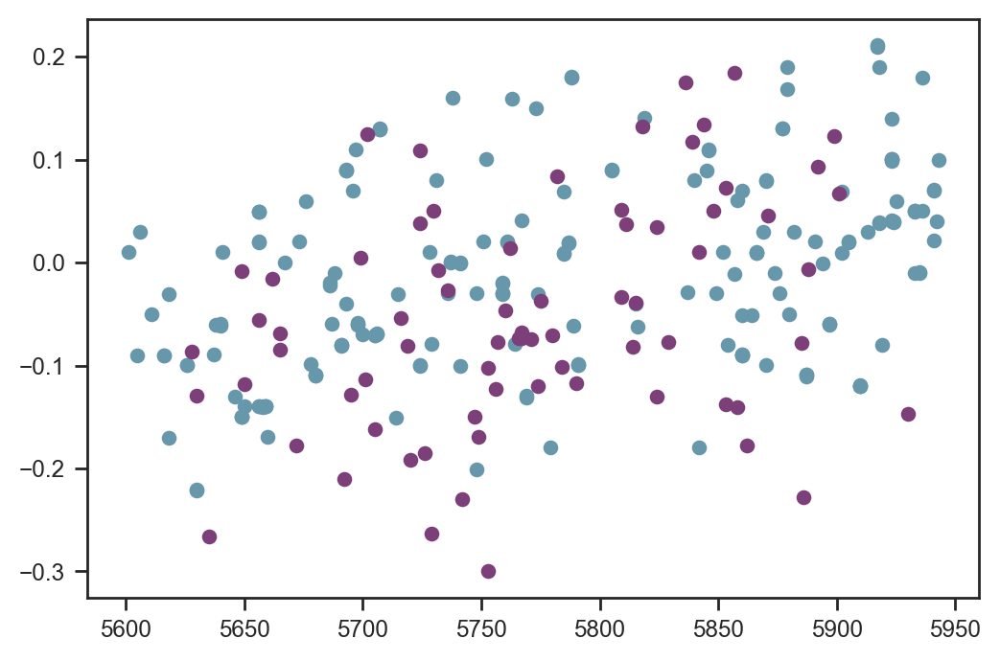

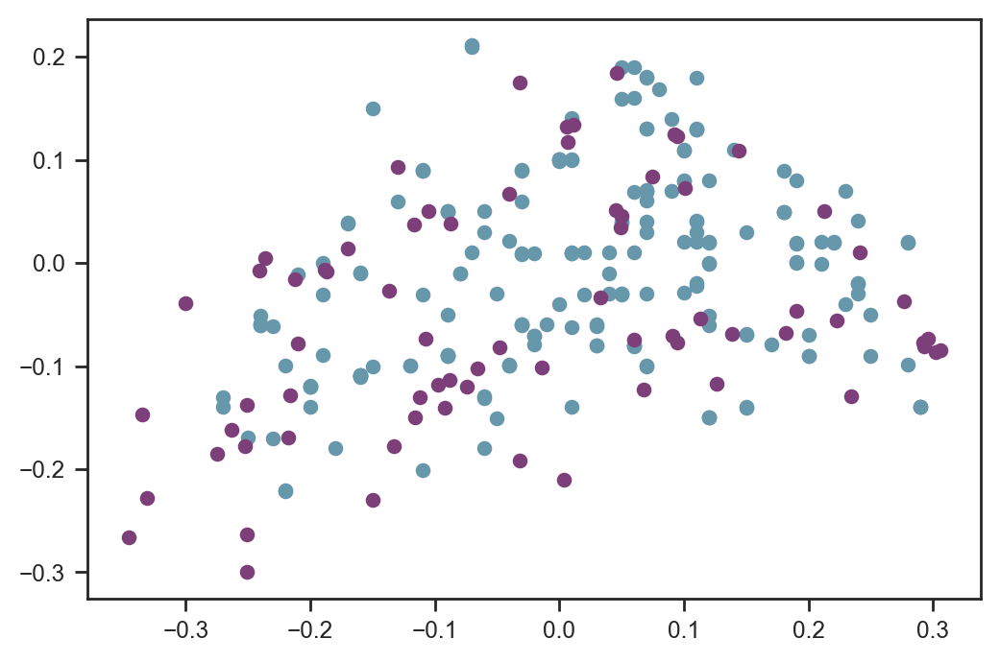

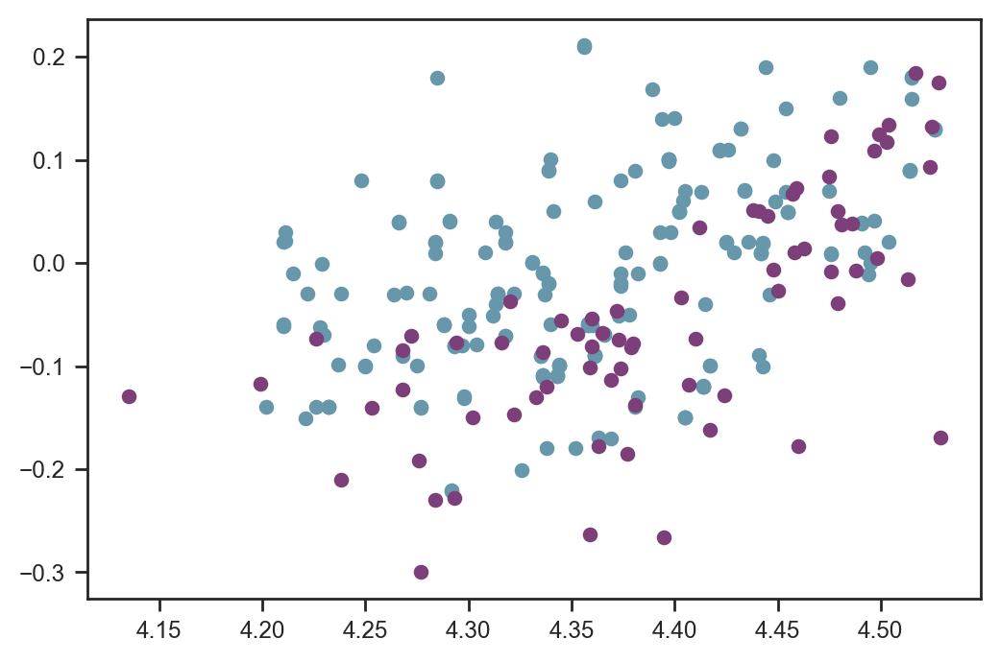

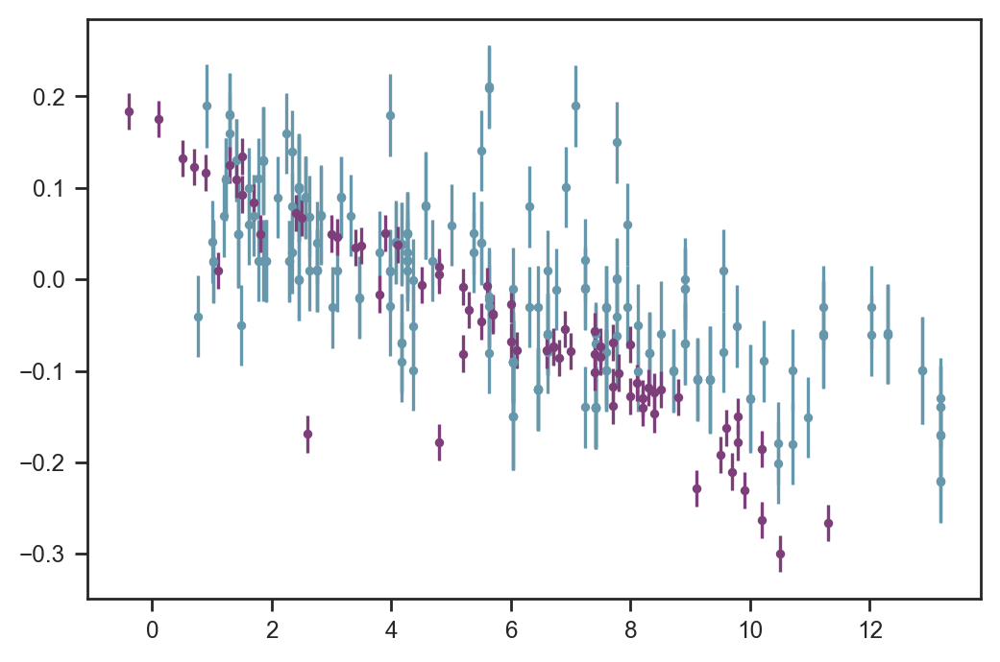

In [300]:
plt.scatter(df['cks_Teff'][n20_sun_like], df['ymg_ratio'][n20_sun_like])
plt.scatter(nis['Teff'], nis['[Y/Fe]']-nis['[Mg/Fe]'])
plt.show()

plt.scatter(df['cks_[Fe/H]'][n20_sun_like], df['ymg_ratio'][n20_sun_like])
plt.scatter(nis['[Fe/H]'], nis['[Y/Fe]']-nis['[Mg/Fe]'])
plt.show()

plt.scatter(df['p20_cks_slogg'][n20_sun_like], df['ymg_ratio'][n20_sun_like])
plt.scatter(nis['logg-sp'], nis['[Y/Fe]']-nis['[Mg/Fe]'])
plt.show()

plt.errorbar(df['cks_age_gyr'][n20_sun_like], df['ymg_ratio'][n20_sun_like], yerr=df['ymg_ratio_err'][n20_sun_like], fmt='.')
plt.errorbar(nis['Age'], nis['[Y/Fe]']-nis['[Mg/Fe]'], yerr=0.02, fmt='.')
plt.show()

In [247]:
# for ref in np.unique(data["flag"]):
#     print(ref)

#SG: check how we're doing for hi-conf. age stars (benchmarks)


cks
n20


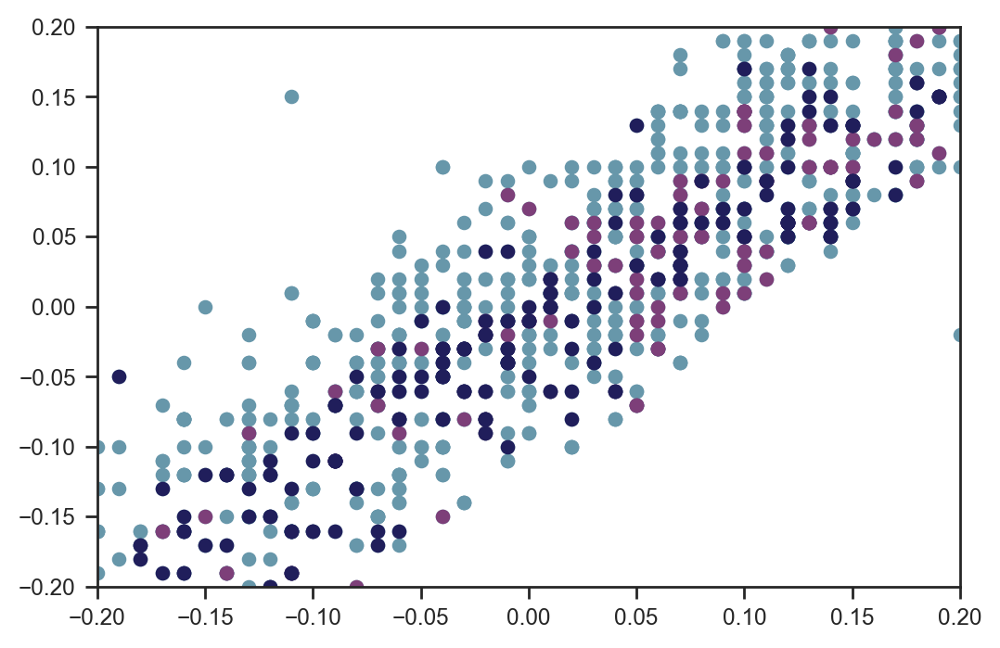

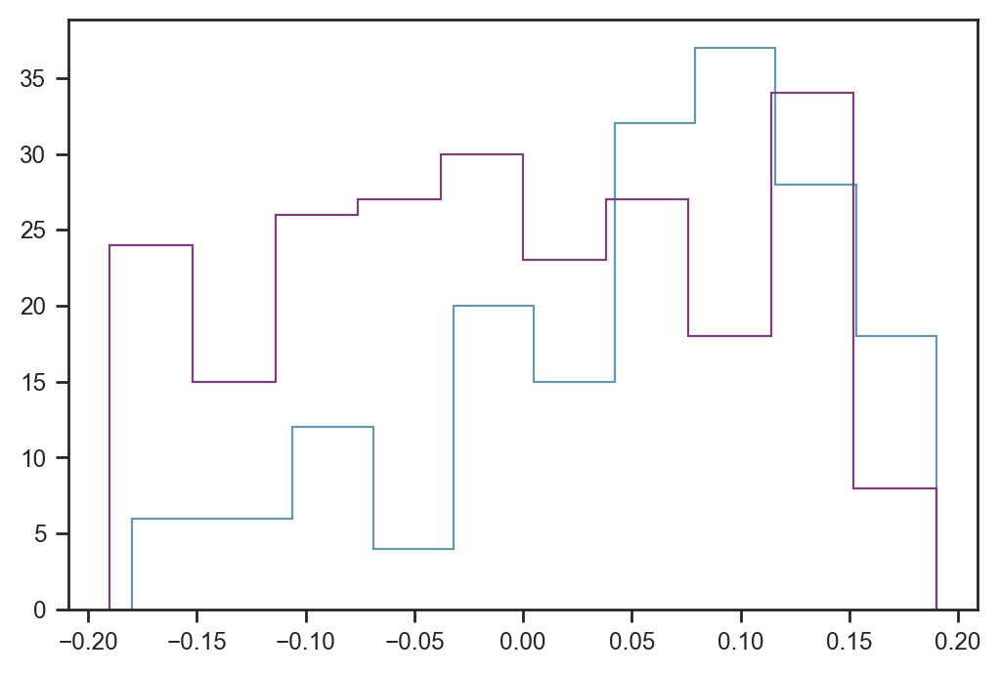

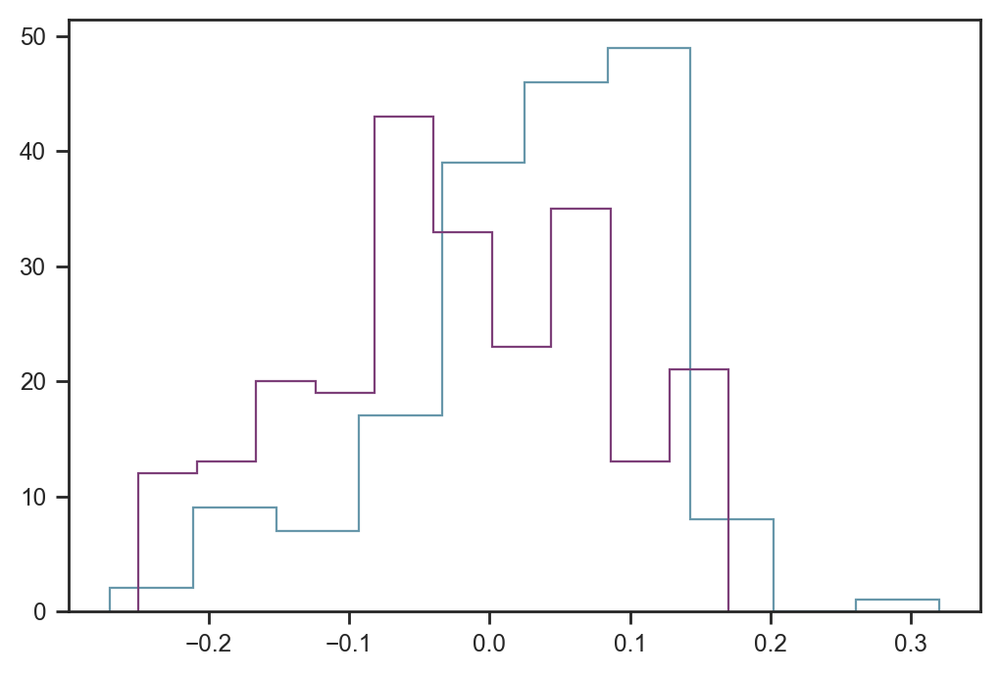

In [960]:
plt.scatter(df['cks_[Fe/H]'], df['bf18_[Fe/H]'])
plt.scatter(df['cks_[Fe/H]'][ymg_yng], df['bf18_[Fe/H]'][ymg_yng])
plt.scatter(df['cks_[Fe/H]'][ymg_old], df['bf18_[Fe/H]'][ymg_old])
plt.xlim(-0.2,0.2)
plt.ylim(-0.2,0.2)
plt.show()

plt.hist(df['cks_[Fe/H]'][ymg_yng], histtype='step')
plt.hist(df['cks_[Fe/H]'][ymg_old], histtype='step')
plt.show()

plt.hist(df['bf18_[Fe/H]'][ymg_yng], histtype='step')
plt.hist(df['bf18_[Fe/H]'][ymg_old], histtype='step')
plt.show()

#### Compare the LC amplitudes among low/high ymg yal stars

/Users/tdavid/anaconda3/lib/python3.7/site-packages/pandas/core/arraylike.py:358: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


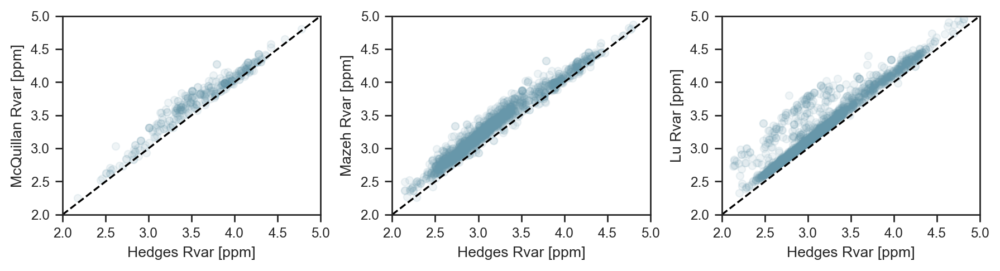

In [831]:
sc_kws = {"alpha": 0.1}

fig, (ax1,ax2,ax3) = plt.subplots(nrows=1, ncols=3, figsize=(9,2.5))

for ax in [ax1,ax2,ax3]:
    ax.plot(np.log10([100,1e5]),np.log10([100,1e5]),'k--')
    ax.set_xlim(np.log10(100),np.log10(1e5))
    ax.set_ylim(np.log10(100),np.log10(1e5))
    ax.set_xlabel('Hedges Rvar [ppm]')

ax1.scatter(np.log10(df.ch_rvar), np.log10(df.m13_Rvar), **sc_kws)
ax2.scatter(np.log10(df.ch_rvar), np.log10(df.m15_Rvar), **sc_kws)
ax3.scatter(np.log10(df.ch_rvar), np.log10(df.l20_Rvar), **sc_kws)

ax1.set_ylabel('McQuillan Rvar [ppm]')
ax2.set_ylabel('Mazeh Rvar [ppm]')
ax3.set_ylabel('Lu Rvar [ppm]')

plt.tight_layout()
plt.show()

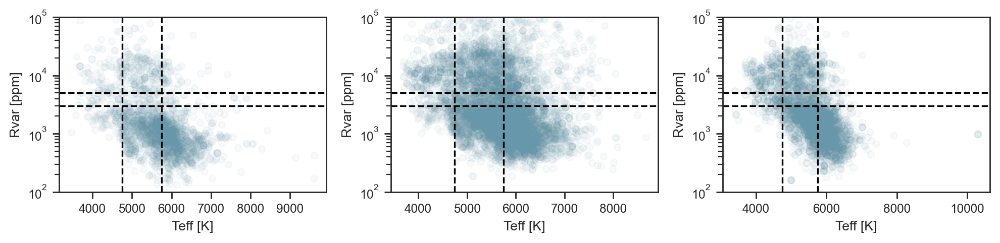

In [599]:
fig, ax = plt.subplots(nrows=1,ncols=3,figsize=(10,2.5))

for i,rvar in enumerate(['ch_rvar', 'l20_Rvar', 'maz_Rvar']):
    #ax[i].scatter(df['gaia_bp_rp'], df[rvar], alpha=0.1)
    ax[i].scatter(df['b20_iso_teff'], df[rvar], alpha=0.05)
    ax[i].axhline(5000, color='k', ls='--')
    ax[i].axhline(3000, color='k', ls='--')
    ax[i].axvline(4750, color='k', ls='--')
    ax[i].axvline(5750, color='k', ls='--')
    #ax[i].set_xlim(0,3)
    ax[i].set_ylim(1e2,1e5)
    ax[i].semilogy()
    ax[i].set_xlabel("Teff [K]")
    ax[i].set_ylabel("Rvar [ppm]")
    
plt.tight_layout()
plt.show()

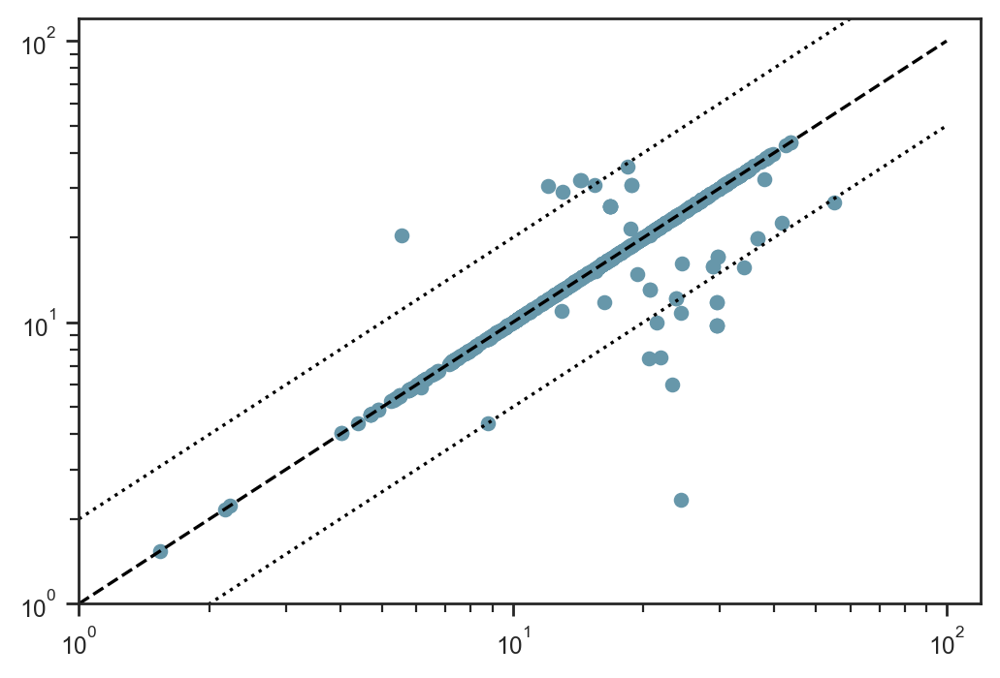

1710
1188
4236
7756


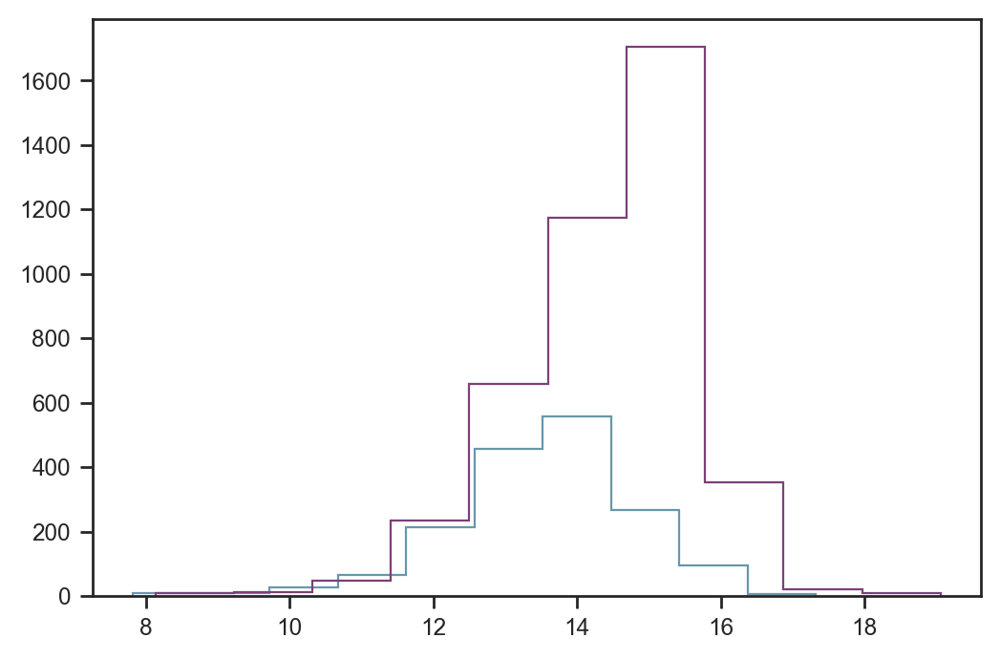

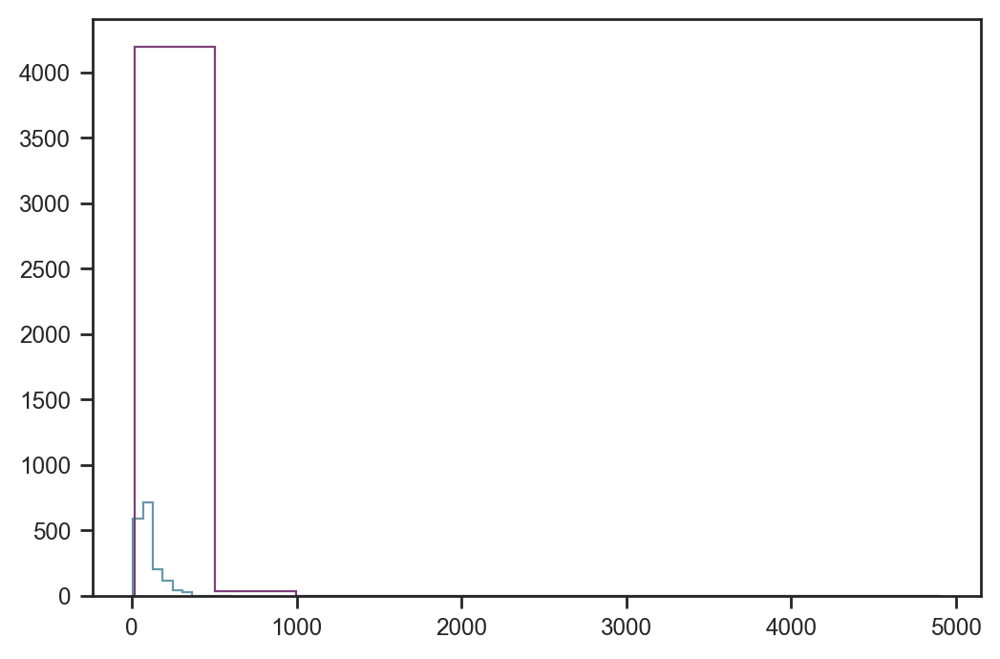

In [643]:
plt.scatter(df['a18_period'], df['d21_prot'])
plt.plot([1,100],[1,100], 'k--')
plt.plot([1,100],[2,200], 'k:')
plt.plot([1,100],[0.5,50], 'k:')
plt.xlim(1,120)
plt.ylim(1,120)
plt.loglog()
plt.show()

print(len(df[np.isfinite(df['a18_period'])]))
print(len(df[np.isfinite(df['mcq_Prot'])]))
print(len(df[np.isfinite(df['maz_Prot'])]))
print(len(df[np.isfinite(df['l20_Prot_predict'])]))

plt.hist(df['gaia_phot_g_mean_mag'][np.isfinite(df['a18_period'])], histtype='step')
plt.hist(df['gaia_phot_g_mean_mag'][np.isfinite(df['maz_Prot'])], histtype='step')
plt.show()

plt.hist(df['stlr_rrmscdpp03p0'][np.isfinite(df['a18_period'])], histtype='step')
plt.hist(df['stlr_rrmscdpp03p0'][np.isfinite(df['maz_Prot'])], histtype='step')
plt.show()

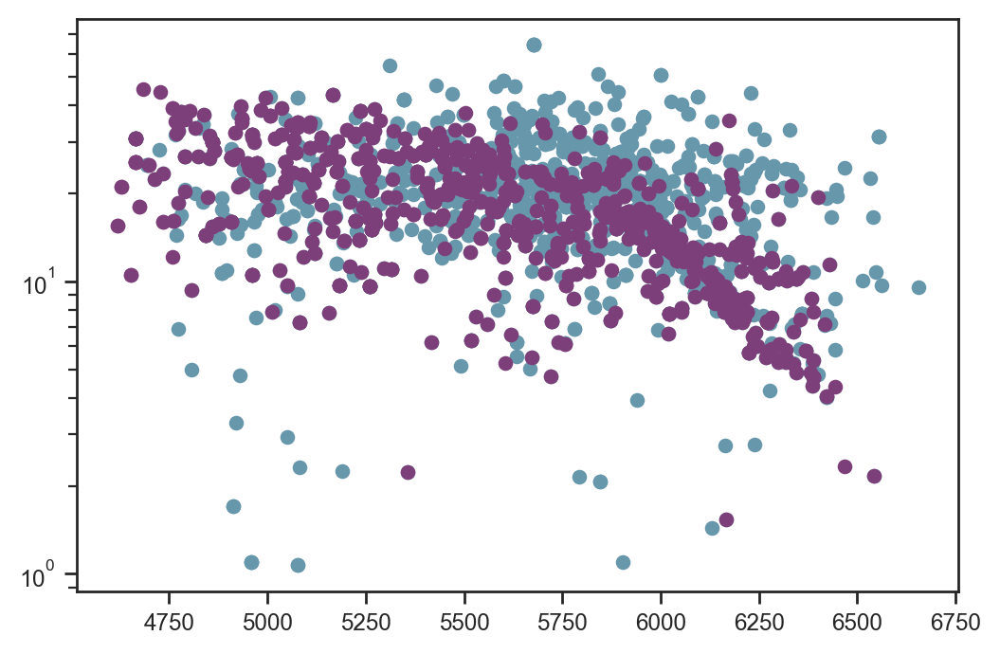

In [646]:
#plt.scatter(df['cks_Teff'], df['l20_Prot_predict'], edgecolor='m')
plt.scatter(df['cks_Teff'], df['a18_period'])
plt.scatter(df['cks_Teff'], df['d21_prot'])
plt.semilogy()
plt.show()

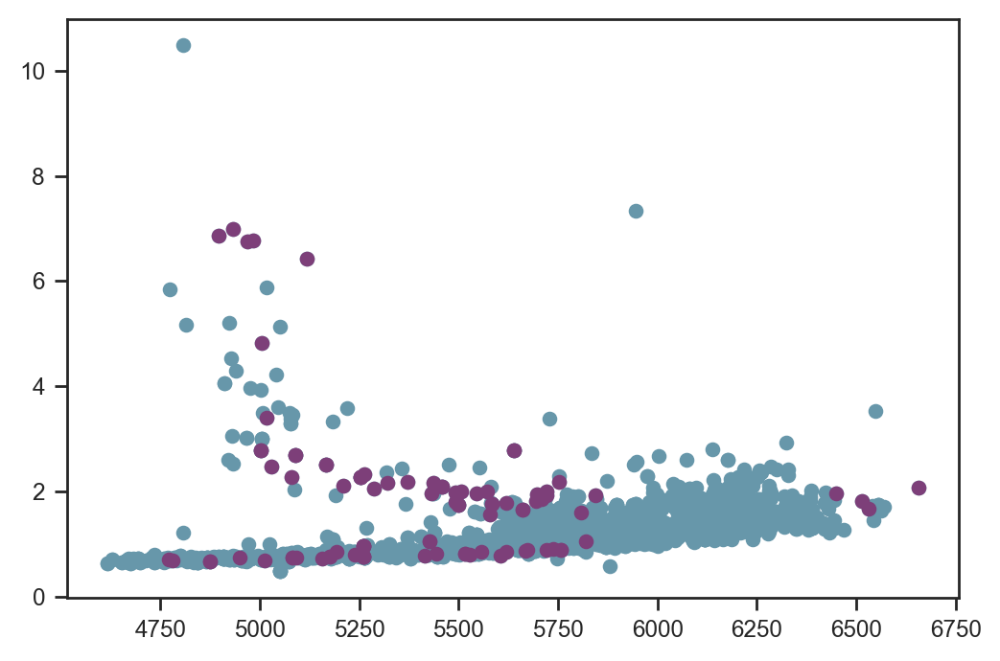

109


In [627]:
_ = df['b18_tb2_dA(Li)Hy']>0
plt.scatter(df['cks_Teff'], df['cks_R'])
plt.scatter(df['cks_Teff'][_], df['cks_R'][_])
plt.show()

print(len(df['cks_Teff'][_]))

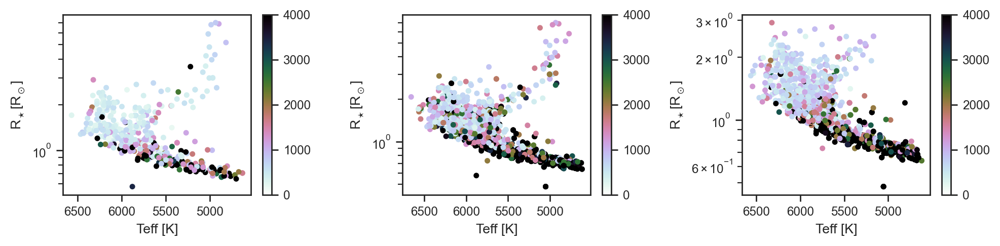

In [558]:
fig,ax = plt.subplots(nrows=1,ncols=3,figsize=(10,2.5))

# p1 = ax1.scatter(df['cks_Teff'], df['cks_R'], c=df['ch_rvar'], s=20, cmap='viridis', vmin=0, vmax=4000)
# p2 = ax2.scatter(df['cks_Teff'], df['cks_R'], c=df['l20_Rvar'], s=20, cmap='viridis', vmin=0, vmax=4000)
# p3 = ax3.scatter(df['cks_Teff'], df['cks_R'], c=df['maz_Rvar'], s=20, cmap='viridis', vmin=0, vmax=4000)

for i,_rvar in enumerate([df['ch_rvar'],df['l20_Rvar'],df['maz_Rvar']]):
    
    _ax = ax[i]
    _p = _ax.scatter(df['cks_Teff'], df['cks_R'], c=_rvar, cmap='cubehelix_r', s=10, vmin=0, vmax=4000)
    _ax.semilogy()
    _ax.set_xlabel("Teff [K]")
    _ax.set_ylabel("$\mathregular{R_\star [R_\odot]}$")
    _ax.invert_xaxis()
    fig.colorbar(_p, ax=_ax)
    
plt.tight_layout()
plt.show()

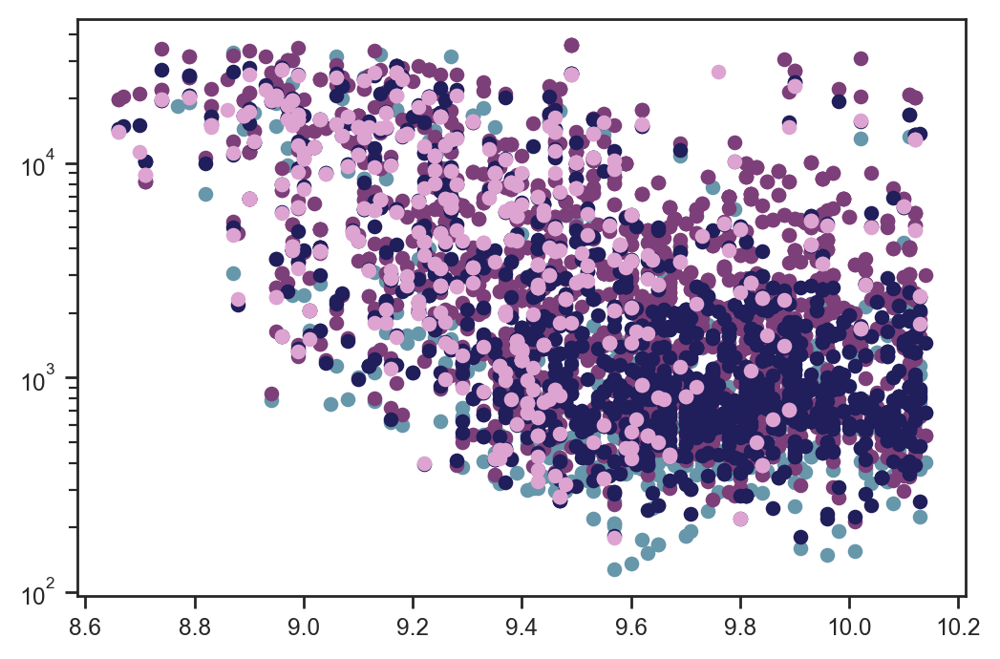

In [559]:
plt.scatter(df['cks_logAiso'], df['ch_q10_rvar'])
plt.scatter(df['cks_logAiso'], df['l20_Rvar'])
plt.scatter(df['cks_logAiso'], df['maz_Rvar'])
plt.scatter(df['cks_logAiso'], df['mcq_Rvar'])
plt.semilogy()
plt.show()

9750 401


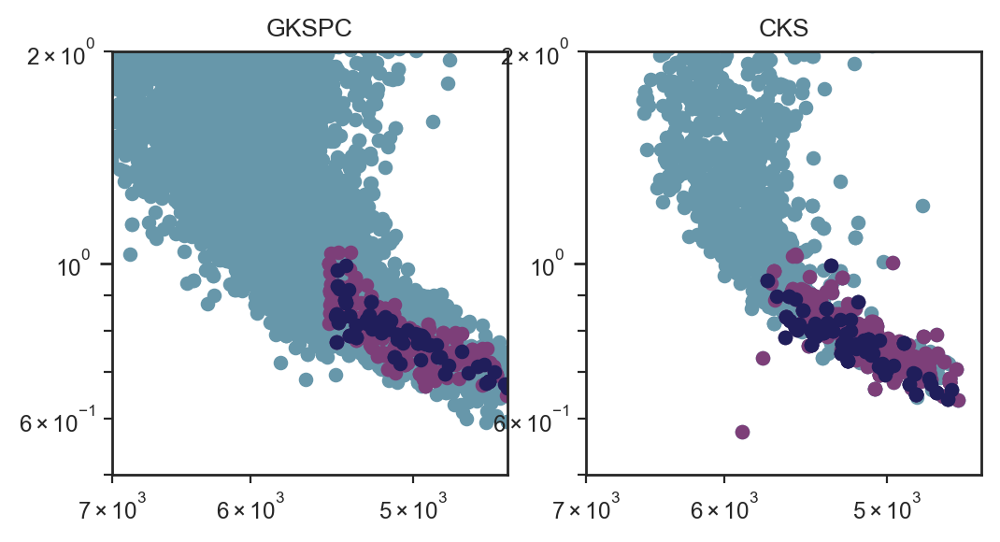

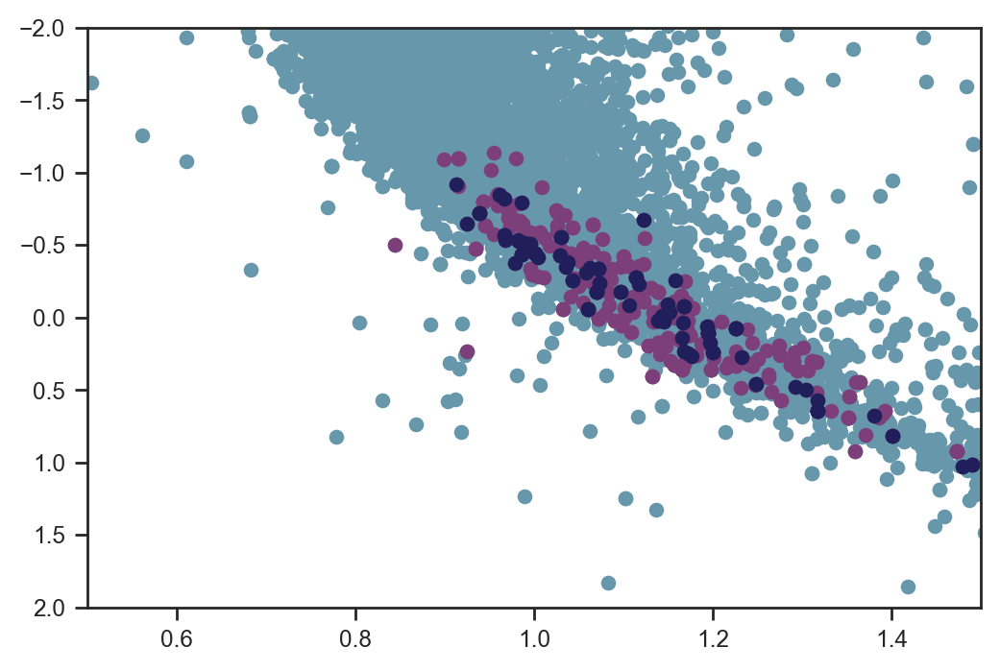

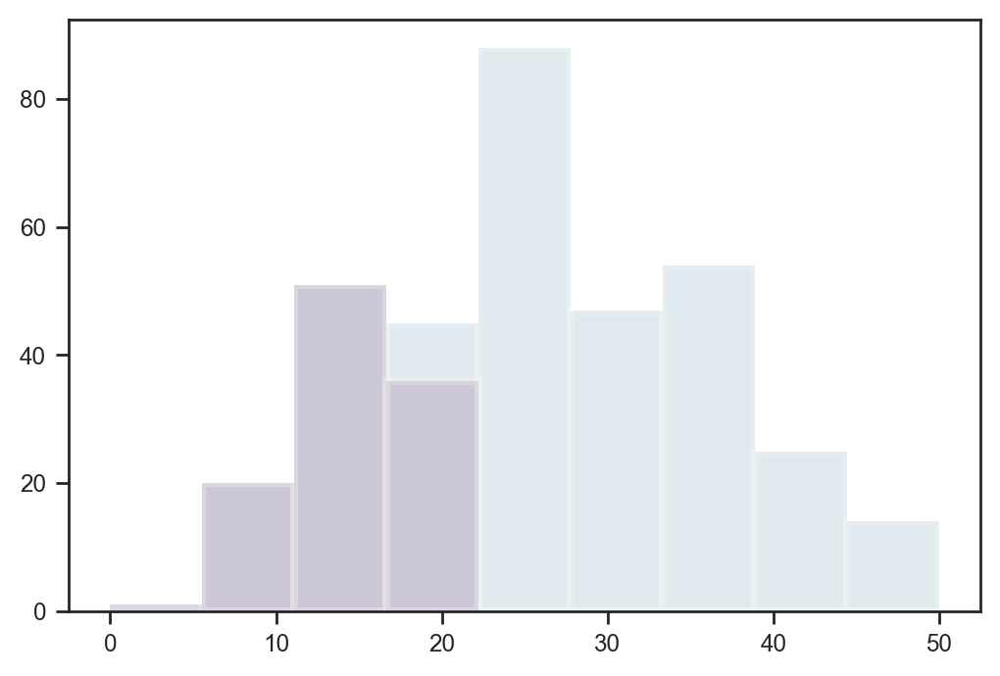

In [578]:
m =  (df['koi_score']>0.90)
m &= (df['b20_iso_rad']<1.05)
#m &= (df['gaia_d20_ruwe']<1.2)
m &= (df['koi_period']<100)
#m &= (df['single_transit_snr']>1)
m &= (df['b20_iso_teff']<5500)
#m &= (df['b20_iso_teff']>5000)
m &= (df['koi_disposition']!='FALSE POSITIVE')
m &= (df['p17_Disp']!='FP')
m &= (df['cks_Rp']<9)
#m &= (df['cks_Rp']>2) & (df['cks_Rp']<10)
#m &= (df['cks_Rp']<1.8)

print(len(df),len(df[m]))

#m_yng = m & (df['maz_Rvar']>4000)
#m_old = m & ~(df['maz_Rvar']>4000)
m_yng = m & (df['maz_Prot']<20)
m_old = m & ~(df['maz_Rvar']<20)

fig, (ax1,ax2) = plt.subplots(nrows=1,ncols=2,figsize=(6,3))

sc_kws = {"alpha": 1}

ax1.scatter(df['b20_iso_teff'], df['b20_iso_rad'], **sc_kws)
ax1.scatter(df['b20_iso_teff'][m_old], df['b20_iso_rad'][m_old], **sc_kws)
ax1.scatter(df['b20_iso_teff'][m_yng], df['b20_iso_rad'][m_yng], **sc_kws)

ax2.scatter(df['cks_Teff'], df['cks_R'], **sc_kws)
ax2.scatter(df['cks_Teff'][m_old], df['cks_R'][m_old], **sc_kws)
ax2.scatter(df['cks_Teff'][m_yng], df['cks_R'][m_yng], **sc_kws)

ax1.set_title('GKSPC')
ax2.set_title('CKS')

for ax in [ax1,ax2]:
    ax.loglog()
    ax.set_xlim(4500,7000)
    ax.set_ylim(0.5,2)
    ax.invert_xaxis()


plt.show()


_x = df['gaia_bp_rp']
_y = df['gaia_phot_g_mean_mag']-(5*np.log10(df['gaia_r_est'])+1)

plt.scatter(_x, _y)
plt.scatter(_x[m_old], _y[m_old])
plt.scatter(_x[m_yng], _y[m_yng])
plt.xlim(0.5,1.5)
plt.ylim(-2,2)
plt.gca().invert_yaxis()
plt.show()

plt.hist(df['maz_Prot'][m_old], bins=np.linspace(0,50,10), alpha=0.2, lw=3)
plt.hist(df['maz_Prot'][m_yng],  bins=np.linspace(0,50,10), alpha=0.2, lw=3)
plt.show()

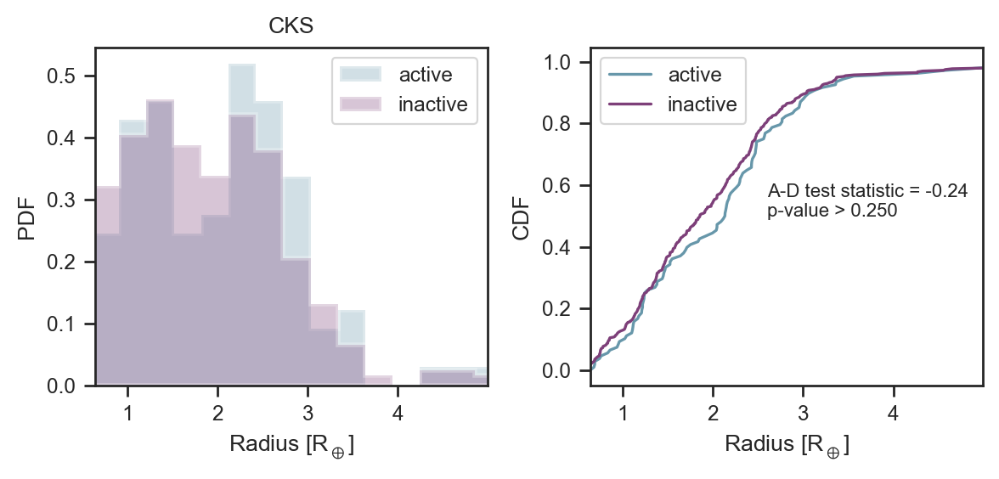

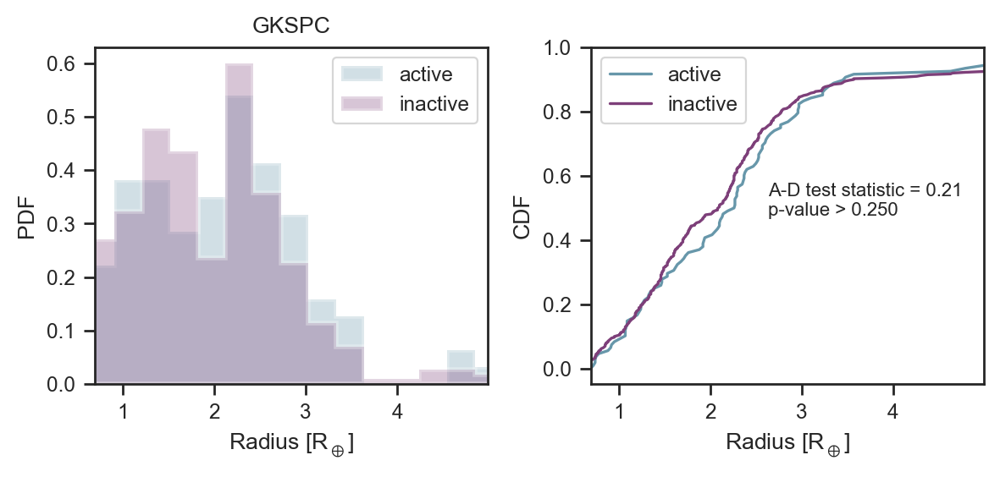

In [579]:
plot_distributions(df['cks_Rp'][m_yng], df['cks_Rp'][m_old], title='CKS')
plot_distributions(df['b20b_Radius'][m_yng], df['b20b_Radius'][m_old], title='GKSPC')